In [1]:
%tensorflow_version 1.x
import tensorflow as tf
#tf.enable_eager_execution()
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
from scipy import optimize
import matplotlib.dates as dates
from ipywidgets import interact, widgets
from scipy.integrate import solve_ivp
plt.style.use('seaborn-poster')
matplotlib.rcParams['figure.figsize'] = (10., 6.)
import copy
import sympy
%matplotlib inline
import scipy as sp
from scipy.integrate import odeint
import timeit
import time
import os
from scipy.interpolate import CubicSpline
os.environ['KMP_DUPLICATE_LIB_OK']='TRUE'
np.set_printoptions(threshold=np.inf)
from prettytable import PrettyTable  

TensorFlow 1.x selected.


(181, 1)


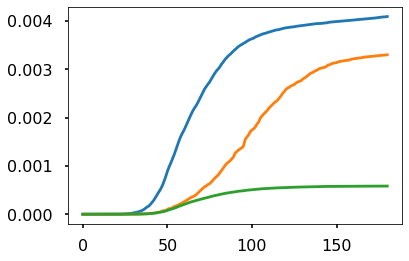

In [2]:
url1 = 'https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_global.csv'
re_url = 'https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_recovered_global.csv'
dh_url = 'https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_deaths_global.csv'
Confirmed = pd.read_csv(url1,error_bad_lines=False)
Deaths = pd.read_csv(dh_url,error_bad_lines=False)
Recovered = pd.read_csv(re_url,error_bad_lines=False)
IT_dh = Deaths.loc[(Deaths["Country/Region"] == "Italy") & (Deaths["Province/State"].isnull() == True)]
IT_re = Recovered.loc[(Recovered["Country/Region"] == "Italy") & (Recovered["Province/State"].isnull() == True)]
IT_cf = Confirmed.loc[(Confirmed["Country/Region"] == "Italy") & (Confirmed["Province/State"].isnull() == True)]
length = IT_cf.shape[1]-13
IC = IT_cf.iloc[:,13:].to_numpy().reshape(length,1)
DC = IT_dh.iloc[:,13:].to_numpy().reshape(length,1)
RC = IT_re.iloc[:,13:].to_numpy().reshape(length,1)
T = np.arange(0,length).reshape(length,1)
II = IC - DC - RC
N0 = 60.36*1.e6
SS = N0 - II - RC - DC
print(II.shape)
plt.plot(T,IC/N0)
plt.plot(T,RC/N0)
plt.plot(T,DC/N0)

In [3]:
IT_cf.iloc[:,0:40]

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20
137,NaN,Italy,41.87194,12.56738,0,0,0,0,0,0,0,0,0,2,2,2,2,2,2,2,3,3,3,3,3,3,3,3,3,3,3,3,3,3,20,62,155,229,322,453


In [4]:
p = np.zeros(10)
#(p.reshape[10,1])[3]
p[1:3]

array([0., 0.])

In [5]:
np.random.seed(12345)
tf.compat.v1.set_random_seed(1234)
tf.compat.v1.disable_eager_execution()
class SIRD:
    def __init__(self, I, R, D, S, T, layers):
        self.t = T
        self.I = I
        self.R = R
        self.S = S
        self.D = D
        self.layers = layers
        self.lb = T.min()
        self.ub = T.max()
        # Initialize NN
        self.weights, self.biases = self.initialize_NN(self.layers)
        
        # Initialize parameters
        self.gamma = tf.Variable([1], dtype=tf.float32)
        self.beta = tf.Variable([1], dtype=tf.float32)
        self.mu = tf.Variable([1], dtype=tf.float32)
        # tf placeholders and graph
        self.sess = tf.compat.v1.Session(config=tf.compat.v1.ConfigProto(allow_soft_placement=True,
                                                     log_device_placement=True))
        self.t_tf = tf.compat.v1.placeholder(tf.float32, shape=[None, self.t.shape[1]])
        self.I_tf = tf.compat.v1.placeholder(tf.float32, shape=[None, self.I.shape[1]])
        self.R_tf = tf.compat.v1.placeholder(tf.float32, shape=[None, self.R.shape[1]])
        self.S_tf = tf.compat.v1.placeholder(tf.float32, shape=[None, self.S.shape[1]])
        self.D_tf = tf.compat.v1.placeholder(tf.float32, shape=[None, self.D.shape[1]])
       
        self.S_pred, self.I_pred, self.R_pred,self.D_pred,self.E1_pred, self.E2_pred, self.E3_pred, self.E4_pred, self.E5_pred = self.net_NS(
            self.t_tf)
        self.GE = tf.reduce_mean(tf.abs(self.E1_pred))+ tf.reduce_mean(tf.abs(self.E2_pred)) +\
                  tf.reduce_mean(tf.abs(self.E3_pred)) + tf.reduce_mean(tf.abs(self.E4_pred)) + tf.reduce_mean(tf.abs(self.E5_pred))
        self.OB = tf.reduce_mean(tf.abs(self.I_tf - self.I_pred)) + tf.reduce_mean(tf.abs(self.R_pred - self.R_tf)) +\
                  tf.abs(self.S_tf[0] - self.S_pred[0]) + tf.reduce_mean(tf.abs(self.D_tf - self.D_pred))
        self.loss = self.GE + self.OB
                    
        
        
        self.optimizer_Adam = tf.compat.v1.train.AdamOptimizer()
        #self.optimizer_Adam = tf.compat.v1.train.AdagradOptimizer(learning_rate = 0.01)
        self.train_op_Adam = self.optimizer_Adam.minimize(self.loss)                                     
        init = tf.compat.v1.global_variables_initializer()
        self.sess.run(init)
         
        
    def initialize_NN(self, layers):
        def xavier_init(size):
            in_dim = size[0]
            out_dim = size[1]        
            xavier_stddev = np.sqrt(2/(in_dim + out_dim))
            return tf.Variable(tf.random.truncated_normal([in_dim, out_dim], stddev=xavier_stddev), dtype=tf.float32)        
        weights = []
        biases = []
        num_layers = len(layers)
        for l in range(0,num_layers-1):
            W = xavier_init(size=[layers[l], layers[l+1]])
            b = tf.Variable(tf.zeros([1,layers[l+1]], dtype=tf.float32), dtype=tf.float32)
            weights.append(W)
            biases.append(b)        
        return weights, biases
    
    
    
    def forward(self, X, weights, biases):
        num_layers = len(weights) + 1
        H = 2.0*(X - self.lb)/(self.ub - self.lb) - 1.0
        for l in range(0,num_layers-2):
            W = weights[l]
            b = biases[l]
            H = tf.tanh(tf.add(tf.matmul(H, W), b))
        W = weights[-1]
        b = biases[-1]
        Y = tf.nn.softplus(tf.add(tf.matmul(H, W), b))
        return Y

    def forward1(self, X, weights, biases):
        num_layers = len(weights) + 1
        H = 2.0*(X - self.lb)/(self.ub - self.lb) - 1.0
        for l in range(0,num_layers-2):
            W = weights[l]
            b = biases[l]
            H = tf.tanh(tf.add(tf.matmul(H, W), b))
        W = weights[-1]
        b = biases[-1]
        Y = tf.nn.sigmoid(tf.add(tf.matmul(H, W), b))
        return Y

    def net_NS(self, t):
        gamma = self.gamma
        beta = self.beta
        mu = self.mu
        #print(x.shape)
        #print(y.shape)
        output = self.forward1(t, self.weights, self.biases)
        #beta = self.neural_net(t,self.weights4,self.biases4)
        #gamma = self.neural_net1(t,self.weights5,self.biases5)
        
        S = output[:,0:1]
        I = output[:,1:2]
        R = output[:,2:3]
        D = output[:,3:4]

        E1 = tf.gradients(S, t)[0] + beta*S*I
        E2 = tf.gradients(I, t)[0] - beta*S*I + (mu + gamma)*I
        E3 = tf.gradients(R, t)[0] - gamma*I
        E4 = tf.gradients(D, t)[0] - mu*I
        E5 = 1 - (S+I+R+D)
        return S,I,R,D,E1,E2,E3,E4,E5

    def callback(self, loss):
        print('Loss: %.3e' % (loss))
    def train(self, nIter): 

        tf_dict = {self.t_tf: self.t, self.I_tf: self.I,self.R_tf: self.R,self.S_tf: self.S,self.D_tf: self.D}
        cpu_time = 0       
        start_time = time.time()
        for it in range(nIter):
            self.sess.run(self.train_op_Adam, tf_dict)
            if it % 10000 == 0:
                elapsed = time.time() - start_time
                loss_value = self.sess.run(self.loss, tf_dict)
                gamma_value = self.sess.run(self.gamma)
                beta_value = self.sess.run(self.beta)
                mu_value = self.sess.run(self.mu)
                ge_loss = self.sess.run(self.GE, tf_dict)
                ob_loss = self.sess.run(self.OB, tf_dict)
                cpu_time = cpu_time + elapsed
                print('It: %d, Loss: %.3e, GE_loss: %.5e,OB_loss: %.5e, Beta: %.5e,gamma: %.5e,mu: %.5e, Time: %.2f, cumulative_time: %.2f' % 
                      (it, loss_value,ge_loss,ob_loss,beta_value,gamma_value,mu_value,elapsed,cpu_time))
                start_time = time.time()
        return cpu_time
    def predict(self, t_star):
        tf_dict = {self.t_tf: t_star}
        S = self.sess.run(self.S_pred, tf_dict)
        I = self.sess.run(self.I_pred, tf_dict)
        R = self.sess.run(self.R_pred, tf_dict)
        D = self.sess.run(self.D_pred, tf_dict)
        #beta = self.sess.run(self.beta_pred,tf_dict)
        #gamma = self.sess.run(self.gamma_pred,tf_dict)
        #gamma = self.sess.run(self.gamma_pred,tf_dict)
        return S,I,R,D

In [6]:
def handle(t1,t2,T_test,neural_network,s,i,r,d,layers,N_iter,N0,iter_num,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned):
    a = CubicSpline(T_test,s[t1:t2])
    b = CubicSpline(T_test,i[t1:t2])
    c = CubicSpline(T_test,r[t1:t2])
    dd = CubicSpline(T_test,d[t1:t2])
    t_train = np.arange(t1,t2 - 1+iter_num,iter_num)
    s_train = a(t_train).reshape(len(t_train),1)/N0
    i_train = b(t_train).reshape(len(t_train),1)/N0
    r_train = c(t_train).reshape(len(t_train),1)/N0
    d_train = dd(t_train).reshape(len(t_train),1)/N0
    TT_train = t_train.reshape(len(t_train),1)
    model = neural_network(i_train,r_train,d_train,s_train,TT_train,layers)
    CPU_time = model.train(N_iter)
    TT = T_test.reshape(len(T_test),1)
    S_out,I_out,R_out,D_out = model.predict(TT)
    beta = model.sess.run(model.beta)
    gamma = model.sess.run(model.gamma)
    mu = model.sess.run(model.mu)
    print("beta: ",beta)
    print("gamma: ",gamma)
    print("mu: ",mu)
    def sird_model(z,t,beta_value,gamma,mu):
        s1 = z[0]
        i1 = z[1]
        r1 = z[2]
        d1 = z[3]
        dsdt = -beta_value*i1*s1
        didt = beta_value*i1*s1 - (gamma+mu)*i1
        drdt = gamma*i1
        dddt = mu*i1
        dzdt = [dsdt,didt,drdt,dddt]
        return dzdt
    z0 = [s_train[0,0],i_train[0,0],r_train[0,0],d_train[0,0]]
    z_sol = odeint(sird_model,z0,T_test,args=(beta[0],gamma[0],mu[0]))
    plt.figure(figsize=(8,14), dpi=100)
    plt.figure(1)
    plt.subplots_adjust(hspace = 0.5)
    ax1 = plt.subplot(411)
    plt.plot(T_test,100*s[t1:t2]/N0)
    plt.plot(TT,100*S_out)
    plt.plot(T_test,100*z_sol[:,0])
    plt.xlabel("Time(days)")
    plt.ylabel("S/N(%)")
    plt.legend(("S_data","S_learned","S_ode"))
    ax1 = plt.subplot(412)
    plt.plot(T_test,100*i[t1:t2]/N0)
    plt.plot(TT,100*I_out)
    plt.plot(T_test,100*z_sol[:,1])
    plt.xlabel("Time(days)")
    plt.ylabel("I/N(%)")
    plt.legend(("I_data","I_learned","I_ode"))
    ax1 = plt.subplot(413)
    plt.plot(T_test,100*r[t1:t2]/N0)
    plt.plot(TT,100*R_out)
    plt.plot(T_test,100*z_sol[:,2])
    plt.xlabel("Time(days)")
    plt.ylabel("R/N(%)")
    plt.legend(("R_data","R_learned","R_ode"))
    ax1 = plt.subplot(414)
    plt.plot(T_test,100*d[t1:t2]/N0)
    plt.plot(TT,100*D_out)
    plt.plot(T_test,100*z_sol[:,3])
    plt.legend(("D_data","D_learned","D_ode"))
    plt.xlabel("Time(days)")
    plt.ylabel("D/N(%)")
    plt.show()
    S_ode[t1:t2] = z_sol[:,0]
    I_ode[t1:t2] = z_sol[:,1]
    R_ode[t1:t2] = z_sol[:,2]
    D_ode[t1:t2] = z_sol[:,3]
    S_learned[t1:t2] = S_out[:,0]
    I_learned[t1:t2] = I_out[:,0]
    R_learned[t1:t2] = R_out[:,0]
    D_learned[t1:t2] = D_out[:,0]
    '''
    S_erode = np.abs(s[t1:t2] - S_out)/s[t1:t2]
    S_erNN = np.abs(s[t1:t2] - z_sol[:,0])/s[t1:t2]
    I_erode = np.abs(i[t1:t2] - I_out)/i[t1:t2]
    I_erNN = np.abs(i[t1:t2] - z_sol[:,1])/i[t1:t2]
    R_erode = np.abs(r[t1:t2] - R_out)/r[t1:t2]
    R_erNN = np.abs(r[t1:t2] - z_sol[:,2])/r[t1:t2]
    '''
    return S_out,I_out,R_out,D_out,beta[0],gamma[0],mu[0],z_sol,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,CPU_time

In [7]:
def sum_all(layers,length,SS,II,RC,DC,N0,inter_numb,NIter):
    S_ode = np.zeros(length)
    I_ode = np.zeros(length)
    R_ode = np.zeros(length)
    D_ode = np.zeros(length)
    S_learned = np.zeros(length)
    I_learned = np.zeros(length)
    R_learned = np.zeros(length)
    D_learned = np.zeros(length)
    gamma_all = np.zeros(10)
    beta_all = np.zeros(10)
    mu_all = np.zeros(10)
    T1 = np.arange(0,35).reshape(35,)
    S1,I1,R1,D1,beta1,gamma1,mu1,z1,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time1 = handle(0,35,T1,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #4th week
    T2 = np.arange(35,42).reshape(7,)
    S2,I2,R2,D2,beta2,gamma2,mu2,z2,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time2 = handle(35,42,T2,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #5th week
    T3 = np.arange(42,49).reshape(7,)
    S3,I3,R3,D3,beta3,gamma3,mu3,z3,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time3 = handle(42,49,T3,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #6th week
    T4 = np.arange(49,56).reshape(7,)
    S4,I4,R4,D4,beta4,gamma4,mu4,z4,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time4 = handle(49,56,T4,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #7th week
    T5 = np.arange(56,63).reshape(7,)
    S5,I5,R5,D5,beta5,gamma5,mu5,z5,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time5 = handle(56,63,T5,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #8th week
    T6 = np.arange(63,70).reshape(7,)
    S6,I6,R6,D6,beta6,gamma6,mu6,z6,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time6 = handle(63,70,T6,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #9th week
    T7 = np.arange(70,77).reshape(7,)
    S7,I7,R7,D7,beta7,gamma7,mu7,z7,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time7 = handle(70,77,T7,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #10th week
    T8 = np.arange(77,84).reshape(7,)
    S8,I8,R8,D8,beta8,gamma8,mu8,z8,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time8 = handle(77,84,T8,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #11th week
    T9 = np.arange(84,91).reshape(7,)
    S9,I9,R9,D9,beta9,gamma9,mu9,z9,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time9 = handle(84,91,T9,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    #left weeks
    T10 = np.arange(91,length).reshape(length - 91,)
    S10,I10,R10,D10,beta10,gamma10,mu10,z10,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,time10 = handle(91,length,T10,SIRD,SS,II,RC,DC,layers,NIter,N0,inter_numb,S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned)
    gamma_all[0],gamma_all[1],gamma_all[2],gamma_all[3],gamma_all[4] = gamma1,gamma2,gamma3,gamma4,gamma5
    gamma_all[5],gamma_all[6],gamma_all[7],gamma_all[8],gamma_all[9] = gamma6,gamma7,gamma8,gamma9,gamma10
    beta_all[0],beta_all[1],beta_all[2],beta_all[3],beta_all[4] = beta1,beta2,beta3,beta4,beta5
    beta_all[5],beta_all[6],beta_all[7],beta_all[8],beta_all[9] = beta6,beta7,beta8,beta9,beta10
    mu_all[0],mu_all[1],mu_all[2],mu_all[3],mu_all[4],mu_all[5],mu_all[6],mu_all[7],mu_all[8],mu_all[9] = mu1,mu2,mu3,mu4,mu5,mu6,mu7,mu8,mu9,mu10
    time_con = time1+time2+time3+time4+time5+time6+time7+time8+time9+time10
    ttt = np.arange(0,length)
    plt.figure(figsize=(8,14), dpi=100)
    plt.figure(1)
    plt.subplots_adjust(hspace = 0.5)
    ax1 = plt.subplot(411)
    plt.plot(ttt,100*S_ode)
    plt.plot(ttt,100*SS/N0)
    plt.plot(ttt,100*S_learned)
    plt.xlabel("Time(days)")
    plt.ylabel("S/N(%)")
    plt.legend(("S_ode","S_data","S_learned"))
    ax1 = plt.subplot(412)
    plt.plot(ttt,100*I_ode)
    plt.plot(ttt,100*II/N0)
    plt.plot(ttt,100*I_learned)
    plt.xlabel("Time(days)")
    plt.ylabel("I/N(%)")
    plt.legend(("I_ODE","I_data","I_learned"))
    ax1 = plt.subplot(413)
    plt.plot(ttt,100*R_ode)
    plt.plot(ttt,100*RC/N0)
    plt.plot(ttt,100*R_learned)
    plt.xlabel("Time(days)")
    plt.ylabel("R/N(%)")
    plt.legend(("R_ODE","R_data","R_learned"))
    ax1 = plt.subplot(414)
    plt.plot(ttt,100*D_ode)
    plt.plot(ttt,100*DC/N0)
    plt.plot(ttt,100*D_learned)
    plt.xlabel("Time(days)")
    plt.ylabel("D/N(%)")
    plt.legend(("D_ODE","D_data","D_learned"))
    plt.show()
    x = PrettyTable()
    x.field_names = ["Paramaters","Initial three weeks","4th week","5th week","6th week","7th week","8th week","9th week" ,"10th week","11th week","remainder"]
    x.add_row(["beta",beta1,beta2,beta3,beta4,beta5,beta6,beta7,beta8,beta9,beta10])
    x.add_row(["gamma",gamma1,gamma2,gamma3,gamma4,gamma5,gamma6,gamma7,gamma8,gamma9,gamma10])
    x.add_row(["mu",mu1,mu2,mu3,mu4,mu5,mu6,mu7,mu8,mu9,mu10])
    x.add_row(["Reproduction Number",beta1/(mu1+gamma1),beta2/(mu2+gamma2),beta3/(mu3+gamma3),beta4/(mu4+gamma4),beta5/(mu5+gamma5),beta6/(mu6+gamma6),beta7/(mu7+gamma7),beta8/(mu8+gamma8),beta9/(mu9+gamma9),beta10/(mu10+gamma10)])
    print(x)
    S_erNN = np.abs(S_learned.reshape(len(S_learned),1) -SS/N0)/(SS/N0)
    S_erode = np.abs(S_ode.reshape(len(S_ode),1) -SS/N0)/(SS/N0)
    I_erNN = np.abs(I_learned.reshape(len(I_learned),1) - II/N0)/(II/N0)
    I_erode = np.abs(I_ode.reshape(len(I_ode),1) - II/N0)/(II/N0)
    R_erNN = np.abs((R_learned[22:].reshape(len(R_learned)-22,1)) - (RC[22:,:]/N0))/(RC[22:,:]/N0)
    R_erode = np.abs(R_ode[22:].reshape(len(R_ode)-22,1) - RC[22:,:]/N0)/(RC[22:,:]/N0)
    D_erNN = np.abs(D_learned[21:].reshape(len(D_learned)-21,1) - DC[21:,:]/N0)/(DC[21:,:]/N0)
    D_erode = np.abs(D_ode[21:].reshape(len(D_ode)-21,1) - DC[21:,:]/N0)/(DC[21:,:]/N0)
    plt.figure(figsize=(8,14), dpi=100)
    plt.subplots_adjust(hspace = 0.5)
    plt.figure(1)
    ax1 = plt.subplot(411)
    plt.plot(ttt,S_erode)
    plt.plot(ttt,S_erNN)
    plt.xlabel("Time(day)")
    plt.ylabel("Relative Value")
    plt.legend(("S_ODE error","S_NN error"))
    ax1 = plt.subplot(412)
    plt.plot(ttt,I_erode)
    plt.plot(ttt,I_erNN)
    plt.xlabel("Time(day)")
    plt.ylabel("Relative Value")
    plt.legend(("I_ODE error","I_NN error"))
    ax1 = plt.subplot(413)
    plt.plot(ttt[22:],R_erode)
    plt.plot(ttt[22:],R_erNN)
    plt.xlabel("Time(day)")
    plt.ylabel("Relative Value")
    plt.legend(("R_ODE error","R_NN error"))
    ax1 = plt.subplot(414)
    plt.plot(ttt[21:],D_erode)
    plt.plot(ttt[21:],D_erNN)
    plt.xlabel("Time(day)")
    plt.ylabel("Relative Value")
    plt.legend(("D_ODE error","D_NN error"))
    plt.show()  
    return S_ode,I_ode,R_ode,D_ode,S_learned,I_learned,R_learned,D_learned,beta_all,gamma_all,mu_all,S_erNN,I_erNN,R_erNN,D_erNN,S_erode,I_erode,R_erode,D_erode,time_con

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.888e+00, GE_loss: 2.97647e+00,OB_loss: 1.91159e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.58, cumulative_time: 0.58
It: 10000, Loss: 3.677e-05, GE_loss: 1.08856e-05,OB_loss: 2.58827e-05, Beta: 1.35437e+00,gamma: 8.20873e-01,mu: 8.20873e-01, Time: 19.76, cumulative_time: 20.33
It: 20000, Loss: 7.281e-06, GE_loss: 4.70808e-07,OB_loss: 6.81032e-06, Beta: 1.74290e+00,gamma: 7.82052e-01,mu: 7.77571e-01, Time: 19.45, cumulative_time: 39.78
It: 30000, Loss: 8.935e-07, GE_loss: 3.79142e-07,OB_loss: 5.14310e-07, Beta: 2.83102e-01,gamma: 3.16902e-02,mu: 1.13345e-02, Time: 19.05, cumulative_time: 58.83
It: 40000, Loss: 8.630e-07, GE_loss: 3.38723e-07,OB_loss: 5.24284e-07, Beta: 2.87041e-01,gamma: 3.19340e-02,mu: 1.14511e-02, Time: 19.51, cumulative_time: 78.34
beta:  [0.2875927]
gamma:  [0.03153375]
mu:  [0.01130076]


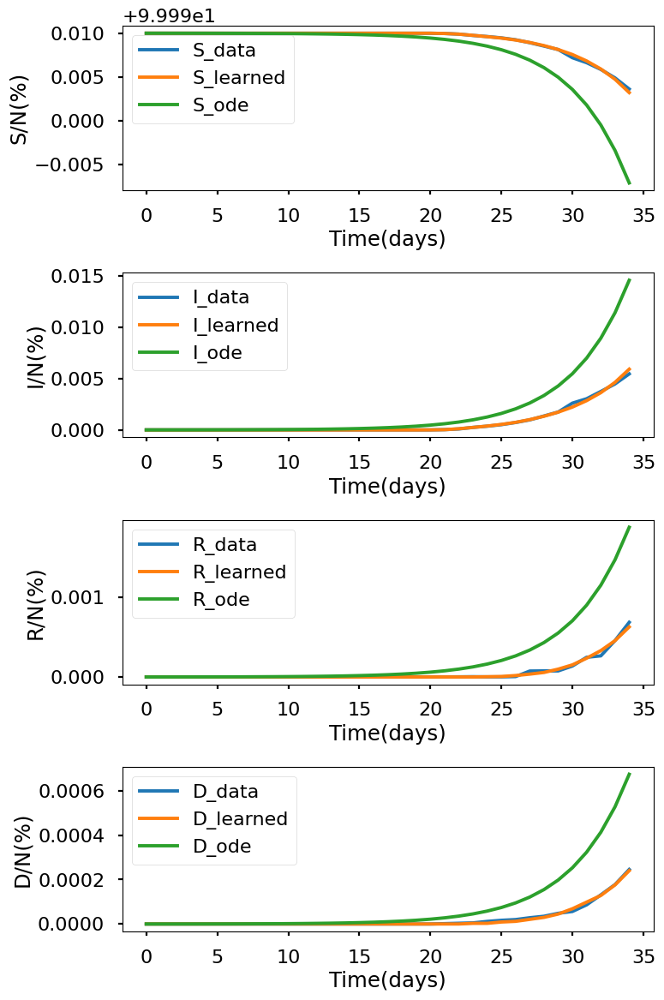

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 5.118e+00, GE_loss: 3.06802e+00,OB_loss: 2.04998e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.48, cumulative_time: 0.48
It: 10000, Loss: 1.972e-04, GE_loss: 1.37254e-05,OB_loss: 1.83453e-04, Beta: 1.38401e+00,gamma: 8.15887e-01,mu: 8.18988e-01, Time: 19.45, cumulative_time: 19.94
It: 20000, Loss: 1.529e-04, GE_loss: 1.76877e-05,OB_loss: 1.35200e-04, Beta: 1.07427e+00,gamma: 7.47763e-01,mu: 7.30239e-01, Time: 18.21, cumulative_time: 38.15
It: 30000, Loss: 5.697e-06, GE_loss: 6.04408e-07,OB_loss: 5.09300e-06, Beta: 2.28155e-01,gamma: 1.56767e-02,mu: 1.94065e-02, Time: 18.25, cumulative_time: 56.40
It: 40000, Loss: 6.087e-06, GE_loss: 6.94492e-07,OB_loss: 5.39213e-06, Beta: 2.29318e-01,gamma: 1.59871e-02,mu: 1.97592e-02, Time: 18.20, cumulative_time: 74.60
beta:  [0.22873163]
gamma:  [0.01601683]
mu:  [0.01978274]


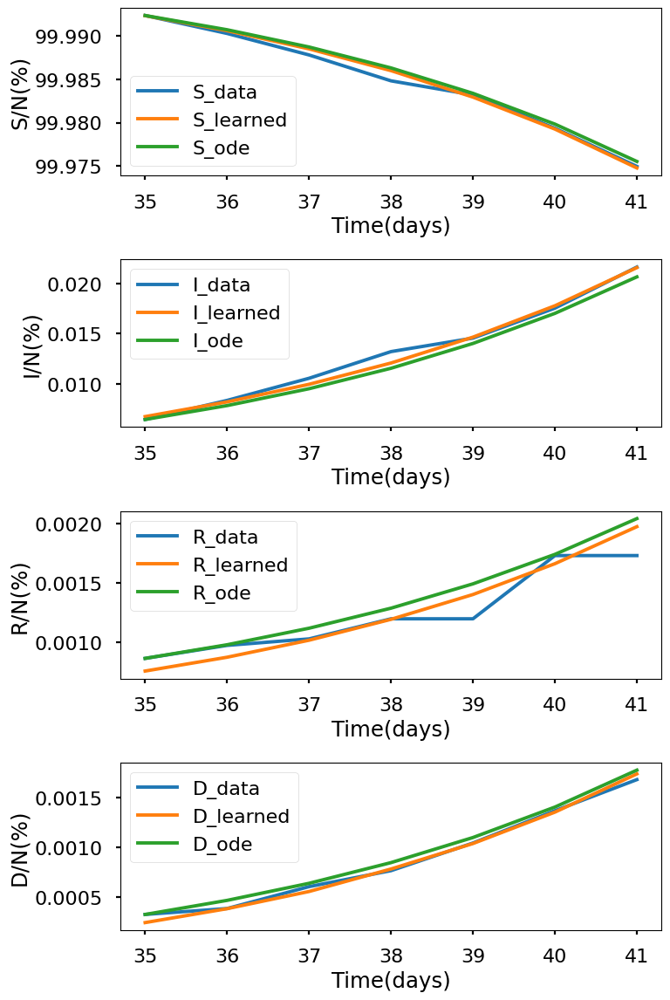

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.933e+00, GE_loss: 2.96540e+00,OB_loss: 1.96773e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.52, cumulative_time: 0.52
It: 10000, Loss: 5.040e-04, GE_loss: 9.73841e-05,OB_loss: 4.06578e-04, Beta: 1.32788e+00,gamma: 7.89569e-01,mu: 7.95204e-01, Time: 19.26, cumulative_time: 19.78
It: 20000, Loss: 1.377e-05, GE_loss: 4.60123e-06,OB_loss: 9.16537e-06, Beta: 1.69404e-01,gamma: 2.30073e-02,mu: 1.68468e-02, Time: 18.33, cumulative_time: 38.11
It: 30000, Loss: 1.278e-05, GE_loss: 1.58360e-06,OB_loss: 1.11995e-05, Beta: 1.70250e-01,gamma: 2.40633e-02,mu: 1.68141e-02, Time: 18.27, cumulative_time: 56.39
It: 40000, Loss: 1.536e-05, GE_loss: 3.93195e-06,OB_loss: 1.14304e-05, Beta: 1.70527e-01,gamma: 2.41503e-02,mu: 1.67448e-02, Time: 17.88, cumulative_time: 74.27
beta:  [0.1700661]
gamma:  [0.02440613]
mu:  [0.01660546]


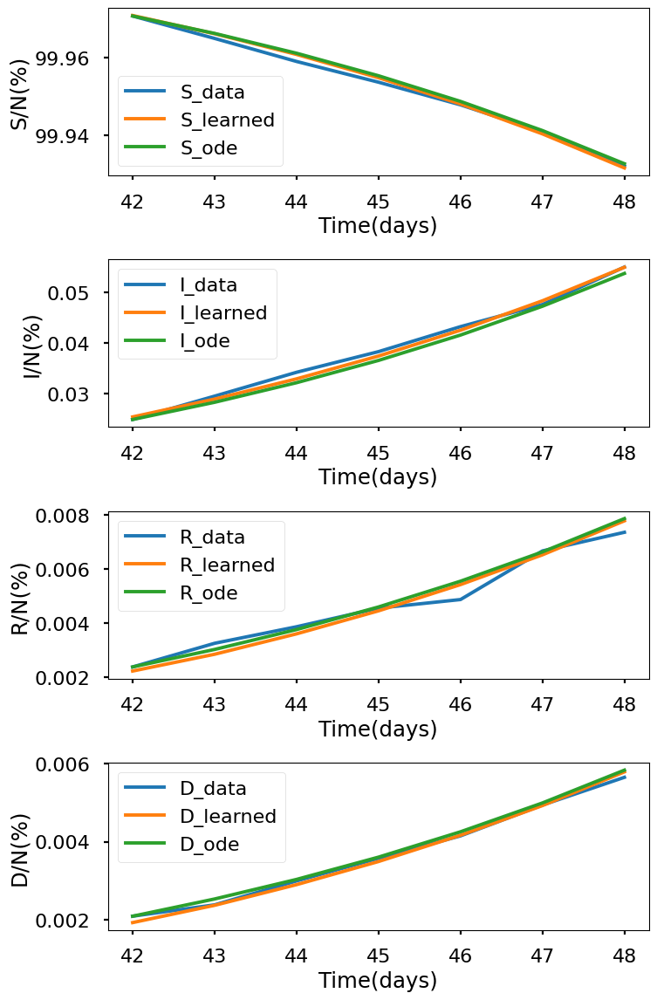

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.988e+00, GE_loss: 3.02189e+00,OB_loss: 1.96568e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.55, cumulative_time: 0.55
It: 10000, Loss: 1.060e-03, GE_loss: 2.01097e-04,OB_loss: 8.58948e-04, Beta: 1.29001e+00,gamma: 7.94688e-01,mu: 8.05945e-01, Time: 18.66, cumulative_time: 19.21
It: 20000, Loss: 2.643e-05, GE_loss: 7.07477e-06,OB_loss: 1.93589e-05, Beta: 1.13415e-01,gamma: 2.09315e-02,mu: 1.41379e-02, Time: 18.32, cumulative_time: 37.53
It: 30000, Loss: 2.734e-05, GE_loss: 7.79360e-06,OB_loss: 1.95489e-05, Beta: 1.12959e-01,gamma: 2.03325e-02,mu: 1.42652e-02, Time: 18.26, cumulative_time: 55.79
It: 40000, Loss: 2.343e-05, GE_loss: 6.32973e-06,OB_loss: 1.71033e-05, Beta: 1.12501e-01,gamma: 2.04065e-02,mu: 1.41490e-02, Time: 18.30, cumulative_time: 74.10
beta:  [0.11229336]
gamma:  [0.02029666]
mu:  [0.01439532]


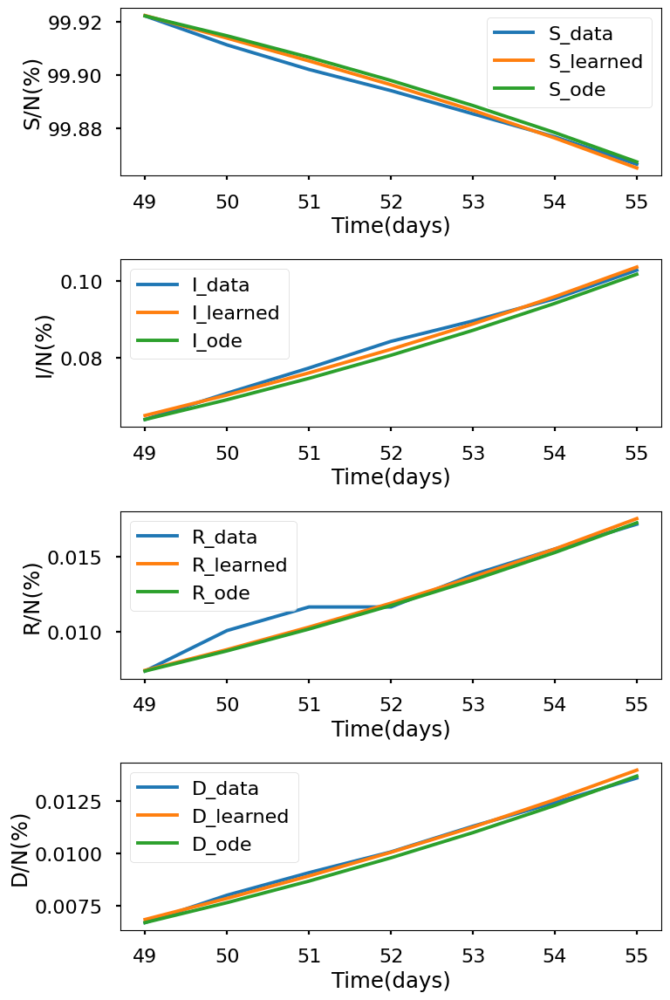

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.905e+00, GE_loss: 2.97989e+00,OB_loss: 1.92494e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.58, cumulative_time: 0.58
It: 10000, Loss: 1.607e-03, GE_loss: 3.44680e-04,OB_loss: 1.26244e-03, Beta: 1.22641e+00,gamma: 8.07328e-01,mu: 8.03047e-01, Time: 18.45, cumulative_time: 19.03
It: 20000, Loss: 2.901e-05, GE_loss: 7.84943e-06,OB_loss: 2.11619e-05, Beta: 6.50088e-02,gamma: 1.62461e-02,mu: 1.06355e-02, Time: 20.17, cumulative_time: 39.20
It: 30000, Loss: 2.523e-05, GE_loss: 5.68919e-06,OB_loss: 1.95365e-05, Beta: 6.50744e-02,gamma: 1.65533e-02,mu: 1.09836e-02, Time: 19.01, cumulative_time: 58.21
It: 40000, Loss: 2.673e-05, GE_loss: 9.53316e-06,OB_loss: 1.71978e-05, Beta: 6.51336e-02,gamma: 1.64231e-02,mu: 1.07969e-02, Time: 18.68, cumulative_time: 76.89
beta:  [0.06496793]
gamma:  [0.01640348]
mu:  [0.0109205]


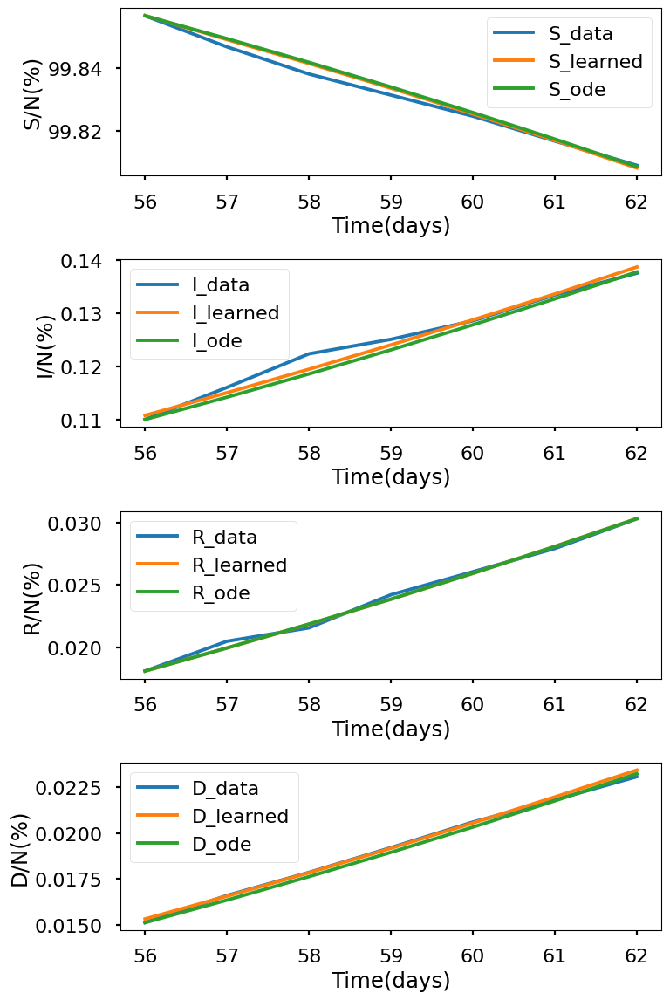

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.920e+00, GE_loss: 2.97448e+00,OB_loss: 1.94597e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.61, cumulative_time: 0.61
It: 10000, Loss: 1.981e-03, GE_loss: 4.35573e-04,OB_loss: 1.54569e-03, Beta: 1.04729e+00,gamma: 8.29367e-01,mu: 7.96109e-01, Time: 18.73, cumulative_time: 19.35
It: 20000, Loss: 2.909e-05, GE_loss: 8.02785e-06,OB_loss: 2.10652e-05, Beta: 4.28236e-02,gamma: 1.57092e-02,mu: 6.57971e-03, Time: 19.82, cumulative_time: 39.17
It: 30000, Loss: 2.592e-05, GE_loss: 2.91244e-06,OB_loss: 2.30091e-05, Beta: 4.30405e-02,gamma: 1.62638e-02,mu: 6.45558e-03, Time: 18.71, cumulative_time: 57.88
It: 40000, Loss: 3.591e-05, GE_loss: 8.94186e-06,OB_loss: 2.69663e-05, Beta: 4.34924e-02,gamma: 1.61864e-02,mu: 6.57062e-03, Time: 18.66, cumulative_time: 76.54
beta:  [0.04336361]
gamma:  [0.01641388]
mu:  [0.00649083]


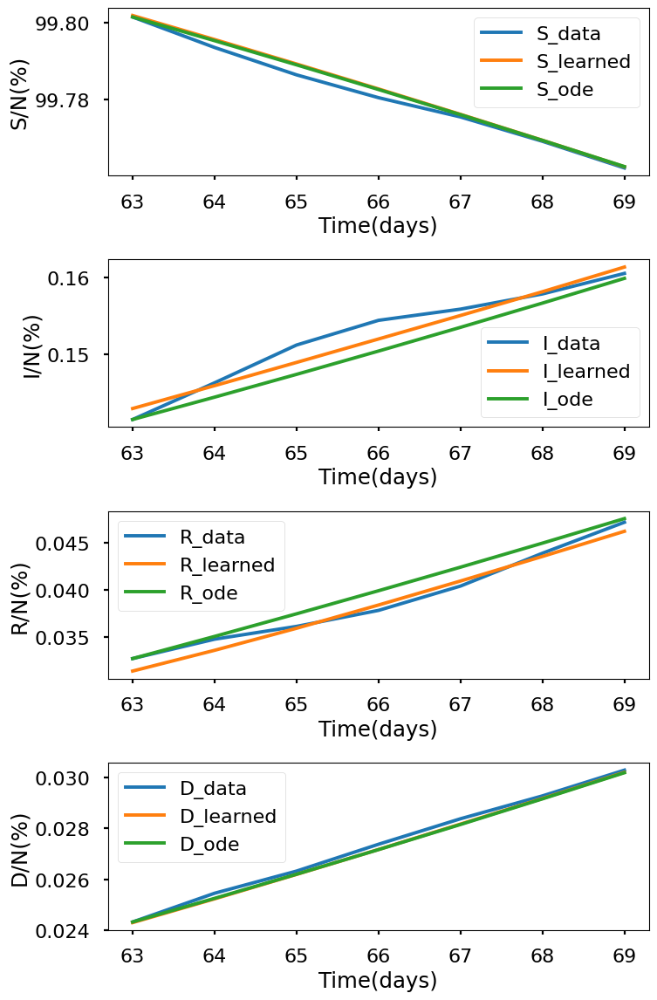

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 5.033e+00, GE_loss: 3.00065e+00,OB_loss: 2.03236e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.69, cumulative_time: 0.69
It: 10000, Loss: 2.205e-03, GE_loss: 4.78227e-04,OB_loss: 1.72653e-03, Beta: 1.13319e+00,gamma: 7.93678e-01,mu: 7.91217e-01, Time: 18.54, cumulative_time: 19.23
It: 20000, Loss: 2.196e-05, GE_loss: 7.13648e-06,OB_loss: 1.48261e-05, Beta: 3.45995e-02,gamma: 1.53063e-02,mu: 5.64905e-03, Time: 18.83, cumulative_time: 38.06
It: 30000, Loss: 2.318e-05, GE_loss: 6.50608e-06,OB_loss: 1.66754e-05, Beta: 3.53409e-02,gamma: 1.53239e-02,mu: 5.76292e-03, Time: 18.84, cumulative_time: 56.91
It: 40000, Loss: 2.513e-05, GE_loss: 4.46006e-06,OB_loss: 2.06703e-05, Beta: 3.51660e-02,gamma: 1.52830e-02,mu: 5.81723e-03, Time: 18.68, cumulative_time: 75.58
beta:  [0.03515373]
gamma:  [0.01530444]
mu:  [0.00574]


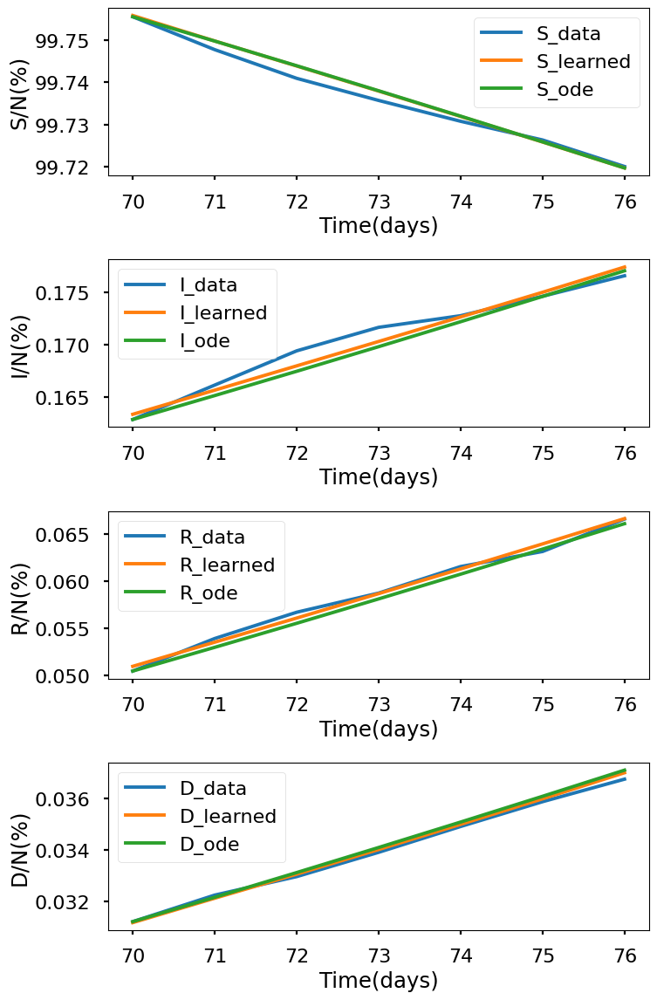

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.847e+00, GE_loss: 2.96033e+00,OB_loss: 1.88716e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.63, cumulative_time: 0.63
It: 10000, Loss: 2.386e-03, GE_loss: 5.78262e-04,OB_loss: 1.80821e-03, Beta: 1.18451e+00,gamma: 8.17801e-01,mu: 7.90168e-01, Time: 18.53, cumulative_time: 19.16
It: 20000, Loss: 2.951e-05, GE_loss: 1.02528e-05,OB_loss: 1.92536e-05, Beta: 2.75714e-02,gamma: 2.27670e-02,mu: 4.46363e-03, Time: 19.90, cumulative_time: 39.05
It: 30000, Loss: 1.531e-05, GE_loss: 2.45298e-06,OB_loss: 1.28535e-05, Beta: 2.72723e-02,gamma: 2.26960e-02,mu: 4.33004e-03, Time: 18.83, cumulative_time: 57.88
It: 40000, Loss: 1.449e-05, GE_loss: 2.23771e-06,OB_loss: 1.22475e-05, Beta: 2.72029e-02,gamma: 2.26843e-02,mu: 4.45658e-03, Time: 18.31, cumulative_time: 76.19
beta:  [0.02756896]
gamma:  [0.02293912]
mu:  [0.00449277]


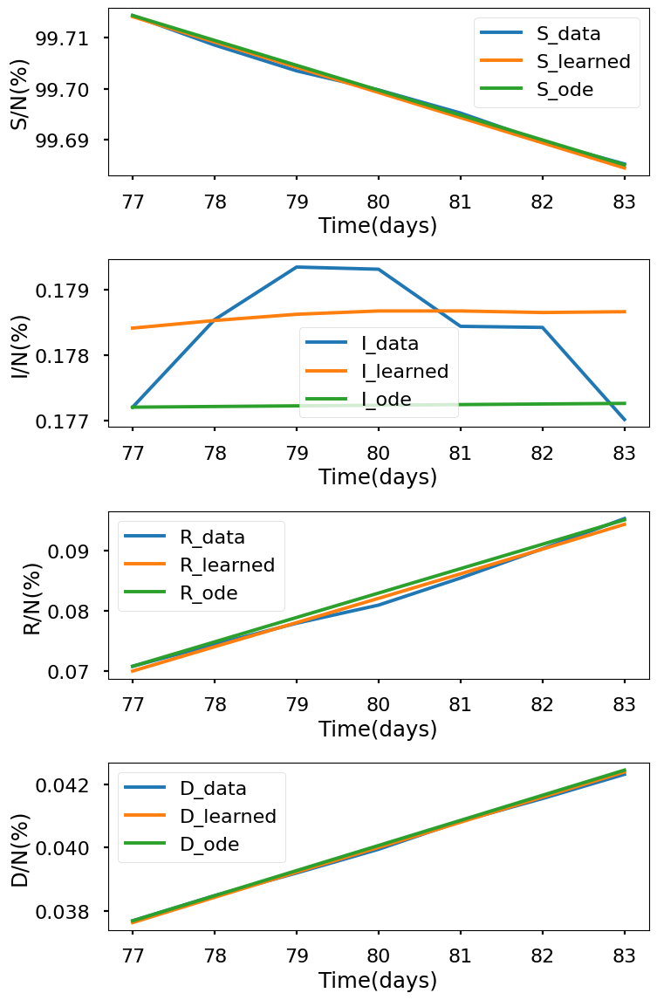

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.931e+00, GE_loss: 2.94965e+00,OB_loss: 1.98176e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.74, cumulative_time: 0.74
It: 10000, Loss: 2.339e-03, GE_loss: 5.99006e-04,OB_loss: 1.74026e-03, Beta: 1.33353e+00,gamma: 7.83052e-01,mu: 7.32637e-01, Time: 18.66, cumulative_time: 19.40
It: 20000, Loss: 3.843e-05, GE_loss: 1.35503e-05,OB_loss: 2.48781e-05, Beta: 1.97159e-02,gamma: 1.97702e-02,mu: 3.14489e-03, Time: 19.49, cumulative_time: 38.89
It: 30000, Loss: 3.768e-05, GE_loss: 1.37973e-05,OB_loss: 2.38851e-05, Beta: 1.96524e-02,gamma: 1.97285e-02,mu: 3.07668e-03, Time: 18.55, cumulative_time: 57.44
It: 40000, Loss: 3.200e-05, GE_loss: 1.33522e-05,OB_loss: 1.86462e-05, Beta: 2.01627e-02,gamma: 1.97626e-02,mu: 3.21503e-03, Time: 18.63, cumulative_time: 76.07
beta:  [0.0201948]
gamma:  [0.01976141]
mu:  [0.00316661]


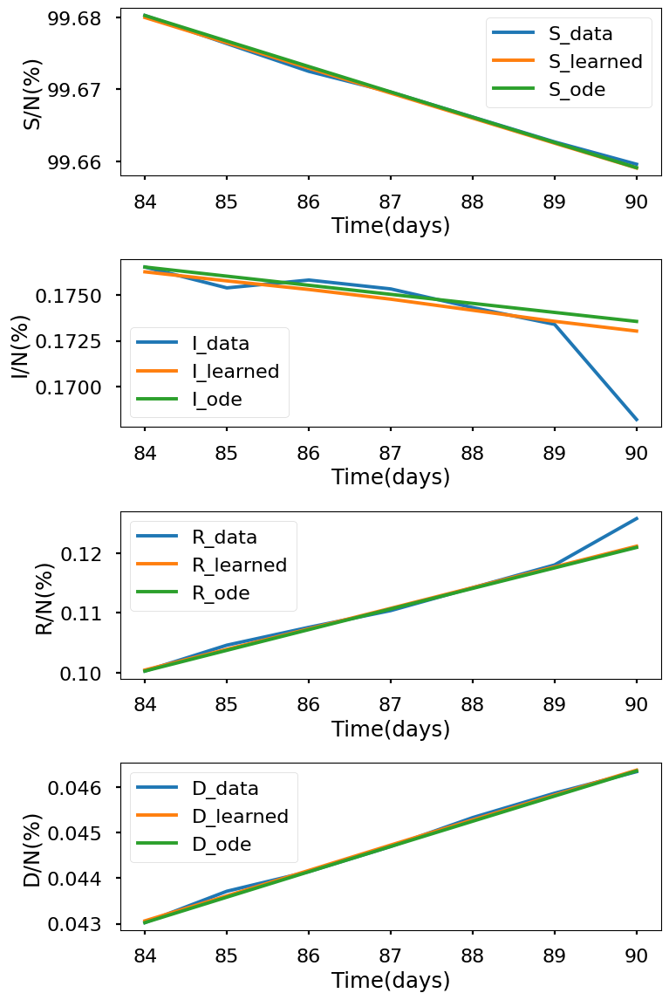

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.946e+00, GE_loss: 2.98584e+00,OB_loss: 1.96034e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.69, cumulative_time: 0.69
It: 10000, Loss: 9.983e-04, GE_loss: 3.85238e-05,OB_loss: 9.59742e-04, Beta: 1.61416e+00,gamma: 8.11921e-01,mu: 8.04574e-01, Time: 22.84, cumulative_time: 23.53
It: 20000, Loss: 8.808e-05, GE_loss: 3.69641e-05,OB_loss: 5.11125e-05, Beta: 1.15609e-02,gamma: 3.68418e-02,mu: 2.71039e-03, Time: 23.23, cumulative_time: 46.76
It: 30000, Loss: 6.288e-05, GE_loss: 1.46296e-05,OB_loss: 4.82520e-05, Beta: 1.17396e-02,gamma: 3.79226e-02,mu: 2.14473e-03, Time: 23.58, cumulative_time: 70.34
It: 40000, Loss: 3.746e-05, GE_loss: 1.20861e-05,OB_loss: 2.53729e-05, Beta: 1.18716e-02,gamma: 3.85393e-02,mu: 2.12350e-03, Time: 23.42, cumulative_time: 93.76
beta:  [0.01190141]
gamma:  [0.03848409]
mu:  [0.0022045]


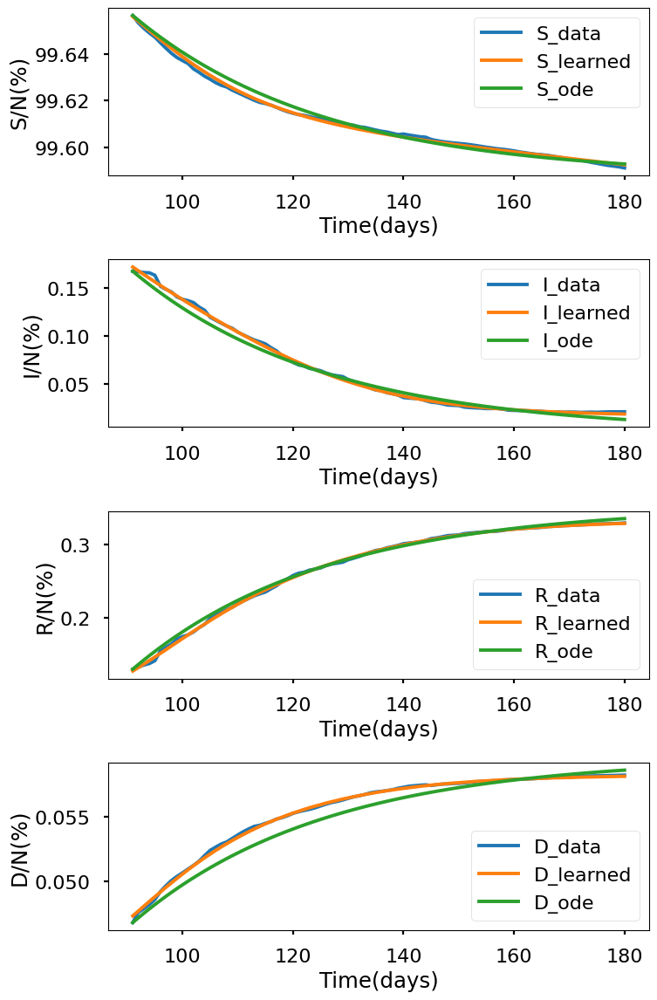

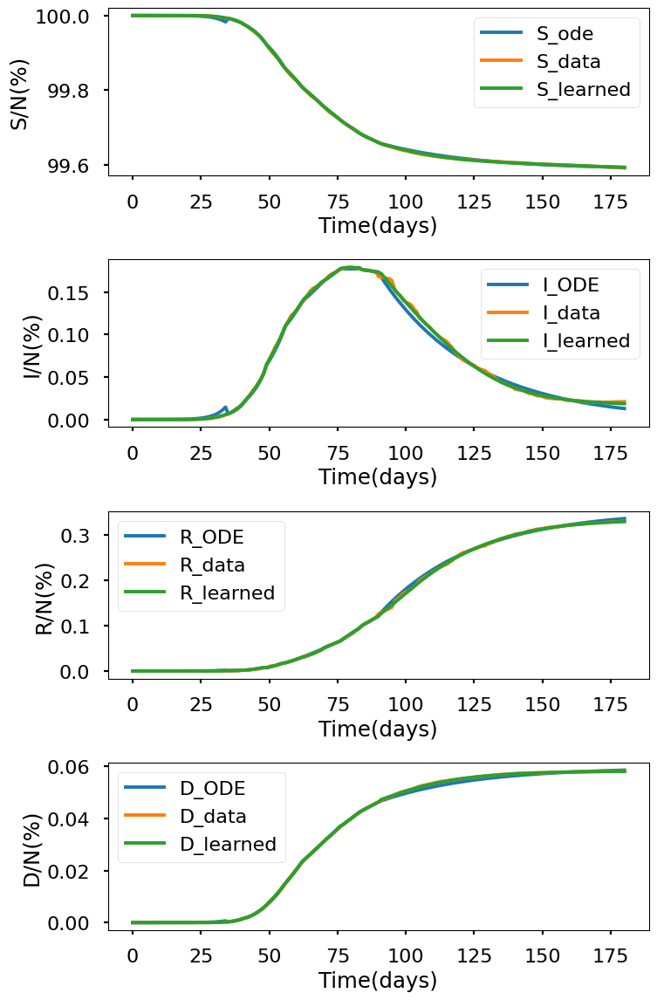

+---------------------+---------------------+-------------+-------------+-------------+-------------+--------------+-------------+--------------+--------------+--------------+
|      Paramaters     | Initial three weeks |   4th week  |   5th week  |   6th week  |   7th week  |   8th week   |   9th week  |  10th week   |  11th week   |  remainder   |
+---------------------+---------------------+-------------+-------------+-------------+-------------+--------------+-------------+--------------+--------------+--------------+
|         beta        |      0.2875927      |  0.22873163 |  0.1700661  | 0.112293355 |  0.06496793 | 0.043363612  | 0.035153728 | 0.027568957  | 0.020194802  | 0.011901413  |
|        gamma        |      0.03153375     |  0.01601683 | 0.024406126 | 0.020296661 | 0.016403481 | 0.016413882  | 0.015304437 | 0.022939121  | 0.019761406  |  0.03848409  |
|          mu         |     0.011300764     | 0.019782737 |  0.01660546 | 0.014395319 | 0.010920498 | 0.0064908327 | 0.0

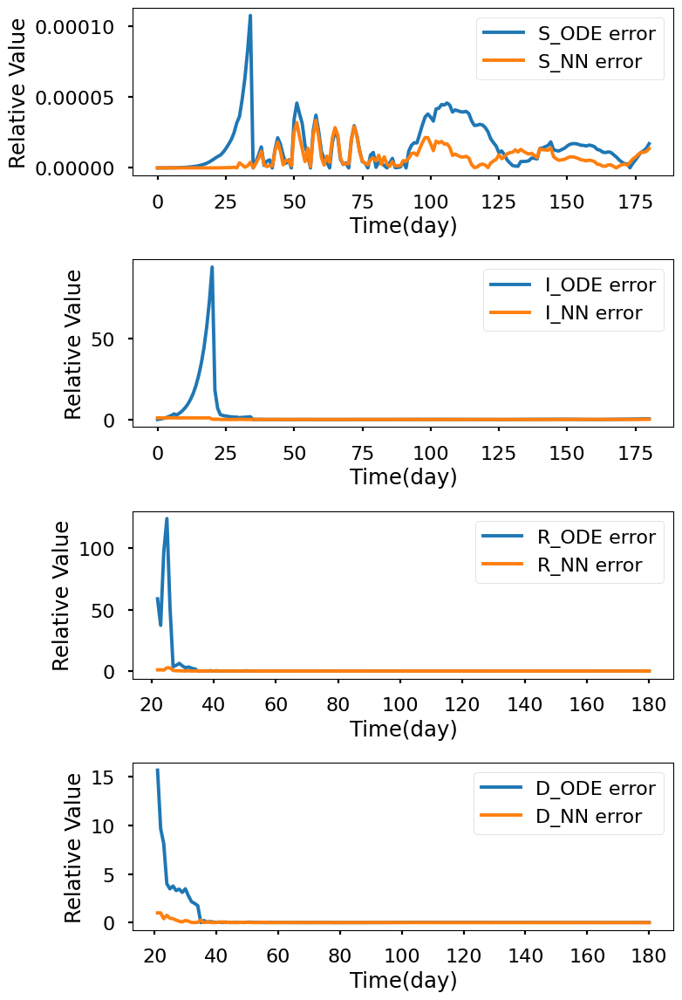

In [8]:
layers216 = [1,16,16,4]
S216_ode,I216_ode,R216_ode,D216_ode,S216_learned,I216_learned,R216_learned,D216_learned,beta216,gamma216,mu_216,S_errnn216,I_errnn216,R_errnn216,D_errnn216,S_erode216,I_errode216,R_errode216,D_errode216,time216 = sum_all(
    layers216,length,SS,II,RC,DC,N0,0.1,50000)

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.947e+00, GE_loss: 2.98636e+00,OB_loss: 1.96089e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.81, cumulative_time: 0.81
It: 10000, Loss: 3.336e-05, GE_loss: 7.07973e-06,OB_loss: 2.62821e-05, Beta: 1.06999e+00,gamma: 8.78417e-01,mu: 8.78417e-01, Time: 24.49, cumulative_time: 25.30
It: 20000, Loss: 7.616e-06, GE_loss: 7.22896e-08,OB_loss: 7.54381e-06, Beta: 1.06999e+00,gamma: 8.46330e-01,mu: 8.46330e-01, Time: 22.70, cumulative_time: 48.00
It: 30000, Loss: 7.515e-06, GE_loss: 1.73820e-08,OB_loss: 7.49717e-06, Beta: 1.06999e+00,gamma: 8.31211e-01,mu: 8.31221e-01, Time: 22.88, cumulative_time: 70.88
It: 40000, Loss: 1.023e-06, GE_loss: 4.14059e-07,OB_loss: 6.09282e-07, Beta: 2.76164e-01,gamma: 2.48076e-02,mu: 1.09442e-02, Time: 22.70, cumulative_time: 93.58
beta:  [0.28433225]
gamma:  [0.03294408]
mu:  [0.01122028]


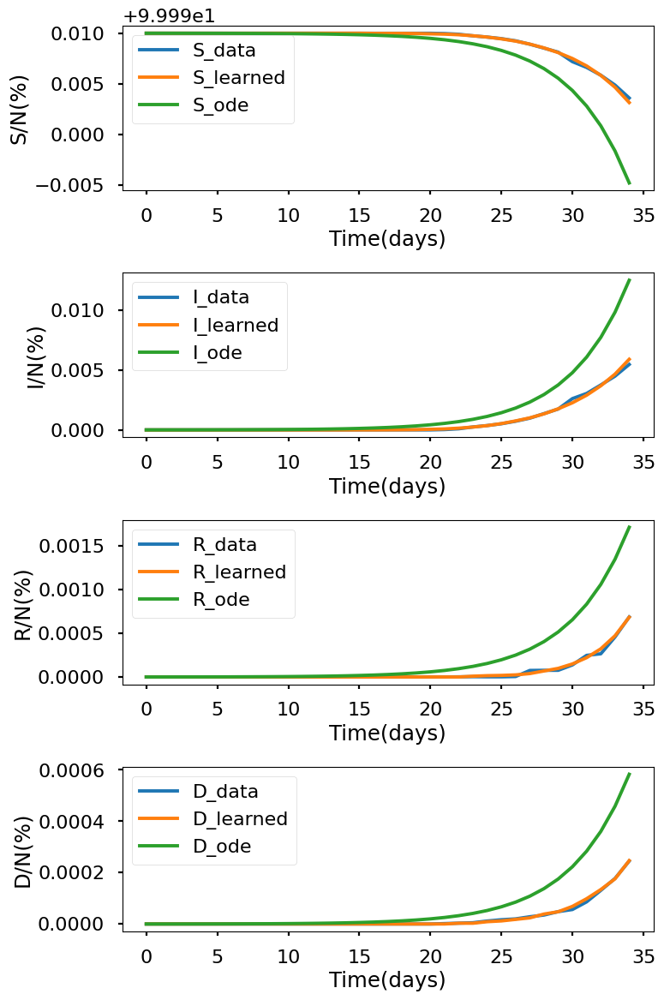

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.785e+00, GE_loss: 2.92753e+00,OB_loss: 1.85787e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.99, cumulative_time: 0.99
It: 10000, Loss: 1.929e-04, GE_loss: 2.21930e-05,OB_loss: 1.70676e-04, Beta: 1.20971e+00,gamma: 8.65190e-01,mu: 8.72769e-01, Time: 20.35, cumulative_time: 21.34
It: 20000, Loss: 1.529e-04, GE_loss: 1.44901e-05,OB_loss: 1.38441e-04, Beta: 1.26434e+00,gamma: 7.88213e-01,mu: 7.76603e-01, Time: 20.50, cumulative_time: 41.84
It: 30000, Loss: 6.135e-06, GE_loss: 1.17282e-06,OB_loss: 4.96254e-06, Beta: 2.26969e-01,gamma: 1.51693e-02,mu: 1.95909e-02, Time: 20.55, cumulative_time: 62.39
It: 40000, Loss: 6.472e-06, GE_loss: 1.10145e-06,OB_loss: 5.37084e-06, Beta: 2.25842e-01,gamma: 1.48011e-02,mu: 1.91106e-02, Time: 20.47, cumulative_time: 82.86
beta:  [0.22636375]
gamma:  [0.01481788]
mu:  [0.01966333]


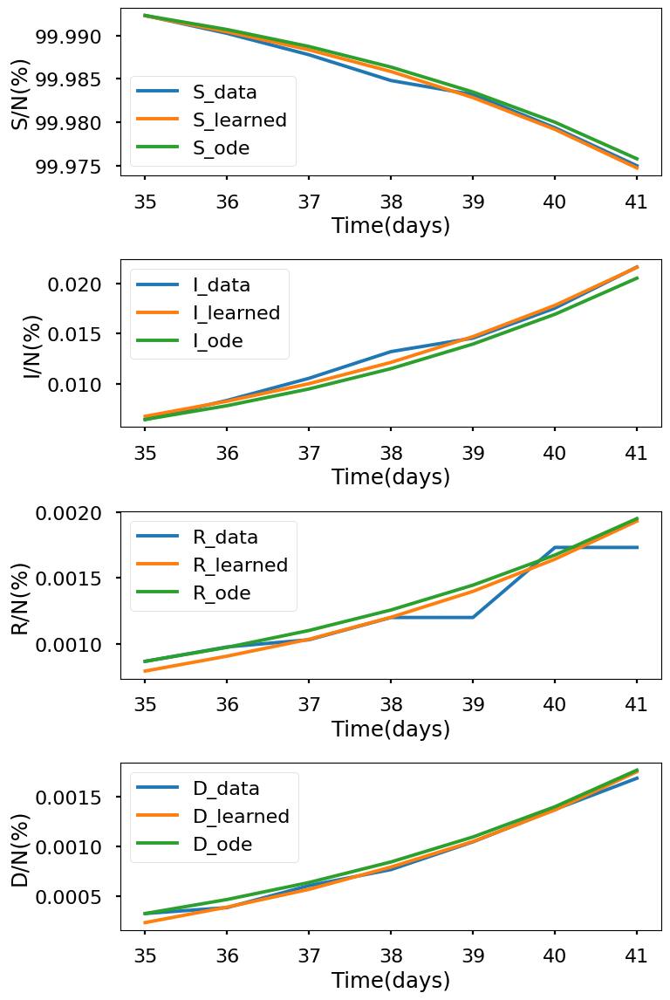

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.783e+00, GE_loss: 2.89244e+00,OB_loss: 1.89060e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.95, cumulative_time: 0.95
It: 10000, Loss: 6.061e-04, GE_loss: 1.88780e-05,OB_loss: 5.87198e-04, Beta: 1.23519e+00,gamma: 8.31388e-01,mu: 8.30545e-01, Time: 20.61, cumulative_time: 21.56
It: 20000, Loss: 1.507e-05, GE_loss: 4.94787e-06,OB_loss: 1.01214e-05, Beta: 1.68914e-01,gamma: 2.34057e-02,mu: 1.73636e-02, Time: 20.80, cumulative_time: 42.37
It: 30000, Loss: 1.380e-05, GE_loss: 4.59533e-06,OB_loss: 9.20555e-06, Beta: 1.66570e-01,gamma: 2.28433e-02,mu: 1.65624e-02, Time: 20.63, cumulative_time: 62.99
It: 40000, Loss: 1.363e-05, GE_loss: 4.02134e-06,OB_loss: 9.60651e-06, Beta: 1.66280e-01,gamma: 2.28373e-02,mu: 1.64399e-02, Time: 20.29, cumulative_time: 83.28
beta:  [0.16594139]
gamma:  [0.02266393]
mu:  [0.01650912]


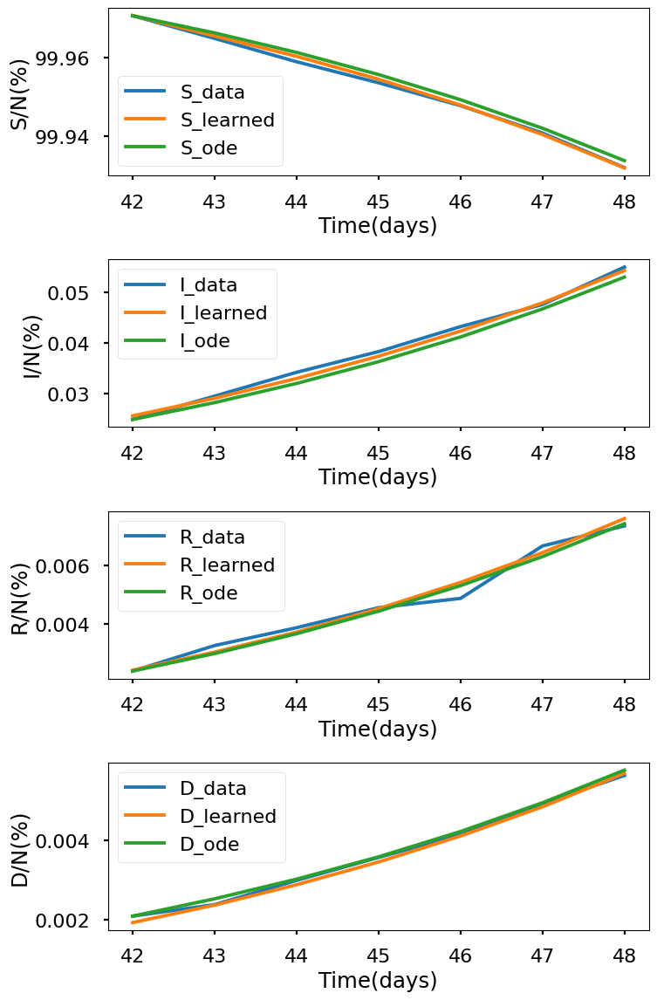

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.907e+00, GE_loss: 2.95867e+00,OB_loss: 1.94870e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.93, cumulative_time: 0.93
It: 10000, Loss: 1.115e-03, GE_loss: 1.87786e-04,OB_loss: 9.26889e-04, Beta: 1.17786e+00,gamma: 8.39048e-01,mu: 8.52927e-01, Time: 20.78, cumulative_time: 21.71
It: 20000, Loss: 2.481e-05, GE_loss: 8.15302e-06,OB_loss: 1.66530e-05, Beta: 1.11172e-01,gamma: 1.96287e-02,mu: 1.42629e-02, Time: 20.83, cumulative_time: 42.55
It: 30000, Loss: 2.658e-05, GE_loss: 1.10299e-05,OB_loss: 1.55466e-05, Beta: 1.11166e-01,gamma: 2.00031e-02,mu: 1.44550e-02, Time: 21.28, cumulative_time: 63.83
It: 40000, Loss: 2.213e-05, GE_loss: 6.39708e-06,OB_loss: 1.57316e-05, Beta: 1.10294e-01,gamma: 1.95173e-02,mu: 1.39729e-02, Time: 21.76, cumulative_time: 85.59
beta:  [0.11052118]
gamma:  [0.01995997]
mu:  [0.01414595]


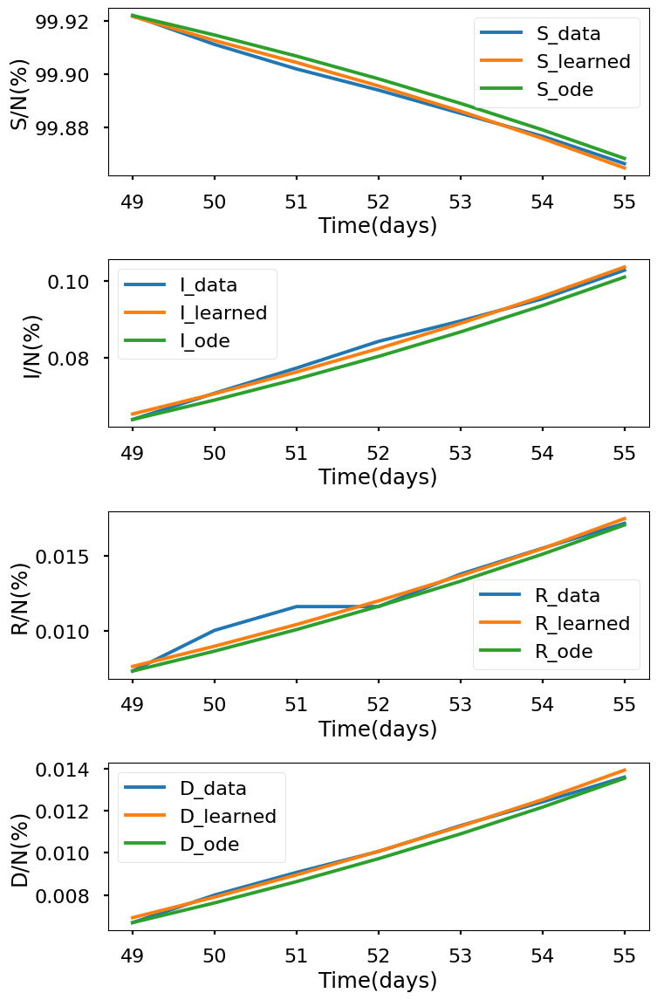

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.963e+00, GE_loss: 2.97731e+00,OB_loss: 1.98544e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.00, cumulative_time: 1.00
It: 10000, Loss: 1.639e-03, GE_loss: 3.32537e-04,OB_loss: 1.30650e-03, Beta: 1.10424e+00,gamma: 8.19078e-01,mu: 8.04253e-01, Time: 19.93, cumulative_time: 20.93
It: 20000, Loss: 2.241e-05, GE_loss: 8.32399e-06,OB_loss: 1.40844e-05, Beta: 6.48269e-02,gamma: 1.61949e-02,mu: 1.12321e-02, Time: 19.89, cumulative_time: 40.82
It: 30000, Loss: 1.836e-05, GE_loss: 3.29723e-06,OB_loss: 1.50609e-05, Beta: 6.57462e-02,gamma: 1.64578e-02,mu: 1.12853e-02, Time: 20.63, cumulative_time: 61.45
It: 40000, Loss: 2.329e-05, GE_loss: 4.79523e-06,OB_loss: 1.84948e-05, Beta: 6.53200e-02,gamma: 1.65673e-02,mu: 1.12146e-02, Time: 21.88, cumulative_time: 83.33
beta:  [0.06633722]
gamma:  [0.01674155]
mu:  [0.01086167]


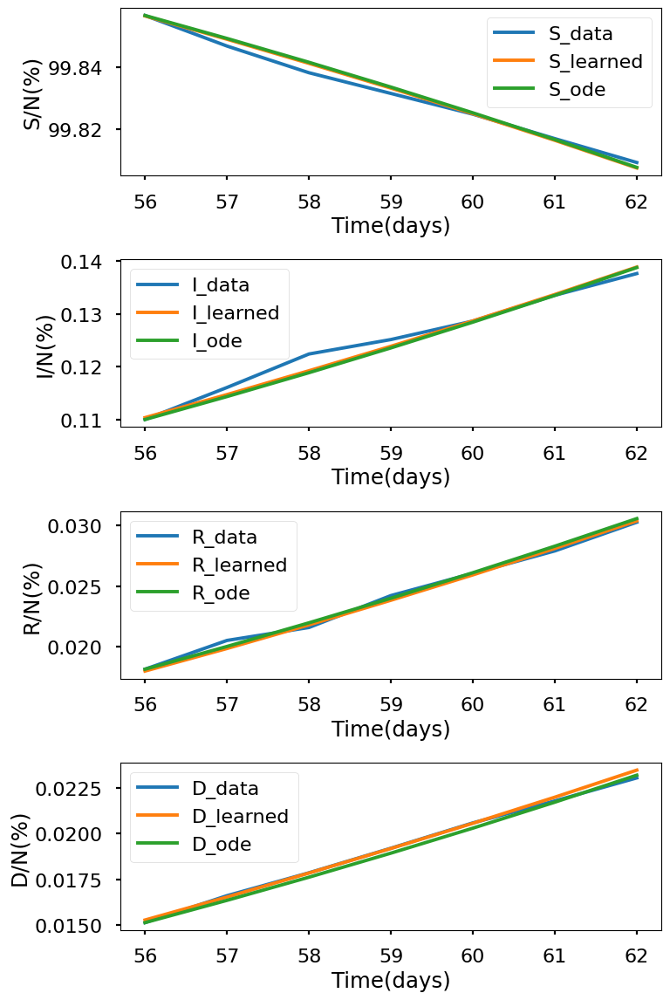

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.929e+00, GE_loss: 2.96893e+00,OB_loss: 1.96050e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.98, cumulative_time: 0.98
It: 10000, Loss: 1.944e-03, GE_loss: 3.83347e-04,OB_loss: 1.56070e-03, Beta: 1.18602e+00,gamma: 7.87023e-01,mu: 7.81661e-01, Time: 20.41, cumulative_time: 21.39
It: 20000, Loss: 2.675e-05, GE_loss: 8.02400e-06,OB_loss: 1.87262e-05, Beta: 4.30443e-02,gamma: 1.52301e-02,mu: 6.60958e-03, Time: 20.51, cumulative_time: 41.90
It: 30000, Loss: 2.968e-05, GE_loss: 7.40458e-06,OB_loss: 2.22769e-05, Beta: 4.37798e-02,gamma: 1.62883e-02,mu: 6.60439e-03, Time: 22.13, cumulative_time: 64.03
It: 40000, Loss: 2.464e-05, GE_loss: 6.29617e-06,OB_loss: 1.83391e-05, Beta: 4.33342e-02,gamma: 1.65334e-02,mu: 6.44880e-03, Time: 20.75, cumulative_time: 84.78
beta:  [0.04394648]
gamma:  [0.0166908]
mu:  [0.00669572]


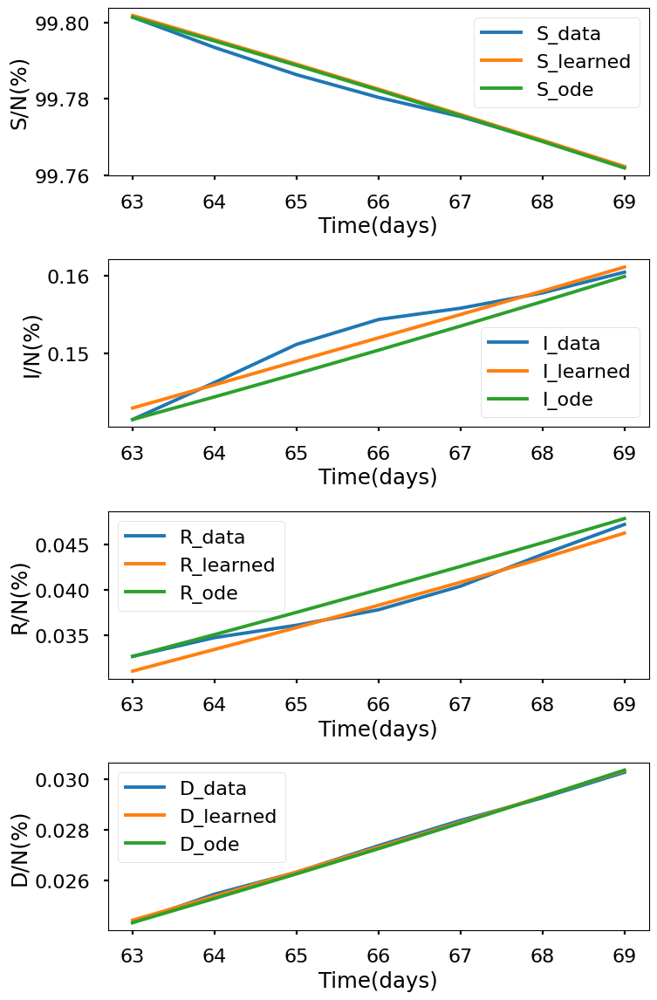

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 5.008e+00, GE_loss: 2.98505e+00,OB_loss: 2.02310e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.96, cumulative_time: 0.96
It: 10000, Loss: 2.172e-03, GE_loss: 4.10055e-04,OB_loss: 1.76217e-03, Beta: 1.19624e+00,gamma: 8.08389e-01,mu: 7.82278e-01, Time: 20.18, cumulative_time: 21.14
It: 20000, Loss: 4.706e-05, GE_loss: 1.76843e-05,OB_loss: 2.93730e-05, Beta: 3.47297e-02,gamma: 1.48607e-02,mu: 5.46442e-03, Time: 21.35, cumulative_time: 42.49
It: 30000, Loss: 2.761e-05, GE_loss: 6.06121e-06,OB_loss: 2.15452e-05, Beta: 3.55766e-02,gamma: 1.54387e-02,mu: 5.59544e-03, Time: 20.36, cumulative_time: 62.86
It: 40000, Loss: 2.071e-05, GE_loss: 4.72617e-06,OB_loss: 1.59805e-05, Beta: 3.55510e-02,gamma: 1.58006e-02,mu: 6.04147e-03, Time: 20.32, cumulative_time: 83.17
beta:  [0.03507072]
gamma:  [0.01521697]
mu:  [0.00563469]


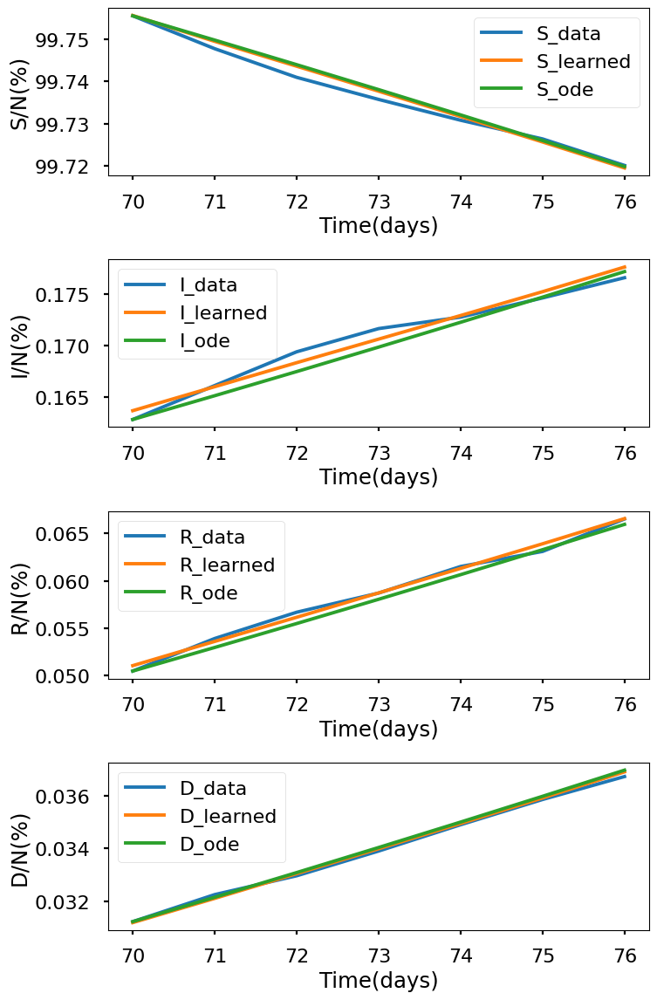

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 5.025e+00, GE_loss: 2.98523e+00,OB_loss: 2.03965e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 0.98, cumulative_time: 0.98
It: 10000, Loss: 2.282e-03, GE_loss: 4.92212e-04,OB_loss: 1.78972e-03, Beta: 1.42259e+00,gamma: 7.82671e-01,mu: 7.56723e-01, Time: 20.24, cumulative_time: 21.22
It: 20000, Loss: 2.054e-05, GE_loss: 5.63935e-06,OB_loss: 1.49009e-05, Beta: 2.59925e-02,gamma: 2.17866e-02,mu: 4.52779e-03, Time: 20.37, cumulative_time: 41.59
It: 30000, Loss: 3.543e-05, GE_loss: 1.34627e-05,OB_loss: 2.19683e-05, Beta: 2.65535e-02,gamma: 2.22392e-02,mu: 4.35531e-03, Time: 20.35, cumulative_time: 61.94
It: 40000, Loss: 1.658e-05, GE_loss: 3.49028e-06,OB_loss: 1.30850e-05, Beta: 2.74250e-02,gamma: 2.28696e-02,mu: 4.38769e-03, Time: 20.20, cumulative_time: 82.14
beta:  [0.02714274]
gamma:  [0.02240858]
mu:  [0.00463906]


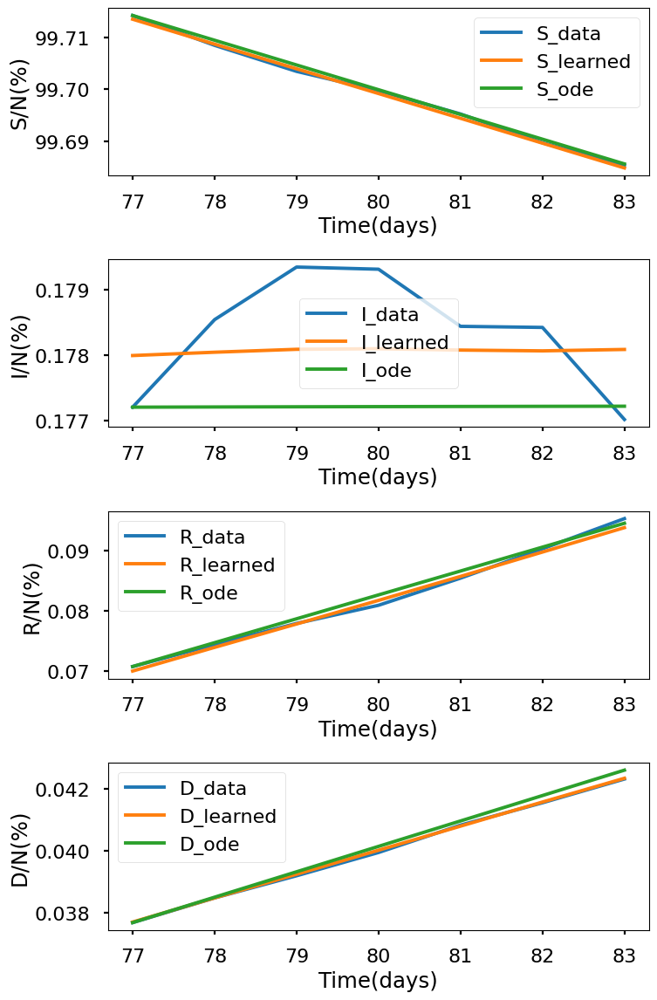

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.863e+00, GE_loss: 2.95315e+00,OB_loss: 1.91030e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.13, cumulative_time: 1.13
It: 10000, Loss: 2.253e-03, GE_loss: 4.56720e-04,OB_loss: 1.79581e-03, Beta: 1.07137e+00,gamma: 8.29383e-01,mu: 7.93108e-01, Time: 20.84, cumulative_time: 21.97
It: 20000, Loss: 4.083e-05, GE_loss: 1.64383e-05,OB_loss: 2.43882e-05, Beta: 2.13533e-02,gamma: 1.92663e-02,mu: 4.13631e-03, Time: 22.81, cumulative_time: 44.78
It: 30000, Loss: 2.761e-05, GE_loss: 1.07535e-05,OB_loss: 1.68605e-05, Beta: 1.98279e-02,gamma: 1.99913e-02,mu: 3.03822e-03, Time: 20.58, cumulative_time: 65.36
It: 40000, Loss: 3.039e-05, GE_loss: 1.17210e-05,OB_loss: 1.86673e-05, Beta: 2.00645e-02,gamma: 1.98358e-02,mu: 3.26605e-03, Time: 20.63, cumulative_time: 85.98
beta:  [0.0203015]
gamma:  [0.02015977]
mu:  [0.00325025]


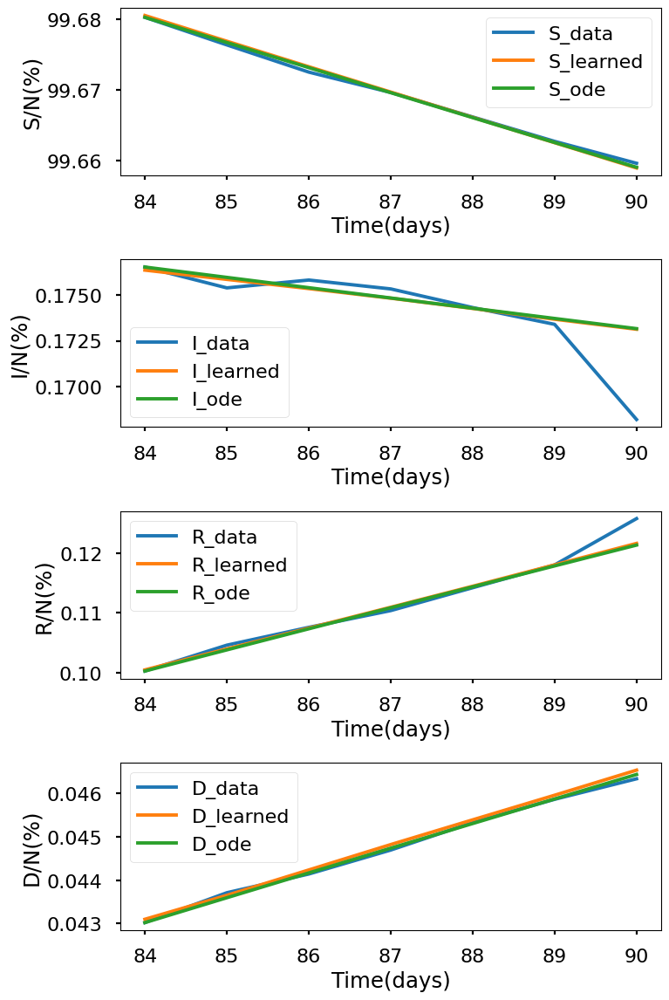

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.902e+00, GE_loss: 2.98670e+00,OB_loss: 1.91539e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.14, cumulative_time: 1.14
It: 10000, Loss: 1.004e-03, GE_loss: 2.23621e-05,OB_loss: 9.81160e-04, Beta: 1.39140e+00,gamma: 8.44091e-01,mu: 8.37944e-01, Time: 26.31, cumulative_time: 27.45
It: 20000, Loss: 9.366e-05, GE_loss: 1.89603e-05,OB_loss: 7.47008e-05, Beta: 1.15835e-02,gamma: 3.77897e-02,mu: 1.85205e-03, Time: 26.09, cumulative_time: 53.54
It: 30000, Loss: 4.212e-05, GE_loss: 1.13801e-05,OB_loss: 3.07392e-05, Beta: 1.15508e-02,gamma: 3.88354e-02,mu: 1.89490e-03, Time: 26.06, cumulative_time: 79.60
It: 40000, Loss: 6.764e-05, GE_loss: 1.28731e-05,OB_loss: 5.47665e-05, Beta: 1.18071e-02,gamma: 3.91809e-02,mu: 2.13792e-03, Time: 30.07, cumulative_time: 109.67
beta:  [0.0117994]
gamma:  [0.03854178]
mu:  [0.00197899]


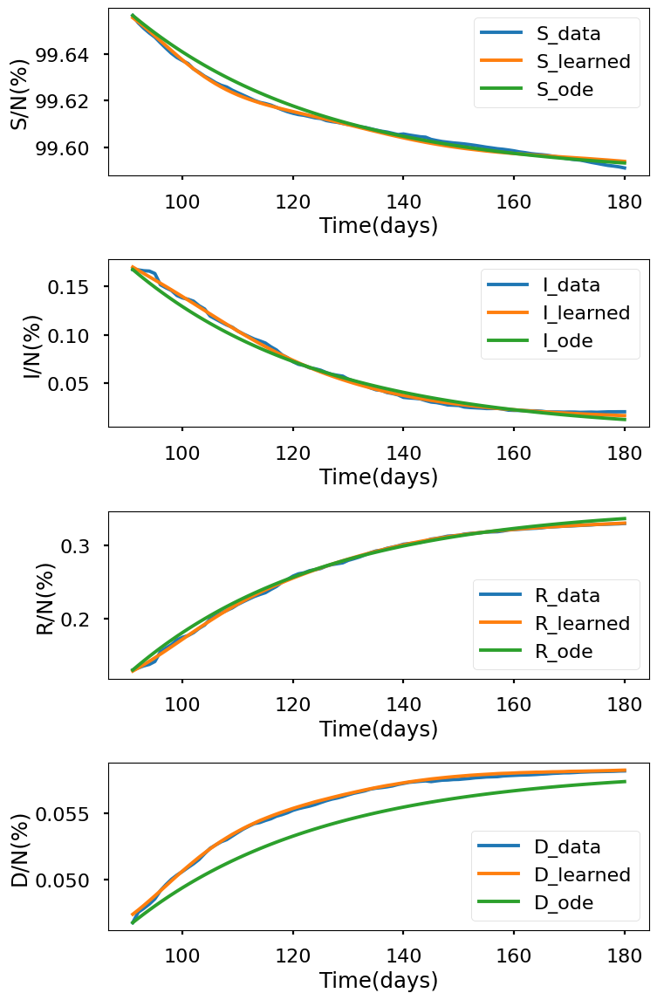

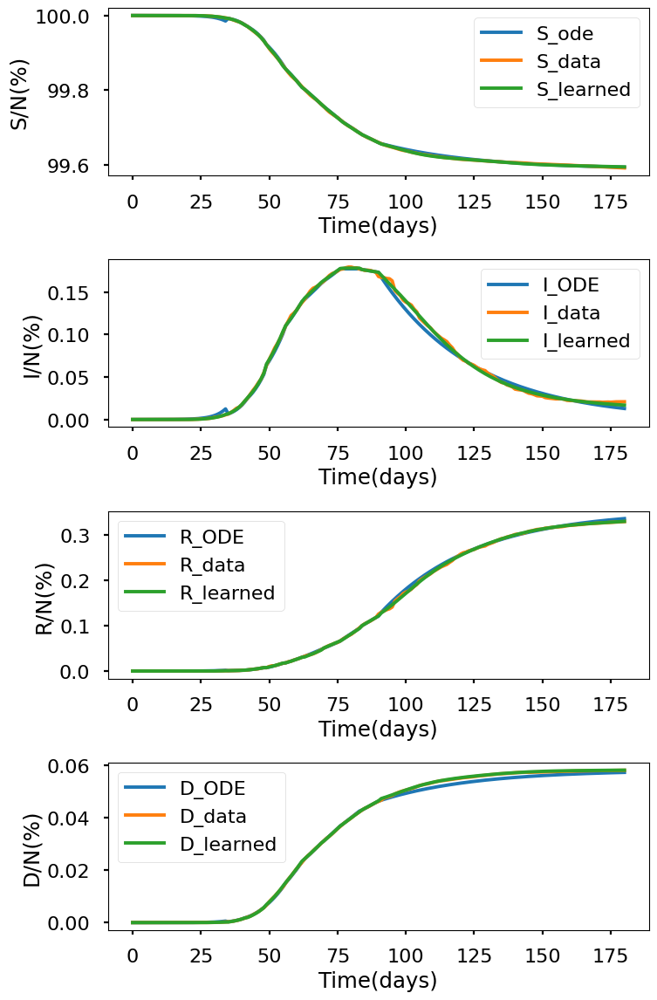

+---------------------+---------------------+-------------+-------------+-------------+--------------+--------------+--------------+--------------+--------------+-------------+
|      Paramaters     | Initial three weeks |   4th week  |   5th week  |   6th week  |   7th week   |   8th week   |   9th week   |  10th week   |  11th week   |  remainder  |
+---------------------+---------------------+-------------+-------------+-------------+--------------+--------------+--------------+--------------+--------------+-------------+
|         beta        |      0.28433225     |  0.22636375 |  0.16594139 |  0.11052118 |  0.06633722  | 0.043946482  | 0.035070725  | 0.027142745  |  0.0203015   |  0.0117994  |
|        gamma        |     0.032944076     | 0.014817877 | 0.022663927 | 0.019959966 | 0.016741551  | 0.016690802  | 0.015216973  |  0.02240858  |  0.02015977  | 0.038541775 |
|          mu         |      0.01122028     | 0.019663332 | 0.016509116 | 0.014145946 | 0.0108616715 | 0.0066957176

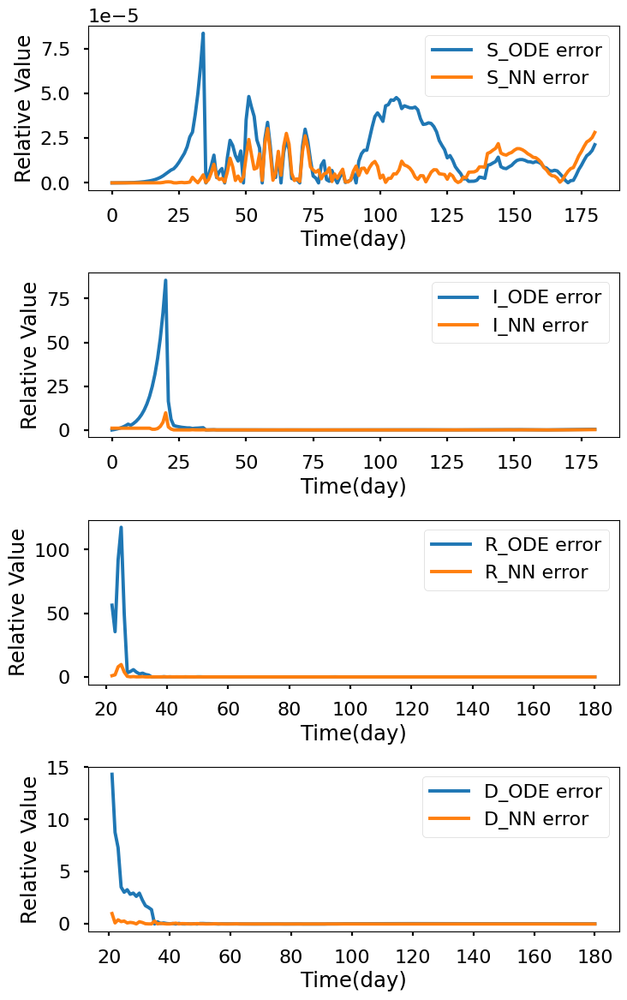

In [9]:
layers316 = [1,16,16,16,4]
S316_ode,I316_ode,R316_ode,D316_ode,S316_learned,I316_learned,R316_learned,D316_learned,beta316,gamma316,mu316,S_errnn316,I_errnn316,R_errnn316,D_errnn316,S_erode316,I_errode316,R_errode316,D_errode316,time316 = sum_all(
    layers316,length,SS,II,RC,DC,N0,0.1,50000)

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.924e+00, GE_loss: 2.97336e+00,OB_loss: 1.95112e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.34, cumulative_time: 1.34
It: 10000, Loss: 4.082e-05, GE_loss: 9.38475e-06,OB_loss: 3.14395e-05, Beta: 1.09149e+00,gamma: 8.78384e-01,mu: 8.78384e-01, Time: 24.97, cumulative_time: 26.32
It: 20000, Loss: 7.602e-06, GE_loss: 1.09102e-07,OB_loss: 7.49332e-06, Beta: 1.09149e+00,gamma: 8.37290e-01,mu: 8.37290e-01, Time: 24.87, cumulative_time: 51.18
It: 30000, Loss: 7.512e-06, GE_loss: 3.36178e-08,OB_loss: 7.47881e-06, Beta: 1.09149e+00,gamma: 8.33744e-01,mu: 8.33744e-01, Time: 25.53, cumulative_time: 76.71
It: 40000, Loss: 8.901e-07, GE_loss: 3.63412e-07,OB_loss: 5.26718e-07, Beta: 2.86008e-01,gamma: 3.07499e-02,mu: 1.12613e-02, Time: 26.91, cumulative_time: 103.63
beta:  [0.28575483]
gamma:  [0.03200138]
mu:  [0.01151525]


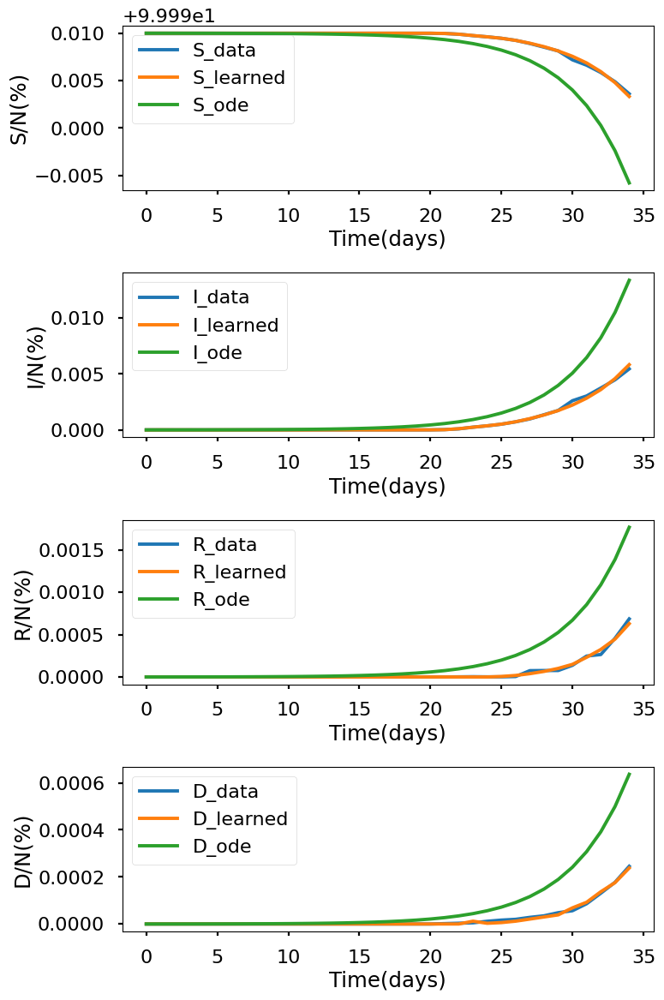

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.963e+00, GE_loss: 2.96357e+00,OB_loss: 1.99893e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.34, cumulative_time: 1.34
It: 10000, Loss: 1.948e-04, GE_loss: 1.84734e-05,OB_loss: 1.76290e-04, Beta: 1.25057e+00,gamma: 8.53755e-01,mu: 8.54271e-01, Time: 22.07, cumulative_time: 23.41
It: 20000, Loss: 8.427e-06, GE_loss: 2.88076e-06,OB_loss: 5.54631e-06, Beta: 2.20251e-01,gamma: 1.42089e-02,mu: 1.44126e-02, Time: 22.55, cumulative_time: 45.96
It: 30000, Loss: 6.110e-06, GE_loss: 7.02397e-07,OB_loss: 5.40780e-06, Beta: 2.28693e-01,gamma: 1.58322e-02,mu: 1.99003e-02, Time: 22.53, cumulative_time: 68.49
It: 40000, Loss: 5.771e-06, GE_loss: 7.84836e-07,OB_loss: 4.98617e-06, Beta: 2.26558e-01,gamma: 1.52731e-02,mu: 1.98039e-02, Time: 22.09, cumulative_time: 90.57
beta:  [0.22575481]
gamma:  [0.0147001]
mu:  [0.01957967]


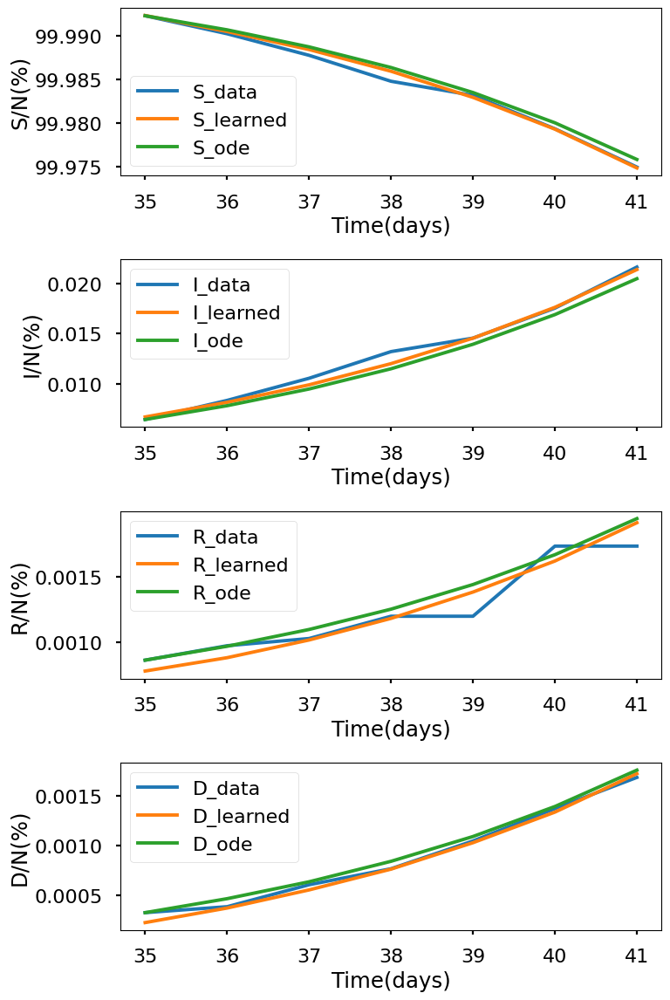

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.988e+00, GE_loss: 2.98913e+00,OB_loss: 1.99904e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.32, cumulative_time: 1.32
It: 10000, Loss: 6.066e-04, GE_loss: 3.37796e-05,OB_loss: 5.72821e-04, Beta: 1.26849e+00,gamma: 8.04519e-01,mu: 8.03293e-01, Time: 21.96, cumulative_time: 23.28
It: 20000, Loss: 1.368e-05, GE_loss: 4.91502e-06,OB_loss: 8.76494e-06, Beta: 1.67688e-01,gamma: 2.24953e-02,mu: 1.68643e-02, Time: 21.95, cumulative_time: 45.23
It: 30000, Loss: 1.184e-05, GE_loss: 2.98829e-06,OB_loss: 8.85023e-06, Beta: 1.66437e-01,gamma: 2.30123e-02,mu: 1.66430e-02, Time: 21.71, cumulative_time: 66.94
It: 40000, Loss: 1.300e-05, GE_loss: 4.35475e-06,OB_loss: 8.64877e-06, Beta: 1.66216e-01,gamma: 2.30037e-02,mu: 1.68173e-02, Time: 21.88, cumulative_time: 88.82
beta:  [0.1656692]
gamma:  [0.02253526]
mu:  [0.01636305]


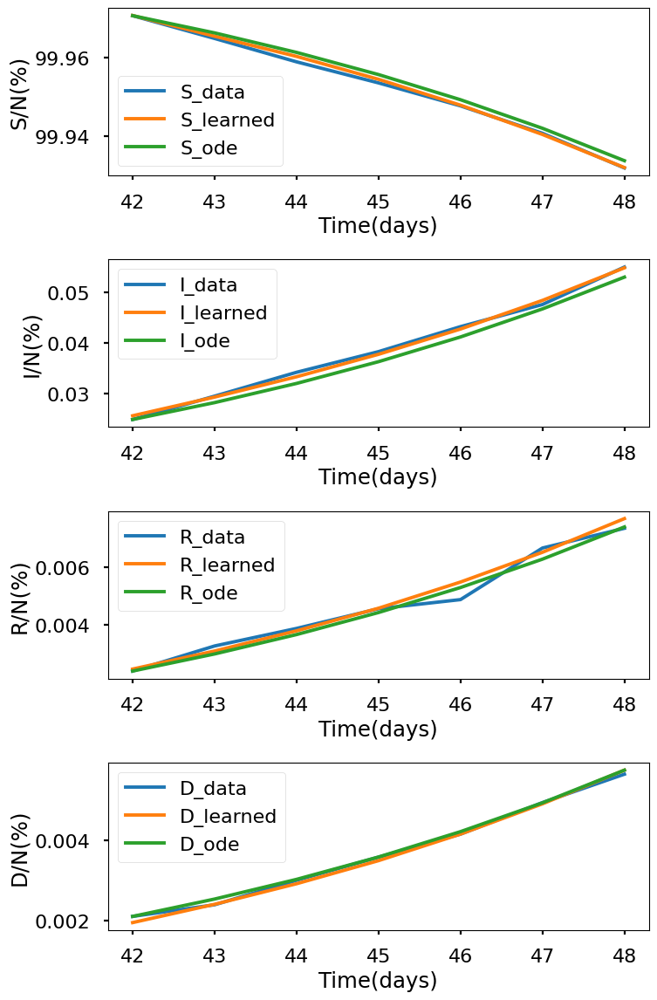

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 5.047e+00, GE_loss: 2.99398e+00,OB_loss: 2.05290e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.31, cumulative_time: 1.31
It: 10000, Loss: 1.101e-03, GE_loss: 1.77681e-04,OB_loss: 9.23429e-04, Beta: 1.20345e+00,gamma: 8.23380e-01,mu: 8.24804e-01, Time: 22.00, cumulative_time: 23.31
It: 20000, Loss: 2.619e-05, GE_loss: 9.12144e-06,OB_loss: 1.70643e-05, Beta: 1.11780e-01,gamma: 1.99192e-02,mu: 1.44533e-02, Time: 22.05, cumulative_time: 45.36
It: 30000, Loss: 2.727e-05, GE_loss: 8.13938e-06,OB_loss: 1.91262e-05, Beta: 1.11579e-01,gamma: 2.00036e-02,mu: 1.43328e-02, Time: 22.57, cumulative_time: 67.93
It: 40000, Loss: 2.709e-05, GE_loss: 9.78487e-06,OB_loss: 1.73041e-05, Beta: 1.11127e-01,gamma: 1.95822e-02,mu: 1.37967e-02, Time: 21.86, cumulative_time: 89.80
beta:  [0.11038419]
gamma:  [0.01974767]
mu:  [0.01406177]


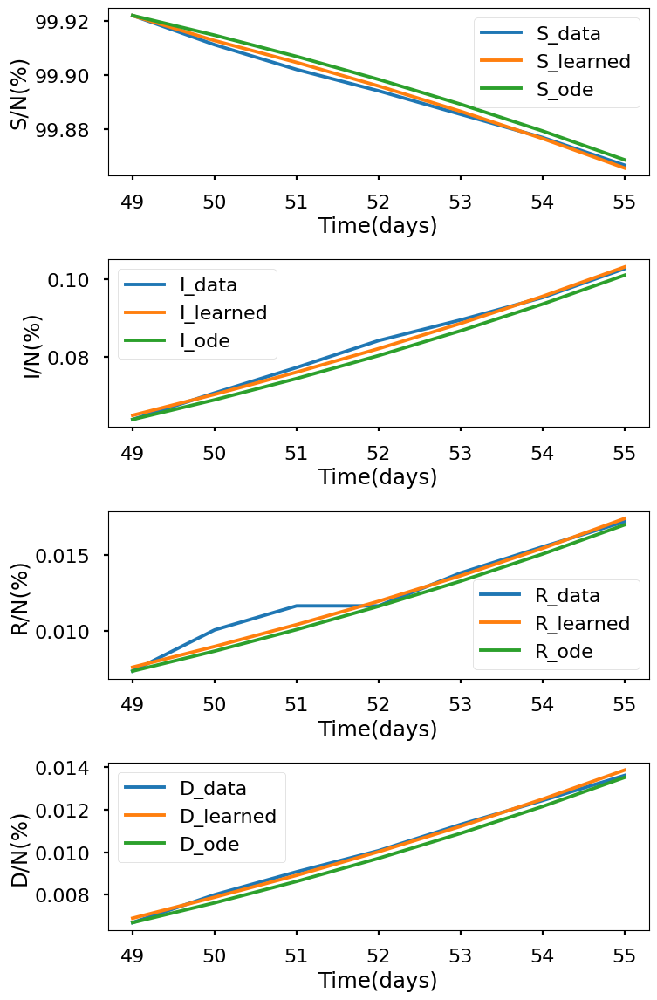

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 5.092e+00, GE_loss: 3.01022e+00,OB_loss: 2.08194e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.42, cumulative_time: 1.42
It: 10000, Loss: 1.644e-03, GE_loss: 3.33687e-04,OB_loss: 1.30988e-03, Beta: 1.19025e+00,gamma: 7.50271e-01,mu: 7.62310e-01, Time: 22.13, cumulative_time: 23.55
It: 20000, Loss: 2.238e-05, GE_loss: 5.67475e-06,OB_loss: 1.67043e-05, Beta: 6.57027e-02,gamma: 1.64524e-02,mu: 1.06611e-02, Time: 22.26, cumulative_time: 45.81
It: 30000, Loss: 2.621e-05, GE_loss: 5.02357e-06,OB_loss: 2.11822e-05, Beta: 6.59177e-02,gamma: 1.65750e-02,mu: 1.09837e-02, Time: 22.10, cumulative_time: 67.91
It: 40000, Loss: 3.106e-05, GE_loss: 9.88005e-06,OB_loss: 2.11763e-05, Beta: 6.60181e-02,gamma: 1.64874e-02,mu: 1.08683e-02, Time: 22.23, cumulative_time: 90.13
beta:  [0.06490382]
gamma:  [0.01638347]
mu:  [0.01079397]


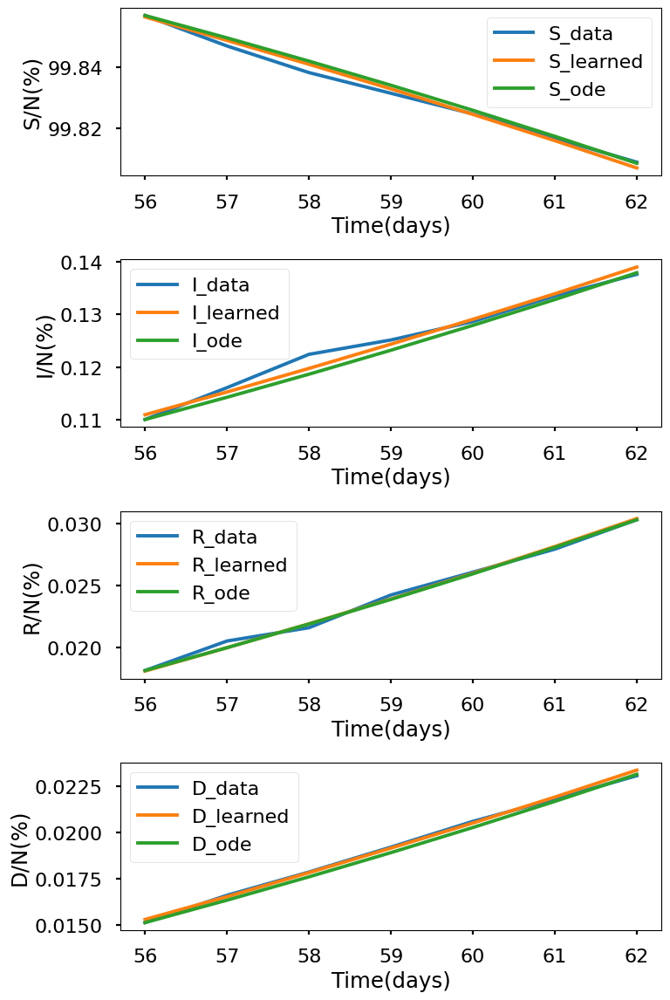

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.810e+00, GE_loss: 2.90519e+00,OB_loss: 1.90476e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.45, cumulative_time: 1.45
It: 10000, Loss: 2.020e-03, GE_loss: 4.29402e-04,OB_loss: 1.59052e-03, Beta: 1.13027e+00,gamma: 7.88012e-01,mu: 8.05673e-01, Time: 21.98, cumulative_time: 23.43
It: 20000, Loss: 2.876e-05, GE_loss: 4.25298e-06,OB_loss: 2.45119e-05, Beta: 4.36224e-02,gamma: 1.63640e-02,mu: 6.87257e-03, Time: 22.28, cumulative_time: 45.71
It: 30000, Loss: 2.879e-05, GE_loss: 6.67252e-06,OB_loss: 2.21169e-05, Beta: 4.34753e-02,gamma: 1.64156e-02,mu: 6.57462e-03, Time: 23.14, cumulative_time: 68.85
It: 40000, Loss: 2.645e-05, GE_loss: 2.99022e-06,OB_loss: 2.34643e-05, Beta: 4.40509e-02,gamma: 1.65828e-02,mu: 6.50905e-03, Time: 22.32, cumulative_time: 91.17
beta:  [0.04314724]
gamma:  [0.01628181]
mu:  [0.00650467]


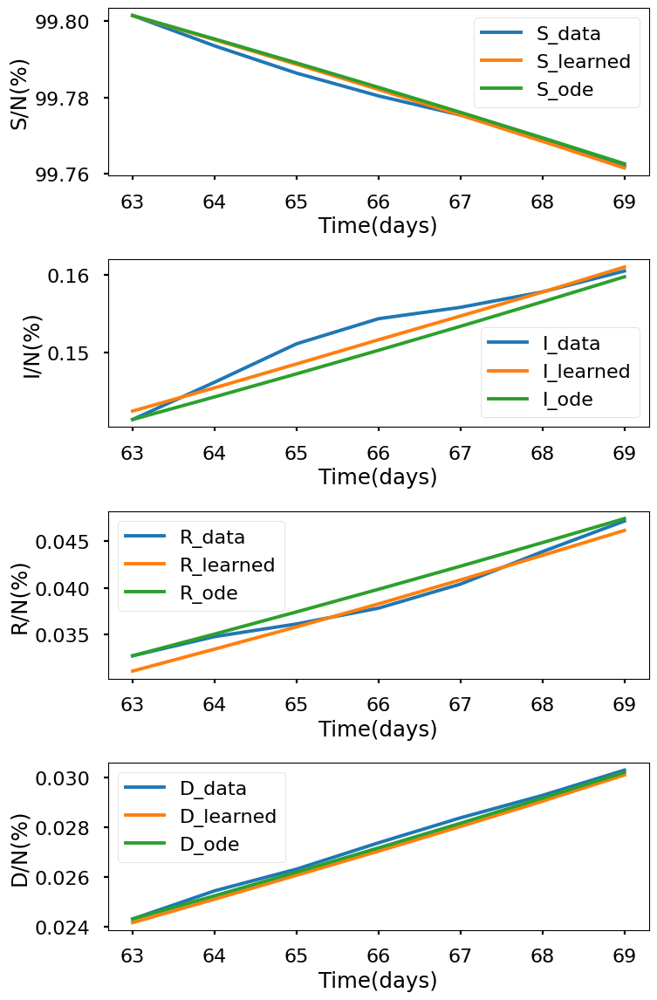

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.957e+00, GE_loss: 2.94480e+00,OB_loss: 2.01173e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.48, cumulative_time: 1.48
It: 10000, Loss: 2.328e-03, GE_loss: 3.99884e-04,OB_loss: 1.92787e-03, Beta: 1.20503e+00,gamma: 8.53644e-01,mu: 8.52237e-01, Time: 22.22, cumulative_time: 23.70
It: 20000, Loss: 3.059e-05, GE_loss: 1.11592e-05,OB_loss: 1.94340e-05, Beta: 3.41611e-02,gamma: 1.49937e-02,mu: 5.69920e-03, Time: 21.99, cumulative_time: 45.68
It: 30000, Loss: 3.627e-05, GE_loss: 9.37446e-06,OB_loss: 2.69005e-05, Beta: 3.45019e-02,gamma: 1.51823e-02,mu: 5.47476e-03, Time: 22.38, cumulative_time: 68.07
It: 40000, Loss: 1.868e-05, GE_loss: 4.69998e-06,OB_loss: 1.39751e-05, Beta: 3.52179e-02,gamma: 1.53131e-02,mu: 5.70495e-03, Time: 21.59, cumulative_time: 89.66
beta:  [0.0343955]
gamma:  [0.01518479]
mu:  [0.00579307]


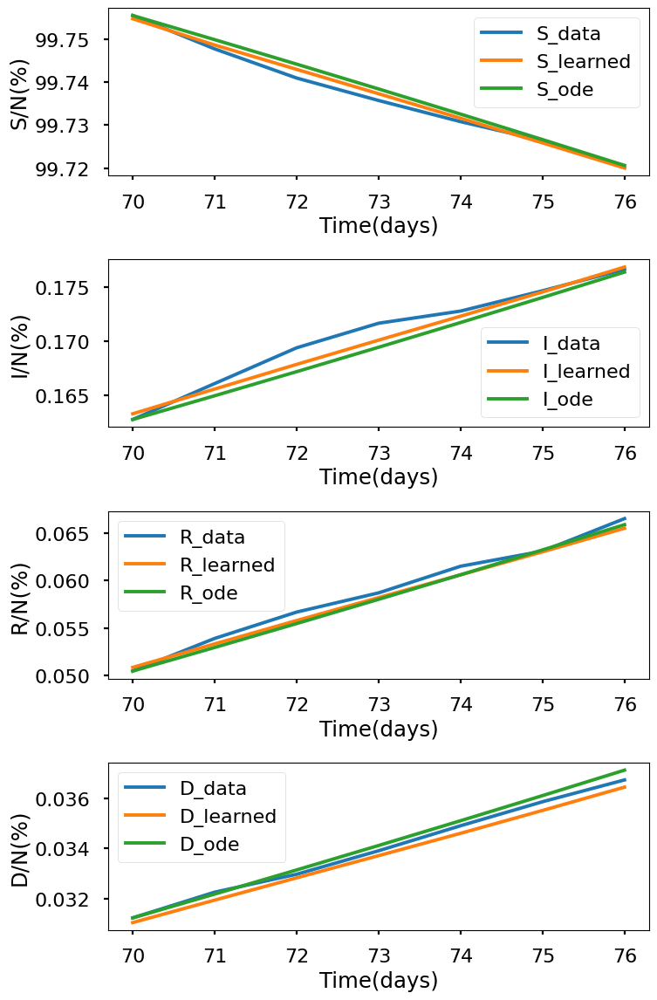

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.957e+00, GE_loss: 2.96081e+00,OB_loss: 1.99617e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.39, cumulative_time: 1.39
It: 10000, Loss: 2.324e-03, GE_loss: 4.45098e-04,OB_loss: 1.87893e-03, Beta: 1.02577e+00,gamma: 8.09287e-01,mu: 8.07160e-01, Time: 21.78, cumulative_time: 23.17
It: 20000, Loss: 1.857e-05, GE_loss: 4.69935e-06,OB_loss: 1.38706e-05, Beta: 2.74141e-02,gamma: 2.19695e-02,mu: 4.44706e-03, Time: 21.50, cumulative_time: 44.67
It: 30000, Loss: 4.137e-05, GE_loss: 1.97416e-05,OB_loss: 2.16261e-05, Beta: 2.74517e-02,gamma: 2.24141e-02,mu: 4.34667e-03, Time: 21.60, cumulative_time: 66.27
It: 40000, Loss: 2.139e-05, GE_loss: 3.22577e-06,OB_loss: 1.81664e-05, Beta: 2.75678e-02,gamma: 2.26186e-02,mu: 4.58885e-03, Time: 21.82, cumulative_time: 88.09
beta:  [0.02663447]
gamma:  [0.02238209]
mu:  [0.00423586]


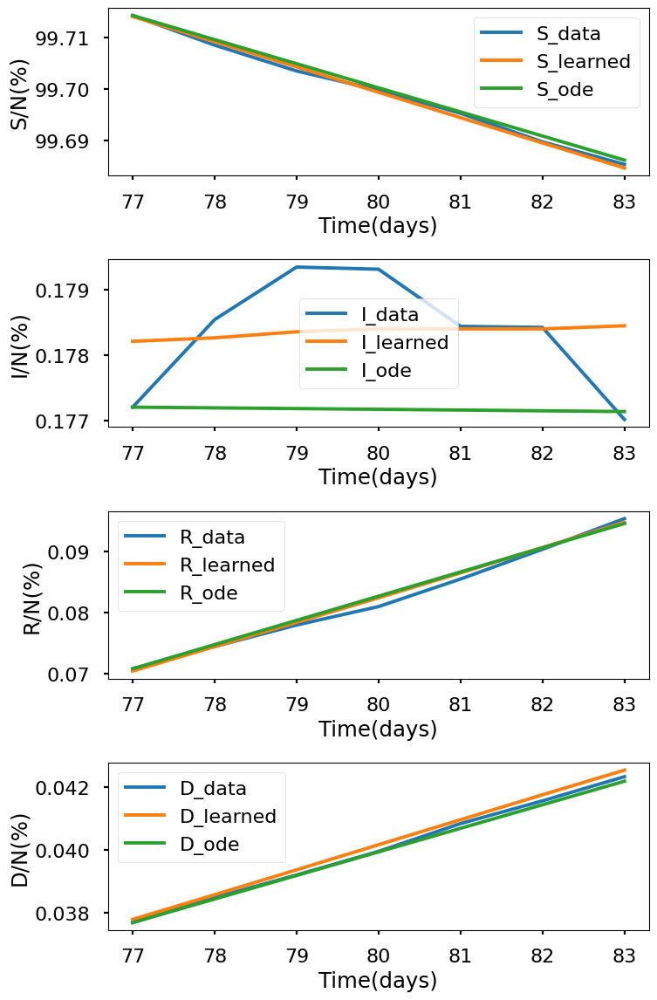

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.940e+00, GE_loss: 2.91022e+00,OB_loss: 2.02974e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.42, cumulative_time: 1.42
It: 10000, Loss: 2.273e-03, GE_loss: 4.41321e-04,OB_loss: 1.83169e-03, Beta: 1.19547e+00,gamma: 8.17441e-01,mu: 8.10692e-01, Time: 22.42, cumulative_time: 23.83
It: 20000, Loss: 2.264e-05, GE_loss: 5.75356e-06,OB_loss: 1.68830e-05, Beta: 1.93912e-02,gamma: 1.95476e-02,mu: 3.12302e-03, Time: 21.70, cumulative_time: 45.53
It: 30000, Loss: 2.848e-05, GE_loss: 8.59004e-06,OB_loss: 1.98886e-05, Beta: 2.00585e-02,gamma: 1.96416e-02,mu: 3.24619e-03, Time: 21.87, cumulative_time: 67.41
It: 40000, Loss: 2.118e-05, GE_loss: 3.94407e-06,OB_loss: 1.72347e-05, Beta: 2.00817e-02,gamma: 1.97717e-02,mu: 3.24401e-03, Time: 21.63, cumulative_time: 89.04
beta:  [0.01976264]
gamma:  [0.01981487]
mu:  [0.00322994]


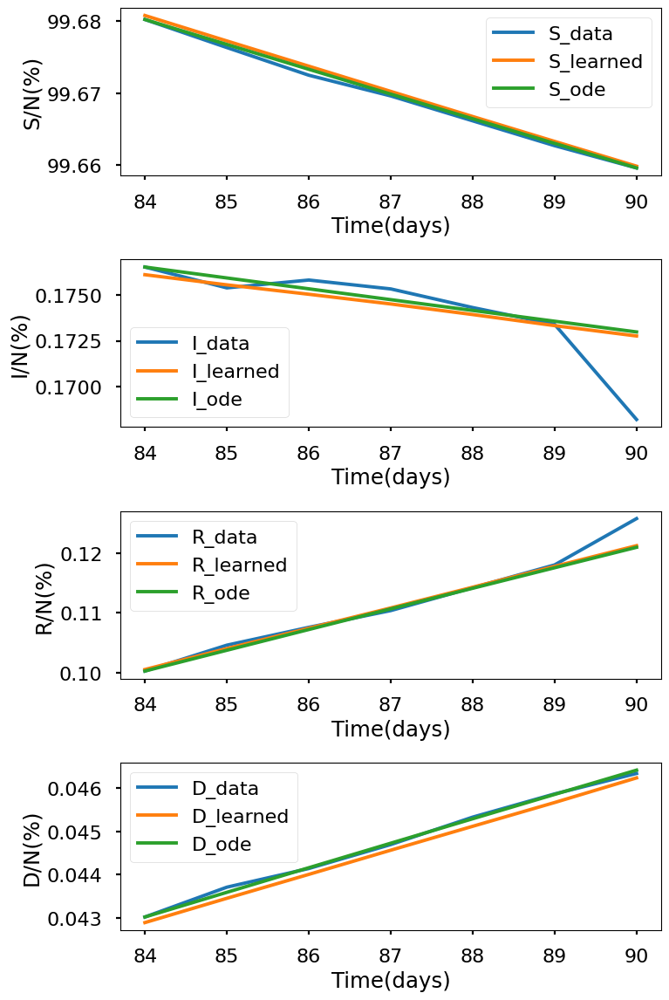

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.954e+00, GE_loss: 2.97819e+00,OB_loss: 1.97622e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.49, cumulative_time: 1.49
It: 10000, Loss: 8.543e-04, GE_loss: 9.67332e-05,OB_loss: 7.57530e-04, Beta: 1.70621e+00,gamma: 8.54154e-01,mu: 8.43170e-01, Time: 28.87, cumulative_time: 30.36
It: 20000, Loss: 4.152e-05, GE_loss: 1.64801e-05,OB_loss: 2.50367e-05, Beta: 1.16369e-02,gamma: 3.74054e-02,mu: 1.76216e-03, Time: 28.69, cumulative_time: 59.05
It: 30000, Loss: 5.169e-05, GE_loss: 1.53870e-05,OB_loss: 3.63012e-05, Beta: 1.07135e-02,gamma: 3.73192e-02,mu: 2.23188e-03, Time: 28.66, cumulative_time: 87.71
It: 40000, Loss: 6.179e-05, GE_loss: 2.64376e-05,OB_loss: 3.53573e-05, Beta: 1.10086e-02,gamma: 3.69078e-02,mu: 2.20960e-03, Time: 28.58, cumulative_time: 116.29
beta:  [0.01151802]
gamma:  [0.03720839]
mu:  [0.00216769]


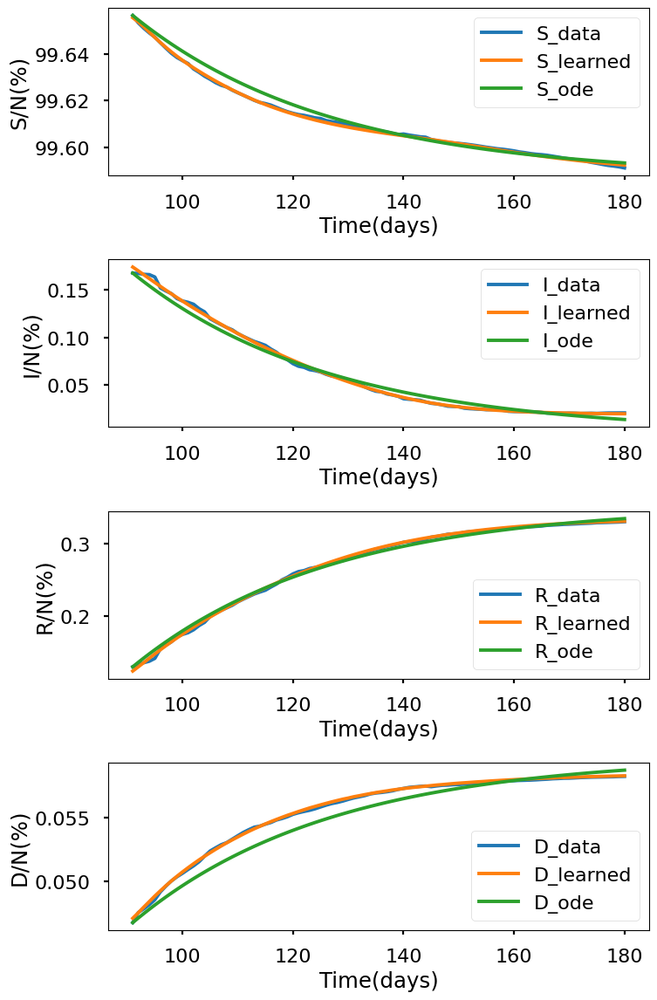

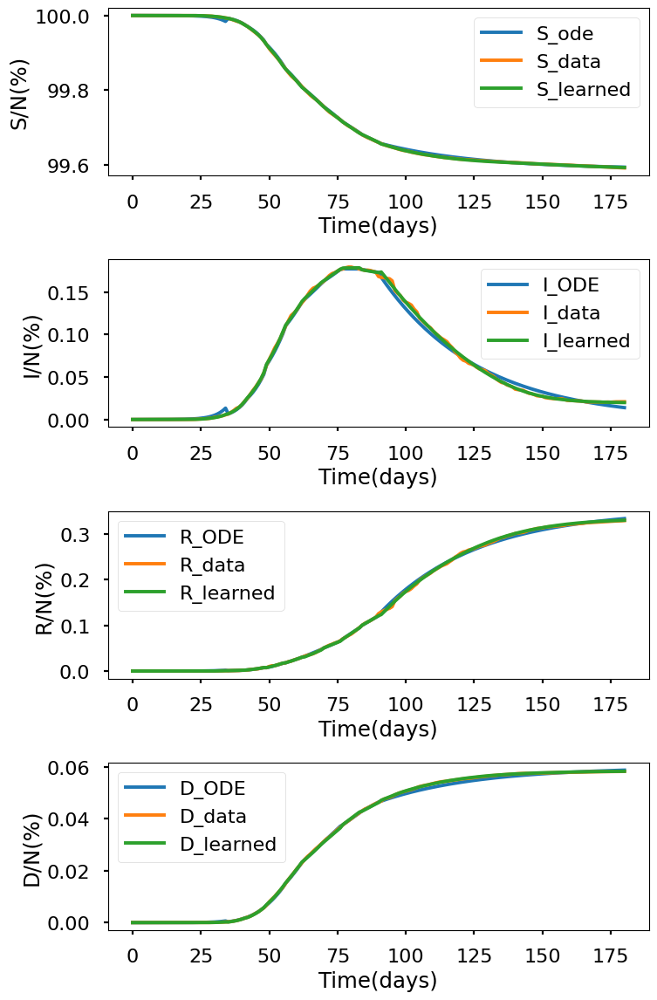

+---------------------+---------------------+-------------+-------------+-------------+-------------+--------------+--------------+--------------+--------------+--------------+
|      Paramaters     | Initial three weeks |   4th week  |   5th week  |   6th week  |   7th week  |   8th week   |   9th week   |  10th week   |  11th week   |  remainder   |
+---------------------+---------------------+-------------+-------------+-------------+-------------+--------------+--------------+--------------+--------------+--------------+
|         beta        |      0.28575483     |  0.22575481 |  0.1656692  |  0.11038419 |  0.06490382 | 0.043147244  |  0.0343955   | 0.026634473  | 0.019762635  | 0.011518022  |
|        gamma        |      0.03200138     | 0.014700095 | 0.022535263 | 0.019747665 | 0.016383465 |  0.01628181  | 0.015184787  | 0.022382094  | 0.019814871  | 0.037208393  |
|          mu         |     0.011515254     | 0.019579671 | 0.016363047 | 0.014061774 | 0.010793974 | 0.0065046693 

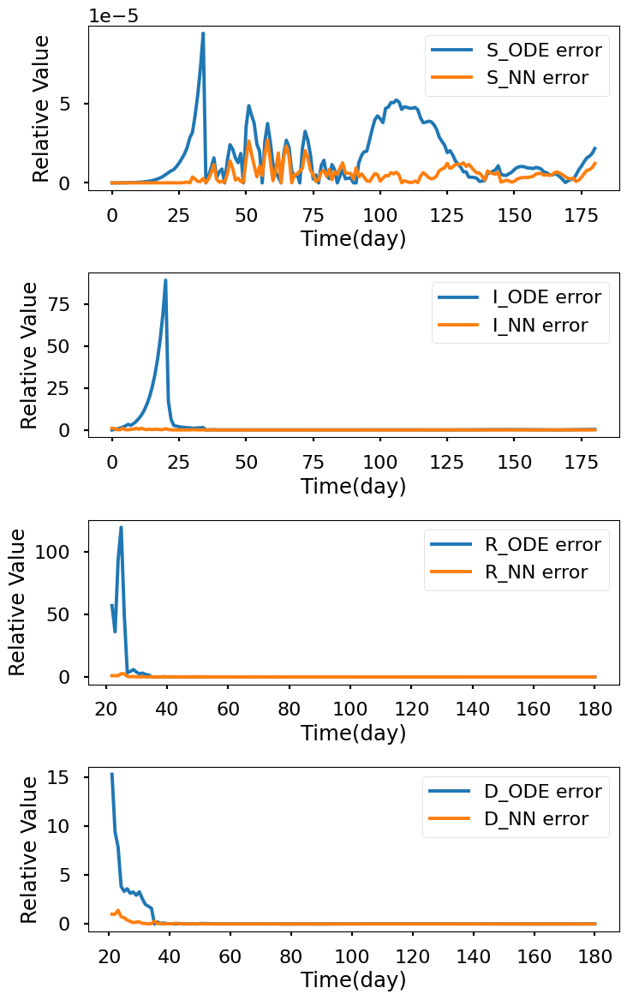

In [10]:
layers416 = [1,16,16,16,16,4]
S416_ode,I416_ode,R416_ode,D416_ode,S416_learned,I416_learned,R416_learned,D416_learned,beta416,gamma416,mu416,S_errnn416,I_errnn416,R_errnn416,D_errnn416,S_erode416,I_errode416,R_errode416,D_errode416,time416 = sum_all(
    layers416,length,SS,II,RC,DC,N0,0.1,50000)

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.917e+00, GE_loss: 2.98378e+00,OB_loss: 1.93319e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.64, cumulative_time: 1.64
It: 10000, Loss: 3.219e-05, GE_loss: 7.78904e-06,OB_loss: 2.44039e-05, Beta: 1.00000e+00,gamma: 8.82400e-01,mu: 8.82400e-01, Time: 26.19, cumulative_time: 27.83
It: 20000, Loss: 7.669e-06, GE_loss: 1.50272e-07,OB_loss: 7.51894e-06, Beta: 1.00000e+00,gamma: 8.44071e-01,mu: 8.44071e-01, Time: 26.19, cumulative_time: 54.02
It: 30000, Loss: 7.515e-06, GE_loss: 1.11549e-08,OB_loss: 7.50355e-06, Beta: 1.00000e+00,gamma: 8.37389e-01,mu: 8.37389e-01, Time: 25.92, cumulative_time: 79.94
It: 40000, Loss: 7.511e-06, GE_loss: 0.00000e+00,OB_loss: 7.51140e-06, Beta: 1.01029e+00,gamma: 7.30336e-01,mu: 7.37973e-01, Time: 26.13, cumulative_time: 106.07
beta:  [1.0102857]
gamma:  [0.7303358]
mu:  [0.7379729]


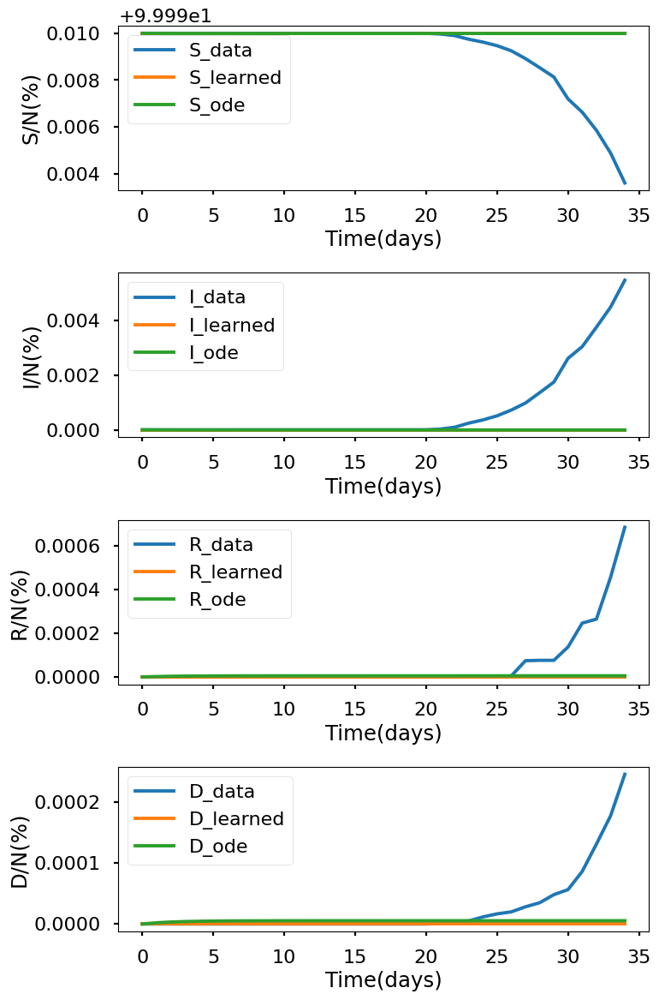

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 5.008e+00, GE_loss: 2.98816e+00,OB_loss: 2.01988e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.59, cumulative_time: 1.59
It: 10000, Loss: 1.969e-04, GE_loss: 2.54987e-05,OB_loss: 1.71412e-04, Beta: 1.30369e+00,gamma: 8.22490e-01,mu: 8.22908e-01, Time: 23.53, cumulative_time: 25.11
It: 20000, Loss: 7.812e-06, GE_loss: 2.28379e-06,OB_loss: 5.52788e-06, Beta: 2.25420e-01,gamma: 1.57648e-02,mu: 1.73821e-02, Time: 23.54, cumulative_time: 48.65
It: 30000, Loss: 5.866e-06, GE_loss: 6.05345e-07,OB_loss: 5.26096e-06, Beta: 2.28900e-01,gamma: 1.55236e-02,mu: 1.97284e-02, Time: 23.33, cumulative_time: 71.98
It: 40000, Loss: 6.253e-06, GE_loss: 8.24004e-07,OB_loss: 5.42916e-06, Beta: 2.25993e-01,gamma: 1.50171e-02,mu: 1.92669e-02, Time: 23.63, cumulative_time: 95.62
beta:  [0.22580524]
gamma:  [0.01479767]
mu:  [0.0193579]


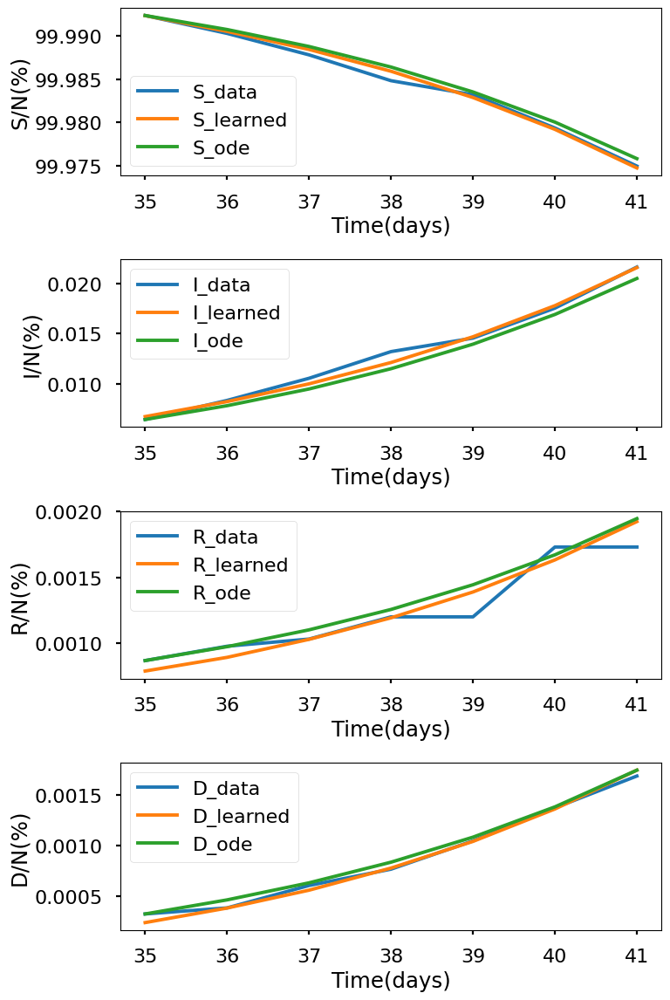

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.937e+00, GE_loss: 2.97303e+00,OB_loss: 1.96384e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.64, cumulative_time: 1.64
It: 10000, Loss: 6.048e-04, GE_loss: 1.93939e-05,OB_loss: 5.85418e-04, Beta: 1.21381e+00,gamma: 8.37260e-01,mu: 8.31636e-01, Time: 25.10, cumulative_time: 26.74
It: 20000, Loss: 1.486e-05, GE_loss: 3.58191e-06,OB_loss: 1.12797e-05, Beta: 1.66262e-01,gamma: 2.28701e-02,mu: 1.67740e-02, Time: 24.16, cumulative_time: 50.90
It: 30000, Loss: 1.411e-05, GE_loss: 3.46840e-06,OB_loss: 1.06450e-05, Beta: 1.66821e-01,gamma: 2.32703e-02,mu: 1.67659e-02, Time: 23.80, cumulative_time: 74.70
It: 40000, Loss: 1.329e-05, GE_loss: 2.54726e-06,OB_loss: 1.07472e-05, Beta: 1.66160e-01,gamma: 2.30940e-02,mu: 1.66758e-02, Time: 23.76, cumulative_time: 98.46
beta:  [0.16454902]
gamma:  [0.02221028]
mu:  [0.01651018]


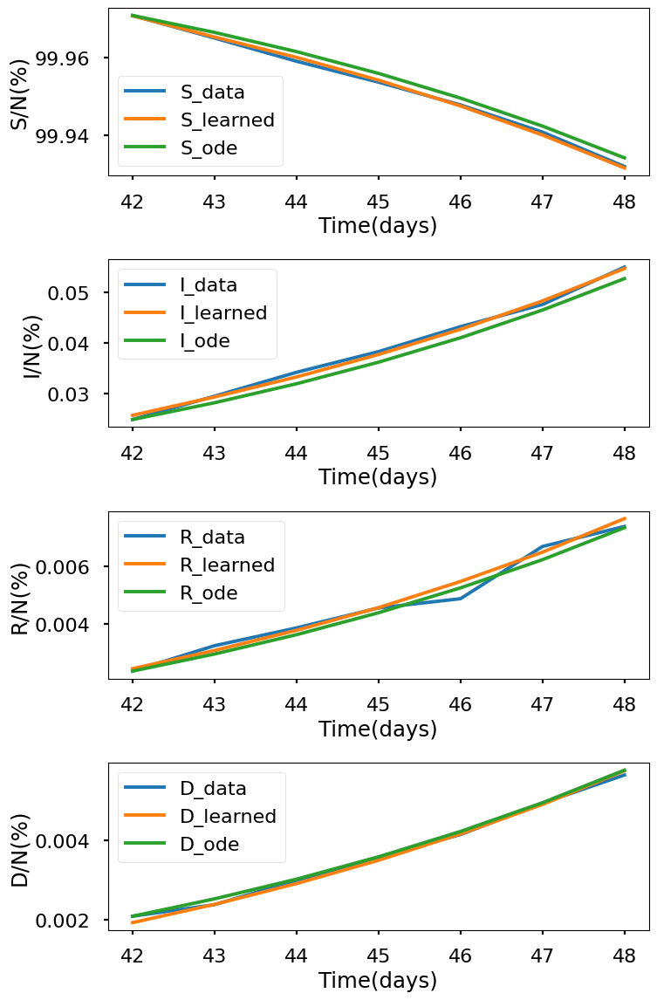

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.965e+00, GE_loss: 2.95460e+00,OB_loss: 2.01074e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.73, cumulative_time: 1.73
It: 10000, Loss: 1.060e-03, GE_loss: 1.73787e-04,OB_loss: 8.86137e-04, Beta: 1.13929e+00,gamma: 8.46739e-01,mu: 8.51433e-01, Time: 23.10, cumulative_time: 24.83
It: 20000, Loss: 2.985e-05, GE_loss: 7.32284e-06,OB_loss: 2.25312e-05, Beta: 1.10376e-01,gamma: 1.90281e-02,mu: 1.39462e-02, Time: 23.45, cumulative_time: 48.28
It: 30000, Loss: 2.712e-05, GE_loss: 1.07902e-05,OB_loss: 1.63280e-05, Beta: 1.09305e-01,gamma: 1.93131e-02,mu: 1.40027e-02, Time: 23.18, cumulative_time: 71.46
It: 40000, Loss: 2.393e-05, GE_loss: 1.02771e-05,OB_loss: 1.36533e-05, Beta: 1.09805e-01,gamma: 1.93119e-02,mu: 1.40998e-02, Time: 23.21, cumulative_time: 94.67
beta:  [0.10854062]
gamma:  [0.01870436]
mu:  [0.01366246]


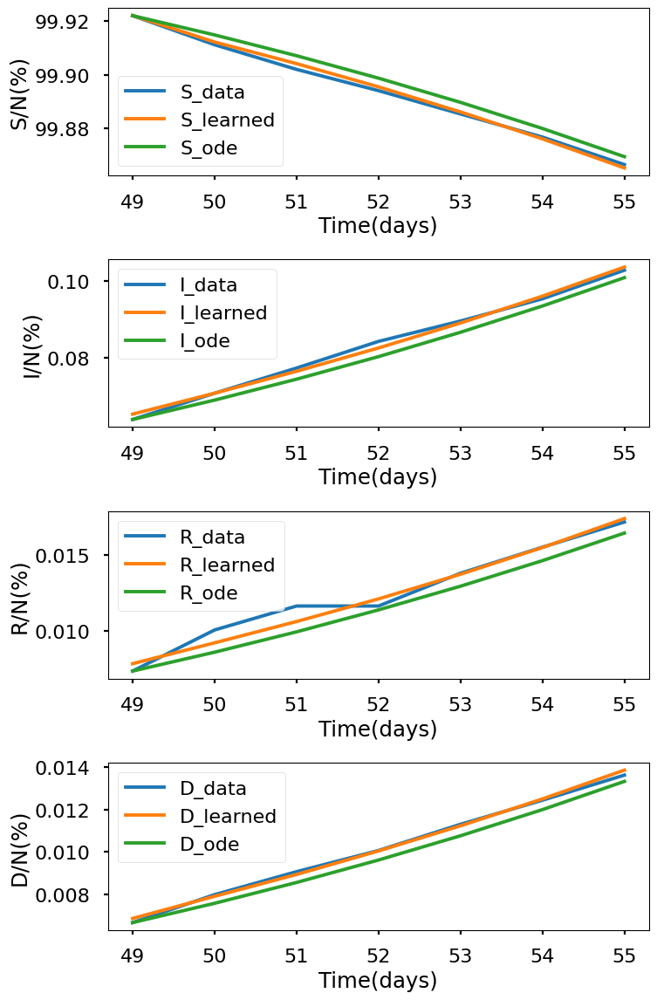

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.978e+00, GE_loss: 2.98961e+00,OB_loss: 1.98889e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.83, cumulative_time: 1.83
It: 10000, Loss: 1.660e-03, GE_loss: 2.94367e-04,OB_loss: 1.36580e-03, Beta: 1.12383e+00,gamma: 7.74517e-01,mu: 7.87706e-01, Time: 23.34, cumulative_time: 25.17
It: 20000, Loss: 2.115e-05, GE_loss: 4.72681e-06,OB_loss: 1.64248e-05, Beta: 6.47797e-02,gamma: 1.64747e-02,mu: 1.09283e-02, Time: 24.10, cumulative_time: 49.26
It: 30000, Loss: 2.823e-05, GE_loss: 7.03572e-06,OB_loss: 2.11934e-05, Beta: 6.43343e-02,gamma: 1.62655e-02,mu: 1.09395e-02, Time: 24.24, cumulative_time: 73.50
It: 40000, Loss: 1.970e-05, GE_loss: 5.64094e-06,OB_loss: 1.40593e-05, Beta: 6.52740e-02,gamma: 1.63700e-02,mu: 1.07242e-02, Time: 23.74, cumulative_time: 97.25
beta:  [0.06507216]
gamma:  [0.01636425]
mu:  [0.01091229]


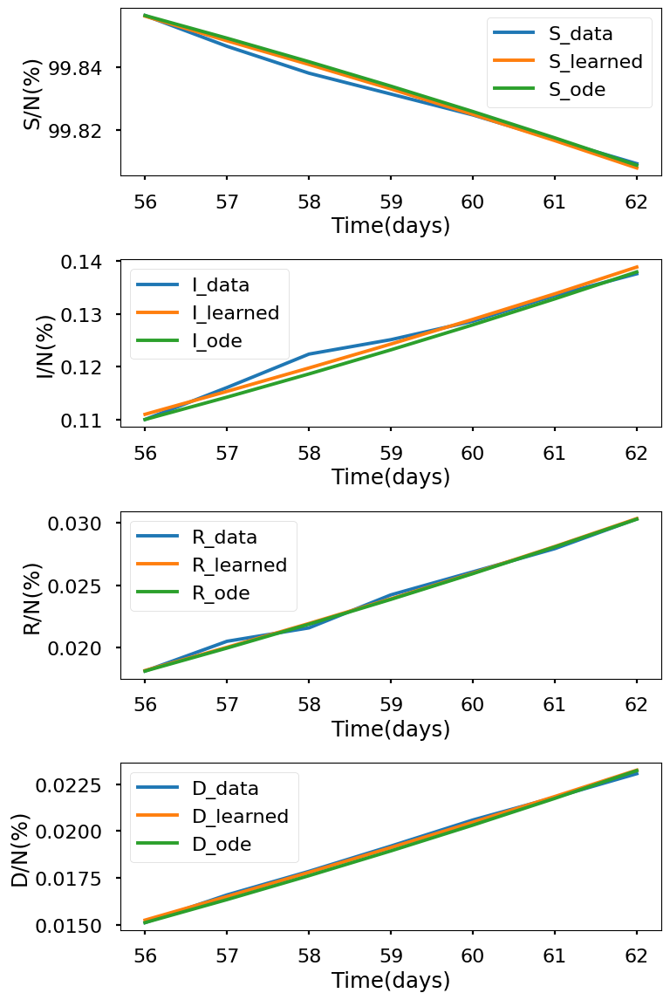

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.959e+00, GE_loss: 2.97348e+00,OB_loss: 1.98578e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.80, cumulative_time: 1.80
It: 10000, Loss: 2.071e-03, GE_loss: 3.10398e-04,OB_loss: 1.76075e-03, Beta: 1.22072e+00,gamma: 7.92176e-01,mu: 7.88725e-01, Time: 23.18, cumulative_time: 24.98
It: 20000, Loss: 3.803e-05, GE_loss: 1.70306e-05,OB_loss: 2.09980e-05, Beta: 4.34033e-02,gamma: 1.68045e-02,mu: 6.42952e-03, Time: 23.06, cumulative_time: 48.05
It: 30000, Loss: 2.520e-05, GE_loss: 4.67878e-06,OB_loss: 2.05185e-05, Beta: 4.30827e-02,gamma: 1.63900e-02,mu: 6.46495e-03, Time: 23.14, cumulative_time: 71.19
It: 40000, Loss: 3.554e-05, GE_loss: 1.02341e-05,OB_loss: 2.53026e-05, Beta: 4.32908e-02,gamma: 1.62353e-02,mu: 6.58755e-03, Time: 23.25, cumulative_time: 94.44
beta:  [0.04362864]
gamma:  [0.01655476]
mu:  [0.00614623]


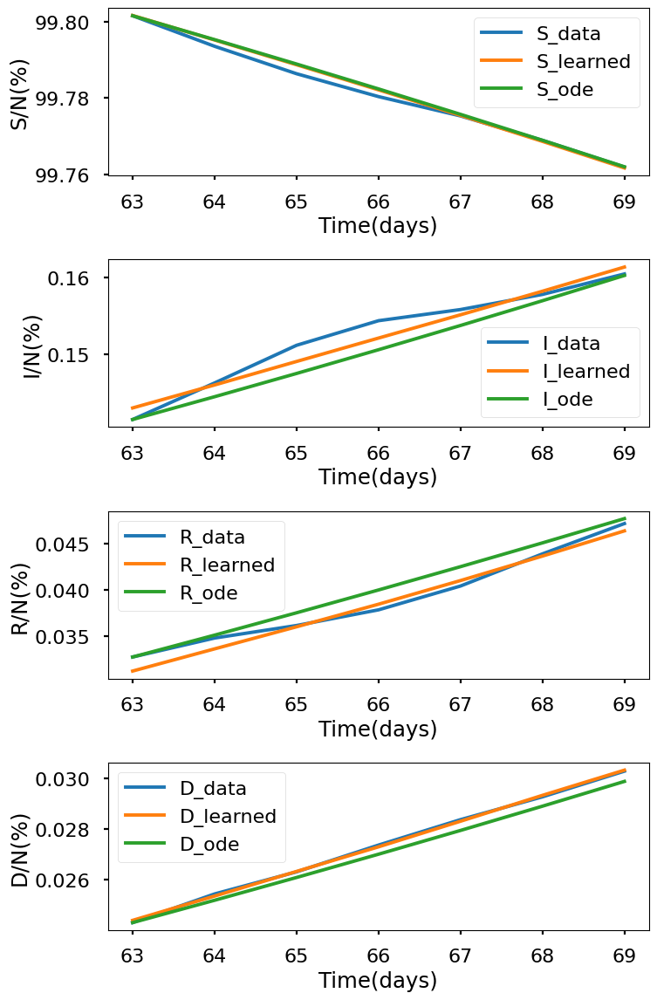

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.984e+00, GE_loss: 2.97773e+00,OB_loss: 2.00674e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.82, cumulative_time: 1.82
It: 10000, Loss: 2.212e-03, GE_loss: 4.65211e-04,OB_loss: 1.74634e-03, Beta: 1.04241e+00,gamma: 7.67149e-01,mu: 7.52932e-01, Time: 23.24, cumulative_time: 25.06
It: 20000, Loss: 3.852e-05, GE_loss: 1.34941e-05,OB_loss: 2.50285e-05, Beta: 3.56118e-02,gamma: 1.53350e-02,mu: 5.99094e-03, Time: 23.42, cumulative_time: 48.48
It: 30000, Loss: 1.993e-05, GE_loss: 6.64208e-06,OB_loss: 1.32875e-05, Beta: 3.51721e-02,gamma: 1.52384e-02,mu: 5.81166e-03, Time: 23.76, cumulative_time: 72.24
It: 40000, Loss: 3.484e-05, GE_loss: 1.30715e-05,OB_loss: 2.17735e-05, Beta: 3.48731e-02,gamma: 1.52780e-02,mu: 5.55192e-03, Time: 25.26, cumulative_time: 97.50
beta:  [0.03503903]
gamma:  [0.01533486]
mu:  [0.00553235]


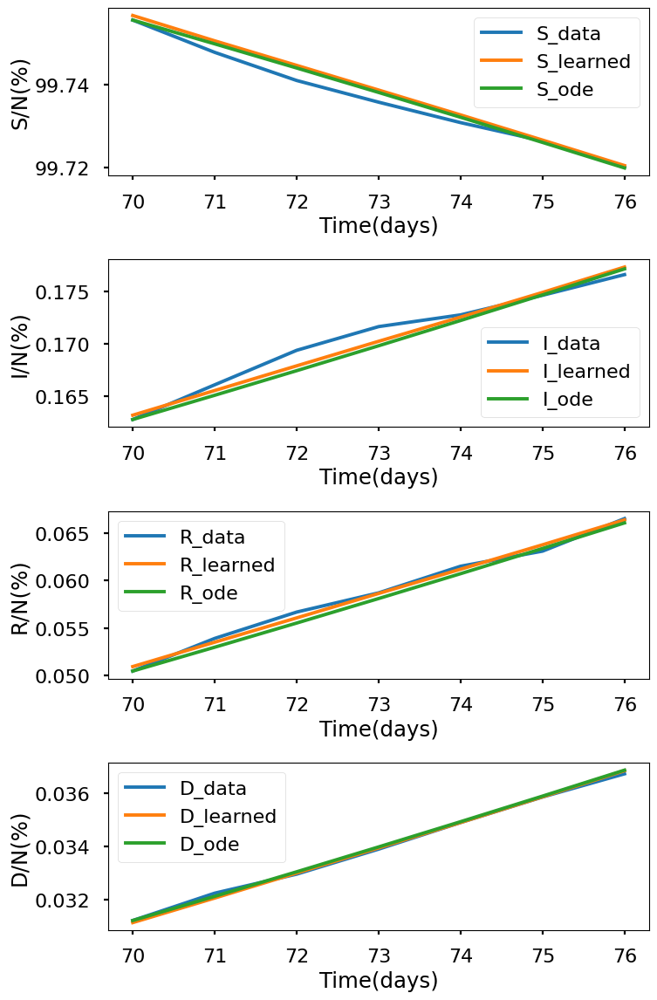

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.957e+00, GE_loss: 2.95739e+00,OB_loss: 1.99936e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.89, cumulative_time: 1.89
It: 10000, Loss: 2.232e-03, GE_loss: 4.19989e-04,OB_loss: 1.81245e-03, Beta: 1.46122e+00,gamma: 8.26738e-01,mu: 7.28367e-01, Time: 23.55, cumulative_time: 25.44
It: 20000, Loss: 4.754e-05, GE_loss: 2.25423e-05,OB_loss: 2.50024e-05, Beta: 2.67675e-02,gamma: 2.23774e-02,mu: 4.15572e-03, Time: 23.40, cumulative_time: 48.85
It: 30000, Loss: 1.624e-05, GE_loss: 3.98908e-06,OB_loss: 1.22559e-05, Beta: 2.72819e-02,gamma: 2.27419e-02,mu: 4.29344e-03, Time: 23.29, cumulative_time: 72.14
It: 40000, Loss: 4.802e-05, GE_loss: 2.33620e-05,OB_loss: 2.46555e-05, Beta: 2.72787e-02,gamma: 2.26600e-02,mu: 4.82738e-03, Time: 23.40, cumulative_time: 95.54
beta:  [0.02668857]
gamma:  [0.02221572]
mu:  [0.00445513]


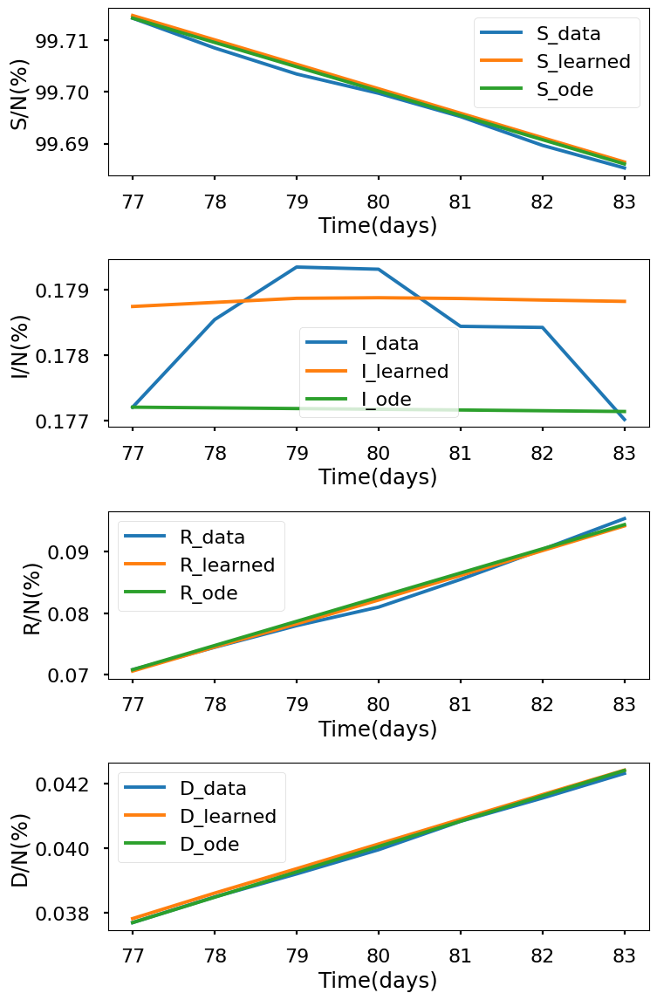

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 5.026e+00, GE_loss: 2.99684e+00,OB_loss: 2.02877e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.02, cumulative_time: 2.02
It: 10000, Loss: 2.276e-03, GE_loss: 4.32306e-04,OB_loss: 1.84368e-03, Beta: 1.55434e+00,gamma: 8.03171e-01,mu: 7.36072e-01, Time: 23.78, cumulative_time: 25.80
It: 20000, Loss: 2.692e-05, GE_loss: 9.47239e-06,OB_loss: 1.74472e-05, Beta: 2.02601e-02,gamma: 1.96100e-02,mu: 3.59344e-03, Time: 24.10, cumulative_time: 49.90
It: 30000, Loss: 3.372e-05, GE_loss: 1.39052e-05,OB_loss: 1.98108e-05, Beta: 1.97424e-02,gamma: 1.98807e-02,mu: 3.28404e-03, Time: 24.43, cumulative_time: 74.33
It: 40000, Loss: 2.429e-05, GE_loss: 4.77114e-06,OB_loss: 1.95221e-05, Beta: 2.03065e-02,gamma: 2.00613e-02,mu: 3.14861e-03, Time: 25.76, cumulative_time: 100.09
beta:  [0.0201434]
gamma:  [0.0200867]
mu:  [0.00320594]


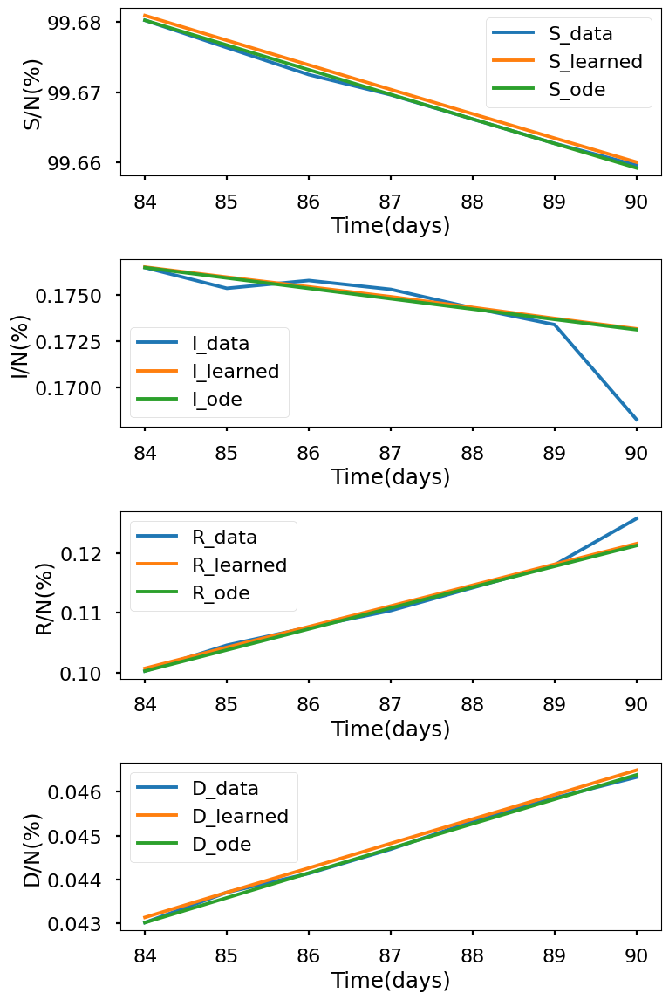

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.871e+00, GE_loss: 2.96187e+00,OB_loss: 1.90935e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.11, cumulative_time: 2.11
It: 10000, Loss: 8.690e-04, GE_loss: 6.50071e-05,OB_loss: 8.03967e-04, Beta: 1.71540e+00,gamma: 8.61615e-01,mu: 8.52094e-01, Time: 33.21, cumulative_time: 35.31
It: 20000, Loss: 5.451e-05, GE_loss: 1.27652e-05,OB_loss: 4.17415e-05, Beta: 1.09251e-02,gamma: 3.70820e-02,mu: 2.74112e-03, Time: 32.71, cumulative_time: 68.02
It: 30000, Loss: 3.801e-05, GE_loss: 1.17653e-05,OB_loss: 2.62495e-05, Beta: 1.07992e-02,gamma: 3.75912e-02,mu: 1.85308e-03, Time: 32.70, cumulative_time: 100.73
It: 40000, Loss: 5.058e-05, GE_loss: 2.18594e-05,OB_loss: 2.87248e-05, Beta: 1.07667e-02,gamma: 3.86684e-02,mu: 1.75698e-03, Time: 32.36, cumulative_time: 133.09
beta:  [0.01058737]
gamma:  [0.03774492]
mu:  [0.00206812]


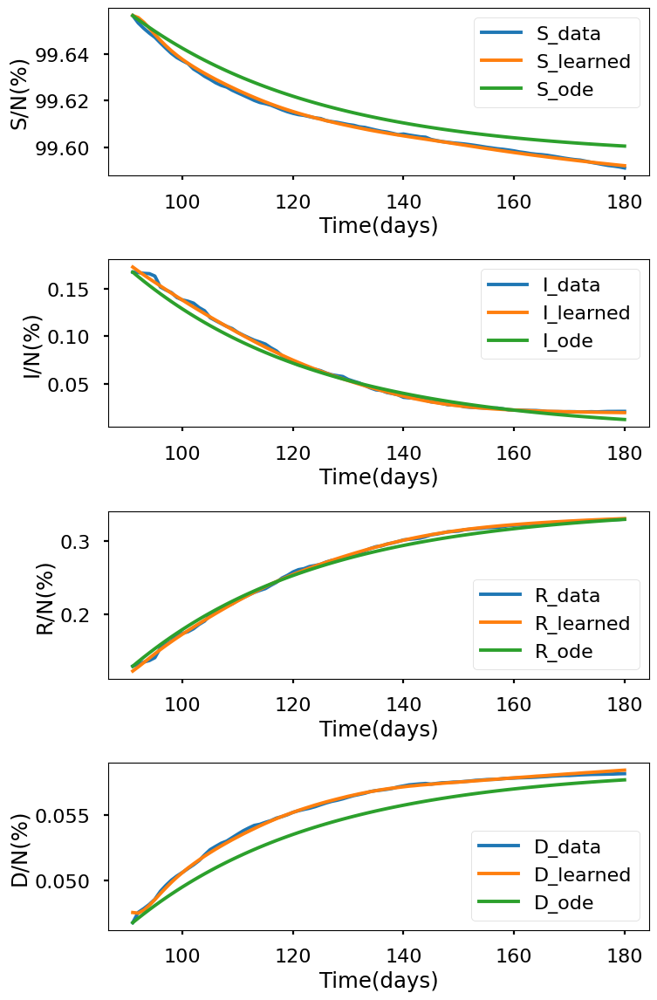

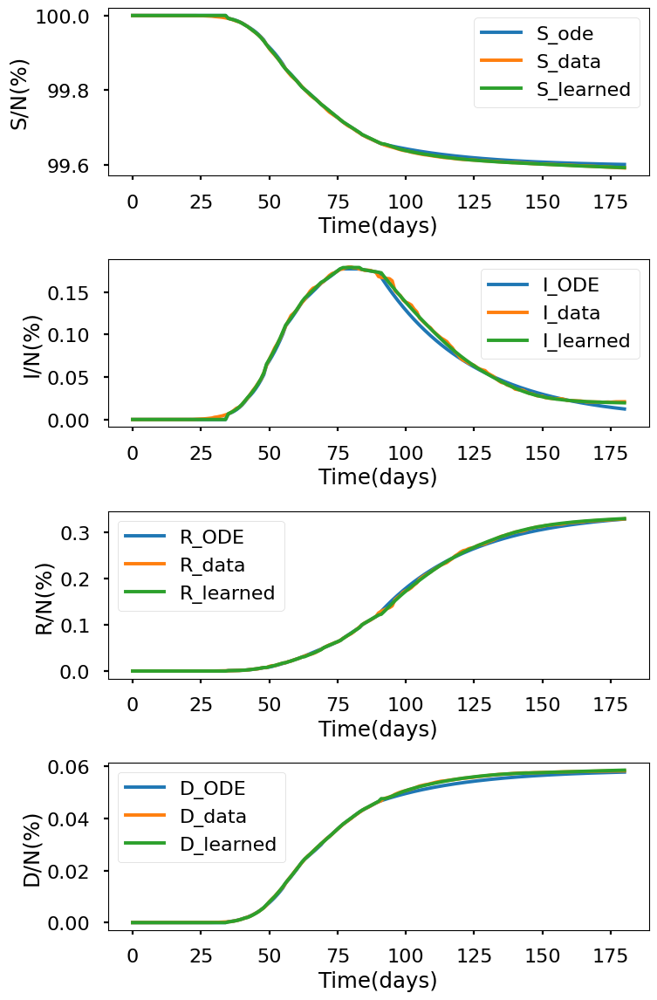

+---------------------+---------------------+-------------+-------------+-------------+-------------+-------------+-------------+-------------+-------------+--------------+
|      Paramaters     | Initial three weeks |   4th week  |   5th week  |   6th week  |   7th week  |   8th week  |   9th week  |  10th week  |  11th week  |  remainder   |
+---------------------+---------------------+-------------+-------------+-------------+-------------+-------------+-------------+-------------+-------------+--------------+
|         beta        |      1.0102857      |  0.22580524 |  0.16454902 |  0.10854062 |  0.06507216 |  0.04362864 | 0.035039034 | 0.026688572 | 0.020143395 | 0.010587373  |
|        gamma        |      0.7303358      | 0.014797667 | 0.022210278 | 0.018704362 | 0.016364254 | 0.016554756 | 0.015334863 | 0.022215718 | 0.020086704 | 0.037744917  |
|          mu         |      0.7379729      |  0.0193579  | 0.016510176 | 0.013662463 | 0.010912292 | 0.006146233 | 0.005532351 | 0.004

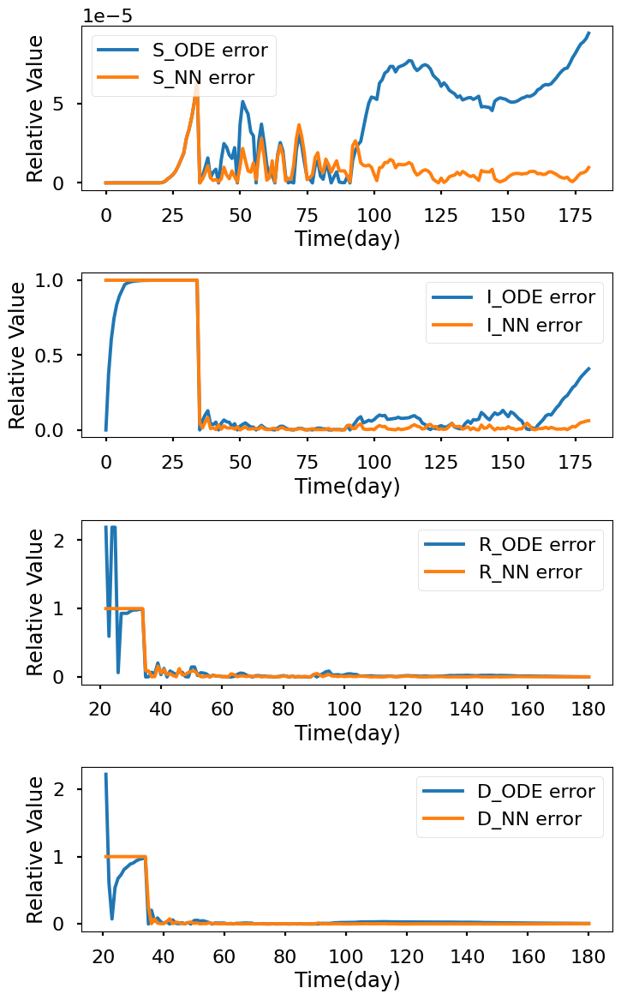

In [11]:
layers516 = [1,16,16,16,16,16,4]
S516_ode,I516_ode,R516_ode,D516_ode,S516_learned,I516_learned,R516_learned,D516_learned,beta516,gamma516,mu516,S_errnn516,I_errnn516,R_errnn516,D_errnn516,S_erode516,I_errode516,R_errode516,D_errode516,time516 = sum_all(
    layers516,length,SS,II,RC,DC,N0,0.1,50000)

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 5.016e+00, GE_loss: 2.98731e+00,OB_loss: 2.02901e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.85, cumulative_time: 1.85
It: 10000, Loss: 1.363e-05, GE_loss: 2.35808e-06,OB_loss: 1.12717e-05, Beta: 1.14242e+00,gamma: 9.04029e-01,mu: 9.04029e-01, Time: 22.20, cumulative_time: 24.05
It: 20000, Loss: 6.920e-06, GE_loss: 1.82582e-07,OB_loss: 6.73782e-06, Beta: 2.20064e+00,gamma: 8.86444e-01,mu: 8.22501e-01, Time: 22.10, cumulative_time: 46.15
It: 30000, Loss: 9.192e-07, GE_loss: 3.86153e-07,OB_loss: 5.33007e-07, Beta: 2.87167e-01,gamma: 3.20902e-02,mu: 1.12873e-02, Time: 22.05, cumulative_time: 68.20
It: 40000, Loss: 8.715e-07, GE_loss: 3.23463e-07,OB_loss: 5.48052e-07, Beta: 2.87336e-01,gamma: 3.15220e-02,mu: 1.13848e-02, Time: 24.51, cumulative_time: 92.71
beta:  [0.28848547]
gamma:  [0.03266233]
mu:  [0.0111923]


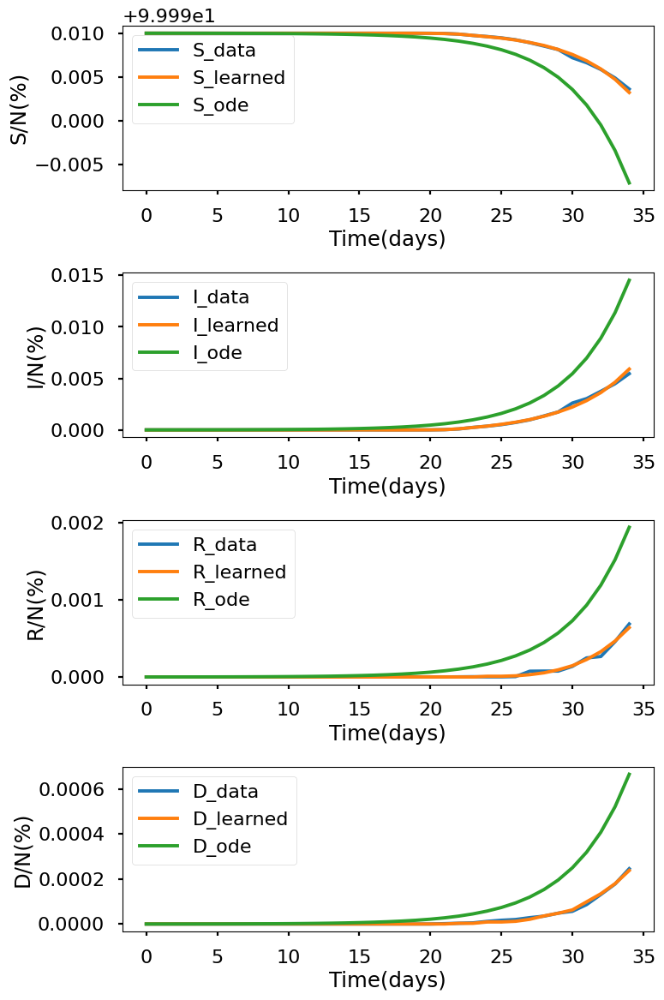

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 5.017e+00, GE_loss: 3.00063e+00,OB_loss: 2.01614e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.84, cumulative_time: 1.84
It: 10000, Loss: 1.642e-04, GE_loss: 2.34035e-05,OB_loss: 1.40824e-04, Beta: 1.21205e+00,gamma: 9.10276e-01,mu: 9.07550e-01, Time: 19.05, cumulative_time: 20.90
It: 20000, Loss: 1.386e-05, GE_loss: 9.47352e-06,OB_loss: 4.38802e-06, Beta: 2.26831e-01,gamma: 1.42051e-02,mu: 1.78551e-02, Time: 19.01, cumulative_time: 39.90
It: 30000, Loss: 6.199e-06, GE_loss: 1.39612e-06,OB_loss: 4.80289e-06, Beta: 2.27252e-01,gamma: 1.51407e-02,mu: 1.95858e-02, Time: 18.99, cumulative_time: 58.89
It: 40000, Loss: 6.099e-06, GE_loss: 9.59202e-07,OB_loss: 5.14016e-06, Beta: 2.26517e-01,gamma: 1.51211e-02,mu: 1.92767e-02, Time: 19.17, cumulative_time: 78.07
beta:  [0.22562912]
gamma:  [0.01457405]
mu:  [0.01945443]


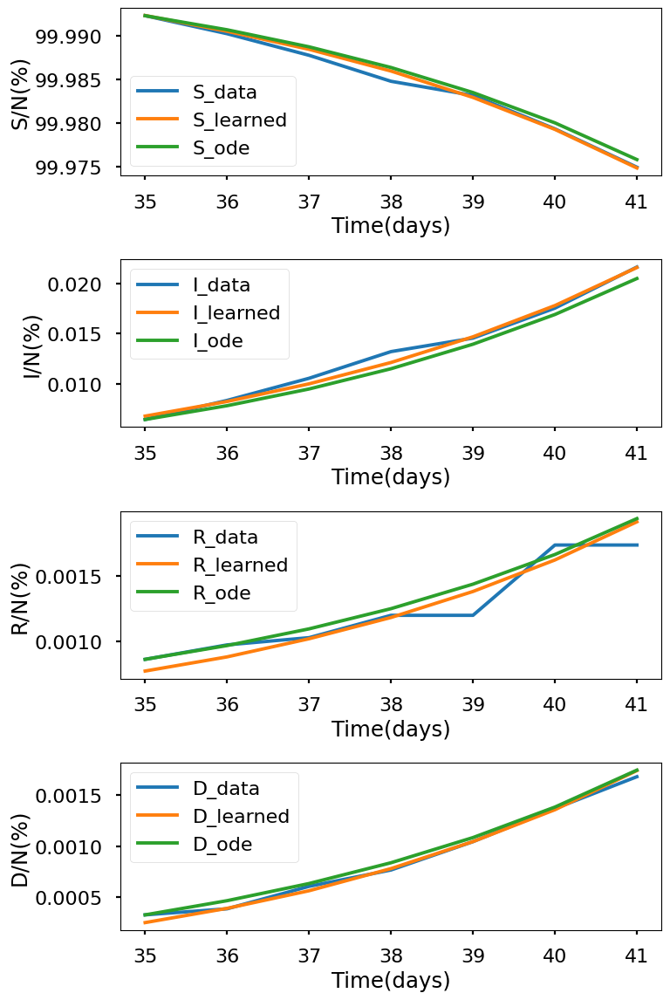

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.944e+00, GE_loss: 2.94098e+00,OB_loss: 2.00340e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.90, cumulative_time: 1.90
It: 10000, Loss: 4.939e-04, GE_loss: 8.59830e-05,OB_loss: 4.07937e-04, Beta: 1.20762e+00,gamma: 8.98079e-01,mu: 8.98048e-01, Time: 19.19, cumulative_time: 21.09
It: 20000, Loss: 1.537e-05, GE_loss: 5.85702e-06,OB_loss: 9.51705e-06, Beta: 1.67145e-01,gamma: 2.29173e-02,mu: 1.66377e-02, Time: 19.25, cumulative_time: 40.33
It: 30000, Loss: 1.431e-05, GE_loss: 5.75413e-06,OB_loss: 8.55447e-06, Beta: 1.66900e-01,gamma: 2.31186e-02,mu: 1.67086e-02, Time: 19.21, cumulative_time: 59.55
It: 40000, Loss: 1.328e-05, GE_loss: 3.42441e-06,OB_loss: 9.85659e-06, Beta: 1.66755e-01,gamma: 2.29812e-02,mu: 1.65952e-02, Time: 19.07, cumulative_time: 78.62
beta:  [0.16590637]
gamma:  [0.02299209]
mu:  [0.01638462]


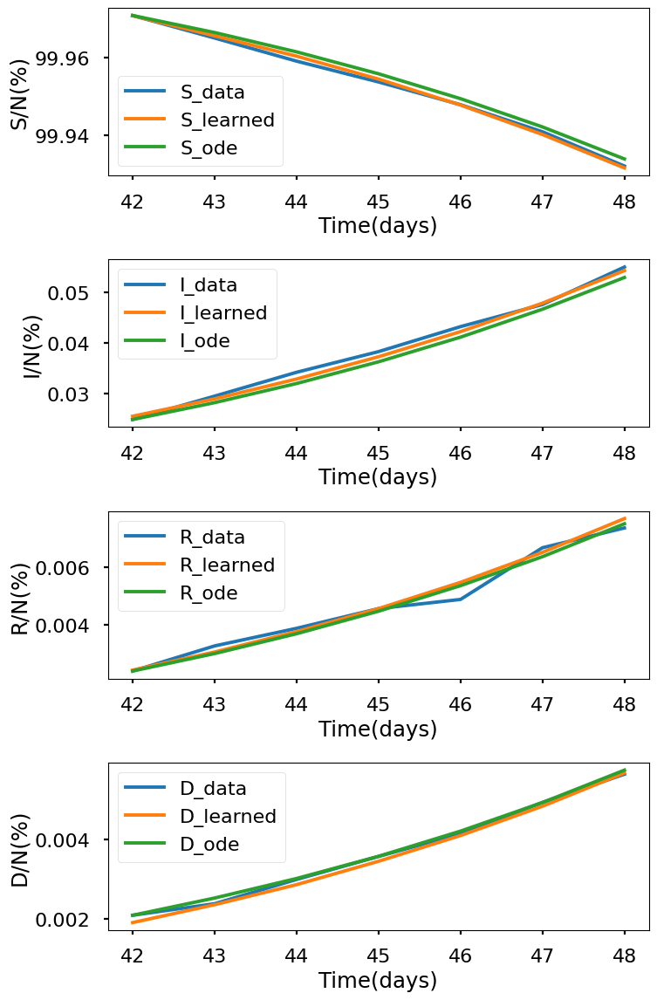

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.971e+00, GE_loss: 2.97156e+00,OB_loss: 1.99937e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.09, cumulative_time: 2.09
It: 10000, Loss: 1.036e-03, GE_loss: 2.03618e-04,OB_loss: 8.32785e-04, Beta: 1.20053e+00,gamma: 8.77678e-01,mu: 8.73008e-01, Time: 19.01, cumulative_time: 21.10
It: 20000, Loss: 2.360e-05, GE_loss: 6.61121e-06,OB_loss: 1.69856e-05, Beta: 1.10767e-01,gamma: 1.96020e-02,mu: 1.41369e-02, Time: 19.14, cumulative_time: 40.24
It: 30000, Loss: 2.431e-05, GE_loss: 7.88270e-06,OB_loss: 1.64246e-05, Beta: 1.11206e-01,gamma: 1.98016e-02,mu: 1.41560e-02, Time: 18.94, cumulative_time: 59.18
It: 40000, Loss: 2.444e-05, GE_loss: 7.27075e-06,OB_loss: 1.71738e-05, Beta: 1.11560e-01,gamma: 1.96726e-02,mu: 1.41618e-02, Time: 19.11, cumulative_time: 78.29
beta:  [0.11231543]
gamma:  [0.01967247]
mu:  [0.01420343]


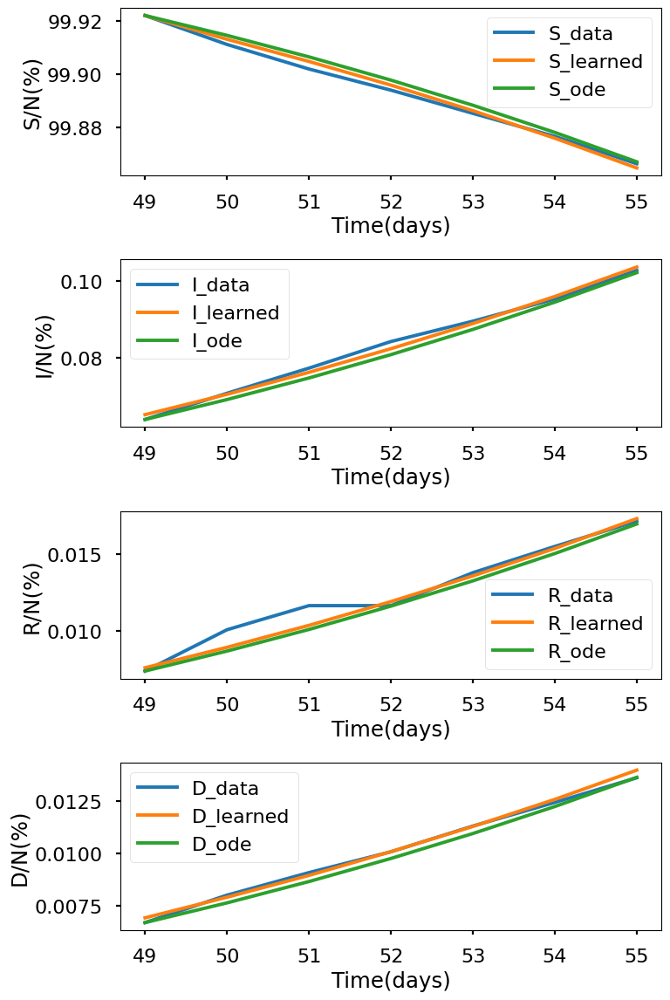

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 5.035e+00, GE_loss: 2.99740e+00,OB_loss: 2.03739e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.96, cumulative_time: 1.96
It: 10000, Loss: 1.563e-03, GE_loss: 3.18473e-04,OB_loss: 1.24436e-03, Beta: 1.04308e+00,gamma: 8.80015e-01,mu: 8.72574e-01, Time: 19.39, cumulative_time: 21.35
It: 20000, Loss: 4.538e-05, GE_loss: 1.88977e-05,OB_loss: 2.64807e-05, Beta: 6.50653e-02,gamma: 1.64570e-02,mu: 1.09812e-02, Time: 19.30, cumulative_time: 40.66
It: 30000, Loss: 2.004e-05, GE_loss: 4.48723e-06,OB_loss: 1.55565e-05, Beta: 6.61587e-02,gamma: 1.64739e-02,mu: 1.11081e-02, Time: 18.99, cumulative_time: 59.65
It: 40000, Loss: 2.576e-05, GE_loss: 1.01431e-05,OB_loss: 1.56133e-05, Beta: 6.50594e-02,gamma: 1.65347e-02,mu: 1.08165e-02, Time: 18.78, cumulative_time: 78.43
beta:  [0.06538998]
gamma:  [0.01651311]
mu:  [0.01080197]


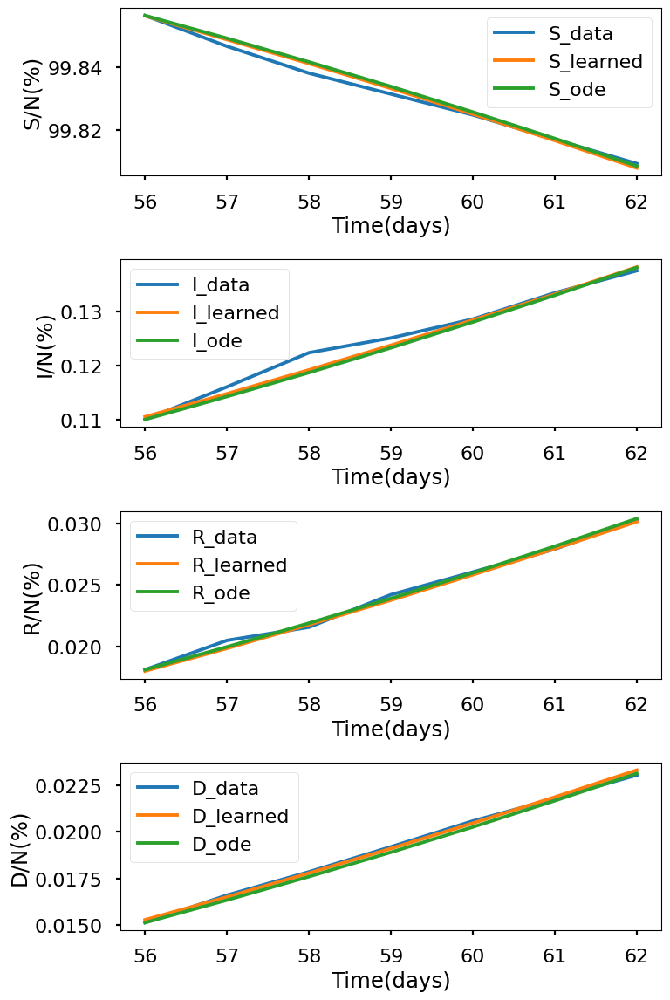

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.967e+00, GE_loss: 2.94926e+00,OB_loss: 2.01781e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 1.96, cumulative_time: 1.96
It: 10000, Loss: 1.936e-03, GE_loss: 3.93092e-04,OB_loss: 1.54272e-03, Beta: 1.21377e+00,gamma: 8.86064e-01,mu: 8.59922e-01, Time: 18.85, cumulative_time: 20.81
It: 20000, Loss: 4.635e-05, GE_loss: 1.65254e-05,OB_loss: 2.98253e-05, Beta: 4.28712e-02,gamma: 1.62127e-02,mu: 6.57888e-03, Time: 18.86, cumulative_time: 39.67
It: 30000, Loss: 4.558e-05, GE_loss: 2.09367e-05,OB_loss: 2.46440e-05, Beta: 4.40709e-02,gamma: 1.59739e-02,mu: 6.63919e-03, Time: 21.15, cumulative_time: 60.83
It: 40000, Loss: 5.133e-05, GE_loss: 1.83904e-05,OB_loss: 3.29419e-05, Beta: 4.31080e-02,gamma: 1.57747e-02,mu: 6.32954e-03, Time: 18.95, cumulative_time: 79.78
beta:  [0.04380746]
gamma:  [0.01625104]
mu:  [0.00642259]


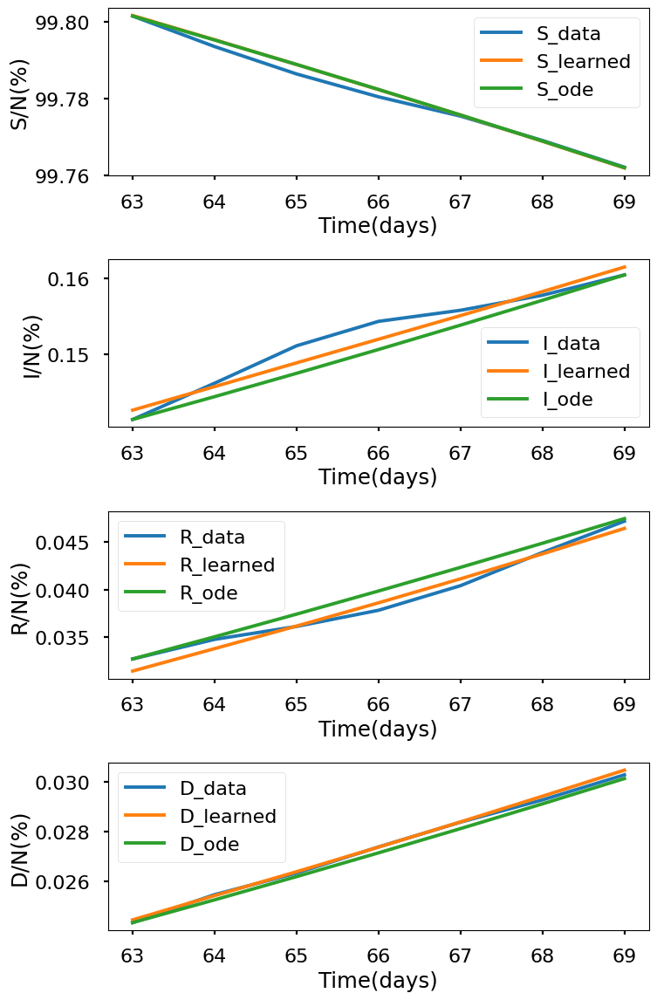

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 5.050e+00, GE_loss: 2.99588e+00,OB_loss: 2.05409e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.08, cumulative_time: 2.08
It: 10000, Loss: 2.147e-03, GE_loss: 4.34395e-04,OB_loss: 1.71241e-03, Beta: 1.26156e+00,gamma: 8.82320e-01,mu: 8.44688e-01, Time: 19.75, cumulative_time: 21.83
It: 20000, Loss: 6.209e-05, GE_loss: 1.87986e-05,OB_loss: 4.32884e-05, Beta: 3.52489e-02,gamma: 1.50252e-02,mu: 5.65224e-03, Time: 19.25, cumulative_time: 41.08
It: 30000, Loss: 6.424e-05, GE_loss: 3.50181e-05,OB_loss: 2.92235e-05, Beta: 3.50331e-02,gamma: 1.51674e-02,mu: 5.68048e-03, Time: 19.33, cumulative_time: 60.42
It: 40000, Loss: 2.412e-05, GE_loss: 9.87431e-06,OB_loss: 1.42482e-05, Beta: 3.54765e-02,gamma: 1.51249e-02,mu: 5.61791e-03, Time: 19.39, cumulative_time: 79.80
beta:  [0.03454321]
gamma:  [0.01501593]
mu:  [0.00565077]


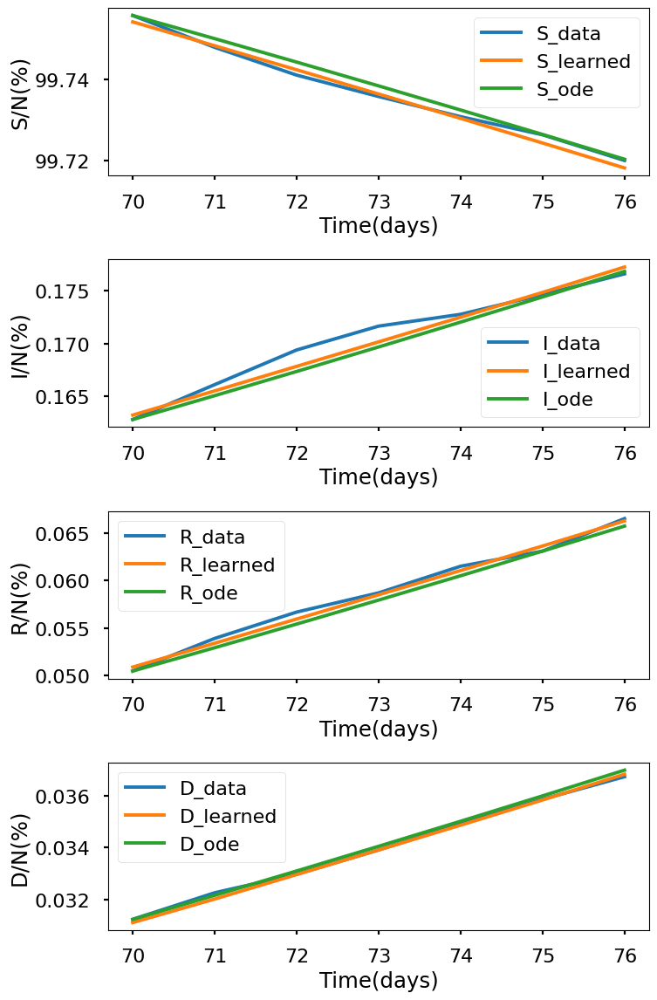

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 5.007e+00, GE_loss: 3.01664e+00,OB_loss: 1.99057e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.06, cumulative_time: 2.06
It: 10000, Loss: 2.337e-03, GE_loss: 4.92271e-04,OB_loss: 1.84499e-03, Beta: 1.09355e+00,gamma: 8.92124e-01,mu: 8.67532e-01, Time: 19.57, cumulative_time: 21.63
It: 20000, Loss: 4.986e-05, GE_loss: 2.48225e-05,OB_loss: 2.50407e-05, Beta: 2.73970e-02,gamma: 2.26390e-02,mu: 4.45457e-03, Time: 19.38, cumulative_time: 41.01
It: 30000, Loss: 4.217e-05, GE_loss: 1.98242e-05,OB_loss: 2.23442e-05, Beta: 2.70161e-02,gamma: 2.22557e-02,mu: 4.56975e-03, Time: 19.46, cumulative_time: 60.47
It: 40000, Loss: 3.954e-05, GE_loss: 1.00698e-05,OB_loss: 2.94699e-05, Beta: 2.62575e-02,gamma: 2.22078e-02,mu: 4.09332e-03, Time: 19.52, cumulative_time: 79.99
beta:  [0.02638663]
gamma:  [0.02208503]
mu:  [0.00436326]


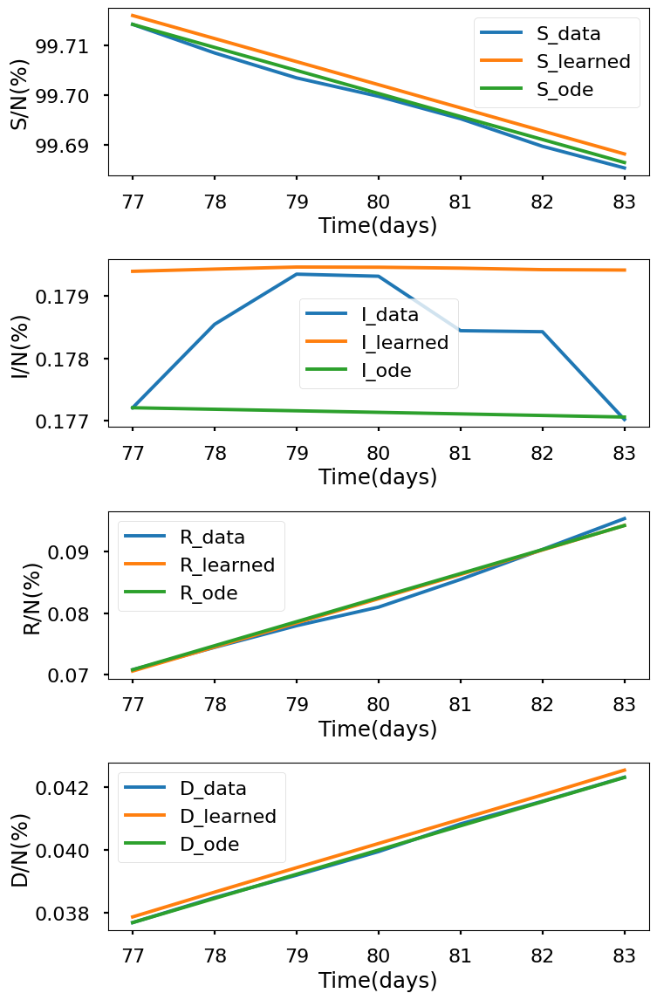

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.847e+00, GE_loss: 2.92169e+00,OB_loss: 1.92488e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.21, cumulative_time: 2.21
It: 10000, Loss: 2.280e-03, GE_loss: 5.17320e-04,OB_loss: 1.76310e-03, Beta: 1.14698e+00,gamma: 9.01706e-01,mu: 8.61597e-01, Time: 19.21, cumulative_time: 21.42
It: 20000, Loss: 3.796e-05, GE_loss: 1.19664e-05,OB_loss: 2.59926e-05, Beta: 2.02739e-02,gamma: 2.01771e-02,mu: 3.04993e-03, Time: 19.25, cumulative_time: 40.67
It: 30000, Loss: 6.683e-05, GE_loss: 3.11663e-05,OB_loss: 3.56626e-05, Beta: 2.04540e-02,gamma: 2.06232e-02,mu: 3.54081e-03, Time: 19.07, cumulative_time: 59.74
It: 40000, Loss: 3.657e-05, GE_loss: 1.10373e-05,OB_loss: 2.55369e-05, Beta: 2.02784e-02,gamma: 2.05897e-02,mu: 3.08205e-03, Time: 18.90, cumulative_time: 78.64
beta:  [0.01966251]
gamma:  [0.0198372]
mu:  [0.00319293]


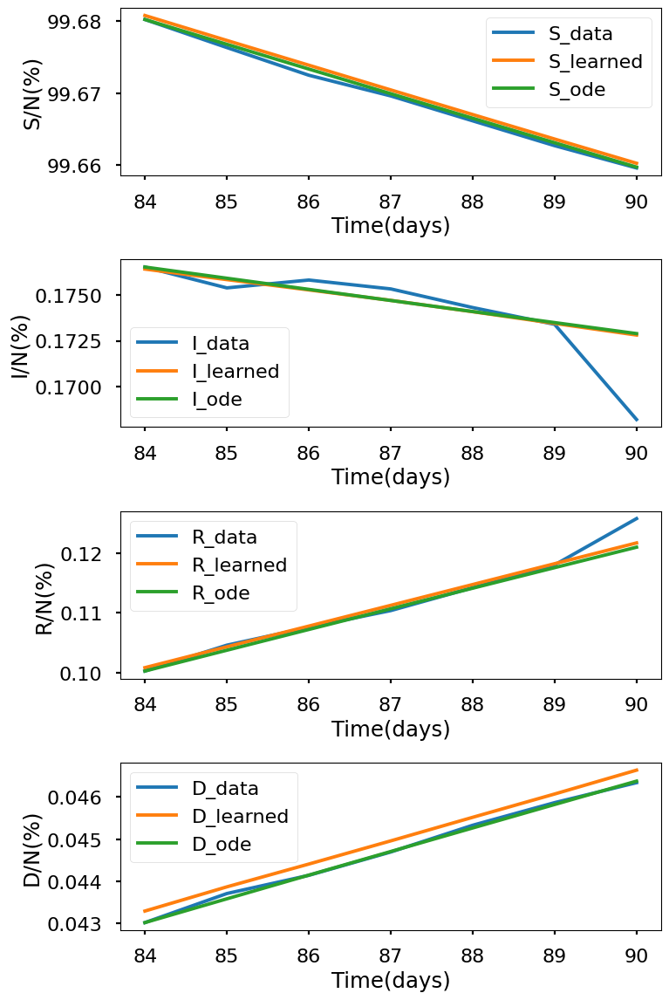

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 5.048e+00, GE_loss: 2.98992e+00,OB_loss: 2.05834e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.13, cumulative_time: 2.13
It: 10000, Loss: 9.216e-04, GE_loss: 1.12381e-04,OB_loss: 8.09267e-04, Beta: 1.75582e+00,gamma: 9.01583e-01,mu: 8.86329e-01, Time: 28.65, cumulative_time: 30.78
It: 20000, Loss: 7.183e-05, GE_loss: 1.77023e-05,OB_loss: 5.41302e-05, Beta: 1.30728e-02,gamma: 3.97119e-02,mu: 1.79064e-03, Time: 28.45, cumulative_time: 59.23
It: 30000, Loss: 6.453e-05, GE_loss: 1.86333e-05,OB_loss: 4.58937e-05, Beta: 1.15170e-02,gamma: 3.87134e-02,mu: 1.97715e-03, Time: 28.71, cumulative_time: 87.95
It: 40000, Loss: 7.881e-05, GE_loss: 3.24231e-05,OB_loss: 4.63917e-05, Beta: 1.19013e-02,gamma: 3.85245e-02,mu: 2.07482e-03, Time: 28.61, cumulative_time: 116.56
beta:  [0.01184951]
gamma:  [0.03895171]
mu:  [0.00210718]


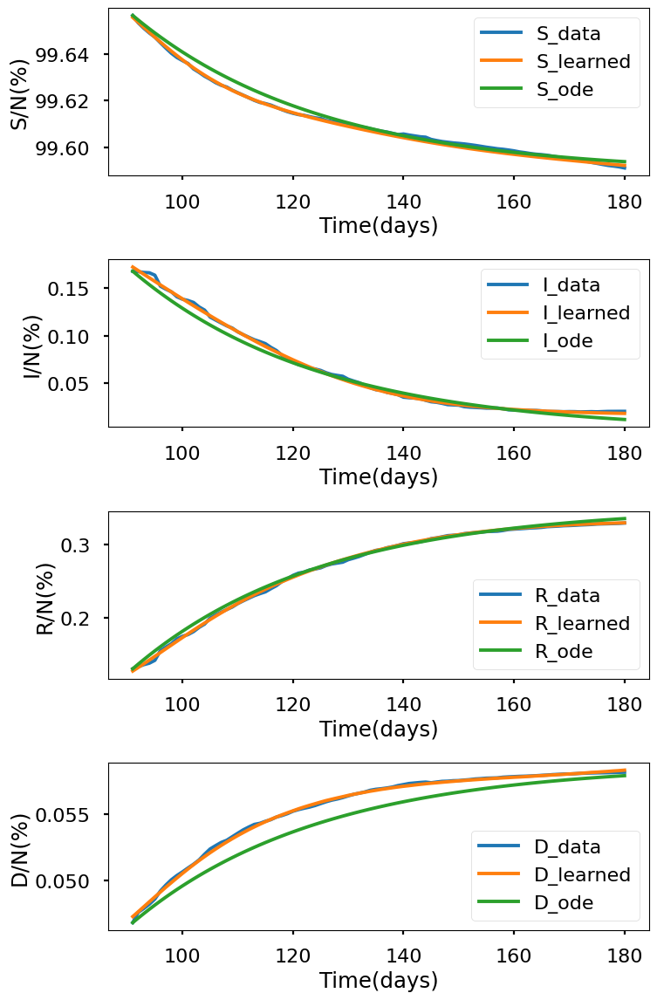

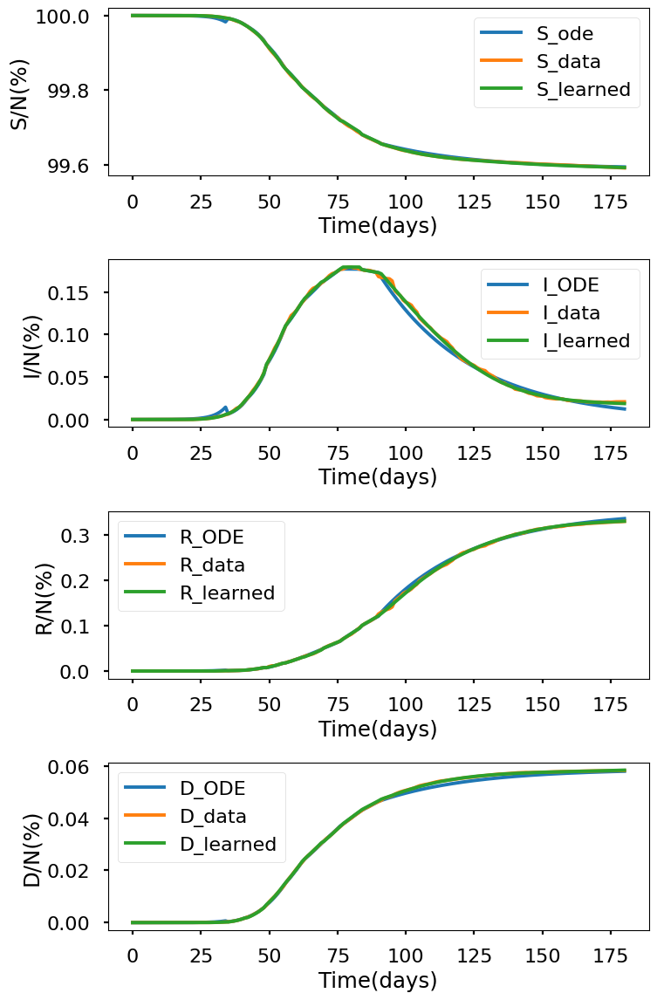

+---------------------+---------------------+-------------+-------------+--------------+-------------+--------------+--------------+--------------+--------------+--------------+
|      Paramaters     | Initial three weeks |   4th week  |   5th week  |   6th week   |   7th week  |   8th week   |   9th week   |  10th week   |  11th week   |  remainder   |
+---------------------+---------------------+-------------+-------------+--------------+-------------+--------------+--------------+--------------+--------------+--------------+
|         beta        |      0.28848547     |  0.22562912 |  0.16590637 |  0.11231543  |  0.06538998 | 0.043807458  | 0.034543213  | 0.026386626  |  0.01966251  | 0.011849506  |
|        gamma        |     0.032662332     | 0.014574047 | 0.022992091 |  0.01967247  | 0.016513105 | 0.016251035  | 0.015015932  | 0.022085026  | 0.019837195  | 0.038951706  |
|          mu         |     0.011192301     | 0.019454435 | 0.016384622 | 0.0142034255 | 0.010801971 | 0.00642

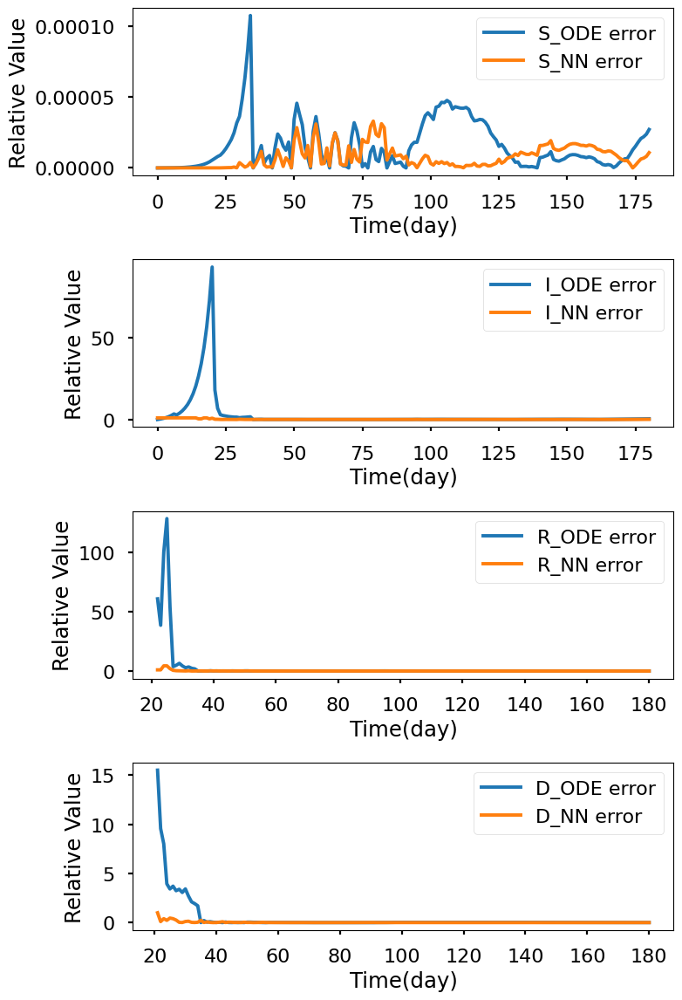

In [12]:
layers232 = [1,32,32,4]
S232_ode,I232_ode,R232_ode,D232_ode,S232_learned,I232_learned,R232_learned,D232_learned,beta232,gamma232,mu232,S_errnn232,I_errnn232,R_errnn232,D_errnn232,S_erode232,I_errode232,R_errode232,D_errode232,time232 = sum_all(
    layers232,length,SS,II,RC,DC,N0,0.1,50000)

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.994e+00, GE_loss: 2.98164e+00,OB_loss: 2.01269e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.31, cumulative_time: 2.31
It: 10000, Loss: 1.246e-05, GE_loss: 1.49786e-06,OB_loss: 1.09665e-05, Beta: 1.07988e+00,gamma: 9.33305e-01,mu: 9.33305e-01, Time: 25.99, cumulative_time: 28.29
It: 20000, Loss: 7.529e-06, GE_loss: 2.87869e-08,OB_loss: 7.50070e-06, Beta: 1.08368e+00,gamma: 9.26788e-01,mu: 9.26832e-01, Time: 25.71, cumulative_time: 54.00
It: 30000, Loss: 7.512e-06, GE_loss: 2.77328e-08,OB_loss: 7.48456e-06, Beta: 1.08368e+00,gamma: 9.25438e-01,mu: 9.25483e-01, Time: 26.03, cumulative_time: 80.03
It: 40000, Loss: 9.070e-07, GE_loss: 3.94977e-07,OB_loss: 5.12046e-07, Beta: 2.85854e-01,gamma: 3.21251e-02,mu: 1.15311e-02, Time: 25.96, cumulative_time: 105.99
beta:  [0.2872196]
gamma:  [0.03243251]
mu:  [0.01146486]


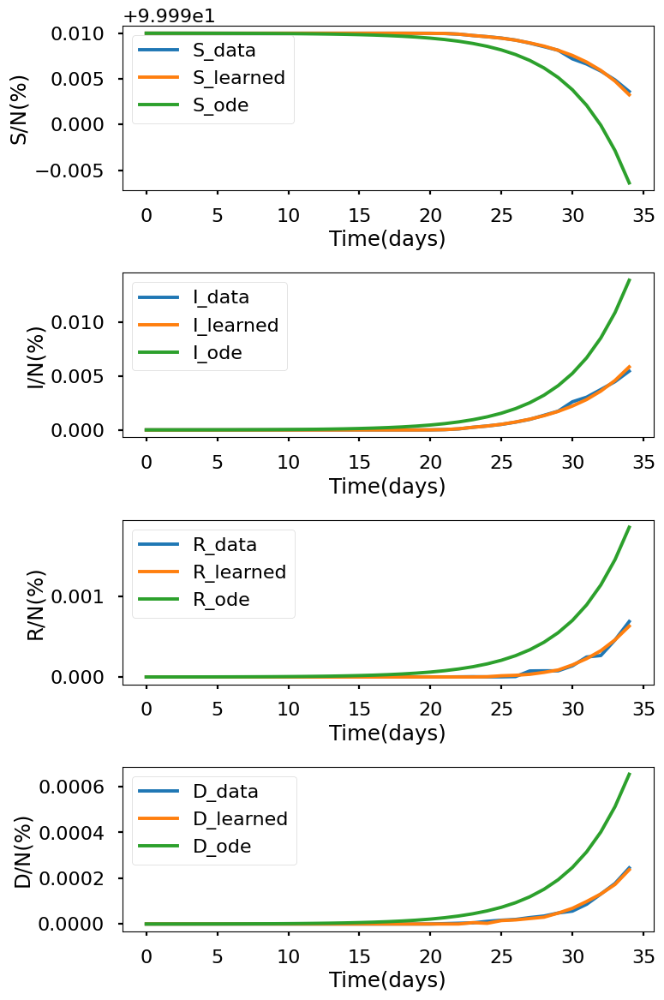

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.949e+00, GE_loss: 2.91884e+00,OB_loss: 2.02994e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.33, cumulative_time: 2.33
It: 10000, Loss: 1.622e-04, GE_loss: 2.50924e-05,OB_loss: 1.37141e-04, Beta: 1.14227e+00,gamma: 9.21278e-01,mu: 9.21820e-01, Time: 21.55, cumulative_time: 23.88
It: 20000, Loss: 1.110e-05, GE_loss: 2.79349e-06,OB_loss: 8.30963e-06, Beta: 2.32772e-01,gamma: 1.28886e-02,mu: 1.58719e-02, Time: 21.39, cumulative_time: 45.27
It: 30000, Loss: 5.902e-06, GE_loss: 8.85776e-07,OB_loss: 5.01574e-06, Beta: 2.25867e-01,gamma: 1.50900e-02,mu: 1.95031e-02, Time: 21.65, cumulative_time: 66.92
It: 40000, Loss: 5.877e-06, GE_loss: 1.22827e-06,OB_loss: 4.64825e-06, Beta: 2.25787e-01,gamma: 1.43967e-02,mu: 1.96243e-02, Time: 21.50, cumulative_time: 88.42
beta:  [0.22545144]
gamma:  [0.01502459]
mu:  [0.01972448]


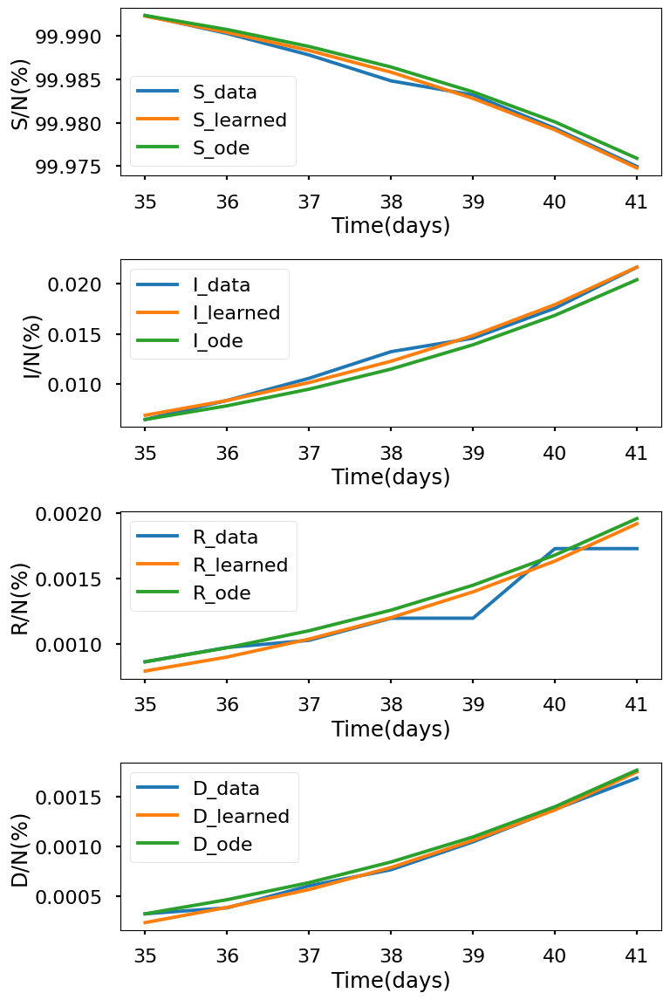

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.934e+00, GE_loss: 2.94859e+00,OB_loss: 1.98587e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.56, cumulative_time: 2.56
It: 10000, Loss: 4.792e-04, GE_loss: 6.04486e-05,OB_loss: 4.18738e-04, Beta: 1.12659e+00,gamma: 9.19288e-01,mu: 9.20944e-01, Time: 22.17, cumulative_time: 24.73
It: 20000, Loss: 1.438e-05, GE_loss: 3.83586e-06,OB_loss: 1.05469e-05, Beta: 1.66565e-01,gamma: 2.33764e-02,mu: 1.64860e-02, Time: 22.10, cumulative_time: 46.83
It: 30000, Loss: 1.269e-05, GE_loss: 3.42743e-06,OB_loss: 9.26521e-06, Beta: 1.66451e-01,gamma: 2.31085e-02,mu: 1.65660e-02, Time: 22.14, cumulative_time: 68.97
It: 40000, Loss: 1.392e-05, GE_loss: 3.43358e-06,OB_loss: 1.04909e-05, Beta: 1.64176e-01,gamma: 2.23712e-02,mu: 1.62700e-02, Time: 22.25, cumulative_time: 91.22
beta:  [0.16417576]
gamma:  [0.02244029]
mu:  [0.01641787]


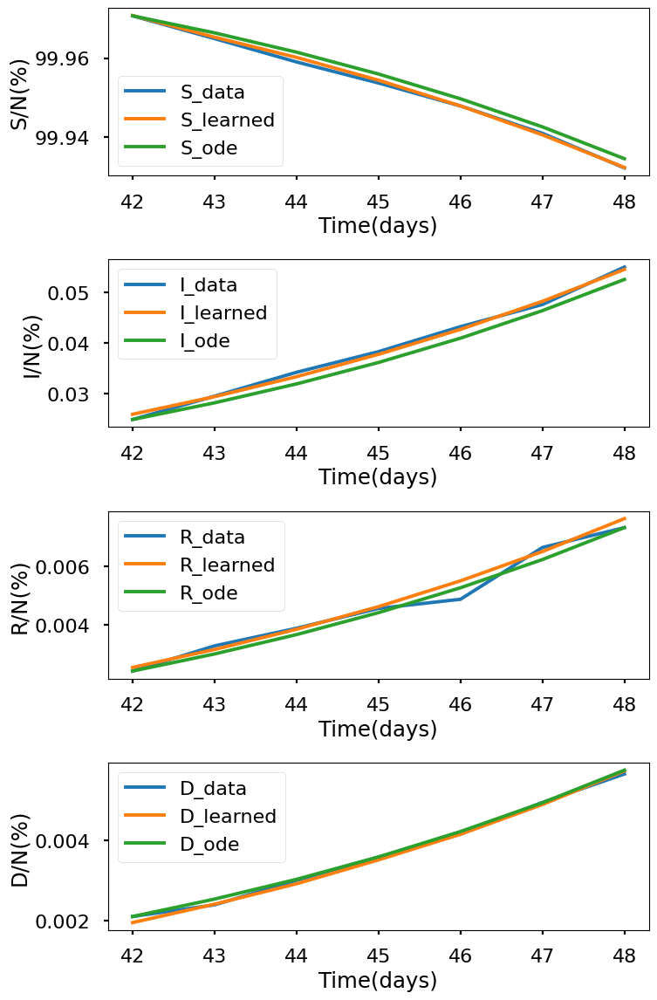

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.933e+00, GE_loss: 2.92679e+00,OB_loss: 2.00652e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.44, cumulative_time: 2.44
It: 10000, Loss: 1.032e-03, GE_loss: 1.50732e-04,OB_loss: 8.80884e-04, Beta: 1.08074e+00,gamma: 9.19576e-01,mu: 9.21582e-01, Time: 21.99, cumulative_time: 24.43
It: 20000, Loss: 2.632e-05, GE_loss: 8.48766e-06,OB_loss: 1.78363e-05, Beta: 1.11112e-01,gamma: 1.97120e-02,mu: 1.41252e-02, Time: 22.57, cumulative_time: 47.00
It: 30000, Loss: 2.556e-05, GE_loss: 8.11414e-06,OB_loss: 1.74506e-05, Beta: 1.10704e-01,gamma: 1.93999e-02,mu: 1.41189e-02, Time: 22.43, cumulative_time: 69.43
It: 40000, Loss: 3.645e-05, GE_loss: 2.28821e-05,OB_loss: 1.35695e-05, Beta: 1.10031e-01,gamma: 1.92532e-02,mu: 1.37691e-02, Time: 21.79, cumulative_time: 91.23
beta:  [0.11006789]
gamma:  [0.0192243]
mu:  [0.0139535]


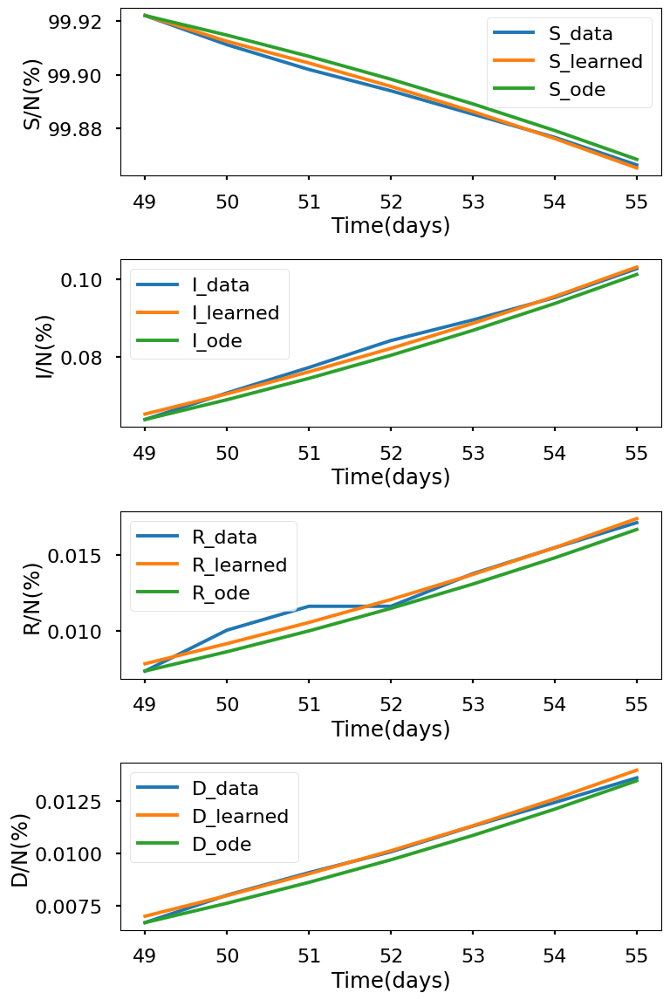

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.924e+00, GE_loss: 2.97412e+00,OB_loss: 1.95006e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.47, cumulative_time: 2.47
It: 10000, Loss: 1.540e-03, GE_loss: 2.65441e-04,OB_loss: 1.27443e-03, Beta: 1.37376e+00,gamma: 8.95854e-01,mu: 8.74986e-01, Time: 22.94, cumulative_time: 25.41
It: 20000, Loss: 4.936e-05, GE_loss: 2.58549e-05,OB_loss: 2.35097e-05, Beta: 6.46438e-02,gamma: 1.62457e-02,mu: 1.09338e-02, Time: 22.33, cumulative_time: 47.74
It: 30000, Loss: 2.711e-05, GE_loss: 9.15946e-06,OB_loss: 1.79537e-05, Beta: 6.48759e-02,gamma: 1.62927e-02,mu: 1.10278e-02, Time: 21.79, cumulative_time: 69.53
It: 40000, Loss: 2.578e-05, GE_loss: 8.91984e-06,OB_loss: 1.68621e-05, Beta: 6.46674e-02,gamma: 1.62446e-02,mu: 1.08537e-02, Time: 21.65, cumulative_time: 91.18
beta:  [0.06504405]
gamma:  [0.01633168]
mu:  [0.0107908]


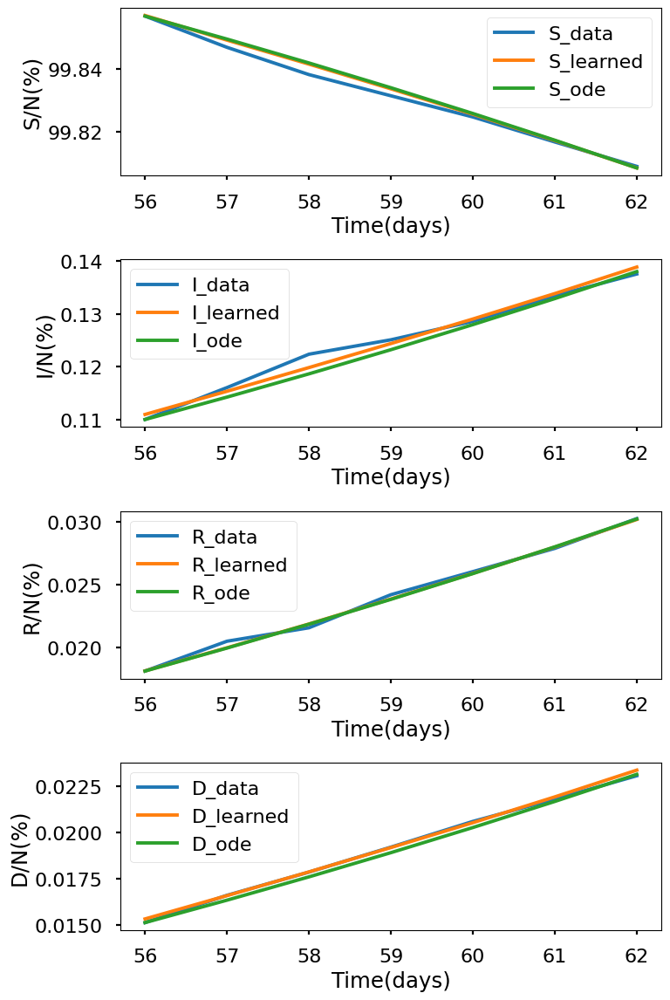

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 5.015e+00, GE_loss: 2.99747e+00,OB_loss: 2.01761e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.46, cumulative_time: 2.46
It: 10000, Loss: 1.928e-03, GE_loss: 3.78536e-04,OB_loss: 1.54989e-03, Beta: 1.31592e+00,gamma: 9.07347e-01,mu: 8.71641e-01, Time: 22.17, cumulative_time: 24.63
It: 20000, Loss: 4.281e-05, GE_loss: 2.14796e-05,OB_loss: 2.13312e-05, Beta: 4.33710e-02,gamma: 1.64303e-02,mu: 6.57870e-03, Time: 22.31, cumulative_time: 46.95
It: 30000, Loss: 5.587e-05, GE_loss: 2.20452e-05,OB_loss: 3.38292e-05, Beta: 4.22808e-02,gamma: 1.56862e-02,mu: 6.36878e-03, Time: 22.32, cumulative_time: 69.27
It: 40000, Loss: 2.958e-05, GE_loss: 9.56926e-06,OB_loss: 2.00062e-05, Beta: 4.32352e-02,gamma: 1.64289e-02,mu: 6.67133e-03, Time: 22.19, cumulative_time: 91.46
beta:  [0.04387651]
gamma:  [0.01621181]
mu:  [0.00653251]


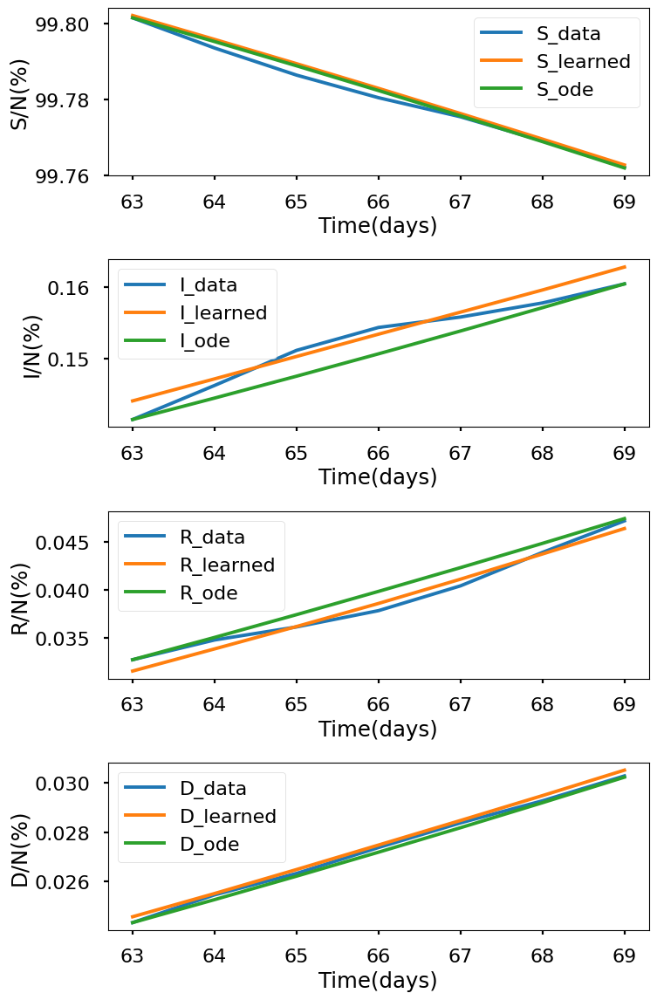

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.901e+00, GE_loss: 2.96877e+00,OB_loss: 1.93227e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.50, cumulative_time: 2.50
It: 10000, Loss: 2.140e-03, GE_loss: 4.35483e-04,OB_loss: 1.70435e-03, Beta: 1.19619e+00,gamma: 9.11881e-01,mu: 8.70061e-01, Time: 27.12, cumulative_time: 29.62
It: 20000, Loss: 2.520e-05, GE_loss: 6.06147e-06,OB_loss: 1.91386e-05, Beta: 3.46743e-02,gamma: 1.52959e-02,mu: 5.68195e-03, Time: 22.58, cumulative_time: 52.19
It: 30000, Loss: 5.548e-05, GE_loss: 3.55061e-05,OB_loss: 1.99725e-05, Beta: 3.45208e-02,gamma: 1.49428e-02,mu: 5.65836e-03, Time: 21.99, cumulative_time: 74.18
It: 40000, Loss: 3.376e-05, GE_loss: 1.59445e-05,OB_loss: 1.78130e-05, Beta: 3.58208e-02,gamma: 1.55612e-02,mu: 5.82263e-03, Time: 21.80, cumulative_time: 95.98
beta:  [0.03523648]
gamma:  [0.01501674]
mu:  [0.00578445]


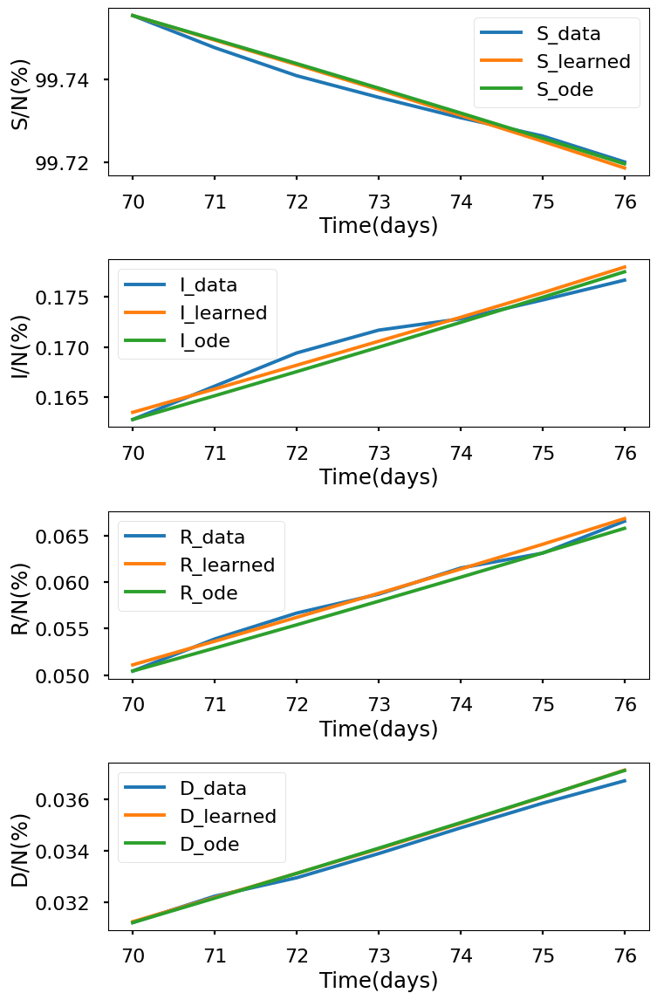

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.980e+00, GE_loss: 2.98173e+00,OB_loss: 1.99779e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.58, cumulative_time: 2.58
It: 10000, Loss: 2.295e-03, GE_loss: 4.80262e-04,OB_loss: 1.81519e-03, Beta: 1.16445e+00,gamma: 9.19960e-01,mu: 8.52326e-01, Time: 22.04, cumulative_time: 24.63
It: 20000, Loss: 5.086e-05, GE_loss: 2.75512e-05,OB_loss: 2.33103e-05, Beta: 2.67604e-02,gamma: 2.22348e-02,mu: 4.20199e-03, Time: 21.99, cumulative_time: 46.62
It: 30000, Loss: 2.565e-05, GE_loss: 9.29357e-06,OB_loss: 1.63565e-05, Beta: 2.67868e-02,gamma: 2.22100e-02,mu: 4.58671e-03, Time: 21.58, cumulative_time: 68.19
It: 40000, Loss: 3.776e-05, GE_loss: 1.59523e-05,OB_loss: 2.18062e-05, Beta: 2.69995e-02,gamma: 2.23282e-02,mu: 4.55277e-03, Time: 21.71, cumulative_time: 89.90
beta:  [0.02746194]
gamma:  [0.0228109]
mu:  [0.00435242]


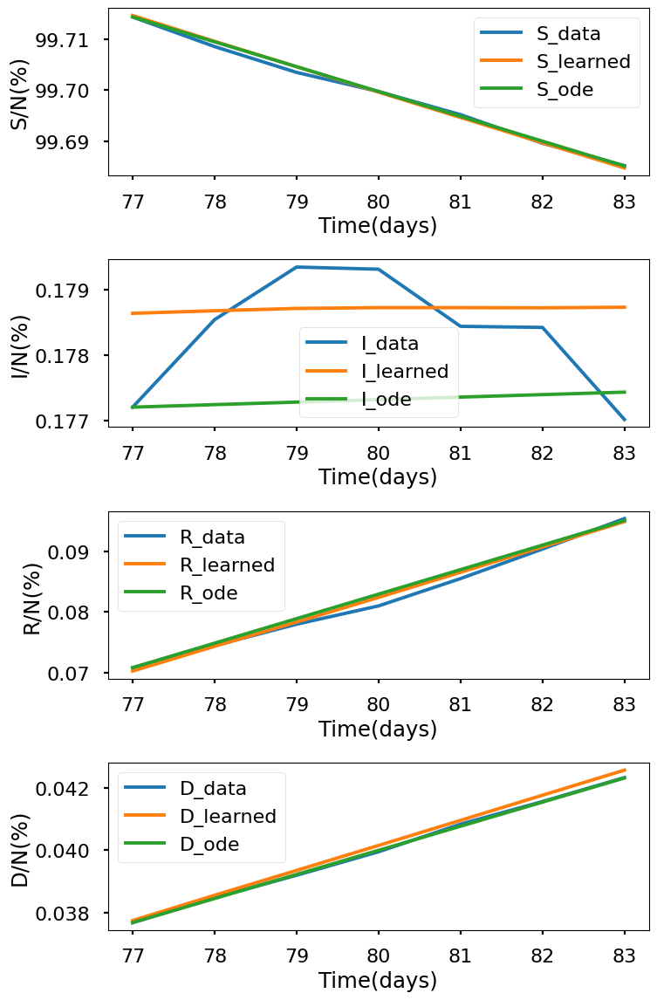

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.915e+00, GE_loss: 2.91565e+00,OB_loss: 1.99899e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.63, cumulative_time: 2.63
It: 10000, Loss: 2.209e-03, GE_loss: 4.58160e-04,OB_loss: 1.75046e-03, Beta: 1.27240e+00,gamma: 9.07327e-01,mu: 8.43450e-01, Time: 21.97, cumulative_time: 24.60
It: 20000, Loss: 8.545e-05, GE_loss: 4.35895e-05,OB_loss: 4.18572e-05, Beta: 2.15739e-02,gamma: 2.10014e-02,mu: 3.47770e-03, Time: 23.07, cumulative_time: 47.67
It: 30000, Loss: 2.559e-05, GE_loss: 8.05061e-06,OB_loss: 1.75418e-05, Beta: 2.04187e-02,gamma: 2.01304e-02,mu: 3.27366e-03, Time: 21.73, cumulative_time: 69.40
It: 40000, Loss: 4.764e-05, GE_loss: 2.10336e-05,OB_loss: 2.66103e-05, Beta: 1.99394e-02,gamma: 2.02936e-02,mu: 3.04773e-03, Time: 21.70, cumulative_time: 91.10
beta:  [0.01962604]
gamma:  [0.02035926]
mu:  [0.00343668]


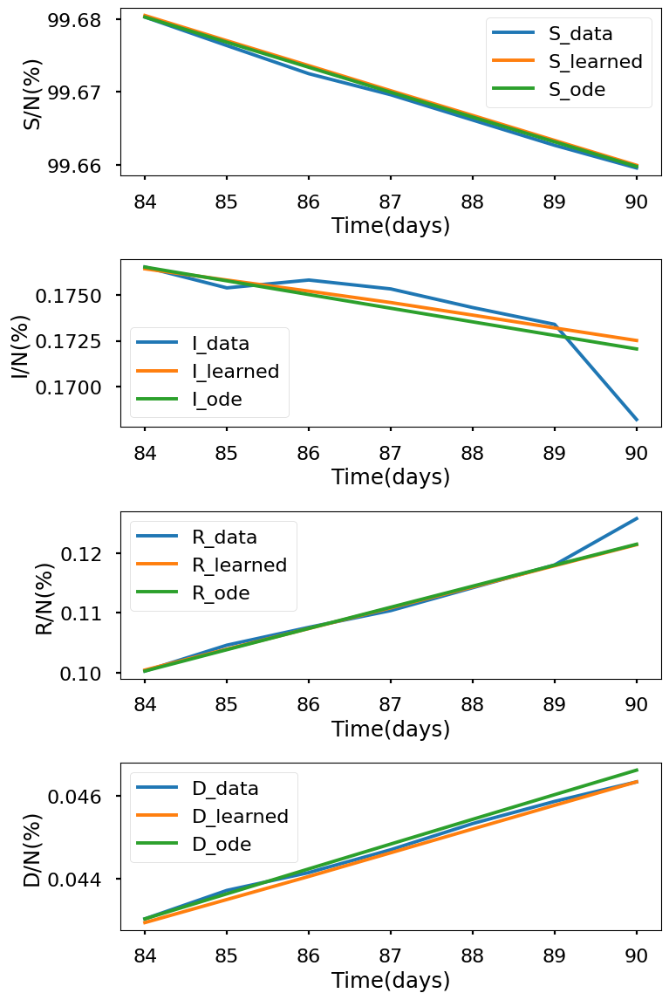

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.935e+00, GE_loss: 2.97638e+00,OB_loss: 1.95836e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.70, cumulative_time: 2.70
It: 10000, Loss: 8.513e-04, GE_loss: 1.02653e-04,OB_loss: 7.48612e-04, Beta: 1.75620e+00,gamma: 9.23115e-01,mu: 9.04648e-01, Time: 36.36, cumulative_time: 39.06
It: 20000, Loss: 8.589e-05, GE_loss: 4.17388e-05,OB_loss: 4.41480e-05, Beta: 1.25464e-02,gamma: 3.87446e-02,mu: 1.76250e-03, Time: 35.76, cumulative_time: 74.82
It: 30000, Loss: 4.842e-05, GE_loss: 2.35127e-05,OB_loss: 2.49059e-05, Beta: 1.18227e-02,gamma: 3.86839e-02,mu: 1.94611e-03, Time: 36.89, cumulative_time: 111.71
It: 40000, Loss: 5.092e-05, GE_loss: 1.47148e-05,OB_loss: 3.62015e-05, Beta: 1.16745e-02,gamma: 3.78936e-02,mu: 2.17163e-03, Time: 36.69, cumulative_time: 148.41
beta:  [0.01177512]
gamma:  [0.03911912]
mu:  [0.00205136]


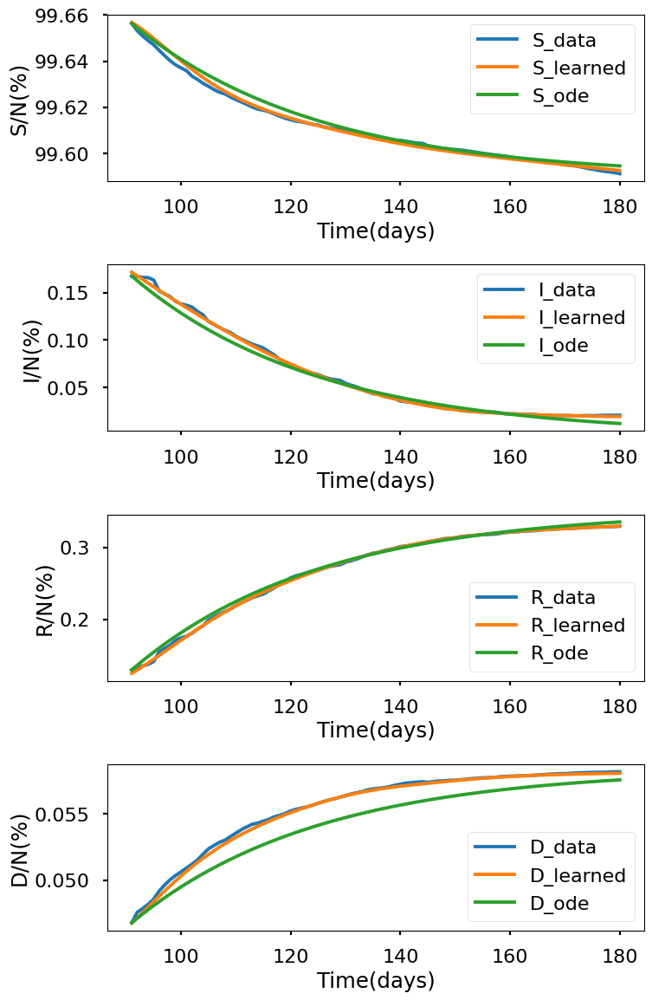

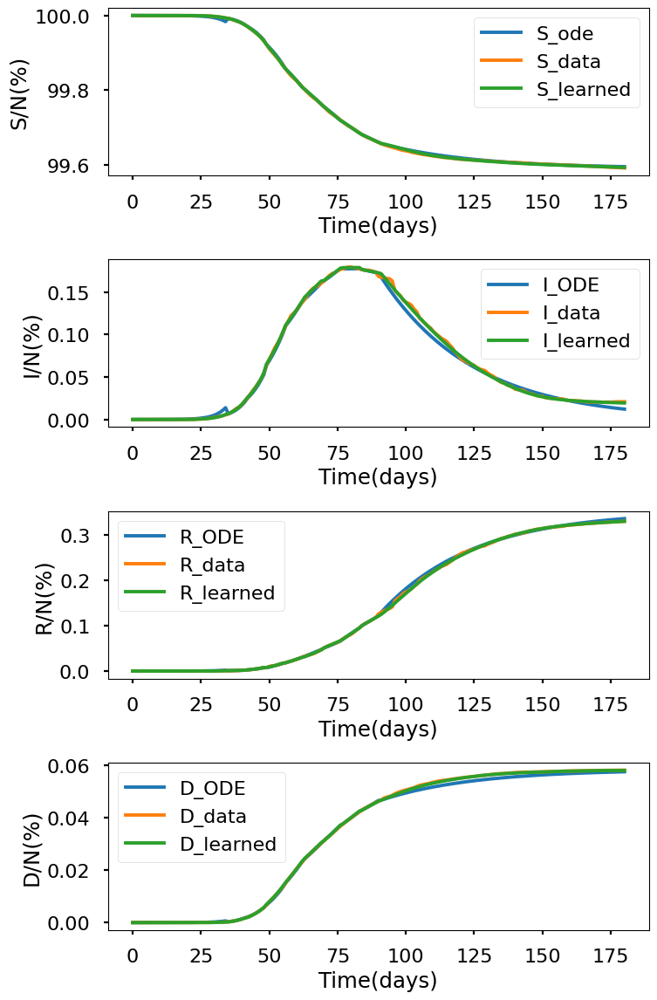

+---------------------+---------------------+-------------+-------------+-------------+-------------+-------------+--------------+--------------+--------------+-------------+
|      Paramaters     | Initial three weeks |   4th week  |   5th week  |   6th week  |   7th week  |   8th week  |   9th week   |  10th week   |  11th week   |  remainder  |
+---------------------+---------------------+-------------+-------------+-------------+-------------+-------------+--------------+--------------+--------------+-------------+
|         beta        |      0.2872196      |  0.22545144 |  0.16417576 |  0.11006789 |  0.06504405 | 0.043876506 | 0.035236478  | 0.027461942  |  0.01962604  | 0.011775116 |
|        gamma        |      0.03243251     | 0.015024589 | 0.022440292 | 0.019224295 | 0.016331684 | 0.016211811 | 0.015016739  | 0.022810899  | 0.020359261  | 0.039119124 |
|          mu         |     0.011464859     | 0.019724483 | 0.016417872 | 0.013953501 | 0.010790802 | 0.006532512 | 0.0057844

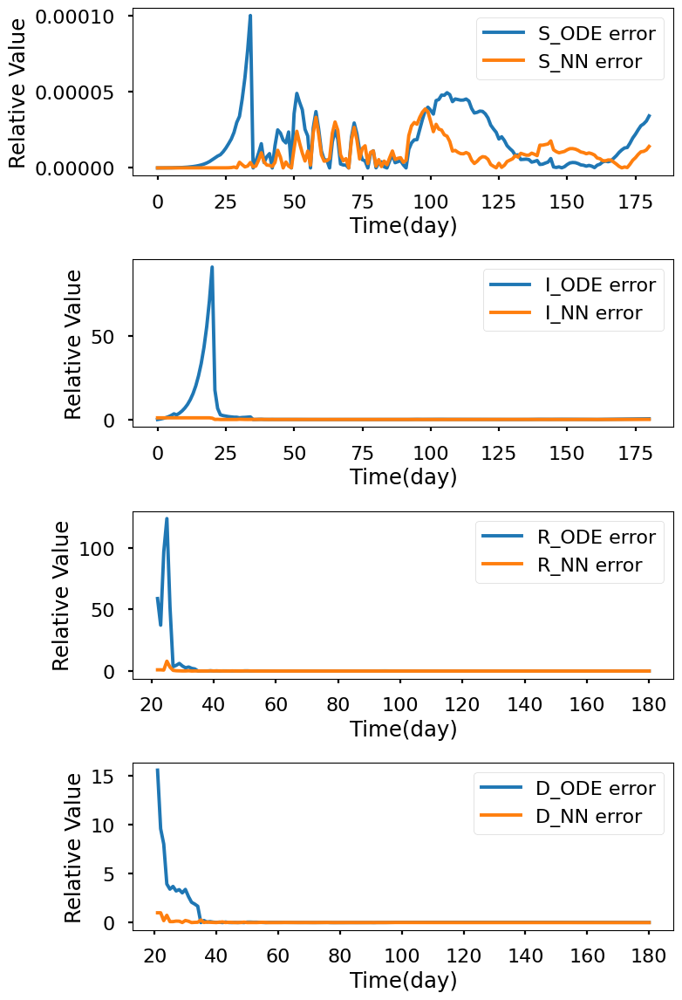

In [13]:
layers332 = [1,32,32,32,4]
S332_ode,I332_ode,R332_ode,D332_ode,S332_learned,I332_learned,R332_learned,D332_learned,beta332,gamma332,mu332,S_errnn332,I_errnn332,R_errnn332,D_errnn332,S_erode332,I_errode332,R_errode332,D_errode332,time332 = sum_all(
    layers332,length,SS,II,RC,DC,N0,0.1,50000)

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.998e+00, GE_loss: 2.97620e+00,OB_loss: 2.02219e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.75, cumulative_time: 2.75
It: 10000, Loss: 1.140e-05, GE_loss: 1.53613e-06,OB_loss: 9.86875e-06, Beta: 1.00000e+00,gamma: 9.42781e-01,mu: 9.42781e-01, Time: 30.11, cumulative_time: 32.86
It: 20000, Loss: 7.516e-06, GE_loss: 1.02053e-08,OB_loss: 7.50553e-06, Beta: 1.00000e+00,gamma: 9.37161e-01,mu: 9.37161e-01, Time: 29.78, cumulative_time: 62.64
It: 30000, Loss: 7.514e-06, GE_loss: 2.70686e-08,OB_loss: 7.48676e-06, Beta: 1.00000e+00,gamma: 9.32905e-01,mu: 9.32905e-01, Time: 30.28, cumulative_time: 92.92
It: 40000, Loss: 7.511e-06, GE_loss: 0.00000e+00,OB_loss: 7.51140e-06, Beta: 1.12223e+00,gamma: 8.76112e-01,mu: 8.69690e-01, Time: 29.96, cumulative_time: 122.88
beta:  [1.1222334]
gamma:  [0.87611246]
mu:  [0.8696904]


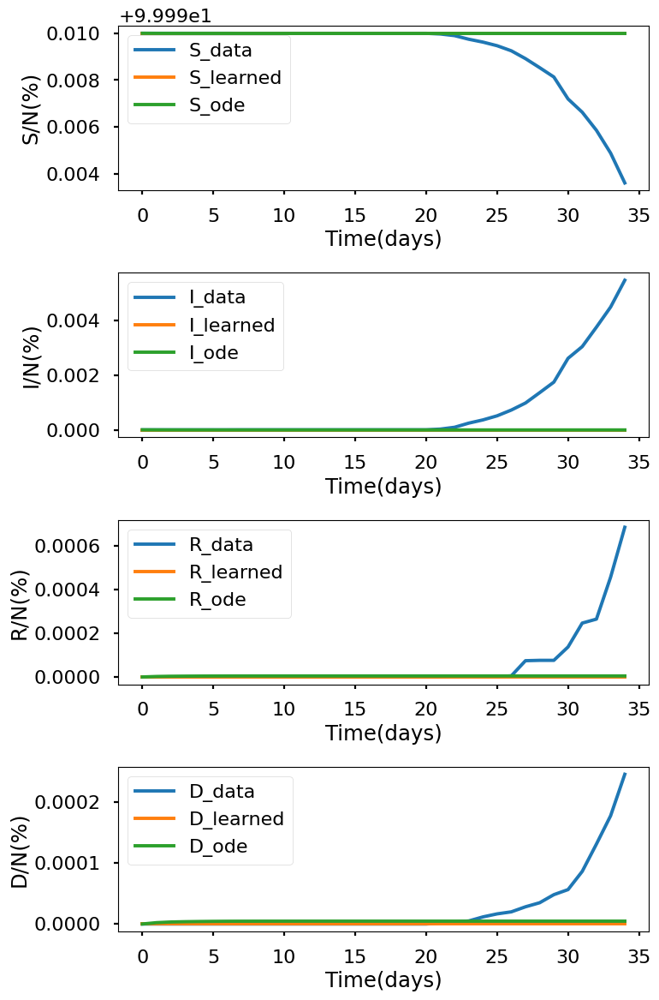

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.940e+00, GE_loss: 2.96404e+00,OB_loss: 1.97612e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.81, cumulative_time: 2.81
It: 10000, Loss: 1.893e-04, GE_loss: 3.74836e-06,OB_loss: 1.85509e-04, Beta: 1.08318e+00,gamma: 9.33467e-01,mu: 9.34105e-01, Time: 24.57, cumulative_time: 27.39
It: 20000, Loss: 9.766e-05, GE_loss: 1.72759e-05,OB_loss: 8.03849e-05, Beta: 9.31241e-01,gamma: 6.88179e-02,mu: 1.13143e-01, Time: 23.95, cumulative_time: 51.33
It: 30000, Loss: 6.709e-06, GE_loss: 1.82344e-06,OB_loss: 4.88513e-06, Beta: 2.25007e-01,gamma: 1.44822e-02,mu: 1.91792e-02, Time: 23.94, cumulative_time: 75.28
It: 40000, Loss: 5.824e-06, GE_loss: 1.12592e-06,OB_loss: 4.69803e-06, Beta: 2.24705e-01,gamma: 1.44857e-02,mu: 1.93919e-02, Time: 25.03, cumulative_time: 100.31
beta:  [0.22416338]
gamma:  [0.01429169]
mu:  [0.01926073]


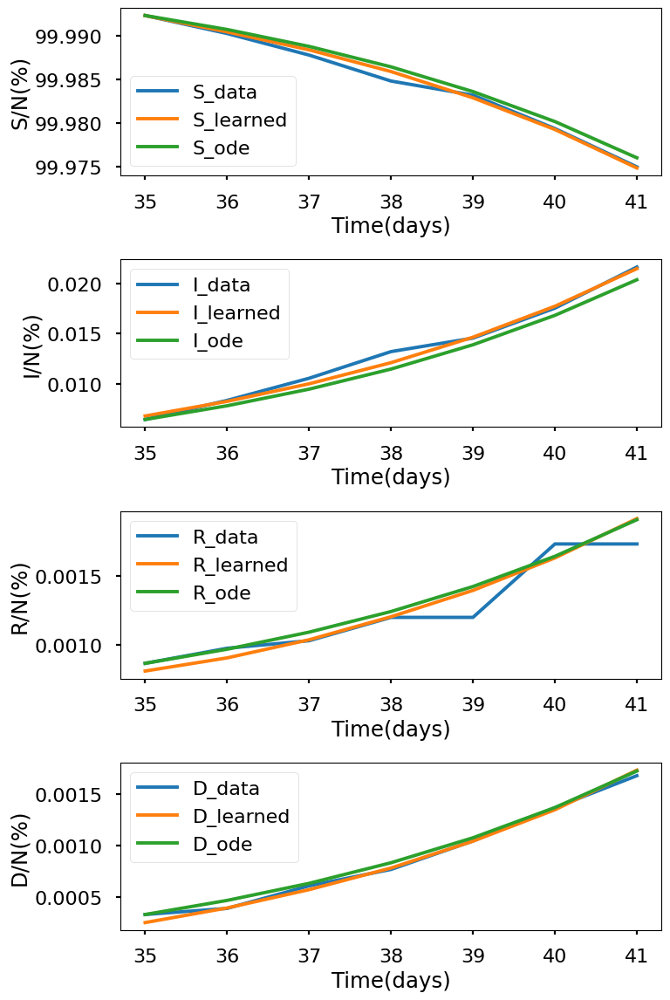

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 5.018e+00, GE_loss: 2.98518e+00,OB_loss: 2.03238e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.88, cumulative_time: 2.88
It: 10000, Loss: 4.775e-04, GE_loss: 6.80056e-05,OB_loss: 4.09533e-04, Beta: 1.06659e+00,gamma: 9.14385e-01,mu: 9.12873e-01, Time: 24.49, cumulative_time: 27.37
It: 20000, Loss: 1.775e-05, GE_loss: 6.50754e-06,OB_loss: 1.12449e-05, Beta: 1.66902e-01,gamma: 2.31726e-02,mu: 1.70035e-02, Time: 24.52, cumulative_time: 51.90
It: 30000, Loss: 1.618e-05, GE_loss: 6.03246e-06,OB_loss: 1.01487e-05, Beta: 1.65134e-01,gamma: 2.23851e-02,mu: 1.65287e-02, Time: 24.25, cumulative_time: 76.15
It: 40000, Loss: 1.147e-05, GE_loss: 3.20731e-06,OB_loss: 8.25798e-06, Beta: 1.63389e-01,gamma: 2.23723e-02,mu: 1.63959e-02, Time: 24.23, cumulative_time: 100.39
beta:  [0.16293198]
gamma:  [0.02249749]
mu:  [0.01634691]


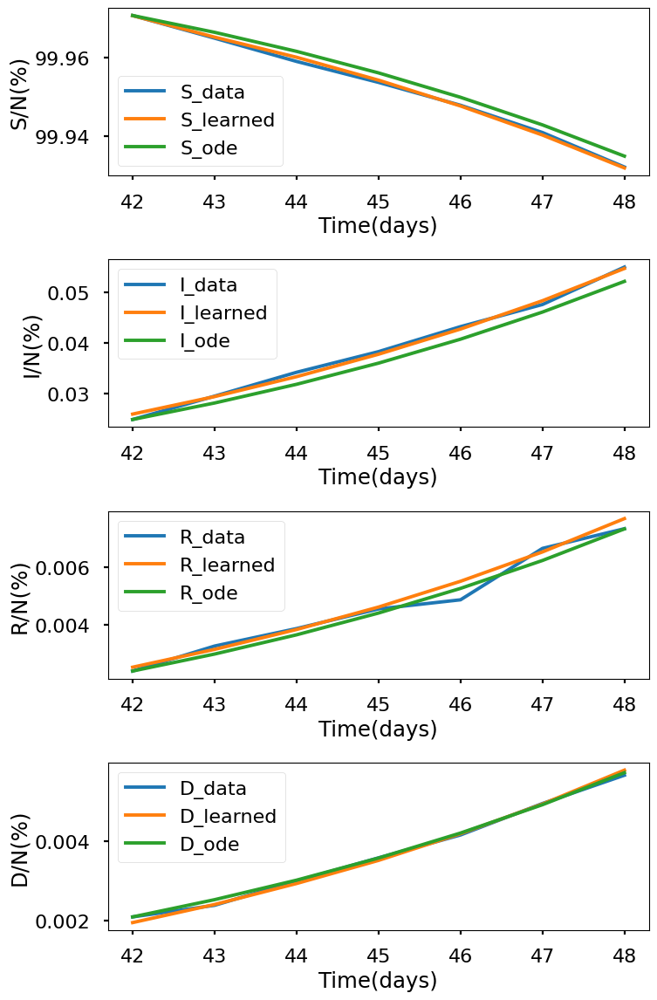

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.917e+00, GE_loss: 2.95079e+00,OB_loss: 1.96661e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.90, cumulative_time: 2.90
It: 10000, Loss: 1.086e-03, GE_loss: 1.65857e-04,OB_loss: 9.20429e-04, Beta: 1.10641e+00,gamma: 9.23167e-01,mu: 9.27062e-01, Time: 24.54, cumulative_time: 27.45
It: 20000, Loss: 3.605e-05, GE_loss: 1.81277e-05,OB_loss: 1.79221e-05, Beta: 1.09901e-01,gamma: 1.94384e-02,mu: 1.38287e-02, Time: 27.18, cumulative_time: 54.63
It: 30000, Loss: 2.074e-05, GE_loss: 5.06060e-06,OB_loss: 1.56789e-05, Beta: 1.10301e-01,gamma: 1.92287e-02,mu: 1.39796e-02, Time: 25.07, cumulative_time: 79.70
It: 40000, Loss: 2.398e-05, GE_loss: 9.76093e-06,OB_loss: 1.42203e-05, Beta: 1.08657e-01,gamma: 1.91468e-02,mu: 1.36855e-02, Time: 24.65, cumulative_time: 104.35
beta:  [0.10819821]
gamma:  [0.01893136]
mu:  [0.01374382]


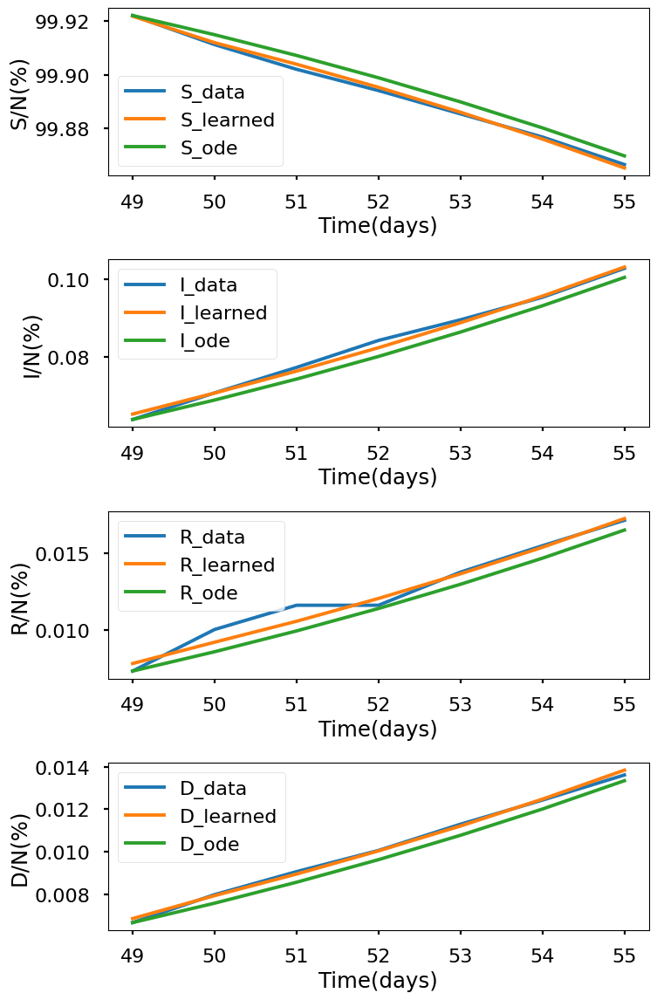

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.976e+00, GE_loss: 2.98121e+00,OB_loss: 1.99439e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.00, cumulative_time: 3.00
It: 10000, Loss: 1.522e-03, GE_loss: 2.68339e-04,OB_loss: 1.25364e-03, Beta: 1.32004e+00,gamma: 9.15739e-01,mu: 8.94561e-01, Time: 24.43, cumulative_time: 27.43
It: 20000, Loss: 2.809e-05, GE_loss: 1.01779e-05,OB_loss: 1.79130e-05, Beta: 6.06262e-02,gamma: 1.52168e-02,mu: 1.02455e-02, Time: 24.19, cumulative_time: 51.62
It: 30000, Loss: 1.974e-05, GE_loss: 4.12318e-06,OB_loss: 1.56164e-05, Beta: 6.06941e-02,gamma: 1.57196e-02,mu: 1.04488e-02, Time: 24.23, cumulative_time: 75.85
It: 40000, Loss: 3.576e-05, GE_loss: 1.88828e-05,OB_loss: 1.68816e-05, Beta: 6.00227e-02,gamma: 1.56203e-02,mu: 1.07544e-02, Time: 24.68, cumulative_time: 100.53
beta:  [0.05905861]
gamma:  [0.01524369]
mu:  [0.01055618]


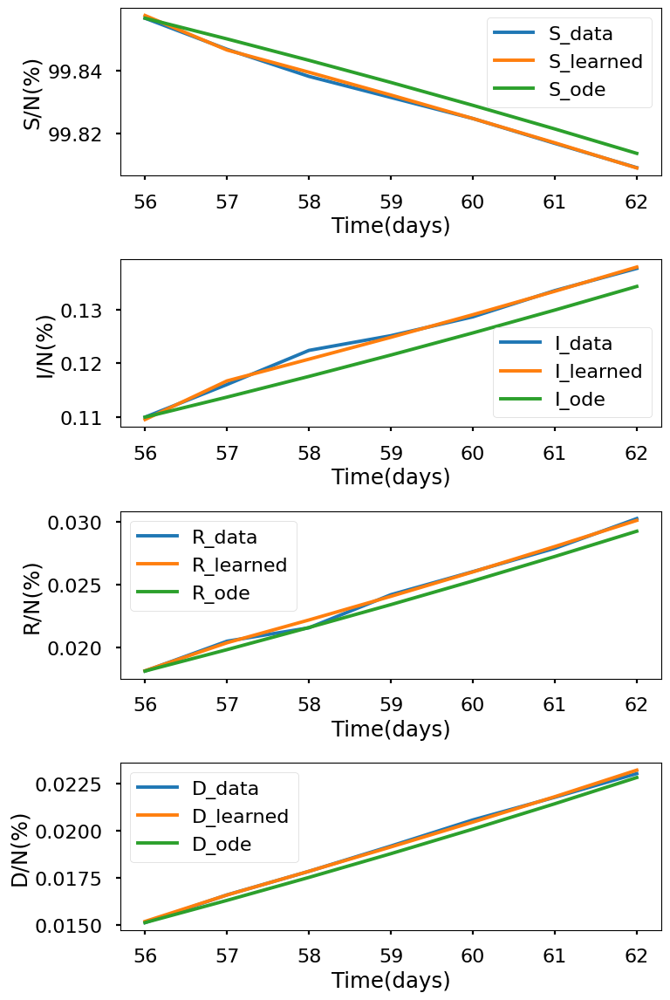

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.918e+00, GE_loss: 2.95974e+00,OB_loss: 1.95858e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 2.98, cumulative_time: 2.98
It: 10000, Loss: 1.879e-03, GE_loss: 3.20483e-04,OB_loss: 1.55832e-03, Beta: 1.45238e+00,gamma: 8.97327e-01,mu: 8.56343e-01, Time: 23.99, cumulative_time: 26.97
It: 20000, Loss: 3.849e-05, GE_loss: 1.27893e-05,OB_loss: 2.57025e-05, Beta: 4.06950e-02,gamma: 1.54166e-02,mu: 6.37684e-03, Time: 23.93, cumulative_time: 50.90
It: 30000, Loss: 3.414e-05, GE_loss: 1.32486e-05,OB_loss: 2.08926e-05, Beta: 4.21461e-02,gamma: 1.55781e-02,mu: 6.18084e-03, Time: 25.30, cumulative_time: 76.21
It: 40000, Loss: 4.044e-05, GE_loss: 1.89882e-05,OB_loss: 2.14496e-05, Beta: 4.29541e-02,gamma: 1.62286e-02,mu: 6.46643e-03, Time: 23.84, cumulative_time: 100.05
beta:  [0.04319279]
gamma:  [0.01611089]
mu:  [0.00663481]


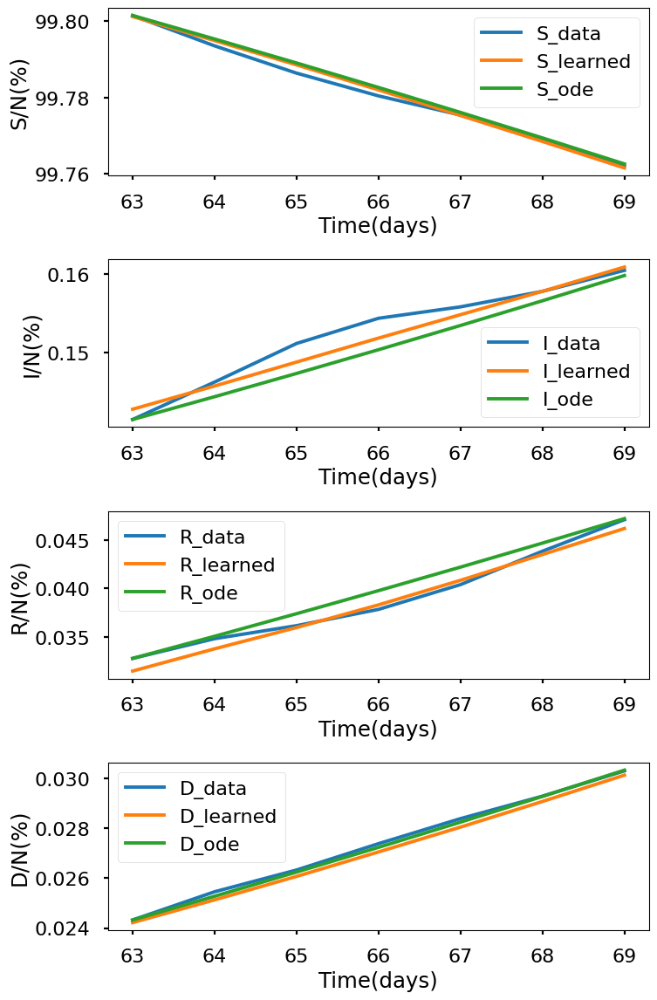

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.968e+00, GE_loss: 3.00009e+00,OB_loss: 1.96814e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.03, cumulative_time: 3.03
It: 10000, Loss: 2.140e-03, GE_loss: 3.78467e-04,OB_loss: 1.76136e-03, Beta: 1.30650e+00,gamma: 9.15754e-01,mu: 8.70804e-01, Time: 24.13, cumulative_time: 27.15
It: 20000, Loss: 2.403e-05, GE_loss: 8.81447e-06,OB_loss: 1.52194e-05, Beta: 3.28451e-02,gamma: 1.44741e-02,mu: 5.53405e-03, Time: 24.21, cumulative_time: 51.36
It: 30000, Loss: 3.019e-05, GE_loss: 1.92440e-05,OB_loss: 1.09494e-05, Beta: 3.19429e-02,gamma: 1.40247e-02,mu: 5.33766e-03, Time: 24.00, cumulative_time: 75.36
It: 40000, Loss: 5.812e-05, GE_loss: 3.12652e-05,OB_loss: 2.68551e-05, Beta: 3.21926e-02,gamma: 1.39811e-02,mu: 5.27817e-03, Time: 24.09, cumulative_time: 99.45
beta:  [0.0320578]
gamma:  [0.01400184]
mu:  [0.00577574]


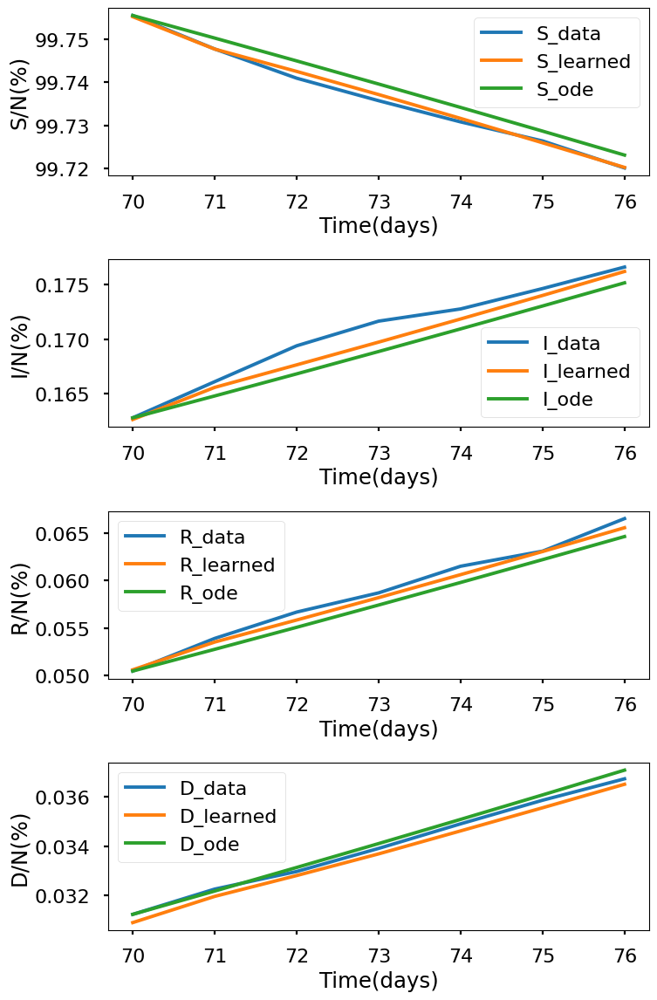

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.814e+00, GE_loss: 2.88601e+00,OB_loss: 1.92811e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.14, cumulative_time: 3.14
It: 10000, Loss: 2.222e-03, GE_loss: 4.21686e-04,OB_loss: 1.80080e-03, Beta: 1.25836e+00,gamma: 9.29809e-01,mu: 8.77596e-01, Time: 24.70, cumulative_time: 27.84
It: 20000, Loss: 5.471e-05, GE_loss: 2.78589e-05,OB_loss: 2.68532e-05, Beta: 2.69449e-02,gamma: 2.23447e-02,mu: 4.27073e-03, Time: 25.87, cumulative_time: 53.70
It: 30000, Loss: 5.935e-05, GE_loss: 2.81974e-05,OB_loss: 3.11539e-05, Beta: 2.73410e-02,gamma: 2.28988e-02,mu: 4.31295e-03, Time: 24.18, cumulative_time: 77.88
It: 40000, Loss: 3.572e-05, GE_loss: 1.41071e-05,OB_loss: 2.16152e-05, Beta: 2.72853e-02,gamma: 2.23203e-02,mu: 4.49786e-03, Time: 24.42, cumulative_time: 102.31
beta:  [0.02772796]
gamma:  [0.02302078]
mu:  [0.00441679]


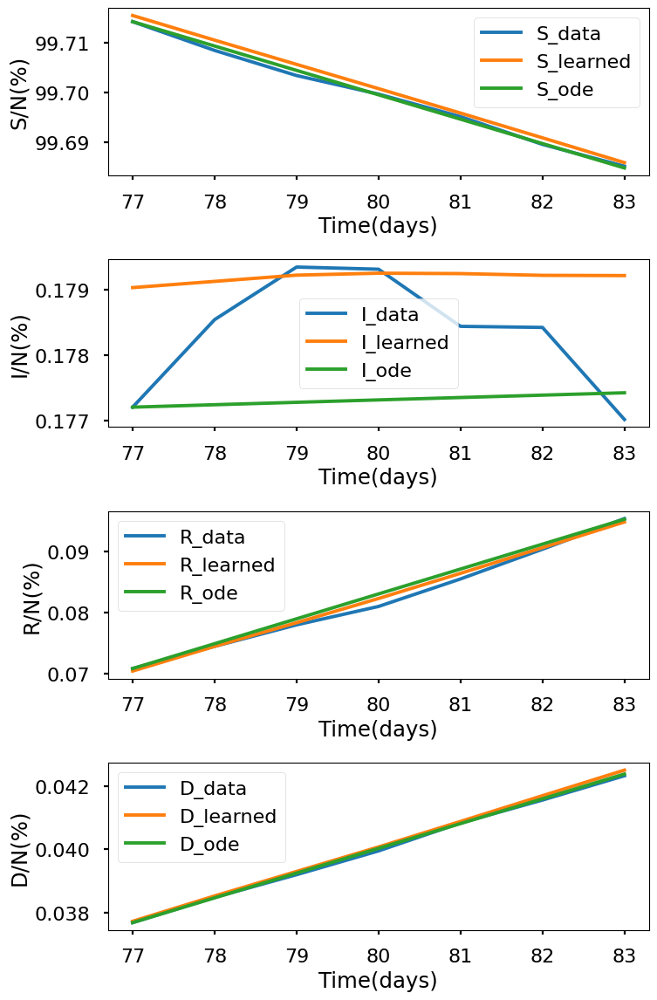

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.867e+00, GE_loss: 2.90494e+00,OB_loss: 1.96176e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.10, cumulative_time: 3.10
It: 10000, Loss: 2.203e-03, GE_loss: 4.61904e-04,OB_loss: 1.74105e-03, Beta: 1.28571e+00,gamma: 9.29109e-01,mu: 8.42293e-01, Time: 24.38, cumulative_time: 27.48
It: 20000, Loss: 2.808e-05, GE_loss: 1.07310e-05,OB_loss: 1.73533e-05, Beta: 1.97400e-02,gamma: 1.99398e-02,mu: 3.27607e-03, Time: 24.47, cumulative_time: 51.95
It: 30000, Loss: 2.780e-05, GE_loss: 5.71903e-06,OB_loss: 2.20842e-05, Beta: 1.99454e-02,gamma: 2.00560e-02,mu: 3.25708e-03, Time: 24.48, cumulative_time: 76.43
It: 40000, Loss: 2.472e-05, GE_loss: 5.54647e-06,OB_loss: 1.91749e-05, Beta: 1.89009e-02,gamma: 1.97255e-02,mu: 3.14729e-03, Time: 25.45, cumulative_time: 101.88
beta:  [0.01991562]
gamma:  [0.02008558]
mu:  [0.00320612]


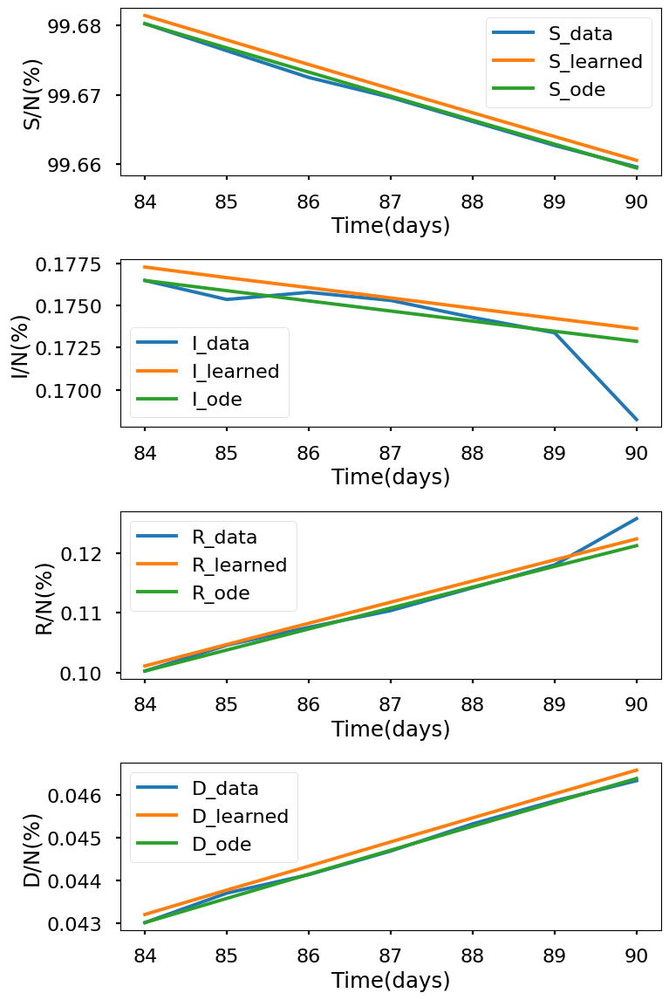

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 5.016e+00, GE_loss: 2.97705e+00,OB_loss: 2.03932e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.21, cumulative_time: 3.21
It: 10000, Loss: 8.805e-04, GE_loss: 8.50218e-05,OB_loss: 7.95450e-04, Beta: 1.87442e+00,gamma: 9.40979e-01,mu: 9.26167e-01, Time: 45.53, cumulative_time: 48.74
It: 20000, Loss: 6.479e-05, GE_loss: 3.21497e-05,OB_loss: 3.26414e-05, Beta: 1.21231e-02,gamma: 3.92147e-02,mu: 2.16566e-03, Time: 45.41, cumulative_time: 94.15
It: 30000, Loss: 5.891e-05, GE_loss: 9.39795e-06,OB_loss: 4.95075e-05, Beta: 1.18800e-02,gamma: 3.75391e-02,mu: 2.17749e-03, Time: 45.56, cumulative_time: 139.71
It: 40000, Loss: 5.752e-05, GE_loss: 2.14527e-05,OB_loss: 3.60640e-05, Beta: 1.14902e-02,gamma: 3.74238e-02,mu: 1.94603e-03, Time: 45.71, cumulative_time: 185.42
beta:  [0.01142615]
gamma:  [0.03673722]
mu:  [0.00242333]


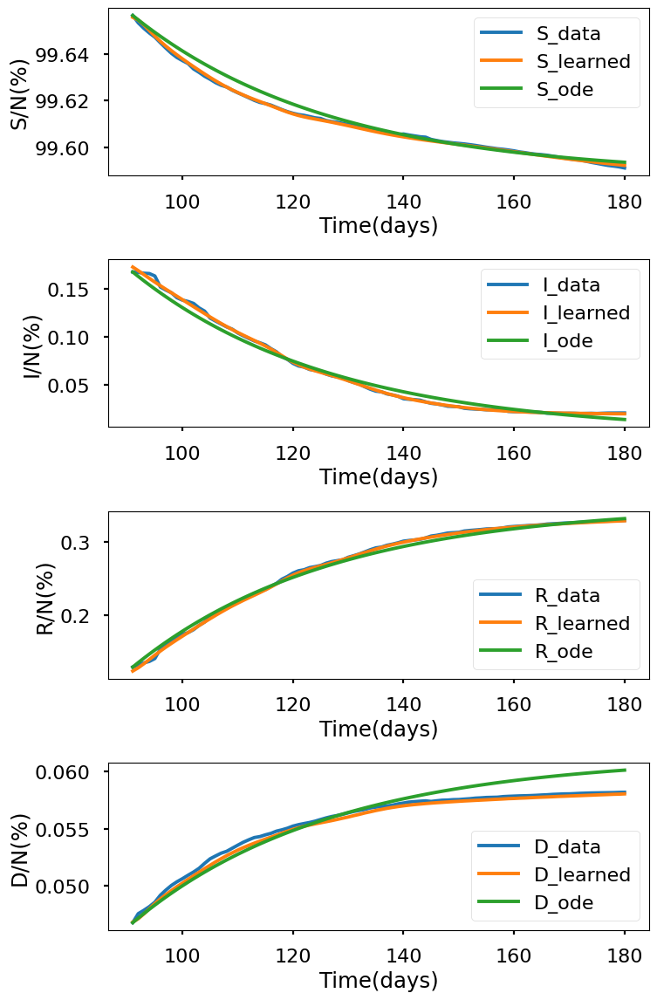

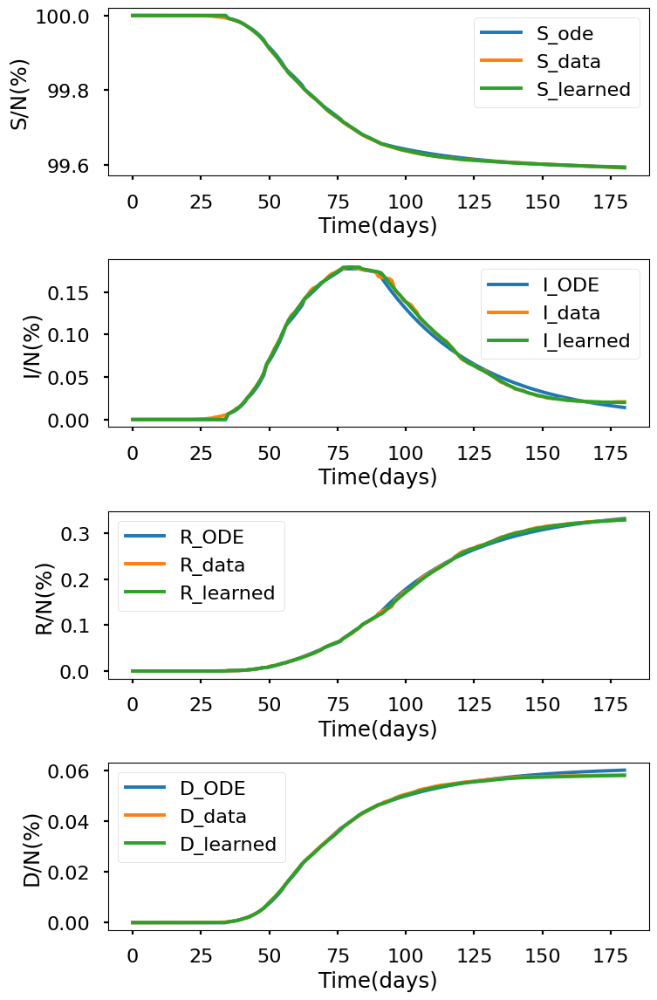

+---------------------+---------------------+-------------+-------------+-------------+-------------+-------------+--------------+-------------+-------------+-------------+
|      Paramaters     | Initial three weeks |   4th week  |   5th week  |   6th week  |   7th week  |   8th week  |   9th week   |  10th week  |  11th week  |  remainder  |
+---------------------+---------------------+-------------+-------------+-------------+-------------+-------------+--------------+-------------+-------------+-------------+
|         beta        |      1.1222334      |  0.22416338 |  0.16293198 |  0.10819821 | 0.059058614 | 0.043192793 |  0.0320578   | 0.027727963 | 0.019915616 | 0.011426149 |
|        gamma        |      0.87611246     | 0.014291693 | 0.022497492 |  0.01893136 | 0.015243687 | 0.016110893 | 0.0140018435 | 0.023020783 | 0.020085575 |  0.03673722 |
|          mu         |      0.8696904      | 0.019260734 | 0.016346911 | 0.013743818 | 0.010556177 |  0.00663481 | 0.0057757413 | 0.00

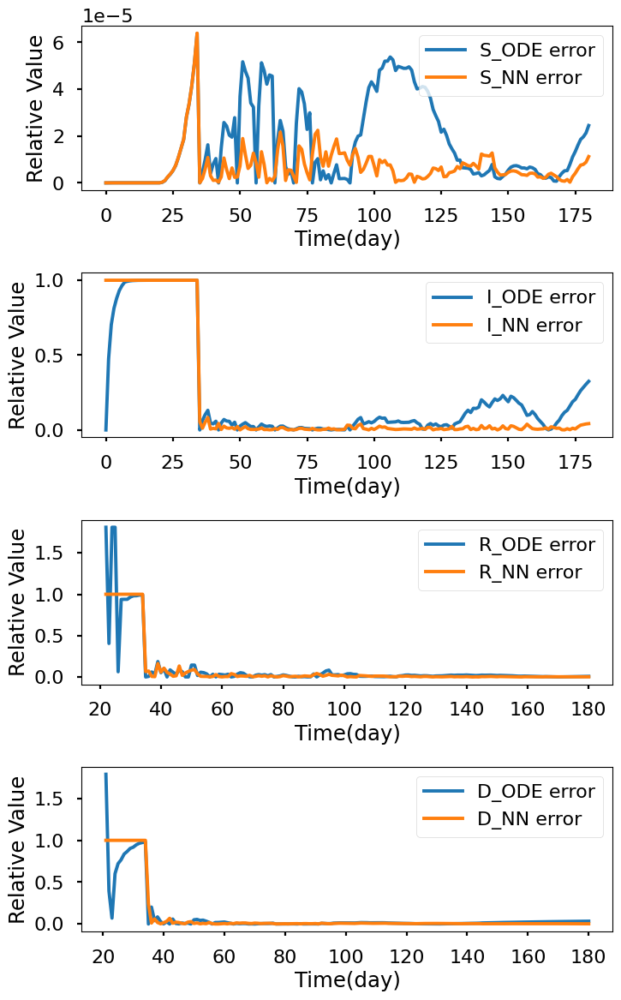

In [14]:
layers432 = [1,32,32,32,32,4]
S432_ode,I432_ode,R432_ode,D432_ode,S432_learned,I432_learned,R432_learned,D432_learned,beta432,gamma432,mu432,S_errnn432,I_errnn432,R_errnn432,D_errnn432,S_erode432,I_errode432,R_errode432,D_errode432,time432 = sum_all(
    layers432,length,SS,II,RC,DC,N0,0.1,50000)

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.904e+00, GE_loss: 2.95933e+00,OB_loss: 1.94455e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.25, cumulative_time: 3.25
It: 10000, Loss: 1.494e-05, GE_loss: 1.98084e-06,OB_loss: 1.29629e-05, Beta: 1.05511e+00,gamma: 9.45420e-01,mu: 9.45420e-01, Time: 34.97, cumulative_time: 38.22
It: 20000, Loss: 7.546e-06, GE_loss: 2.54987e-08,OB_loss: 7.52039e-06, Beta: 1.05511e+00,gamma: 9.37940e-01,mu: 9.37940e-01, Time: 35.07, cumulative_time: 73.29
It: 30000, Loss: 7.511e-06, GE_loss: 0.00000e+00,OB_loss: 7.51140e-06, Beta: 1.05511e+00,gamma: 9.37940e-01,mu: 9.37940e-01, Time: 34.40, cumulative_time: 107.69
It: 40000, Loss: 7.511e-06, GE_loss: 0.00000e+00,OB_loss: 7.51140e-06, Beta: 1.05511e+00,gamma: 9.37940e-01,mu: 9.37940e-01, Time: 34.24, cumulative_time: 141.93
beta:  [1.055107]
gamma:  [0.9379399]
mu:  [0.9379399]


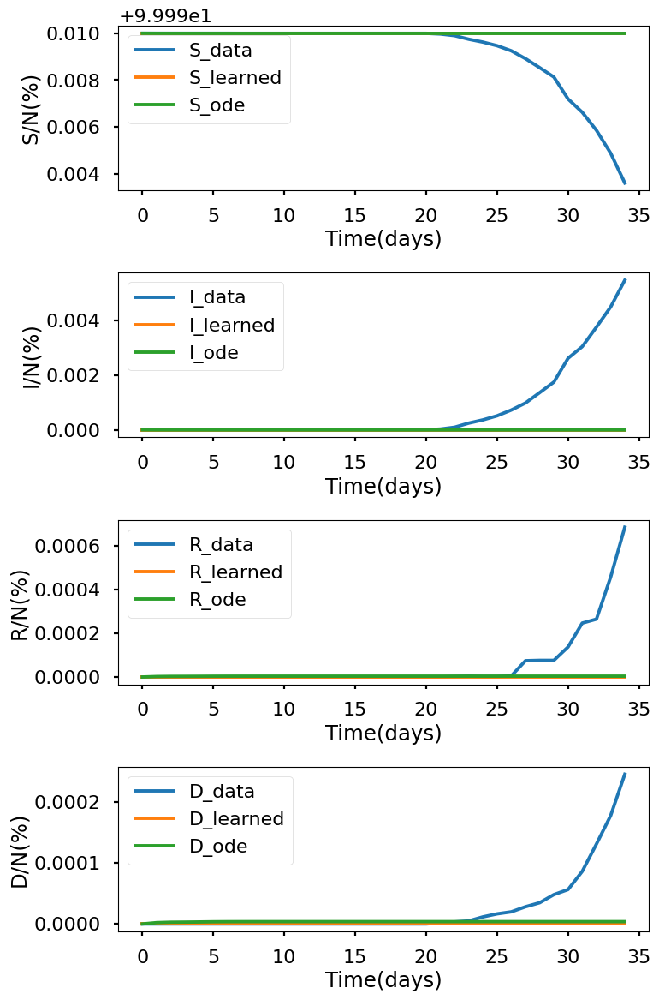

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.969e+00, GE_loss: 2.97233e+00,OB_loss: 1.99630e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.37, cumulative_time: 3.37
It: 10000, Loss: 1.900e-04, GE_loss: 5.43942e-06,OB_loss: 1.84564e-04, Beta: 1.08416e+00,gamma: 9.20345e-01,mu: 9.20184e-01, Time: 27.17, cumulative_time: 30.54
It: 20000, Loss: 6.499e-05, GE_loss: 3.26769e-05,OB_loss: 3.23120e-05, Beta: 5.14324e-01,gamma: 2.35739e-02,mu: 3.20423e-02, Time: 26.25, cumulative_time: 56.79
It: 30000, Loss: 7.645e-06, GE_loss: 2.30602e-06,OB_loss: 5.33904e-06, Beta: 2.24752e-01,gamma: 1.48866e-02,mu: 1.92378e-02, Time: 26.26, cumulative_time: 83.05
It: 40000, Loss: 6.876e-06, GE_loss: 2.08396e-06,OB_loss: 4.79162e-06, Beta: 2.24600e-01,gamma: 1.47383e-02,mu: 1.93561e-02, Time: 26.31, cumulative_time: 109.36
beta:  [0.22477438]
gamma:  [0.0145408]
mu:  [0.01982129]


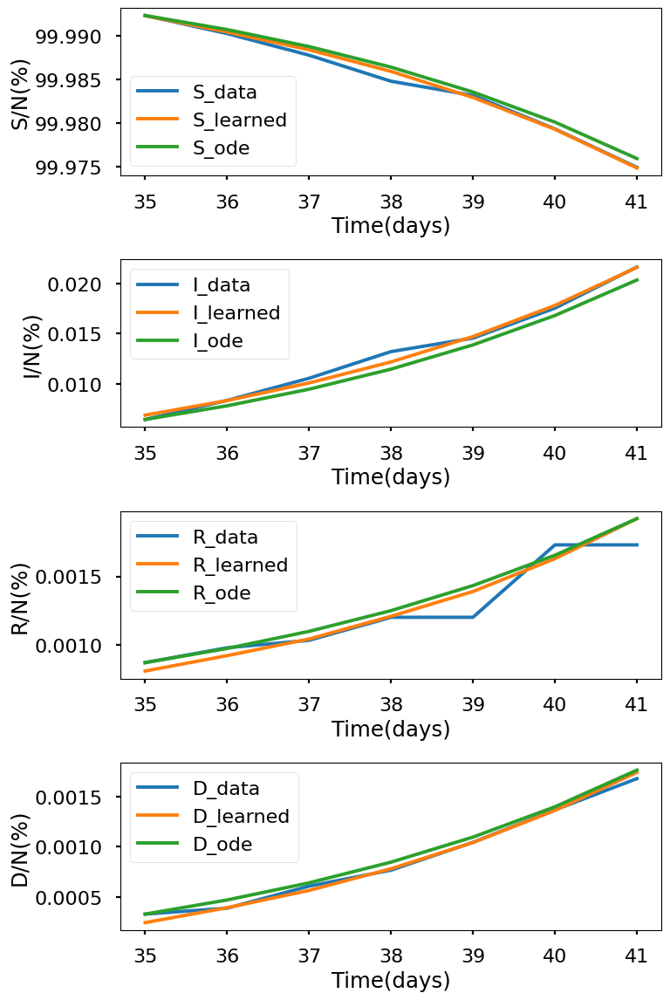

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.954e+00, GE_loss: 2.96415e+00,OB_loss: 1.99008e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.52, cumulative_time: 3.52
It: 10000, Loss: 4.737e-04, GE_loss: 5.82121e-05,OB_loss: 4.15495e-04, Beta: 1.08960e+00,gamma: 9.23629e-01,mu: 9.26431e-01, Time: 27.61, cumulative_time: 31.14
It: 20000, Loss: 8.692e-06, GE_loss: 1.90031e-06,OB_loss: 6.79146e-06, Beta: 1.52534e-01,gamma: 2.04355e-02,mu: 1.59739e-02, Time: 27.45, cumulative_time: 58.58
It: 30000, Loss: 1.124e-05, GE_loss: 4.58252e-06,OB_loss: 6.65293e-06, Beta: 1.53623e-01,gamma: 2.11006e-02,mu: 1.58623e-02, Time: 27.17, cumulative_time: 85.75
It: 40000, Loss: 9.114e-06, GE_loss: 2.75426e-06,OB_loss: 6.36000e-06, Beta: 1.53189e-01,gamma: 2.10299e-02,mu: 1.60646e-02, Time: 27.11, cumulative_time: 112.86
beta:  [0.15322274]
gamma:  [0.02109385]
mu:  [0.01573573]


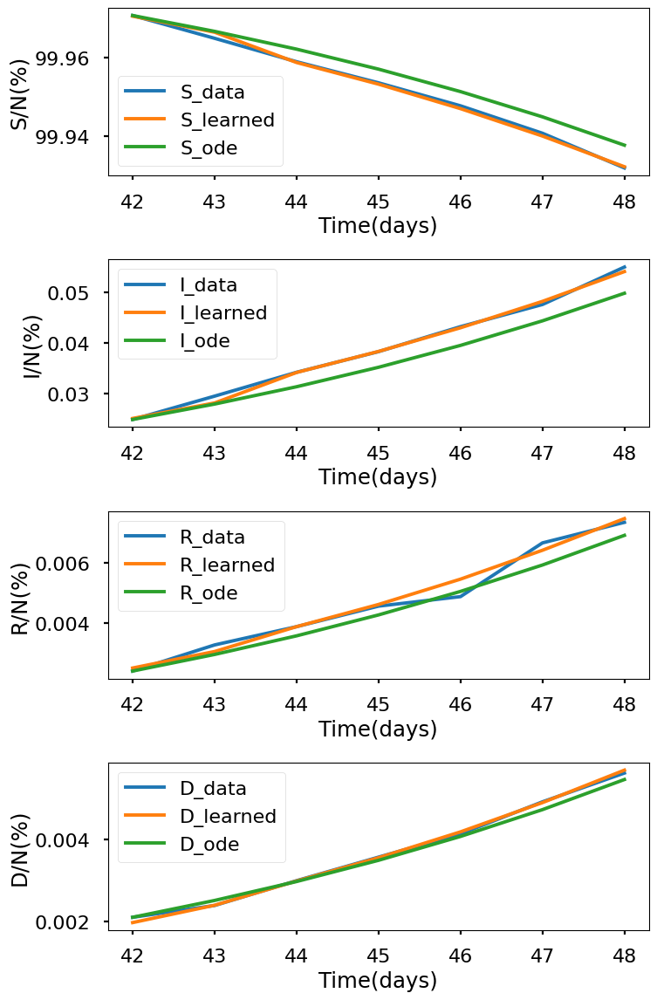

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.946e+00, GE_loss: 2.95916e+00,OB_loss: 1.98653e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.59, cumulative_time: 3.59
It: 10000, Loss: 9.968e-04, GE_loss: 1.63132e-04,OB_loss: 8.33635e-04, Beta: 1.25749e+00,gamma: 9.03455e-01,mu: 8.91107e-01, Time: 27.24, cumulative_time: 30.84
It: 20000, Loss: 3.256e-05, GE_loss: 7.25631e-06,OB_loss: 2.53073e-05, Beta: 1.13907e-01,gamma: 2.06131e-02,mu: 1.47297e-02, Time: 26.62, cumulative_time: 57.46
It: 30000, Loss: 2.587e-05, GE_loss: 8.85935e-06,OB_loss: 1.70082e-05, Beta: 1.11249e-01,gamma: 1.95379e-02,mu: 1.41643e-02, Time: 27.83, cumulative_time: 85.28
It: 40000, Loss: 2.072e-05, GE_loss: 6.98619e-06,OB_loss: 1.37289e-05, Beta: 1.08925e-01,gamma: 1.88370e-02,mu: 1.36532e-02, Time: 26.78, cumulative_time: 112.06
beta:  [0.1122041]
gamma:  [0.02024354]
mu:  [0.01443181]


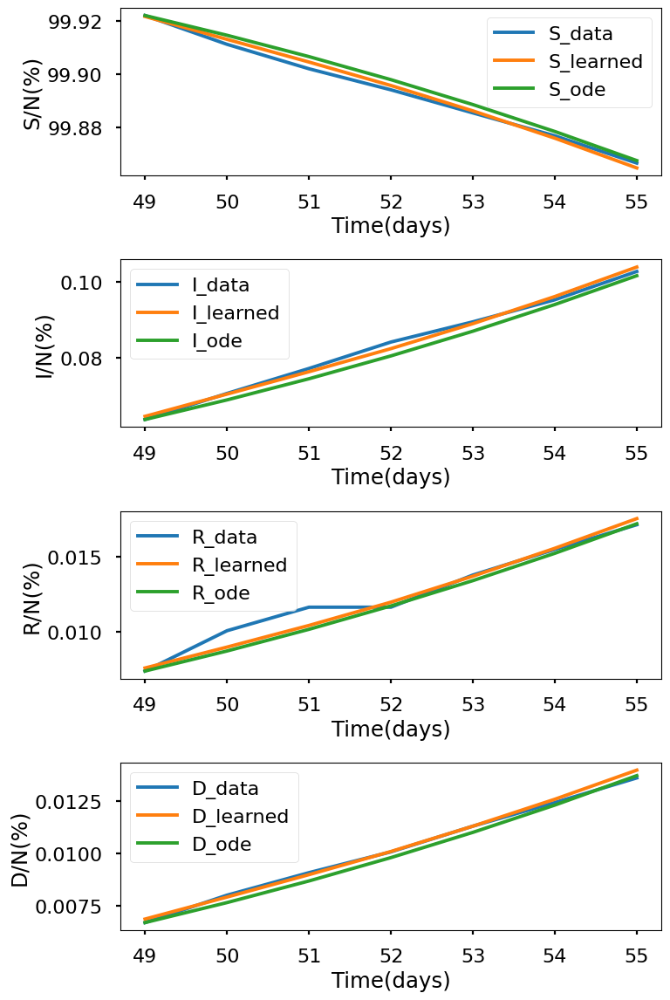

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.937e+00, GE_loss: 2.96219e+00,OB_loss: 1.97439e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.50, cumulative_time: 3.50
It: 10000, Loss: 1.456e-03, GE_loss: 2.20191e-04,OB_loss: 1.23553e-03, Beta: 1.56910e+00,gamma: 8.90678e-01,mu: 8.64972e-01, Time: 27.37, cumulative_time: 30.86
It: 20000, Loss: 2.934e-05, GE_loss: 1.14577e-05,OB_loss: 1.78846e-05, Beta: 6.40875e-02,gamma: 1.58294e-02,mu: 1.06213e-02, Time: 26.70, cumulative_time: 57.57
It: 30000, Loss: 2.959e-05, GE_loss: 1.44810e-05,OB_loss: 1.51042e-05, Beta: 6.52521e-02,gamma: 1.64835e-02,mu: 1.05831e-02, Time: 27.84, cumulative_time: 85.41
It: 40000, Loss: 1.939e-05, GE_loss: 3.70754e-06,OB_loss: 1.56776e-05, Beta: 6.56674e-02,gamma: 1.66014e-02,mu: 1.08624e-02, Time: 26.59, cumulative_time: 112.00
beta:  [0.06546818]
gamma:  [0.01647959]
mu:  [0.01093728]


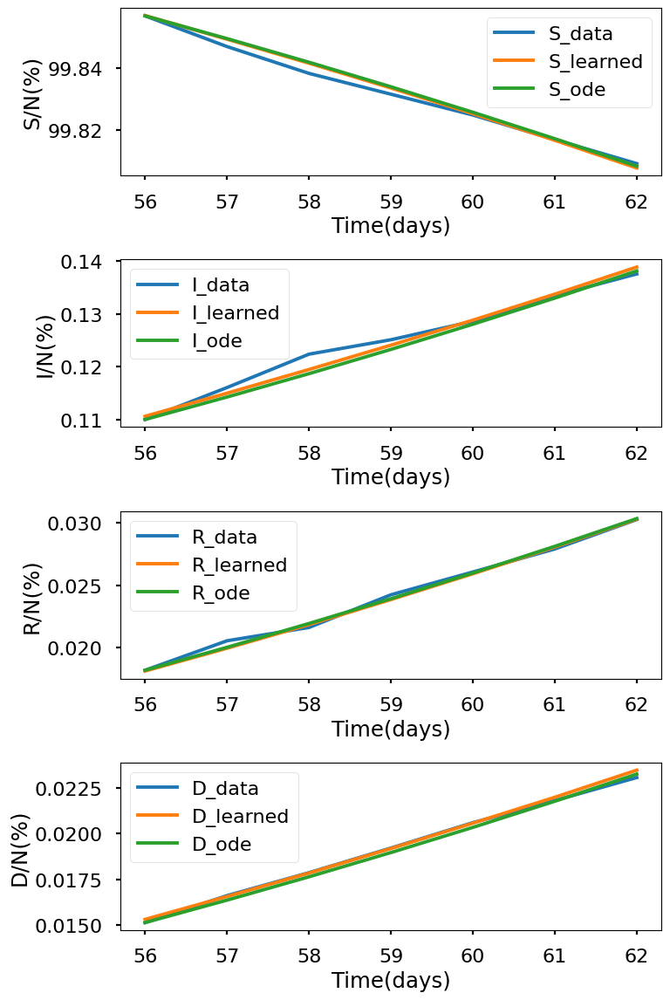

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.924e+00, GE_loss: 2.96954e+00,OB_loss: 1.95495e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.55, cumulative_time: 3.55
It: 10000, Loss: 1.848e-03, GE_loss: 3.18509e-04,OB_loss: 1.52933e-03, Beta: 1.42536e+00,gamma: 8.93939e-01,mu: 8.56113e-01, Time: 27.53, cumulative_time: 31.08
It: 20000, Loss: 2.896e-05, GE_loss: 4.54674e-06,OB_loss: 2.44125e-05, Beta: 4.13793e-02,gamma: 1.56138e-02,mu: 6.03501e-03, Time: 27.32, cumulative_time: 58.40
It: 30000, Loss: 4.562e-05, GE_loss: 1.99943e-05,OB_loss: 2.56301e-05, Beta: 4.39697e-02,gamma: 1.68780e-02,mu: 6.84814e-03, Time: 27.35, cumulative_time: 85.74
It: 40000, Loss: 3.005e-05, GE_loss: 5.58554e-06,OB_loss: 2.44636e-05, Beta: 4.30004e-02,gamma: 1.64761e-02,mu: 6.57009e-03, Time: 27.02, cumulative_time: 112.77
beta:  [0.04361431]
gamma:  [0.01623844]
mu:  [0.00657582]


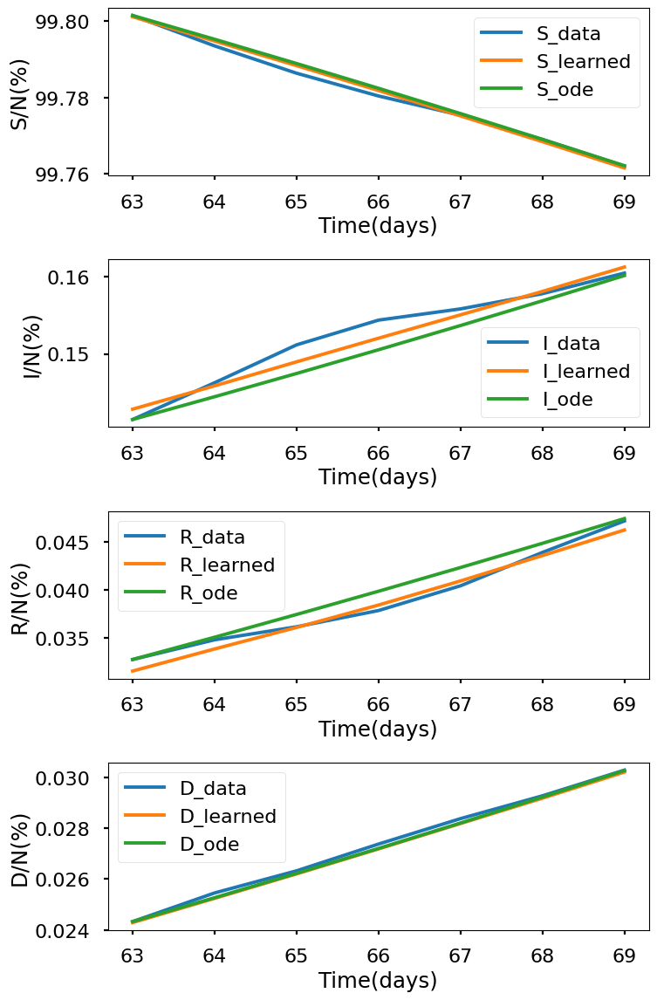

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.854e+00, GE_loss: 2.91693e+00,OB_loss: 1.93754e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.64, cumulative_time: 3.64
It: 10000, Loss: 2.034e-03, GE_loss: 3.42888e-04,OB_loss: 1.69139e-03, Beta: 1.43032e+00,gamma: 9.01786e-01,mu: 8.46996e-01, Time: 29.61, cumulative_time: 33.25
It: 20000, Loss: 2.470e-05, GE_loss: 1.16859e-05,OB_loss: 1.30190e-05, Beta: 3.44072e-02,gamma: 1.51806e-02,mu: 5.53521e-03, Time: 28.04, cumulative_time: 61.29
It: 30000, Loss: 3.648e-05, GE_loss: 1.19243e-05,OB_loss: 2.45597e-05, Beta: 3.44362e-02,gamma: 1.50210e-02,mu: 5.81445e-03, Time: 26.67, cumulative_time: 87.95
It: 40000, Loss: 2.356e-05, GE_loss: 1.02202e-05,OB_loss: 1.33373e-05, Beta: 3.43610e-02,gamma: 1.50904e-02,mu: 5.59193e-03, Time: 26.97, cumulative_time: 114.92
beta:  [0.03475488]
gamma:  [0.01525885]
mu:  [0.00557625]


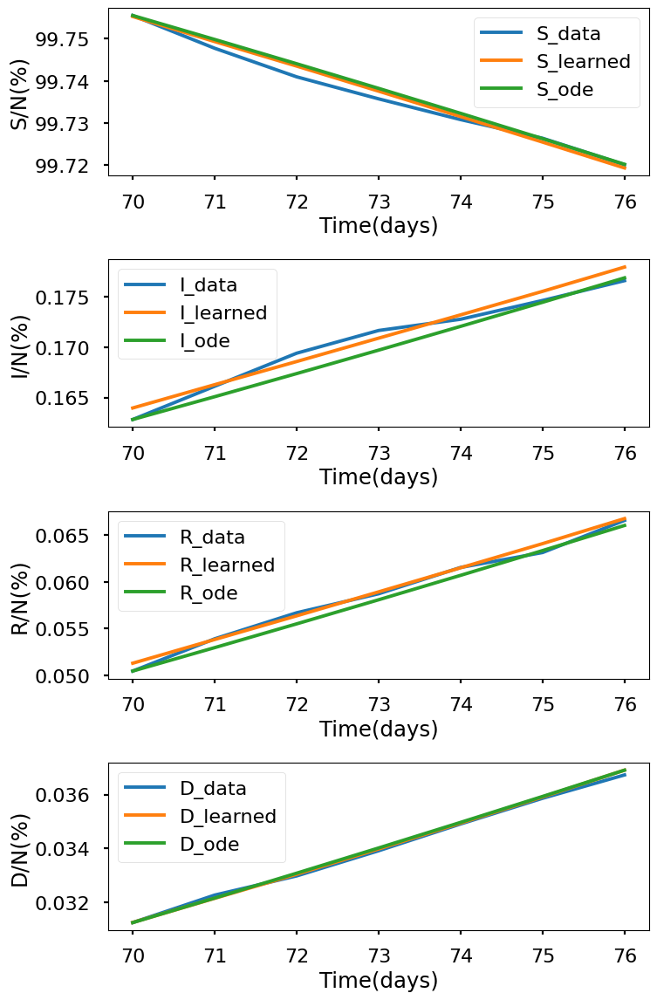

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.894e+00, GE_loss: 2.95471e+00,OB_loss: 1.93953e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.70, cumulative_time: 3.70
It: 10000, Loss: 2.147e-03, GE_loss: 3.85142e-04,OB_loss: 1.76158e-03, Beta: 1.42096e+00,gamma: 9.18305e-01,mu: 8.12124e-01, Time: 27.16, cumulative_time: 30.87
It: 20000, Loss: 3.224e-05, GE_loss: 5.71792e-06,OB_loss: 2.65195e-05, Beta: 2.74502e-02,gamma: 2.23063e-02,mu: 4.19360e-03, Time: 27.11, cumulative_time: 57.97
It: 30000, Loss: 2.825e-05, GE_loss: 7.07788e-06,OB_loss: 2.11755e-05, Beta: 2.63110e-02,gamma: 2.20219e-02,mu: 4.43482e-03, Time: 26.89, cumulative_time: 84.86
It: 40000, Loss: 2.762e-05, GE_loss: 1.03129e-05,OB_loss: 1.73098e-05, Beta: 2.72625e-02,gamma: 2.27358e-02,mu: 4.21048e-03, Time: 26.87, cumulative_time: 111.73
beta:  [0.02735833]
gamma:  [0.02274908]
mu:  [0.00444209]


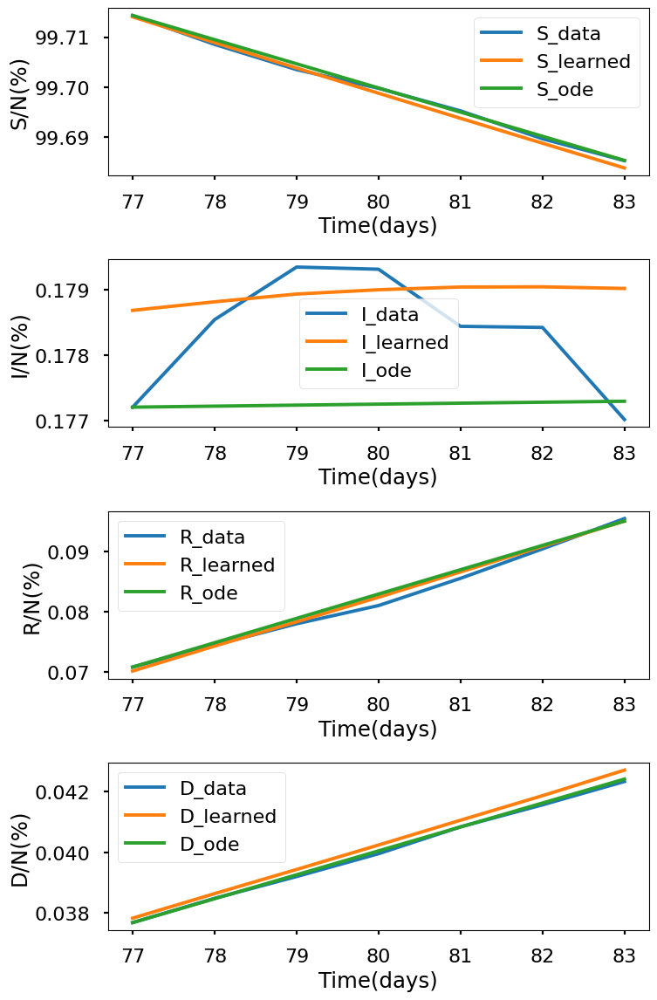

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.965e+00, GE_loss: 2.98192e+00,OB_loss: 1.98276e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.69, cumulative_time: 3.69
It: 10000, Loss: 2.206e-03, GE_loss: 4.17853e-04,OB_loss: 1.78818e-03, Beta: 1.28853e+00,gamma: 9.30167e-01,mu: 8.40177e-01, Time: 26.89, cumulative_time: 30.58
It: 20000, Loss: 3.846e-05, GE_loss: 1.80832e-05,OB_loss: 2.03779e-05, Beta: 1.87891e-02,gamma: 2.03317e-02,mu: 3.12491e-03, Time: 26.60, cumulative_time: 57.18
It: 30000, Loss: 3.531e-05, GE_loss: 1.64262e-05,OB_loss: 1.88832e-05, Beta: 1.88760e-02,gamma: 2.18507e-02,mu: 3.36459e-03, Time: 27.03, cumulative_time: 84.21
It: 40000, Loss: 2.068e-05, GE_loss: 7.15981e-06,OB_loss: 1.35194e-05, Beta: 1.92287e-02,gamma: 2.18418e-02,mu: 3.06835e-03, Time: 26.54, cumulative_time: 110.75
beta:  [0.01907359]
gamma:  [0.02171434]
mu:  [0.00323112]


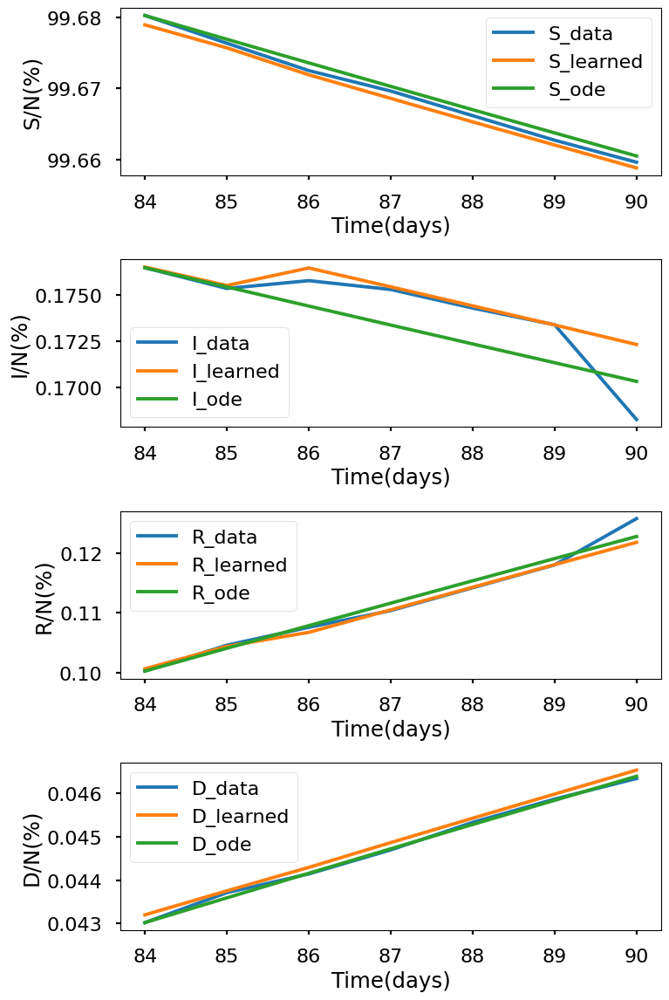

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.943e+00, GE_loss: 2.96929e+00,OB_loss: 1.97404e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.72, cumulative_time: 3.72
It: 10000, Loss: 8.784e-04, GE_loss: 1.05283e-04,OB_loss: 7.73128e-04, Beta: 1.86883e+00,gamma: 9.38567e-01,mu: 9.22020e-01, Time: 53.55, cumulative_time: 57.27
It: 20000, Loss: 7.647e-05, GE_loss: 2.21864e-05,OB_loss: 5.42862e-05, Beta: 1.16883e-02,gamma: 3.76995e-02,mu: 2.39384e-03, Time: 58.45, cumulative_time: 115.72
It: 30000, Loss: 5.763e-05, GE_loss: 2.62685e-05,OB_loss: 3.13565e-05, Beta: 1.13131e-02,gamma: 3.71327e-02,mu: 2.01968e-03, Time: 53.27, cumulative_time: 168.98
It: 40000, Loss: 3.870e-05, GE_loss: 1.10857e-05,OB_loss: 2.76120e-05, Beta: 1.11366e-02,gamma: 3.64321e-02,mu: 2.08799e-03, Time: 53.66, cumulative_time: 222.64
beta:  [0.01164192]
gamma:  [0.03760599]
mu:  [0.00218022]


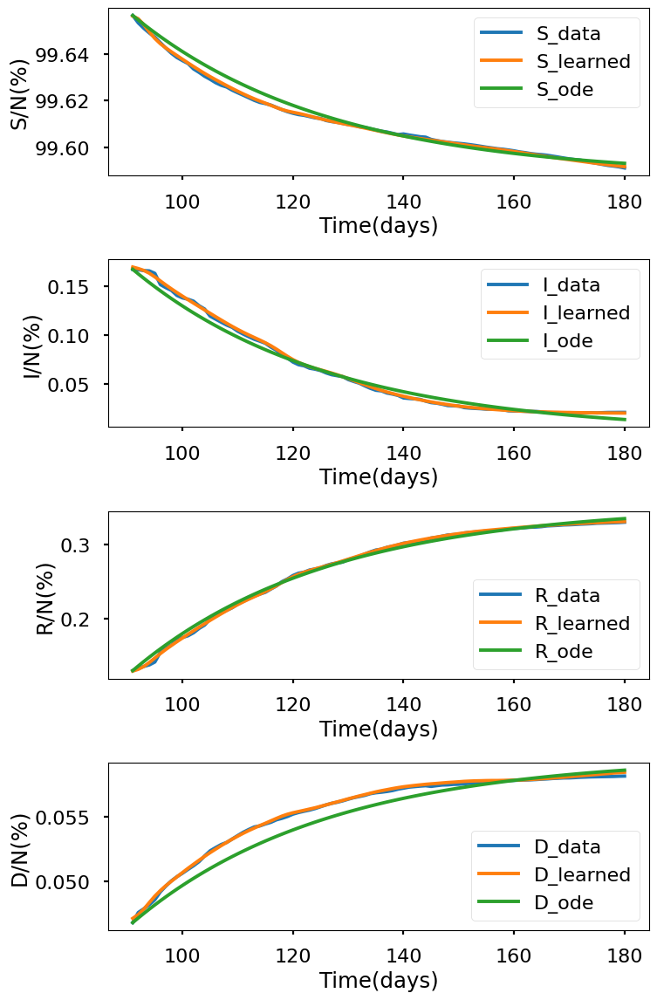

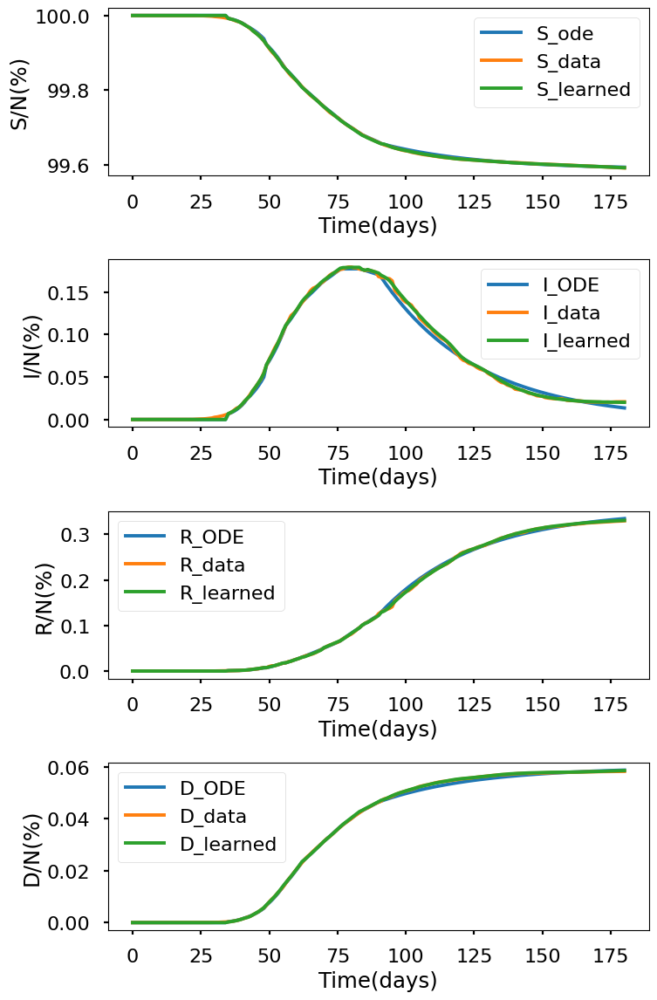

+---------------------+---------------------+-------------+-------------+-------------+-------------+--------------+--------------+-------------+-------------+-------------+
|      Paramaters     | Initial three weeks |   4th week  |   5th week  |   6th week  |   7th week  |   8th week   |   9th week   |  10th week  |  11th week  |  remainder  |
+---------------------+---------------------+-------------+-------------+-------------+-------------+--------------+--------------+-------------+-------------+-------------+
|         beta        |       1.055107      |  0.22477438 |  0.15322274 | 0.112204105 |  0.06546818 | 0.043614313  | 0.034754876  | 0.027358327 | 0.019073592 | 0.011641918 |
|        gamma        |      0.9379399      | 0.014540803 | 0.021093855 | 0.020243537 | 0.016479593 | 0.016238442  | 0.015258849  | 0.022749083 |  0.02171434 | 0.037605986 |
|          mu         |      0.9379399      |  0.01982129 | 0.015735734 | 0.014431814 | 0.010937285 | 0.0065758154 | 0.0055762487 

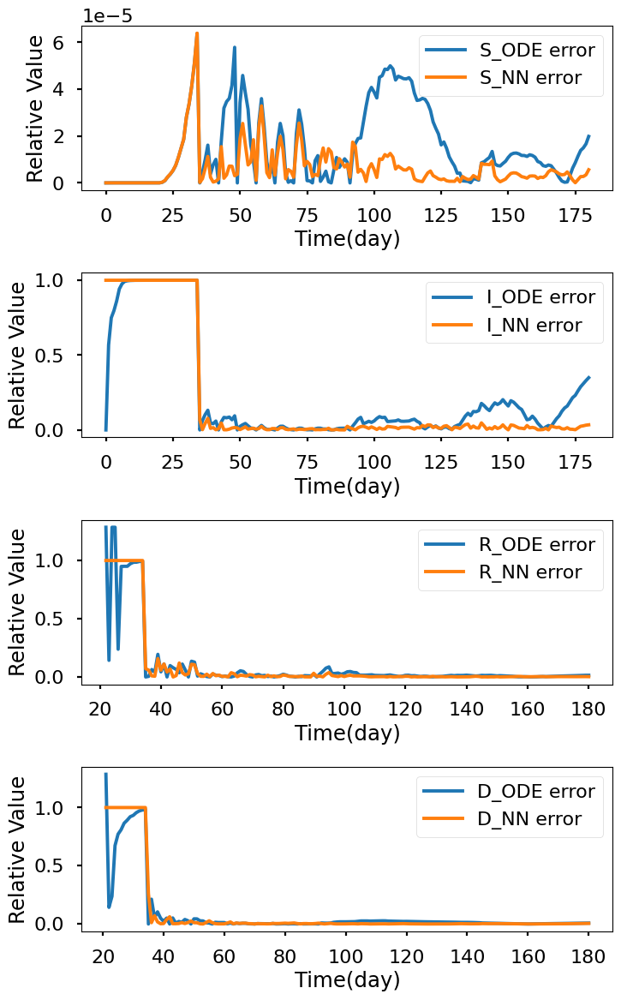

In [15]:
layers532 = [1,32,32,32,32,32,4]
S532_ode,I532_ode,R532_ode,D532_ode,S532_learned,I532_learned,R532_learned,D532_learned,beta532,gamma532,mu532,S_errnn532,I_errnn532,R_errnn532,D_errnn532,S_erode532,I_errode532,R_errode532,D_errode532,time532 = sum_all(
    layers532,length,SS,II,RC,DC,N0,0.1,50000)

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.995e+00, GE_loss: 2.97578e+00,OB_loss: 2.01920e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.61, cumulative_time: 3.61
It: 10000, Loss: 8.932e-06, GE_loss: 6.11955e-07,OB_loss: 8.32017e-06, Beta: 1.12231e+00,gamma: 9.38489e-01,mu: 9.39102e-01, Time: 28.46, cumulative_time: 32.07
It: 20000, Loss: 6.881e-06, GE_loss: 1.18401e-07,OB_loss: 6.76294e-06, Beta: 2.38134e+00,gamma: 9.24903e-01,mu: 8.40366e-01, Time: 28.03, cumulative_time: 60.10
It: 30000, Loss: 9.541e-07, GE_loss: 3.87831e-07,OB_loss: 5.66302e-07, Beta: 2.87770e-01,gamma: 3.19612e-02,mu: 1.15419e-02, Time: 27.94, cumulative_time: 88.04
It: 40000, Loss: 8.820e-07, GE_loss: 3.51820e-07,OB_loss: 5.30155e-07, Beta: 2.87768e-01,gamma: 3.20595e-02,mu: 1.13394e-02, Time: 28.43, cumulative_time: 116.47
beta:  [0.28723514]
gamma:  [0.03281456]
mu:  [0.0114184]


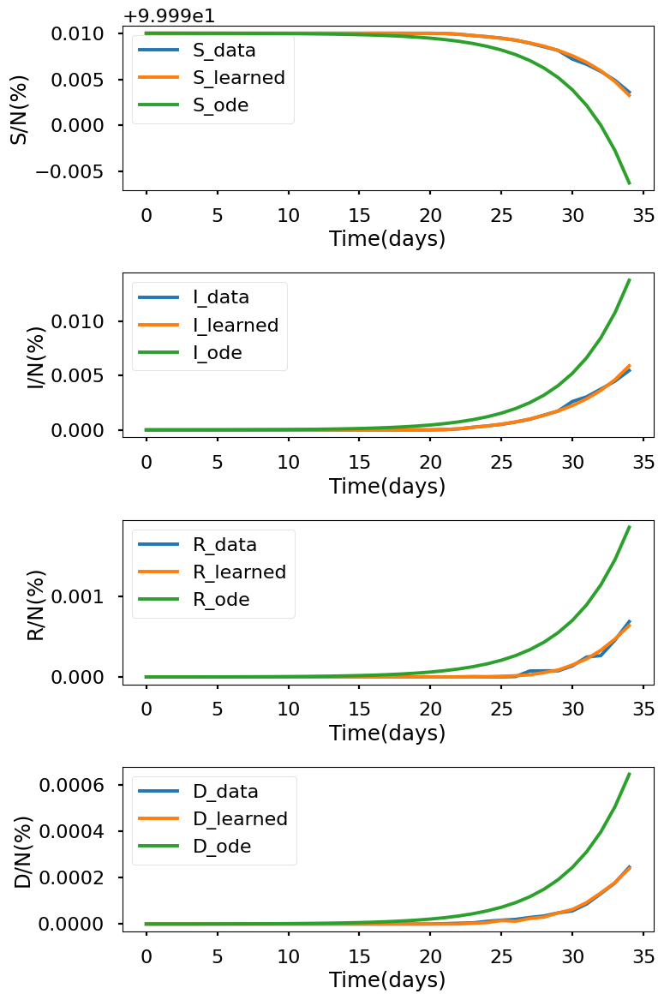

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.920e+00, GE_loss: 2.93058e+00,OB_loss: 1.98934e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.61, cumulative_time: 3.61
It: 10000, Loss: 1.641e-04, GE_loss: 2.59504e-05,OB_loss: 1.38159e-04, Beta: 1.14165e+00,gamma: 9.28381e-01,mu: 9.26794e-01, Time: 20.36, cumulative_time: 23.97
It: 20000, Loss: 8.504e-05, GE_loss: 1.68216e-05,OB_loss: 6.82143e-05, Beta: 7.28701e-01,gamma: 3.75232e-02,mu: 4.56480e-02, Time: 20.14, cumulative_time: 44.11
It: 30000, Loss: 6.255e-06, GE_loss: 1.09155e-06,OB_loss: 5.16387e-06, Beta: 2.27860e-01,gamma: 1.52165e-02,mu: 1.96964e-02, Time: 20.22, cumulative_time: 64.33
It: 40000, Loss: 7.448e-06, GE_loss: 2.58239e-06,OB_loss: 4.86536e-06, Beta: 2.26949e-01,gamma: 1.49831e-02,mu: 1.96822e-02, Time: 20.25, cumulative_time: 84.58
beta:  [0.22523382]
gamma:  [0.01459628]
mu:  [0.01911585]


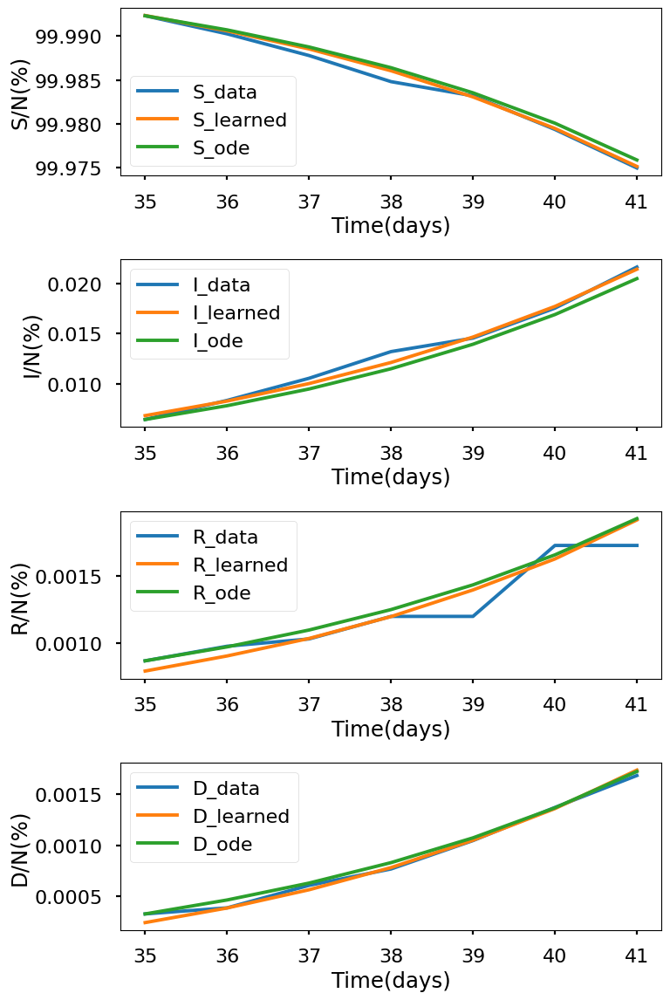

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 5.019e+00, GE_loss: 2.99110e+00,OB_loss: 2.02831e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.72, cumulative_time: 3.72
It: 10000, Loss: 4.845e-04, GE_loss: 7.77234e-05,OB_loss: 4.06769e-04, Beta: 1.12490e+00,gamma: 9.25602e-01,mu: 9.27013e-01, Time: 20.42, cumulative_time: 24.14
It: 20000, Loss: 1.862e-05, GE_loss: 6.41501e-06,OB_loss: 1.22054e-05, Beta: 1.65689e-01,gamma: 2.24531e-02,mu: 1.68756e-02, Time: 20.28, cumulative_time: 44.42
It: 30000, Loss: 1.379e-05, GE_loss: 4.86488e-06,OB_loss: 8.92362e-06, Beta: 1.66889e-01,gamma: 2.29804e-02,mu: 1.64990e-02, Time: 20.36, cumulative_time: 64.78
It: 40000, Loss: 1.940e-05, GE_loss: 6.72435e-06,OB_loss: 1.26765e-05, Beta: 1.66185e-01,gamma: 2.29261e-02,mu: 1.64067e-02, Time: 20.48, cumulative_time: 85.25
beta:  [0.16704491]
gamma:  [0.02328311]
mu:  [0.01641487]


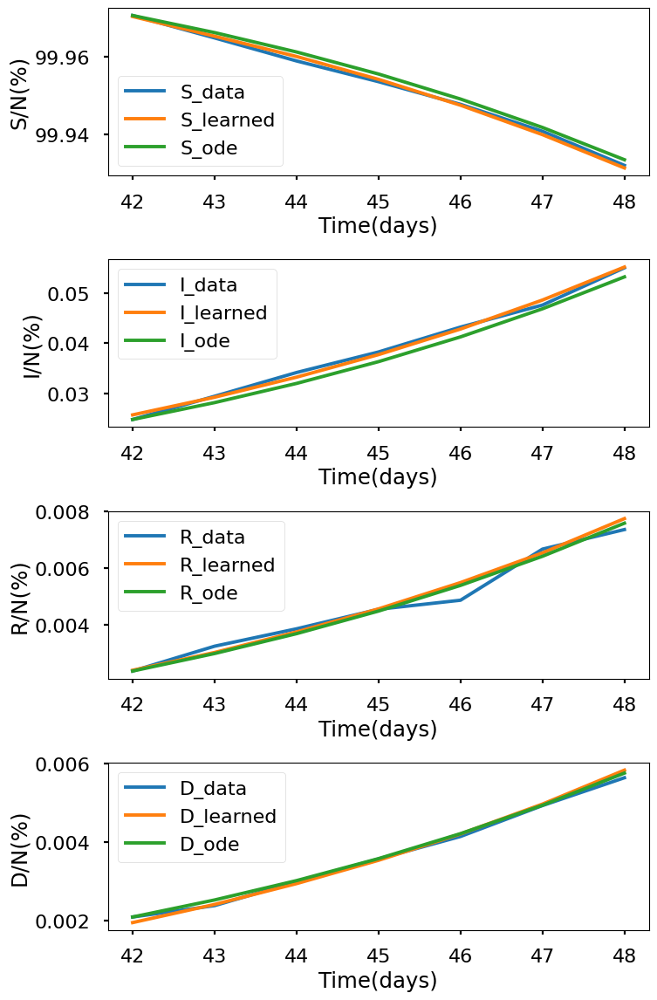

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.993e+00, GE_loss: 3.00752e+00,OB_loss: 1.98542e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.66, cumulative_time: 3.66
It: 10000, Loss: 1.024e-03, GE_loss: 1.80675e-04,OB_loss: 8.43697e-04, Beta: 1.07401e+00,gamma: 9.32616e-01,mu: 9.33642e-01, Time: 20.36, cumulative_time: 24.02
It: 20000, Loss: 4.110e-05, GE_loss: 1.92488e-05,OB_loss: 2.18528e-05, Beta: 1.11301e-01,gamma: 1.95165e-02,mu: 1.38656e-02, Time: 21.09, cumulative_time: 45.11
It: 30000, Loss: 2.894e-05, GE_loss: 8.68550e-06,OB_loss: 2.02560e-05, Beta: 1.12843e-01,gamma: 1.98325e-02,mu: 1.42697e-02, Time: 20.20, cumulative_time: 65.30
It: 40000, Loss: 4.566e-05, GE_loss: 2.11486e-05,OB_loss: 2.45109e-05, Beta: 1.13690e-01,gamma: 1.99403e-02,mu: 1.45794e-02, Time: 20.08, cumulative_time: 85.38
beta:  [0.11230969]
gamma:  [0.01964429]
mu:  [0.01403862]


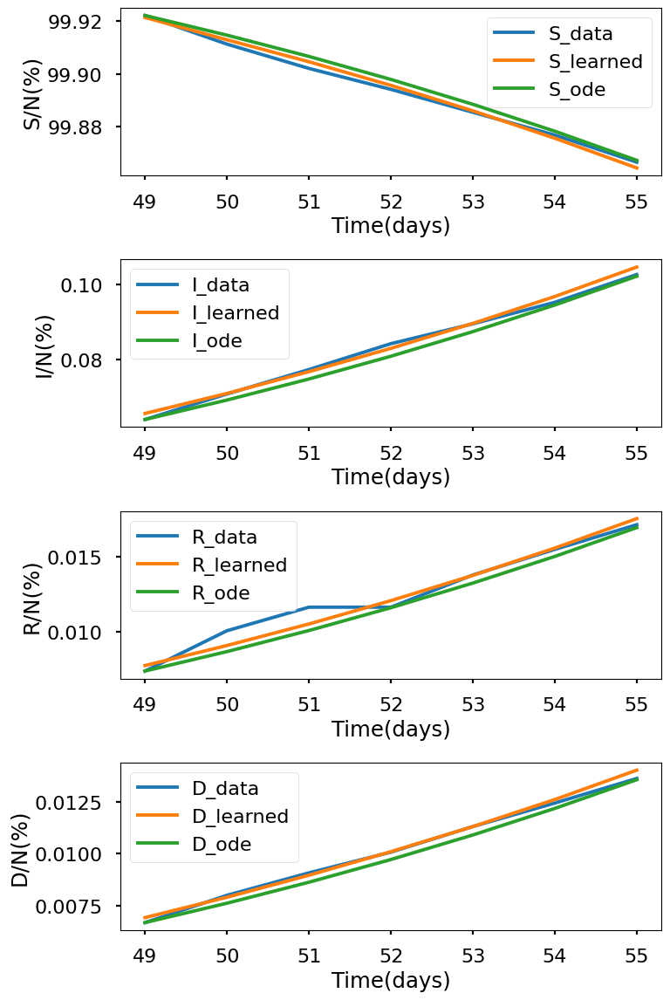

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.879e+00, GE_loss: 2.94431e+00,OB_loss: 1.93516e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.73, cumulative_time: 3.73
It: 10000, Loss: 1.579e-03, GE_loss: 2.82404e-04,OB_loss: 1.29646e-03, Beta: 1.10327e+00,gamma: 9.23537e-01,mu: 9.03618e-01, Time: 20.53, cumulative_time: 24.26
It: 20000, Loss: 4.439e-05, GE_loss: 1.69703e-05,OB_loss: 2.74243e-05, Beta: 6.50116e-02,gamma: 1.65074e-02,mu: 1.13155e-02, Time: 20.28, cumulative_time: 44.54
It: 30000, Loss: 9.135e-05, GE_loss: 3.75689e-05,OB_loss: 5.37791e-05, Beta: 6.35998e-02,gamma: 1.61001e-02,mu: 1.05524e-02, Time: 20.02, cumulative_time: 64.56
It: 40000, Loss: 4.948e-05, GE_loss: 2.84335e-05,OB_loss: 2.10458e-05, Beta: 6.36130e-02,gamma: 1.62467e-02,mu: 1.08508e-02, Time: 20.13, cumulative_time: 84.68
beta:  [0.06409526]
gamma:  [0.0161498]
mu:  [0.01112482]


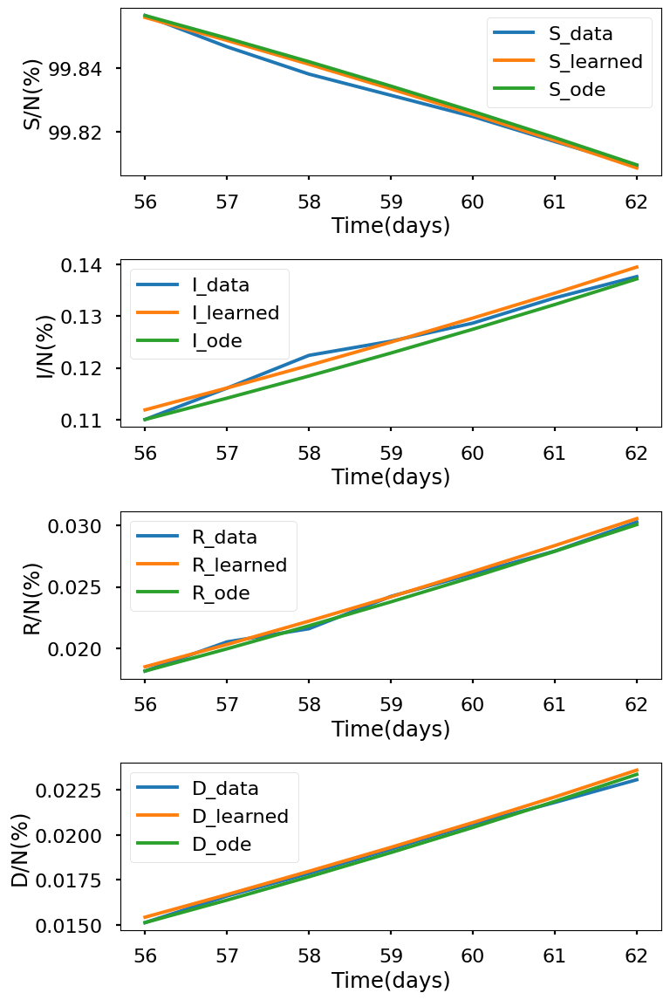

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.910e+00, GE_loss: 2.96182e+00,OB_loss: 1.94812e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.76, cumulative_time: 3.76
It: 10000, Loss: 1.945e-03, GE_loss: 3.69636e-04,OB_loss: 1.57506e-03, Beta: 1.05118e+00,gamma: 9.25438e-01,mu: 9.07356e-01, Time: 20.52, cumulative_time: 24.28
It: 20000, Loss: 6.981e-05, GE_loss: 2.11198e-05,OB_loss: 4.86906e-05, Beta: 4.45327e-02,gamma: 1.60968e-02,mu: 6.55707e-03, Time: 20.60, cumulative_time: 44.88
It: 30000, Loss: 6.653e-05, GE_loss: 1.91933e-05,OB_loss: 4.73338e-05, Beta: 4.30430e-02,gamma: 1.59629e-02,mu: 6.93456e-03, Time: 20.41, cumulative_time: 65.29
It: 40000, Loss: 8.946e-05, GE_loss: 3.85987e-05,OB_loss: 5.08653e-05, Beta: 4.31752e-02,gamma: 1.53922e-02,mu: 6.63264e-03, Time: 20.61, cumulative_time: 85.90
beta:  [0.04286655]
gamma:  [0.01567738]
mu:  [0.00658752]


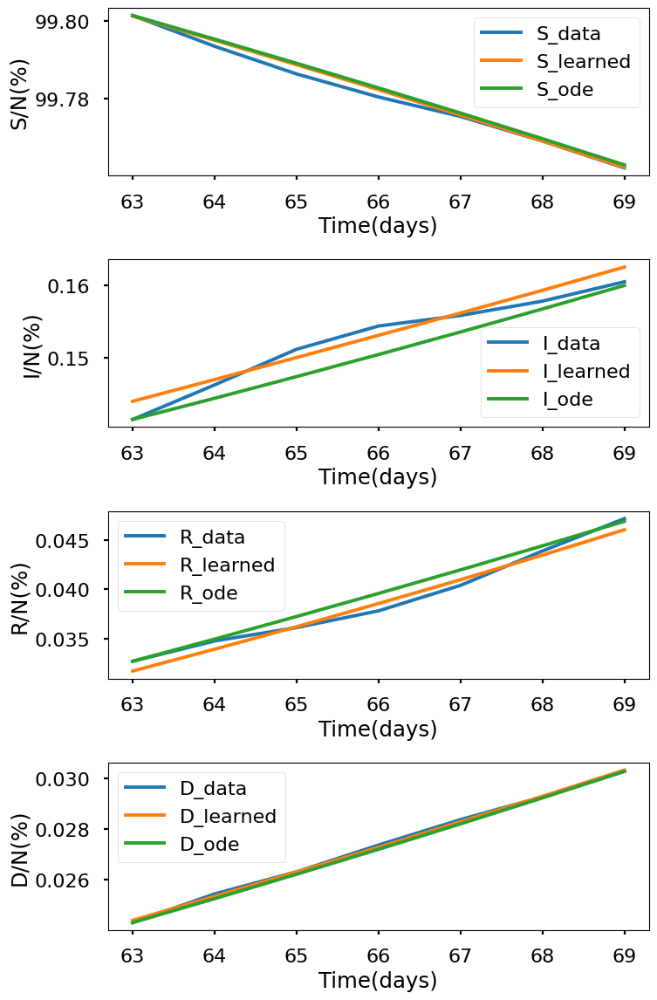

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.946e+00, GE_loss: 2.99657e+00,OB_loss: 1.94940e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.85, cumulative_time: 3.85
It: 10000, Loss: 2.201e-03, GE_loss: 4.38769e-04,OB_loss: 1.76231e-03, Beta: 1.09979e+00,gamma: 9.25916e-01,mu: 8.91268e-01, Time: 20.05, cumulative_time: 23.89
It: 20000, Loss: 8.532e-05, GE_loss: 1.05807e-05,OB_loss: 7.47437e-05, Beta: 3.42712e-02,gamma: 1.42916e-02,mu: 5.68679e-03, Time: 20.06, cumulative_time: 43.96
It: 30000, Loss: 3.940e-05, GE_loss: 1.45780e-05,OB_loss: 2.48197e-05, Beta: 3.50446e-02,gamma: 1.49845e-02,mu: 5.74160e-03, Time: 19.92, cumulative_time: 63.87
It: 40000, Loss: 8.199e-05, GE_loss: 3.75236e-05,OB_loss: 4.44626e-05, Beta: 3.54520e-02,gamma: 1.51461e-02,mu: 5.51501e-03, Time: 20.09, cumulative_time: 83.96
beta:  [0.03332005]
gamma:  [0.01447227]
mu:  [0.00544094]


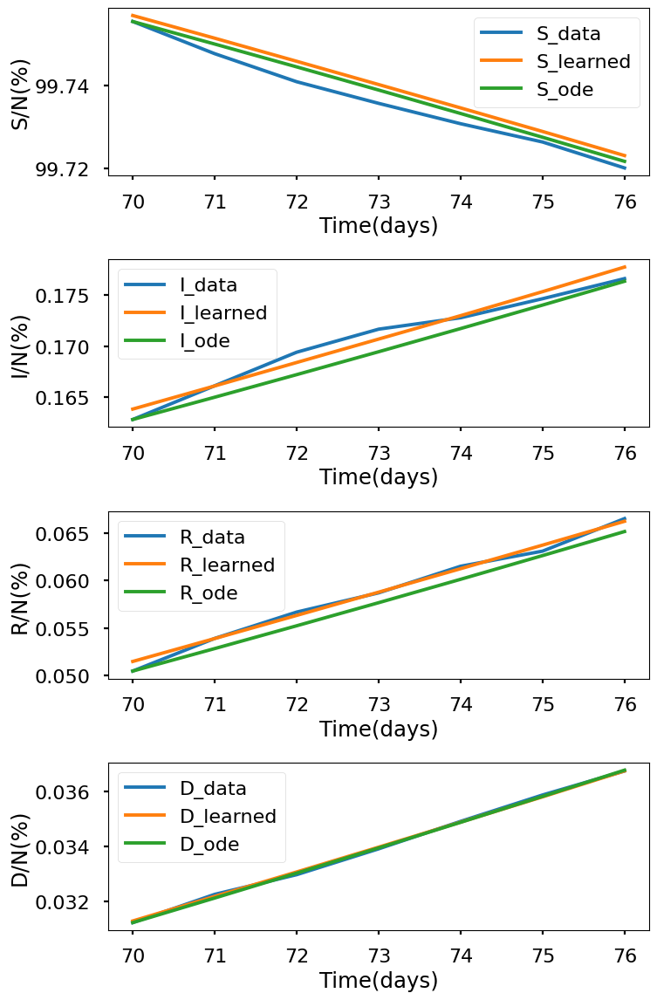

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.936e+00, GE_loss: 2.93049e+00,OB_loss: 2.00550e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.87, cumulative_time: 3.87
It: 10000, Loss: 2.374e-03, GE_loss: 4.69671e-04,OB_loss: 1.90406e-03, Beta: 1.09305e+00,gamma: 9.30090e-01,mu: 8.80780e-01, Time: 20.44, cumulative_time: 24.31
It: 20000, Loss: 7.809e-05, GE_loss: 3.34880e-05,OB_loss: 4.46011e-05, Beta: 2.66578e-02,gamma: 2.24908e-02,mu: 4.20132e-03, Time: 20.20, cumulative_time: 44.51
It: 30000, Loss: 3.312e-05, GE_loss: 1.95004e-05,OB_loss: 1.36181e-05, Beta: 2.64847e-02,gamma: 2.24342e-02,mu: 4.81108e-03, Time: 20.21, cumulative_time: 64.72
It: 40000, Loss: 9.453e-05, GE_loss: 4.93803e-05,OB_loss: 4.51521e-05, Beta: 2.79126e-02,gamma: 2.29648e-02,mu: 4.62144e-03, Time: 21.10, cumulative_time: 85.82
beta:  [0.02747104]
gamma:  [0.0221926]
mu:  [0.00426783]


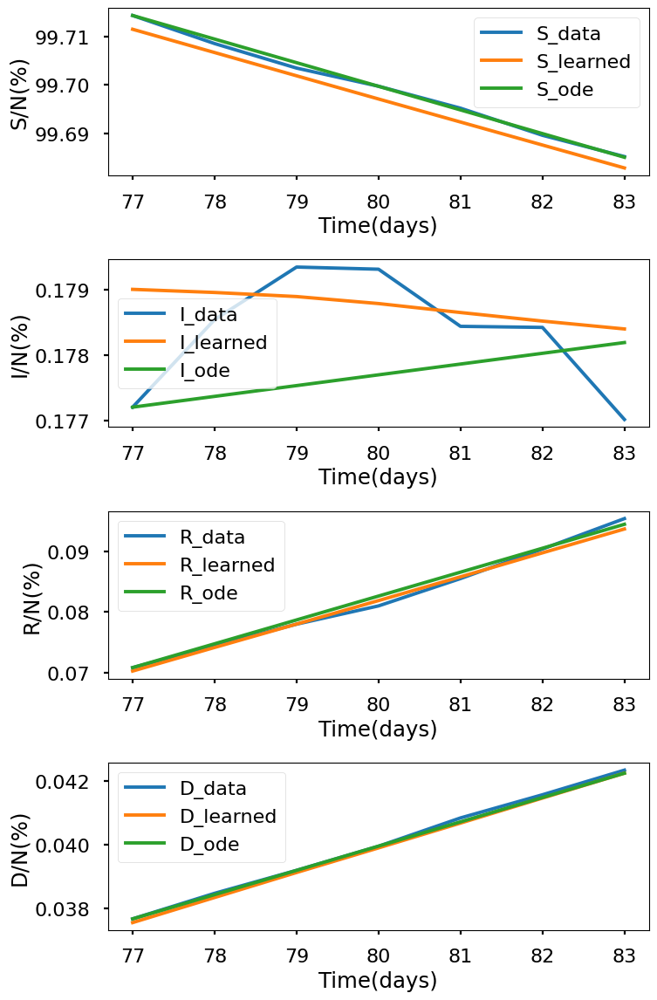

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.954e+00, GE_loss: 2.98518e+00,OB_loss: 1.96903e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.87, cumulative_time: 3.87
It: 10000, Loss: 2.254e-03, GE_loss: 4.55910e-04,OB_loss: 1.79781e-03, Beta: 9.52105e-01,gamma: 9.36008e-01,mu: 9.07949e-01, Time: 20.45, cumulative_time: 24.31
It: 20000, Loss: 7.773e-05, GE_loss: 3.51876e-05,OB_loss: 4.25462e-05, Beta: 2.02258e-02,gamma: 2.04178e-02,mu: 3.30819e-03, Time: 20.50, cumulative_time: 44.81
It: 30000, Loss: 4.235e-05, GE_loss: 1.34307e-05,OB_loss: 2.89168e-05, Beta: 1.93325e-02,gamma: 2.00850e-02,mu: 3.15037e-03, Time: 20.29, cumulative_time: 65.11
It: 40000, Loss: 1.186e-04, GE_loss: 3.47249e-05,OB_loss: 8.39199e-05, Beta: 1.91173e-02,gamma: 1.95129e-02,mu: 3.03276e-03, Time: 21.15, cumulative_time: 86.26
beta:  [0.01959988]
gamma:  [0.02047158]
mu:  [0.00289725]


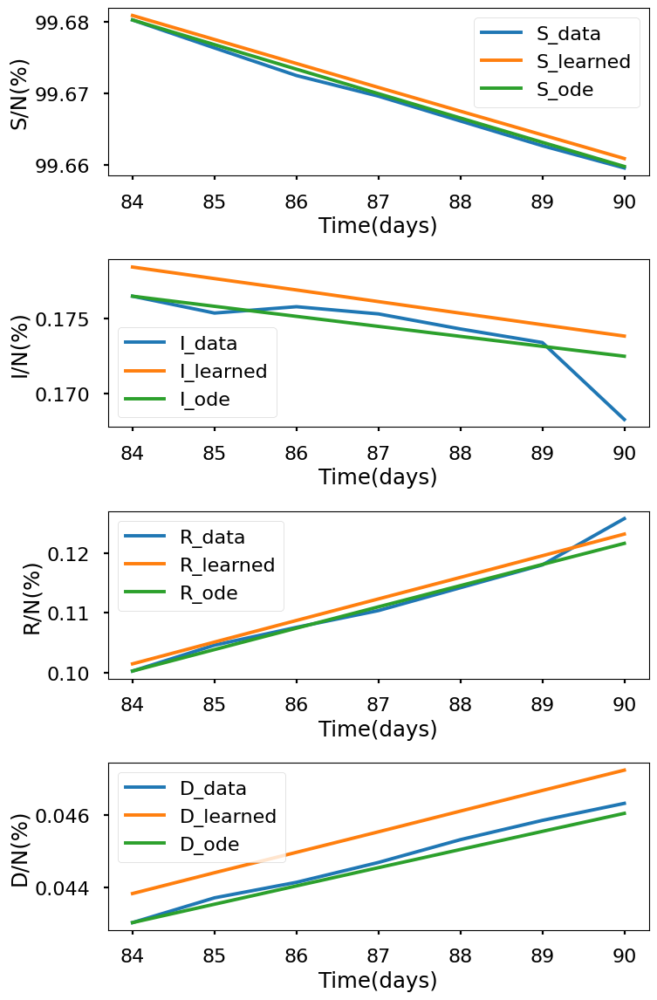

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.924e+00, GE_loss: 2.97981e+00,OB_loss: 1.94372e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 3.94, cumulative_time: 3.94
It: 10000, Loss: 8.960e-04, GE_loss: 1.07562e-04,OB_loss: 7.88415e-04, Beta: 1.80610e+00,gamma: 9.29005e-01,mu: 9.10480e-01, Time: 57.20, cumulative_time: 61.14
It: 20000, Loss: 1.098e-04, GE_loss: 1.30780e-05,OB_loss: 9.66973e-05, Beta: 1.21394e-02,gamma: 3.78845e-02,mu: 1.95630e-03, Time: 59.49, cumulative_time: 120.63
It: 30000, Loss: 1.178e-04, GE_loss: 3.20031e-05,OB_loss: 8.58038e-05, Beta: 1.06314e-02,gamma: 3.72571e-02,mu: 2.09316e-03, Time: 56.76, cumulative_time: 177.39
It: 40000, Loss: 7.623e-05, GE_loss: 1.42383e-05,OB_loss: 6.19941e-05, Beta: 1.09470e-02,gamma: 3.84133e-02,mu: 1.85021e-03, Time: 57.12, cumulative_time: 234.51
beta:  [0.01198604]
gamma:  [0.03878534]
mu:  [0.00207085]


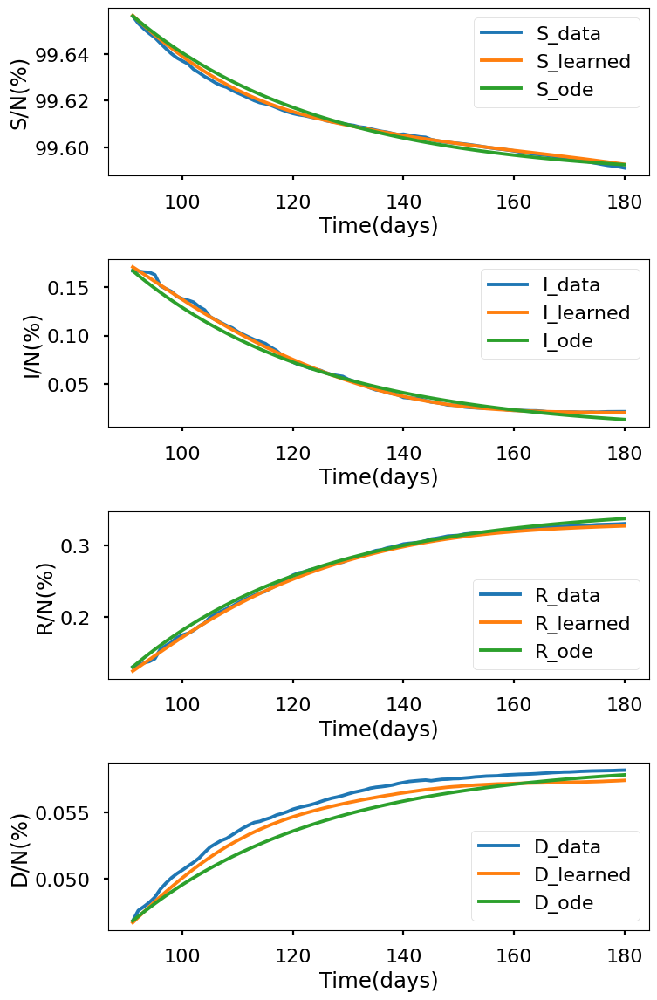

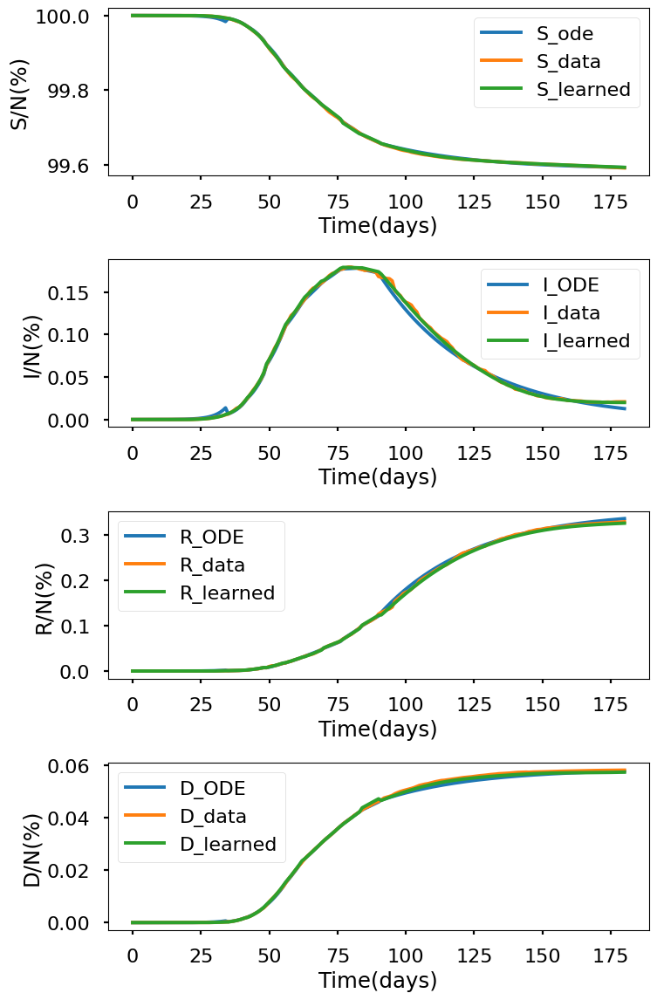

+---------------------+---------------------+--------------+-------------+--------------+-------------+-------------+--------------+-------------+--------------+--------------+
|      Paramaters     | Initial three weeks |   4th week   |   5th week  |   6th week   |   7th week  |   8th week  |   9th week   |  10th week  |  11th week   |  remainder   |
+---------------------+---------------------+--------------+-------------+--------------+-------------+-------------+--------------+-------------+--------------+--------------+
|         beta        |      0.28723514     |  0.22523382  |  0.16704491 |  0.11230969  |  0.06409526 | 0.042866547 | 0.033320047  | 0.027471036 | 0.019599885  | 0.011986044  |
|        gamma        |      0.03281456     | 0.0145962825 | 0.023283113 | 0.019644286  | 0.016149798 | 0.015677378 | 0.014472269  | 0.022192603 | 0.020471577  | 0.038785342  |
|          mu         |     0.011418403     | 0.019115848  | 0.016414871 | 0.0140386205 | 0.011124822 | 0.006587522

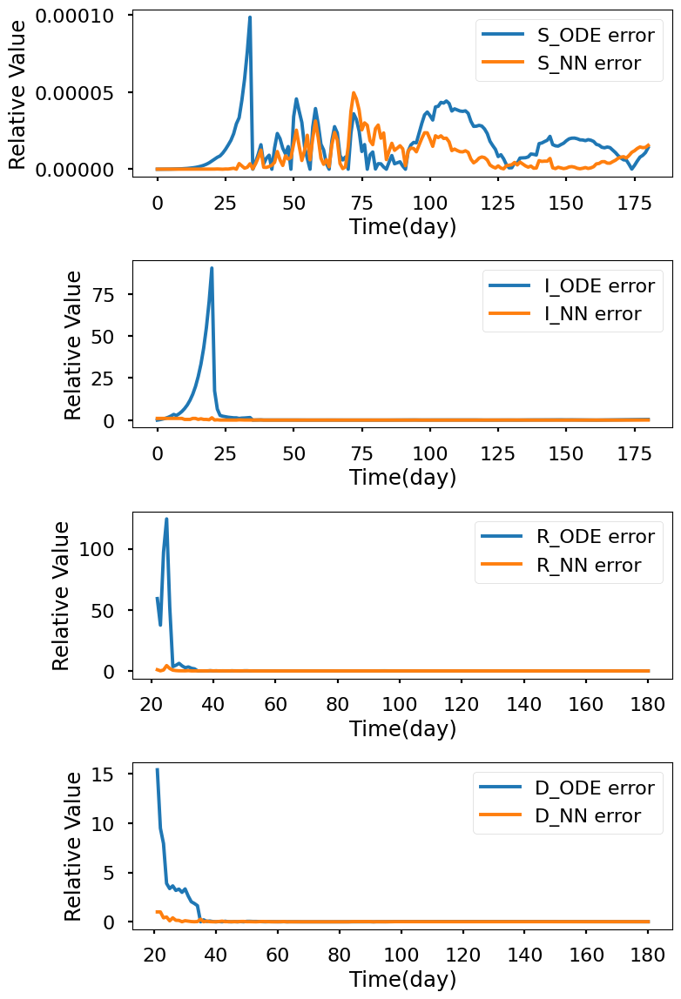

In [16]:
layers264 = [1,64,64,4]
S264_ode,I264_ode,R264_ode,D264_ode,S264_learned,I264_learned,R264_learned,D264_learned,beta264,gamma264,mu264,S_errnn264,I_errnn264,R_errnn264,D_errnn264,S_erode264,I_errode264,R_errode264,D_errode264,time264 = sum_all(
    layers264,length,SS,II,RC,DC,N0,0.1,50000)

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.949e+00, GE_loss: 2.96555e+00,OB_loss: 1.98311e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.16, cumulative_time: 4.16
It: 10000, Loss: 8.934e-06, GE_loss: 5.65739e-07,OB_loss: 8.36780e-06, Beta: 1.05989e+00,gamma: 9.56134e-01,mu: 9.56504e-01, Time: 37.85, cumulative_time: 42.01
It: 20000, Loss: 6.954e-06, GE_loss: 2.40736e-07,OB_loss: 6.71293e-06, Beta: 2.06393e+00,gamma: 9.40922e-01,mu: 9.20787e-01, Time: 37.62, cumulative_time: 79.63
It: 30000, Loss: 9.274e-07, GE_loss: 4.10831e-07,OB_loss: 5.16540e-07, Beta: 2.85917e-01,gamma: 3.19712e-02,mu: 1.09667e-02, Time: 38.06, cumulative_time: 117.69
It: 40000, Loss: 8.397e-07, GE_loss: 3.32839e-07,OB_loss: 5.06854e-07, Beta: 2.87332e-01,gamma: 3.28943e-02,mu: 1.12567e-02, Time: 38.24, cumulative_time: 155.93
beta:  [0.28707504]
gamma:  [0.03251724]
mu:  [0.01157103]


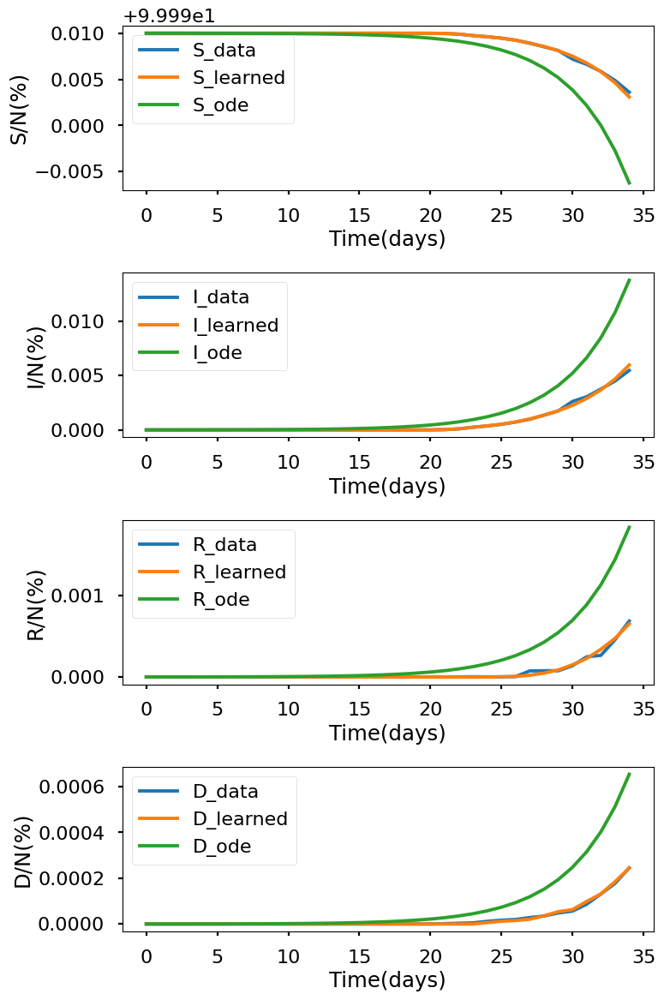

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.933e+00, GE_loss: 2.95146e+00,OB_loss: 1.98152e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.20, cumulative_time: 4.20
It: 10000, Loss: 1.570e-04, GE_loss: 1.83092e-05,OB_loss: 1.38730e-04, Beta: 1.06509e+00,gamma: 9.53708e-01,mu: 9.54206e-01, Time: 23.90, cumulative_time: 28.10
It: 20000, Loss: 6.686e-05, GE_loss: 1.42303e-05,OB_loss: 5.26259e-05, Beta: 5.64021e-01,gamma: 2.99139e-02,mu: 3.76574e-02, Time: 24.13, cumulative_time: 52.23
It: 30000, Loss: 7.073e-06, GE_loss: 1.44119e-06,OB_loss: 5.63206e-06, Beta: 2.23762e-01,gamma: 1.47259e-02,mu: 1.94057e-02, Time: 25.42, cumulative_time: 77.65
It: 40000, Loss: 7.760e-06, GE_loss: 2.40657e-06,OB_loss: 5.35345e-06, Beta: 2.23210e-01,gamma: 1.42433e-02,mu: 1.91751e-02, Time: 26.50, cumulative_time: 104.15
beta:  [0.22469632]
gamma:  [0.0140538]
mu:  [0.01940124]


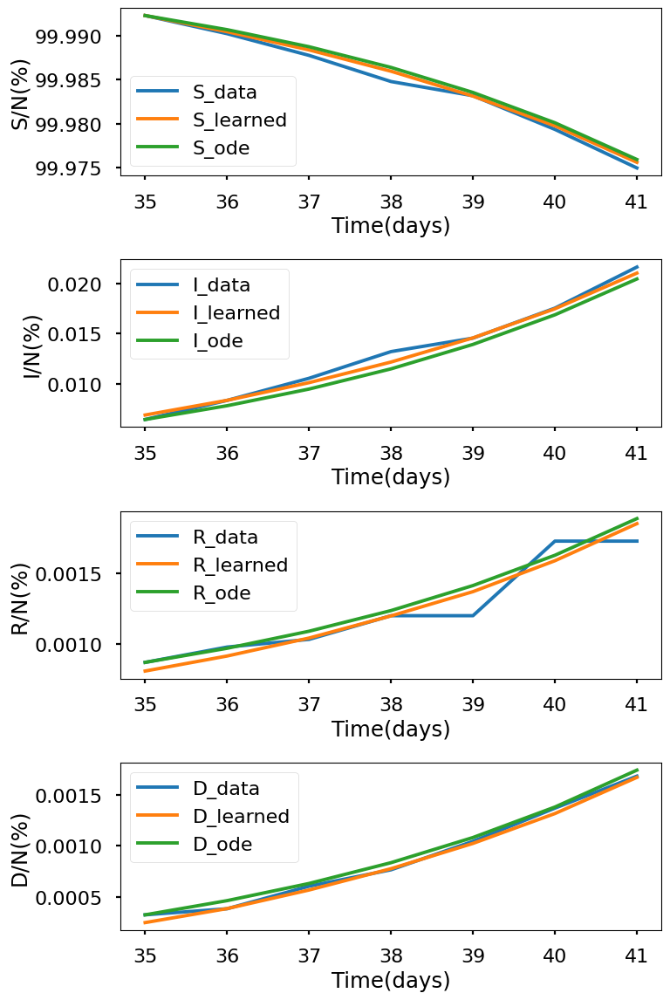

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.923e+00, GE_loss: 2.96268e+00,OB_loss: 1.96041e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.21, cumulative_time: 4.21
It: 10000, Loss: 4.656e-04, GE_loss: 6.94655e-05,OB_loss: 3.96169e-04, Beta: 1.09844e+00,gamma: 9.51349e-01,mu: 9.51542e-01, Time: 23.68, cumulative_time: 27.89
It: 20000, Loss: 2.154e-05, GE_loss: 9.70235e-06,OB_loss: 1.18370e-05, Beta: 1.65739e-01,gamma: 2.23429e-02,mu: 1.63686e-02, Time: 23.79, cumulative_time: 51.68
It: 30000, Loss: 1.826e-05, GE_loss: 9.39746e-06,OB_loss: 8.86058e-06, Beta: 1.64912e-01,gamma: 2.24850e-02,mu: 1.66203e-02, Time: 25.02, cumulative_time: 76.70
It: 40000, Loss: 1.891e-05, GE_loss: 9.31108e-06,OB_loss: 9.59706e-06, Beta: 1.63787e-01,gamma: 2.23183e-02,mu: 1.63607e-02, Time: 23.72, cumulative_time: 100.42
beta:  [0.16444455]
gamma:  [0.02279107]
mu:  [0.01629062]


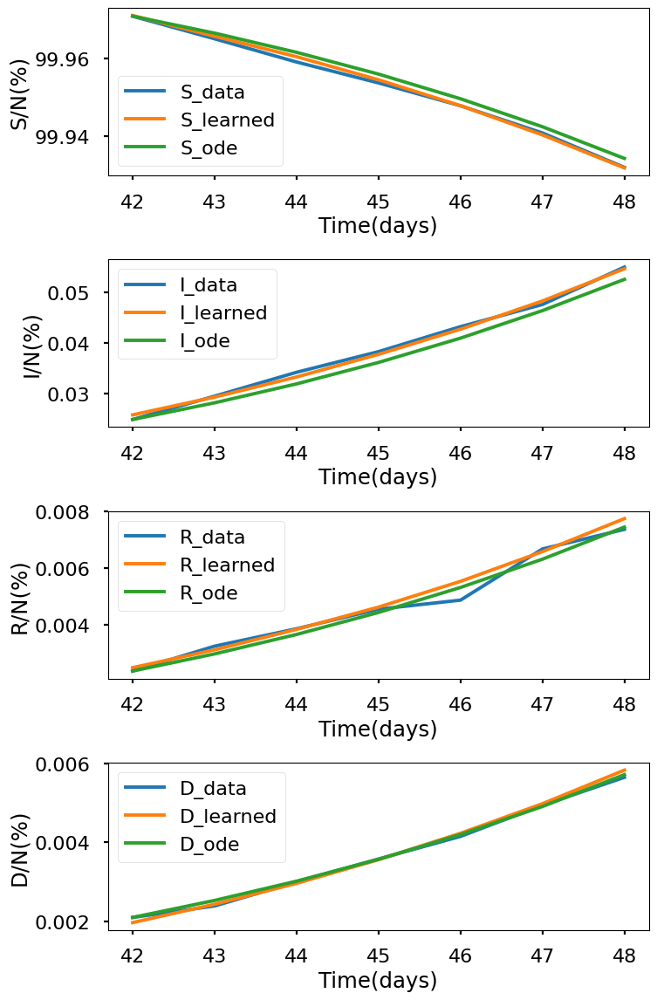

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.818e+00, GE_loss: 2.89786e+00,OB_loss: 1.92000e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.23, cumulative_time: 4.23
It: 10000, Loss: 1.001e-03, GE_loss: 1.66011e-04,OB_loss: 8.34938e-04, Beta: 1.18693e+00,gamma: 9.33306e-01,mu: 9.18195e-01, Time: 23.99, cumulative_time: 28.23
It: 20000, Loss: 3.875e-05, GE_loss: 1.22941e-05,OB_loss: 2.64577e-05, Beta: 1.11806e-01,gamma: 2.02769e-02,mu: 1.44797e-02, Time: 24.00, cumulative_time: 52.23
It: 30000, Loss: 3.412e-05, GE_loss: 9.91145e-06,OB_loss: 2.42084e-05, Beta: 1.10853e-01,gamma: 1.93443e-02,mu: 1.37263e-02, Time: 24.57, cumulative_time: 76.80
It: 40000, Loss: 3.803e-05, GE_loss: 1.62655e-05,OB_loss: 2.17602e-05, Beta: 1.10896e-01,gamma: 1.99360e-02,mu: 1.46005e-02, Time: 24.24, cumulative_time: 101.03
beta:  [0.11031909]
gamma:  [0.01904901]
mu:  [0.01392278]


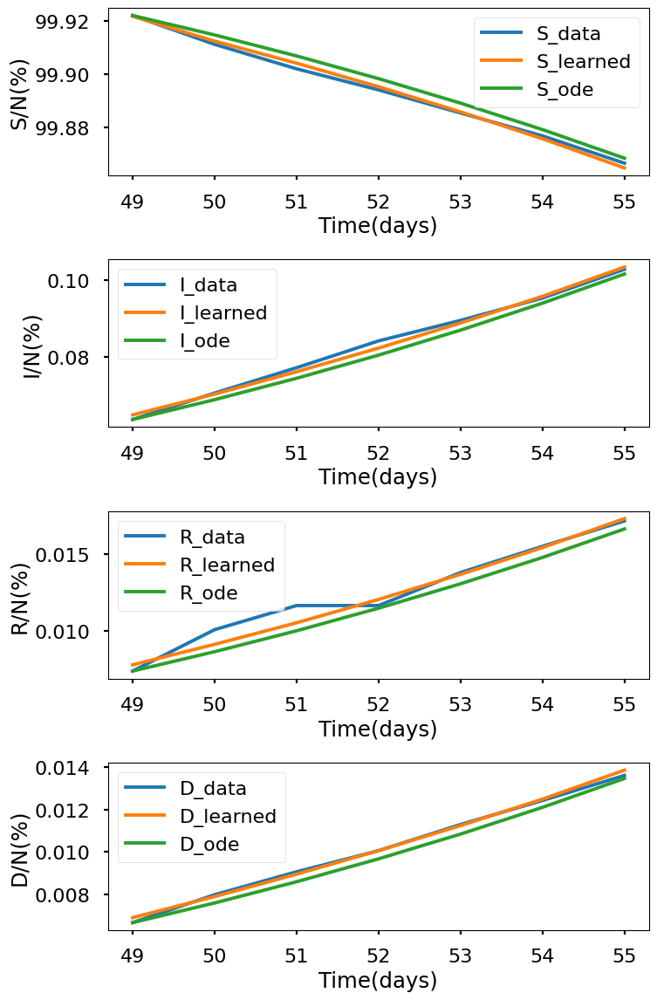

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.888e+00, GE_loss: 2.93926e+00,OB_loss: 1.94873e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.33, cumulative_time: 4.33
It: 10000, Loss: 1.596e-03, GE_loss: 2.56545e-04,OB_loss: 1.33964e-03, Beta: 1.25902e+00,gamma: 9.24567e-01,mu: 9.02036e-01, Time: 23.46, cumulative_time: 27.78
It: 20000, Loss: 3.980e-05, GE_loss: 1.49077e-05,OB_loss: 2.48916e-05, Beta: 6.51640e-02,gamma: 1.59573e-02,mu: 1.11525e-02, Time: 23.34, cumulative_time: 51.12
It: 30000, Loss: 3.606e-05, GE_loss: 9.97057e-06,OB_loss: 2.60875e-05, Beta: 6.43447e-02,gamma: 1.61783e-02,mu: 1.10243e-02, Time: 23.35, cumulative_time: 74.48
It: 40000, Loss: 3.145e-05, GE_loss: 1.38133e-05,OB_loss: 1.76330e-05, Beta: 6.50213e-02,gamma: 1.61600e-02,mu: 1.10808e-02, Time: 23.37, cumulative_time: 97.85
beta:  [0.06460615]
gamma:  [0.01619919]
mu:  [0.01064414]


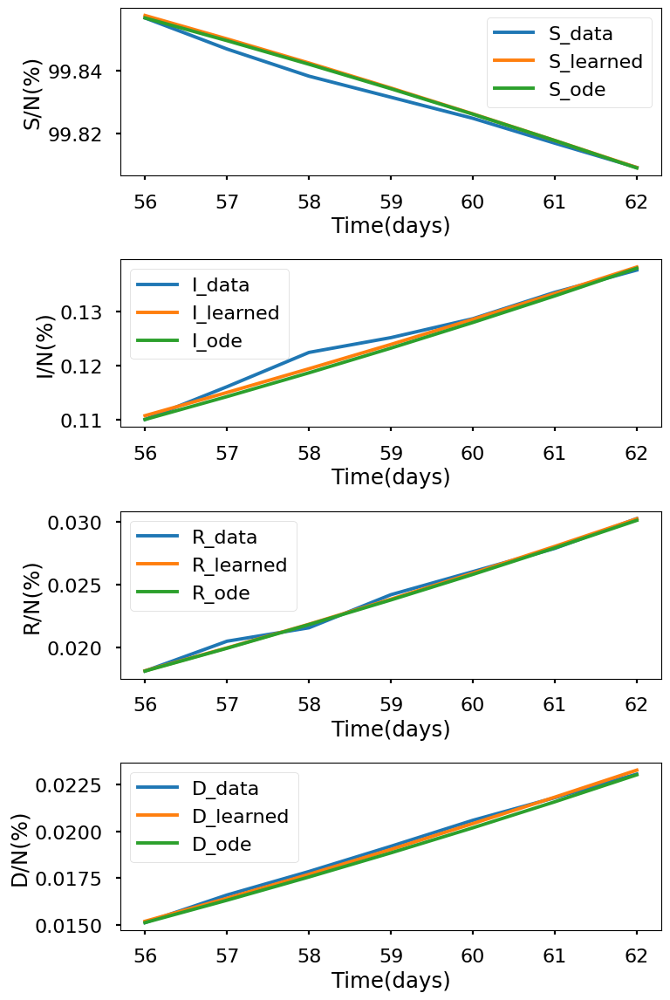

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.865e+00, GE_loss: 2.91998e+00,OB_loss: 1.94552e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.30, cumulative_time: 4.30
It: 10000, Loss: 1.886e-03, GE_loss: 3.54111e-04,OB_loss: 1.53209e-03, Beta: 1.14990e+00,gamma: 9.38665e-01,mu: 9.08769e-01, Time: 23.07, cumulative_time: 27.37
It: 20000, Loss: 8.382e-05, GE_loss: 4.77890e-05,OB_loss: 3.60316e-05, Beta: 4.20289e-02,gamma: 1.53204e-02,mu: 6.82101e-03, Time: 23.42, cumulative_time: 50.80
It: 30000, Loss: 6.633e-05, GE_loss: 2.86996e-05,OB_loss: 3.76255e-05, Beta: 4.22665e-02,gamma: 1.51473e-02,mu: 6.50086e-03, Time: 23.36, cumulative_time: 74.16
It: 40000, Loss: 3.647e-05, GE_loss: 1.10693e-05,OB_loss: 2.54004e-05, Beta: 4.23898e-02,gamma: 1.58331e-02,mu: 6.40302e-03, Time: 23.38, cumulative_time: 97.54
beta:  [0.042774]
gamma:  [0.01602326]
mu:  [0.00676715]


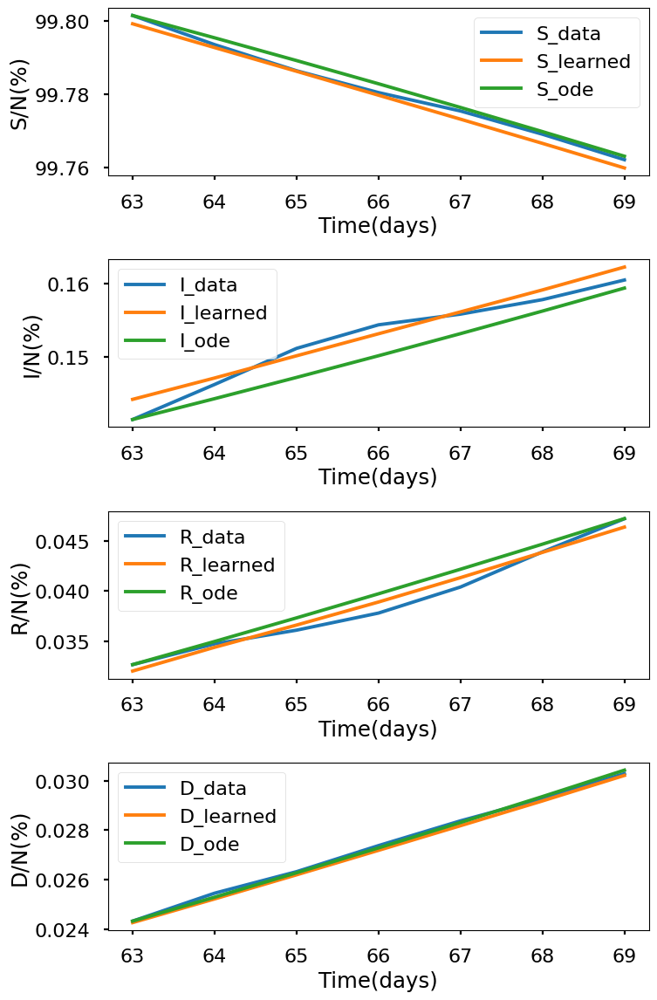

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.905e+00, GE_loss: 2.94015e+00,OB_loss: 1.96481e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.40, cumulative_time: 4.40
It: 10000, Loss: 2.162e-03, GE_loss: 4.10891e-04,OB_loss: 1.75134e-03, Beta: 1.16428e+00,gamma: 9.30827e-01,mu: 8.82995e-01, Time: 23.74, cumulative_time: 28.14
It: 20000, Loss: 6.011e-05, GE_loss: 1.45445e-05,OB_loss: 4.55641e-05, Beta: 3.59182e-02,gamma: 1.51941e-02,mu: 5.59284e-03, Time: 24.69, cumulative_time: 52.83
It: 30000, Loss: 8.770e-05, GE_loss: 3.33199e-05,OB_loss: 5.43832e-05, Beta: 3.30711e-02,gamma: 1.46682e-02,mu: 5.32651e-03, Time: 23.69, cumulative_time: 76.52
It: 40000, Loss: 1.074e-04, GE_loss: 4.40589e-05,OB_loss: 6.33400e-05, Beta: 3.32809e-02,gamma: 1.47271e-02,mu: 5.56616e-03, Time: 23.62, cumulative_time: 100.14
beta:  [0.03471861]
gamma:  [0.01495164]
mu:  [0.00569264]


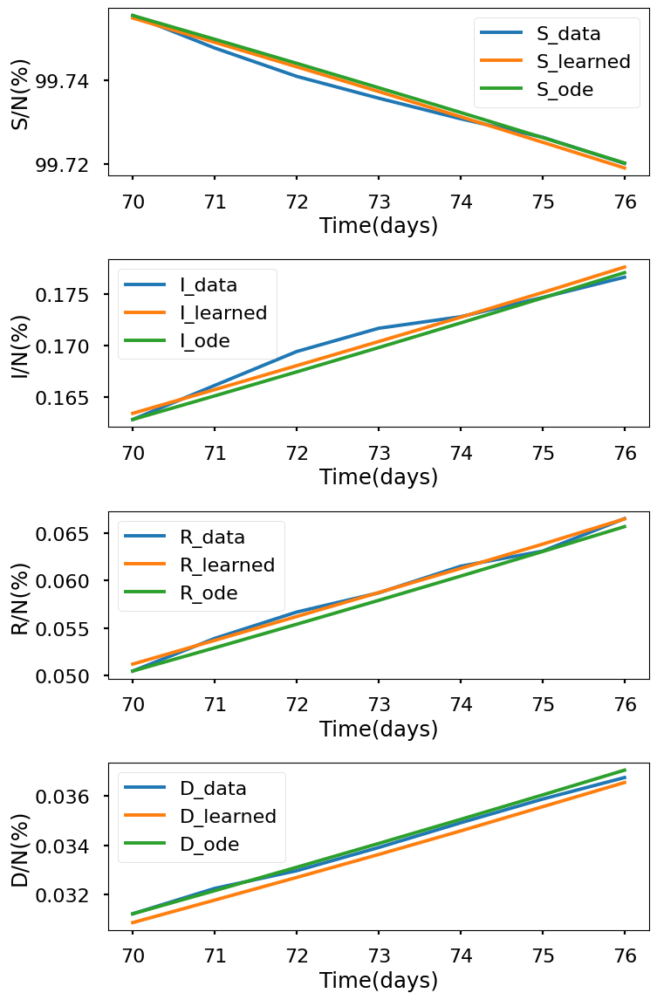

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.954e+00, GE_loss: 2.99452e+00,OB_loss: 1.95990e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.39, cumulative_time: 4.39
It: 10000, Loss: 2.268e-03, GE_loss: 4.68352e-04,OB_loss: 1.79999e-03, Beta: 1.22333e+00,gamma: 9.36321e-01,mu: 8.53012e-01, Time: 23.53, cumulative_time: 27.91
It: 20000, Loss: 1.116e-04, GE_loss: 6.04507e-05,OB_loss: 5.11308e-05, Beta: 2.64472e-02,gamma: 2.20271e-02,mu: 4.14275e-03, Time: 23.46, cumulative_time: 51.38
It: 30000, Loss: 7.463e-05, GE_loss: 4.05665e-05,OB_loss: 3.40621e-05, Beta: 2.66741e-02,gamma: 2.22566e-02,mu: 4.32548e-03, Time: 24.80, cumulative_time: 76.18
It: 40000, Loss: 6.281e-05, GE_loss: 2.83346e-05,OB_loss: 3.44721e-05, Beta: 2.75615e-02,gamma: 2.26434e-02,mu: 4.47485e-03, Time: 24.94, cumulative_time: 101.12
beta:  [0.02726282]
gamma:  [0.02264633]
mu:  [0.00464817]


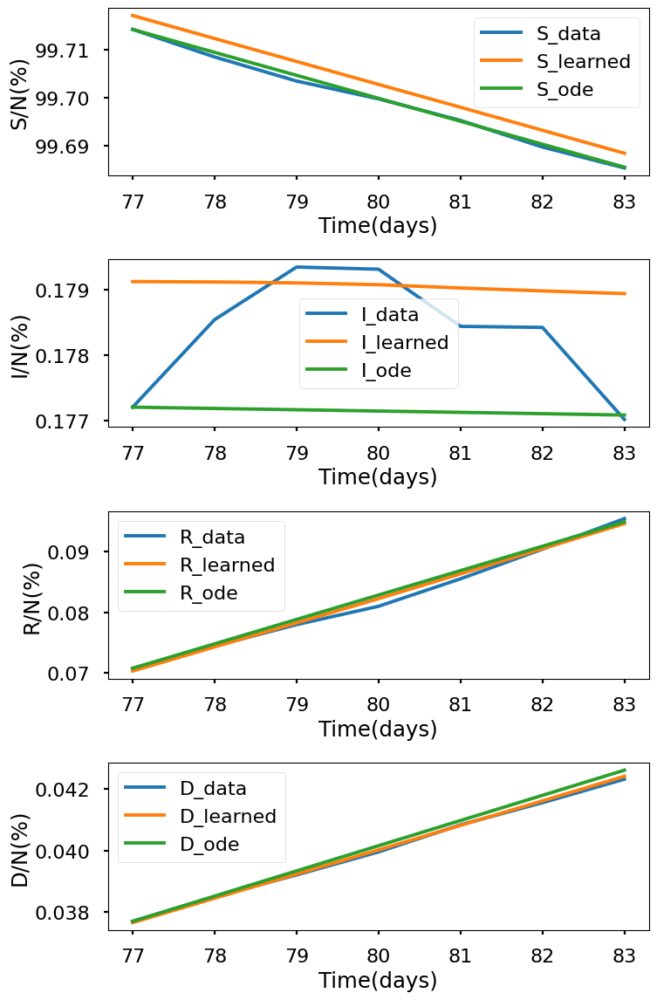

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.913e+00, GE_loss: 2.95362e+00,OB_loss: 1.95903e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.54, cumulative_time: 4.54
It: 10000, Loss: 2.238e-03, GE_loss: 4.50742e-04,OB_loss: 1.78730e-03, Beta: 1.20609e+00,gamma: 9.31690e-01,mu: 8.57557e-01, Time: 23.88, cumulative_time: 28.43
It: 20000, Loss: 4.319e-05, GE_loss: 5.48856e-06,OB_loss: 3.77032e-05, Beta: 1.91288e-02,gamma: 2.06726e-02,mu: 3.22689e-03, Time: 23.89, cumulative_time: 52.32
It: 30000, Loss: 9.503e-05, GE_loss: 4.86564e-05,OB_loss: 4.63750e-05, Beta: 2.03901e-02,gamma: 2.05080e-02,mu: 3.43826e-03, Time: 23.10, cumulative_time: 75.42
It: 40000, Loss: 1.333e-04, GE_loss: 6.44392e-05,OB_loss: 6.88740e-05, Beta: 1.99914e-02,gamma: 2.11899e-02,mu: 3.17502e-03, Time: 23.16, cumulative_time: 98.57
beta:  [0.01991925]
gamma:  [0.02027141]
mu:  [0.00313865]


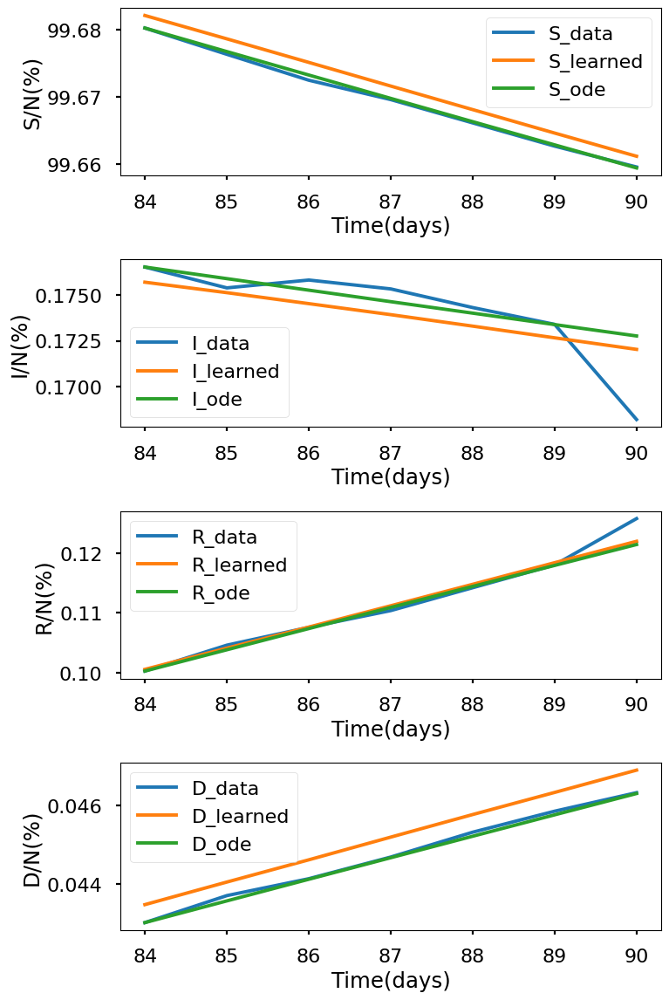

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.881e+00, GE_loss: 2.97270e+00,OB_loss: 1.90825e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.55, cumulative_time: 4.55
It: 10000, Loss: 9.990e-04, GE_loss: 2.14457e-04,OB_loss: 7.84537e-04, Beta: 1.83963e+00,gamma: 9.51501e-01,mu: 9.15863e-01, Time: 87.90, cumulative_time: 92.45
It: 20000, Loss: 4.352e-05, GE_loss: 1.52772e-05,OB_loss: 2.82443e-05, Beta: 1.21802e-02,gamma: 3.90035e-02,mu: 1.68868e-03, Time: 86.20, cumulative_time: 178.65
It: 30000, Loss: 5.120e-05, GE_loss: 2.05938e-05,OB_loss: 3.06041e-05, Beta: 1.13740e-02,gamma: 3.70977e-02,mu: 2.18518e-03, Time: 87.06, cumulative_time: 265.71
It: 40000, Loss: 1.112e-04, GE_loss: 5.53995e-05,OB_loss: 5.57641e-05, Beta: 1.16295e-02,gamma: 3.79625e-02,mu: 2.06741e-03, Time: 87.85, cumulative_time: 353.56
beta:  [0.01068924]
gamma:  [0.03806353]
mu:  [0.00207116]


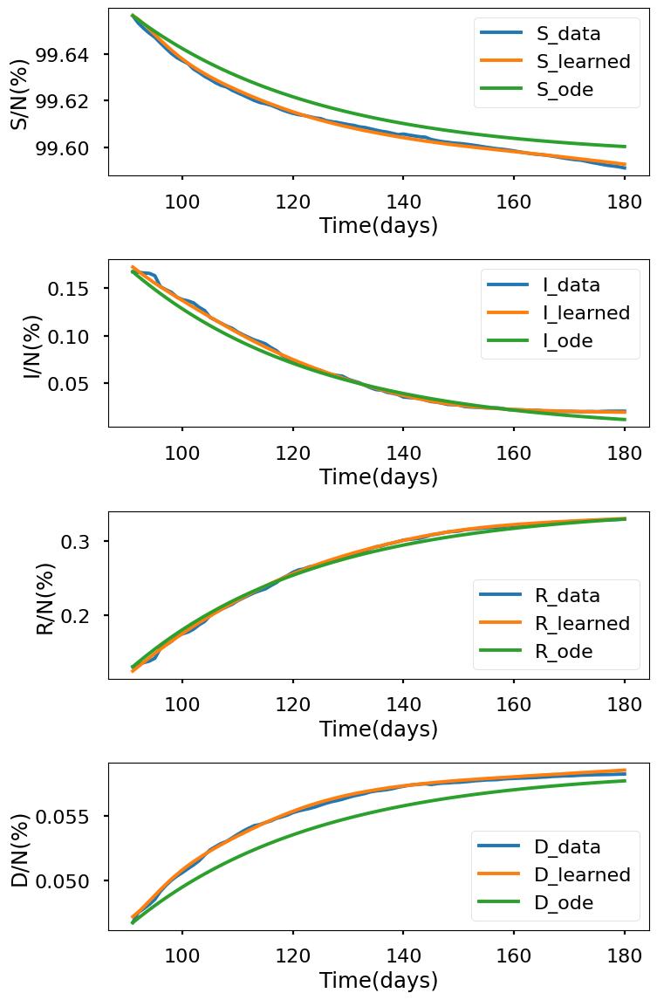

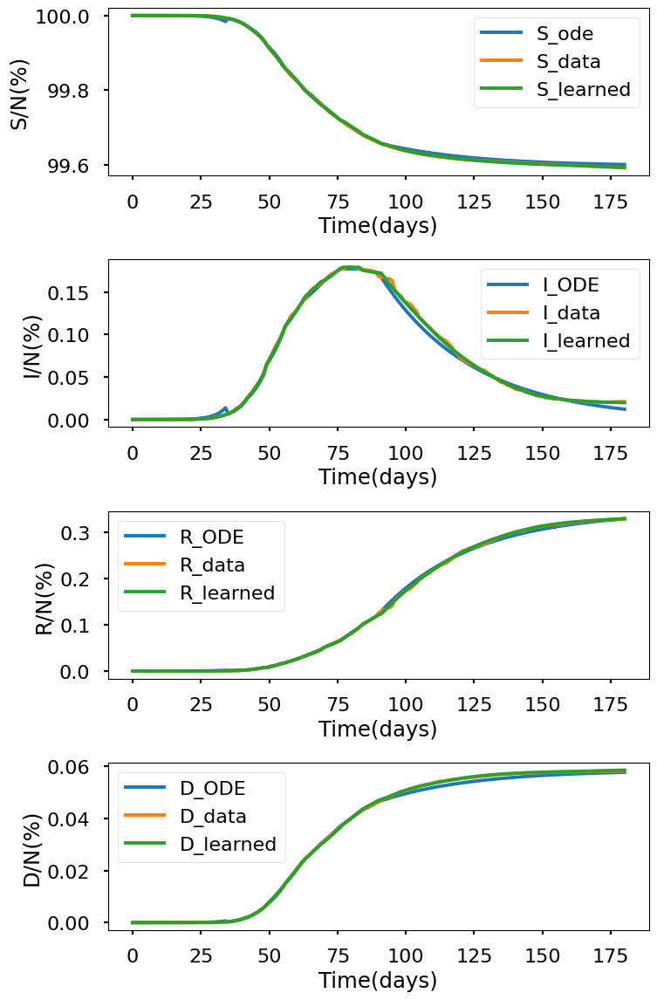

+---------------------+---------------------+-------------+-------------+-------------+-------------+--------------+-------------+--------------+--------------+--------------+
|      Paramaters     | Initial three weeks |   4th week  |   5th week  |   6th week  |   7th week  |   8th week   |   9th week  |  10th week   |  11th week   |  remainder   |
+---------------------+---------------------+-------------+-------------+-------------+-------------+--------------+-------------+--------------+--------------+--------------+
|         beta        |      0.28707504     |  0.22469632 |  0.16444455 | 0.110319085 | 0.064606145 |   0.042774   | 0.034718607 | 0.027262818  | 0.019919246  |  0.01068924  |
|        gamma        |     0.032517243     | 0.014053799 | 0.022791067 | 0.019049007 | 0.016199192 | 0.016023258  | 0.014951643 | 0.022646334  | 0.020271406  |  0.03806353  |
|          mu         |     0.011571026     | 0.019401241 | 0.016290624 | 0.013922776 | 0.010644142 | 0.0067671547 | 0.0

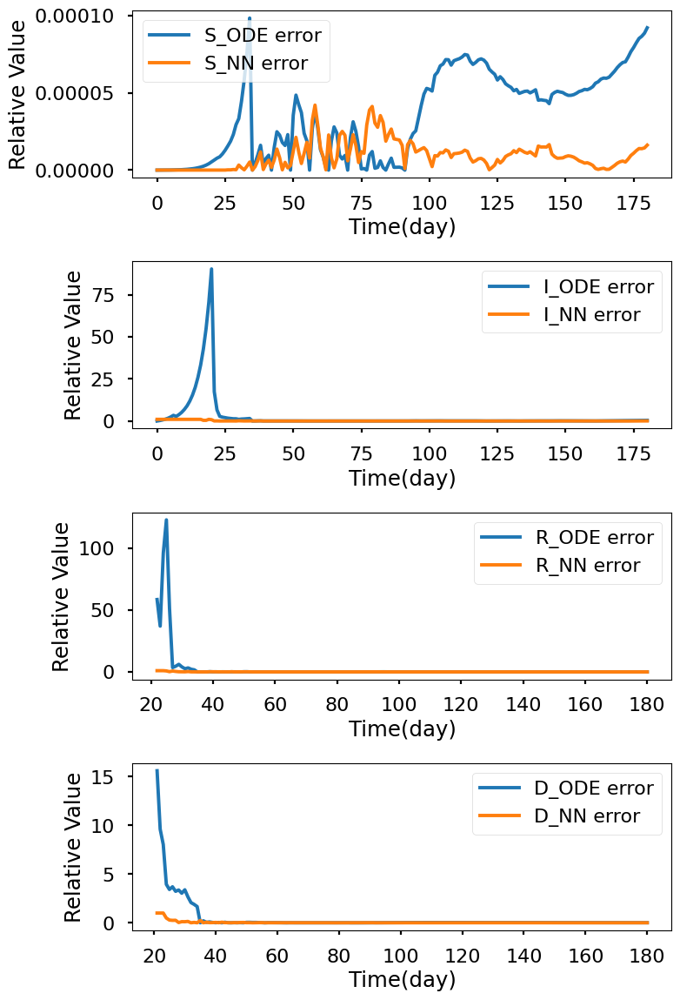

In [17]:
layers364 = [1,64,64,64,4]
S364_ode,I364_ode,R364_ode,D364_ode,S364_learned,I364_learned,R364_learned,D364_learned,beta364,gamma364,mu364,S_errnn364,I_errnn364,R_errnn364,D_errnn364,S_erode364,I_errode364,R_errode264,D_errode364,time364 = sum_all(
    layers364,length,SS,II,RC,DC,N0,0.1,50000)

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.861e+00, GE_loss: 2.96026e+00,OB_loss: 1.90119e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.61, cumulative_time: 4.61
It: 10000, Loss: 8.974e-06, GE_loss: 4.18219e-07,OB_loss: 8.55559e-06, Beta: 1.03357e+00,gamma: 9.65624e-01,mu: 9.65615e-01, Time: 45.57, cumulative_time: 50.18
It: 20000, Loss: 7.516e-06, GE_loss: 1.66669e-08,OB_loss: 7.49945e-06, Beta: 1.04759e+00,gamma: 9.64238e-01,mu: 9.64217e-01, Time: 46.80, cumulative_time: 96.98
It: 30000, Loss: 9.143e-07, GE_loss: 3.85545e-07,OB_loss: 5.28776e-07, Beta: 2.87131e-01,gamma: 3.19507e-02,mu: 1.15143e-02, Time: 47.64, cumulative_time: 144.62
It: 40000, Loss: 8.270e-07, GE_loss: 3.30185e-07,OB_loss: 4.96775e-07, Beta: 2.86935e-01,gamma: 3.24323e-02,mu: 1.13307e-02, Time: 48.81, cumulative_time: 193.44
beta:  [0.2868424]
gamma:  [0.03211987]
mu:  [0.01142192]


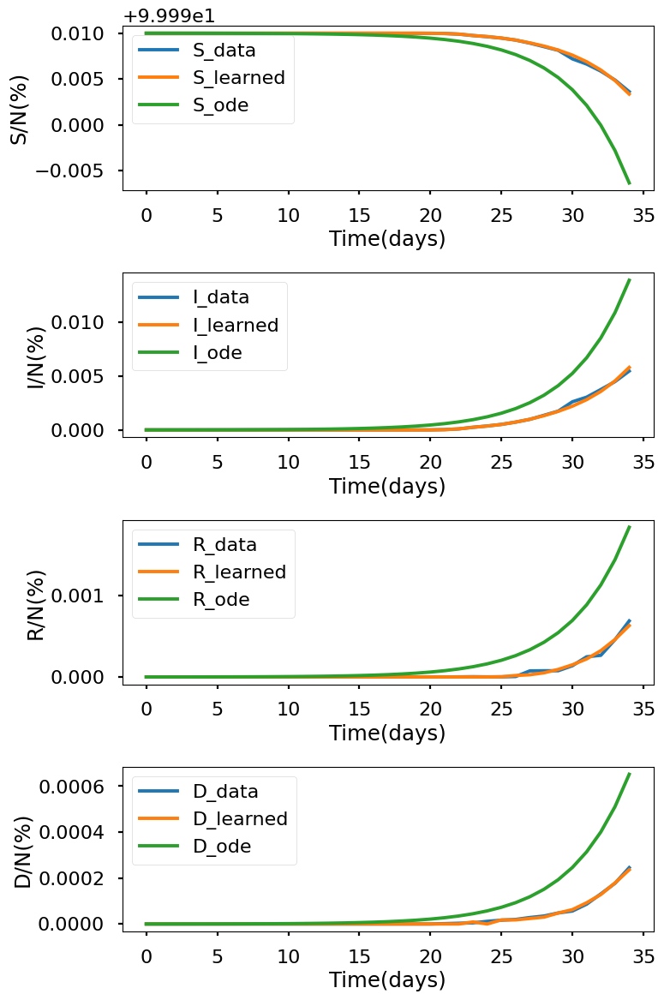

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.941e+00, GE_loss: 2.94864e+00,OB_loss: 1.99203e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.62, cumulative_time: 4.62
It: 10000, Loss: 1.564e-04, GE_loss: 1.72021e-05,OB_loss: 1.39230e-04, Beta: 1.04912e+00,gamma: 9.62453e-01,mu: 9.62021e-01, Time: 26.34, cumulative_time: 30.96
It: 20000, Loss: 6.454e-05, GE_loss: 8.29926e-06,OB_loss: 5.62361e-05, Beta: 6.03060e-01,gamma: 3.08349e-02,mu: 4.34513e-02, Time: 26.26, cumulative_time: 57.22
It: 30000, Loss: 6.827e-06, GE_loss: 1.68756e-06,OB_loss: 5.13981e-06, Beta: 2.25563e-01,gamma: 1.47895e-02,mu: 1.94800e-02, Time: 26.33, cumulative_time: 83.55
It: 40000, Loss: 7.064e-06, GE_loss: 2.25975e-06,OB_loss: 4.80425e-06, Beta: 2.23698e-01,gamma: 1.40265e-02,mu: 1.91124e-02, Time: 26.17, cumulative_time: 109.72
beta:  [0.22397873]
gamma:  [0.01425123]
mu:  [0.01958317]


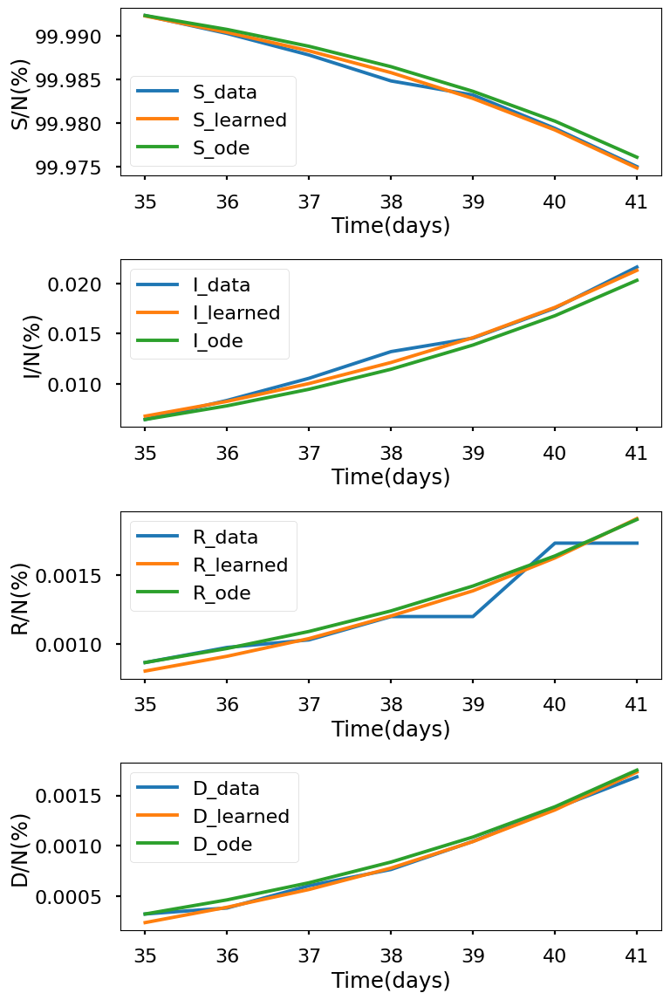

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.842e+00, GE_loss: 2.92590e+00,OB_loss: 1.91598e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.72, cumulative_time: 4.72
It: 10000, Loss: 4.625e-04, GE_loss: 6.62455e-05,OB_loss: 3.96227e-04, Beta: 1.09375e+00,gamma: 9.45413e-01,mu: 9.44170e-01, Time: 27.25, cumulative_time: 31.97
It: 20000, Loss: 1.557e-05, GE_loss: 7.03439e-06,OB_loss: 8.53795e-06, Beta: 1.66242e-01,gamma: 2.20990e-02,mu: 1.67088e-02, Time: 27.14, cumulative_time: 59.11
It: 30000, Loss: 1.375e-05, GE_loss: 4.63949e-06,OB_loss: 9.11410e-06, Beta: 1.66234e-01,gamma: 2.31562e-02,mu: 1.66255e-02, Time: 26.87, cumulative_time: 85.98
It: 40000, Loss: 1.614e-05, GE_loss: 4.66300e-06,OB_loss: 1.14743e-05, Beta: 1.64798e-01,gamma: 2.29249e-02,mu: 1.64997e-02, Time: 26.82, cumulative_time: 112.80
beta:  [0.15721622]
gamma:  [0.02052471]
mu:  [0.01601936]


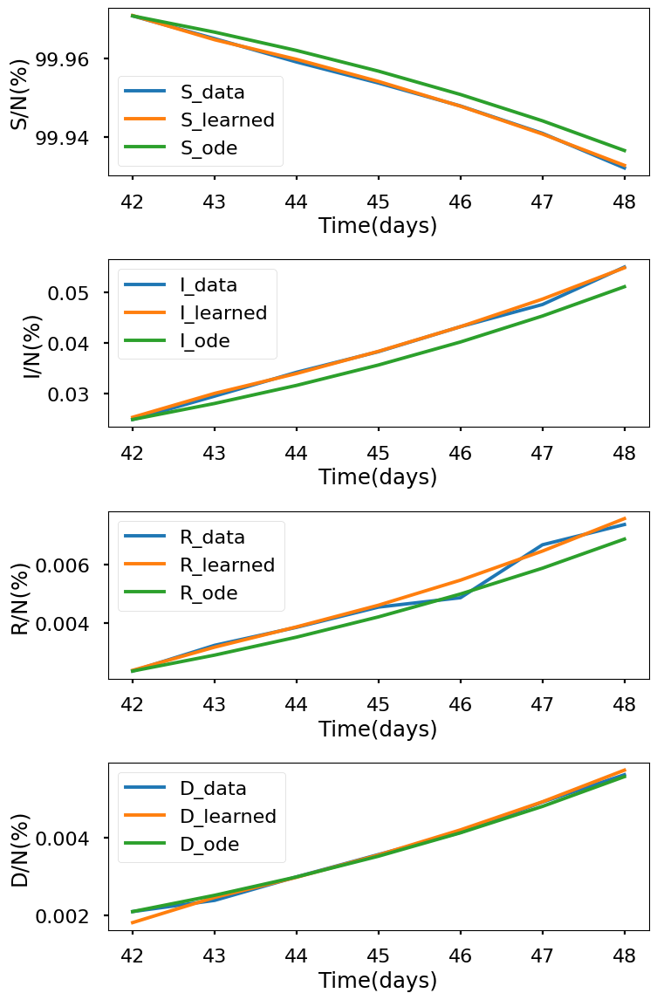

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.907e+00, GE_loss: 2.94448e+00,OB_loss: 1.96223e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.78, cumulative_time: 4.78
It: 10000, Loss: 9.975e-04, GE_loss: 1.43926e-04,OB_loss: 8.53580e-04, Beta: 1.30225e+00,gamma: 9.33697e-01,mu: 9.21546e-01, Time: 27.37, cumulative_time: 32.14
It: 20000, Loss: 2.422e-05, GE_loss: 7.39453e-06,OB_loss: 1.68257e-05, Beta: 1.12766e-01,gamma: 1.99477e-02,mu: 1.38177e-02, Time: 26.87, cumulative_time: 59.01
It: 30000, Loss: 5.037e-05, GE_loss: 2.09617e-05,OB_loss: 2.94044e-05, Beta: 1.11519e-01,gamma: 1.90359e-02,mu: 1.43395e-02, Time: 27.53, cumulative_time: 86.54
It: 40000, Loss: 2.759e-05, GE_loss: 1.35150e-05,OB_loss: 1.40759e-05, Beta: 1.08702e-01,gamma: 1.82458e-02,mu: 1.36665e-02, Time: 26.55, cumulative_time: 113.09
beta:  [0.11399077]
gamma:  [0.01979355]
mu:  [0.01466144]


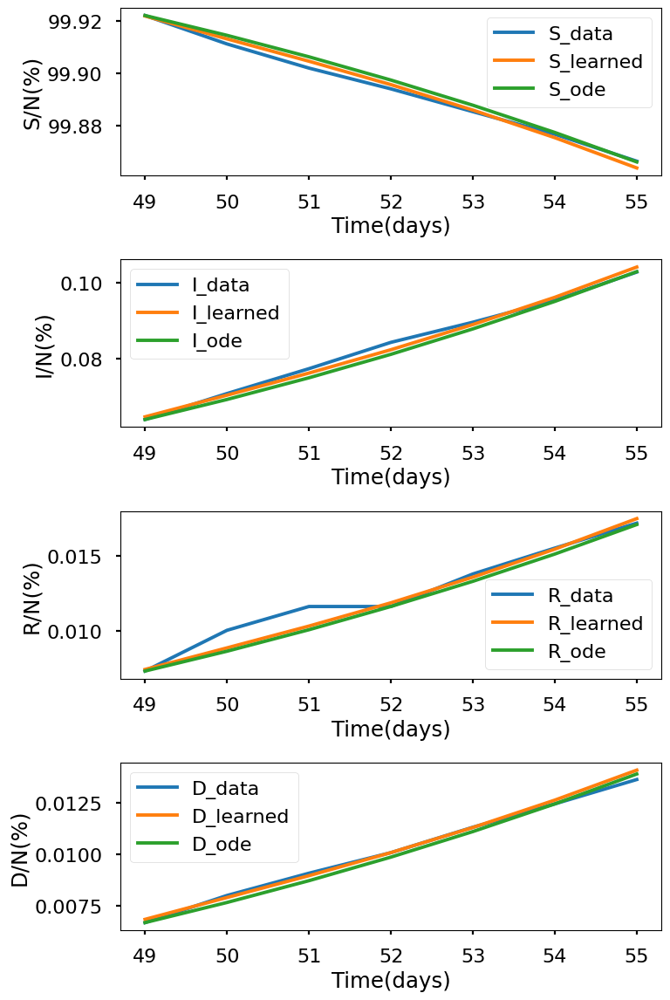

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.893e+00, GE_loss: 2.94536e+00,OB_loss: 1.94755e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.95, cumulative_time: 4.95
It: 10000, Loss: 1.492e-03, GE_loss: 2.28100e-04,OB_loss: 1.26357e-03, Beta: 1.43872e+00,gamma: 9.20272e-01,mu: 8.87976e-01, Time: 26.45, cumulative_time: 31.39
It: 20000, Loss: 4.852e-05, GE_loss: 2.86031e-05,OB_loss: 1.99153e-05, Beta: 6.91016e-02,gamma: 1.47628e-02,mu: 1.05445e-02, Time: 26.66, cumulative_time: 58.05
It: 30000, Loss: 6.343e-05, GE_loss: 3.04952e-05,OB_loss: 3.29351e-05, Beta: 6.89917e-02,gamma: 1.49049e-02,mu: 1.07271e-02, Time: 26.83, cumulative_time: 84.88
It: 40000, Loss: 3.732e-05, GE_loss: 1.75640e-05,OB_loss: 1.97537e-05, Beta: 6.96812e-02,gamma: 1.53501e-02,mu: 1.06991e-02, Time: 27.21, cumulative_time: 112.09
beta:  [0.06913718]
gamma:  [0.01532779]
mu:  [0.01079682]


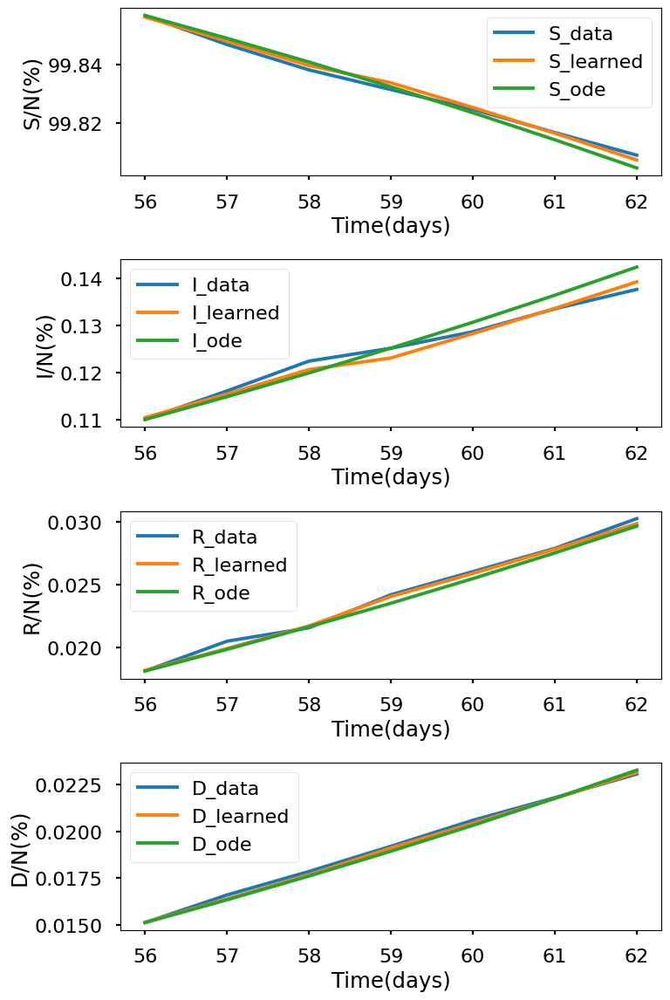

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.886e+00, GE_loss: 2.93613e+00,OB_loss: 1.94971e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.97, cumulative_time: 4.97
It: 10000, Loss: 1.897e-03, GE_loss: 3.40197e-04,OB_loss: 1.55720e-03, Beta: 1.36350e+00,gamma: 9.29702e-01,mu: 8.86441e-01, Time: 26.81, cumulative_time: 31.78
It: 20000, Loss: 8.608e-05, GE_loss: 3.81605e-05,OB_loss: 4.79229e-05, Beta: 4.30680e-02,gamma: 1.56380e-02,mu: 6.50027e-03, Time: 26.85, cumulative_time: 58.63
It: 30000, Loss: 5.486e-05, GE_loss: 2.18171e-05,OB_loss: 3.30473e-05, Beta: 4.36709e-02,gamma: 1.61793e-02,mu: 6.47998e-03, Time: 26.80, cumulative_time: 85.43
It: 40000, Loss: 4.206e-05, GE_loss: 1.65008e-05,OB_loss: 2.55590e-05, Beta: 4.29396e-02,gamma: 1.58388e-02,mu: 6.55814e-03, Time: 26.59, cumulative_time: 112.01
beta:  [0.04318117]
gamma:  [0.01591781]
mu:  [0.00656559]


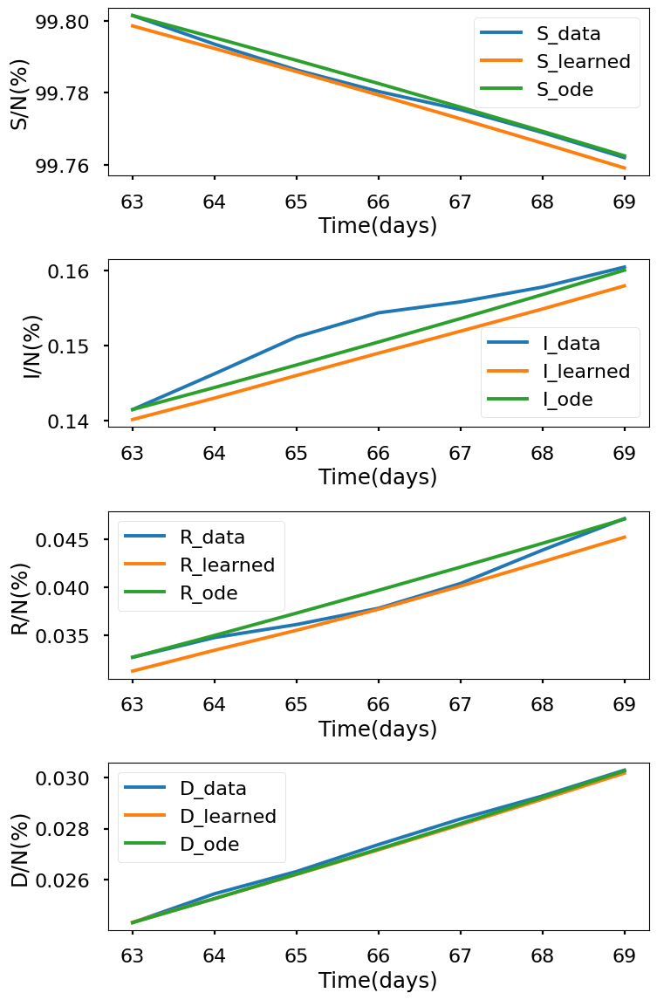

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.892e+00, GE_loss: 2.93528e+00,OB_loss: 1.95715e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 4.95, cumulative_time: 4.95
It: 10000, Loss: 2.065e-03, GE_loss: 3.29383e-04,OB_loss: 1.73535e-03, Beta: 1.37207e+00,gamma: 9.43933e-01,mu: 8.88845e-01, Time: 28.83, cumulative_time: 33.78
It: 20000, Loss: 3.370e-05, GE_loss: 2.05382e-05,OB_loss: 1.31610e-05, Beta: 3.42210e-02,gamma: 1.53073e-02,mu: 5.82403e-03, Time: 27.26, cumulative_time: 61.05
It: 30000, Loss: 4.824e-05, GE_loss: 1.38681e-05,OB_loss: 3.43685e-05, Beta: 3.40532e-02,gamma: 1.49581e-02,mu: 5.38712e-03, Time: 26.38, cumulative_time: 87.42
It: 40000, Loss: 5.417e-05, GE_loss: 2.21573e-05,OB_loss: 3.20137e-05, Beta: 3.36601e-02,gamma: 1.46982e-02,mu: 5.80988e-03, Time: 26.51, cumulative_time: 113.93
beta:  [0.03472706]
gamma:  [0.01501803]
mu:  [0.00564438]


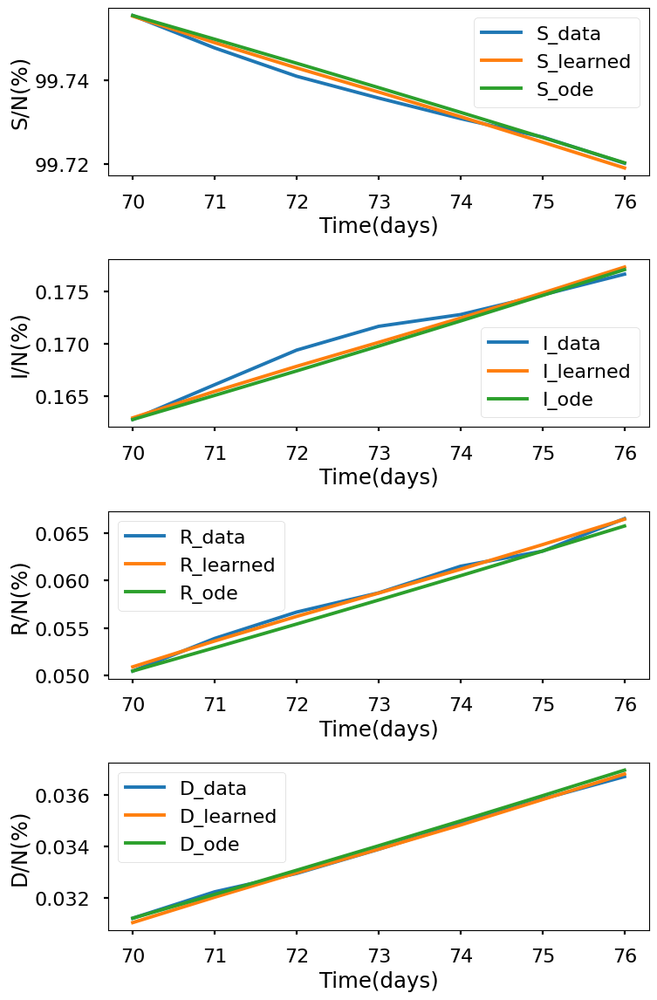

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.939e+00, GE_loss: 2.94407e+00,OB_loss: 1.99530e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.01, cumulative_time: 5.01
It: 10000, Loss: 2.184e-03, GE_loss: 4.02495e-04,OB_loss: 1.78194e-03, Beta: 1.32086e+00,gamma: 9.40227e-01,mu: 8.38252e-01, Time: 26.42, cumulative_time: 31.44
It: 20000, Loss: 4.819e-05, GE_loss: 1.08854e-05,OB_loss: 3.73055e-05, Beta: 2.50980e-02,gamma: 2.29376e-02,mu: 4.65828e-03, Time: 26.43, cumulative_time: 57.86
It: 30000, Loss: 8.041e-05, GE_loss: 3.72471e-05,OB_loss: 4.31598e-05, Beta: 2.65290e-02,gamma: 2.22339e-02,mu: 4.35346e-03, Time: 26.33, cumulative_time: 84.19
It: 40000, Loss: 5.524e-05, GE_loss: 2.17860e-05,OB_loss: 3.34491e-05, Beta: 2.65949e-02,gamma: 2.23865e-02,mu: 4.45078e-03, Time: 26.43, cumulative_time: 110.62
beta:  [0.02622979]
gamma:  [0.02230174]
mu:  [0.00418167]


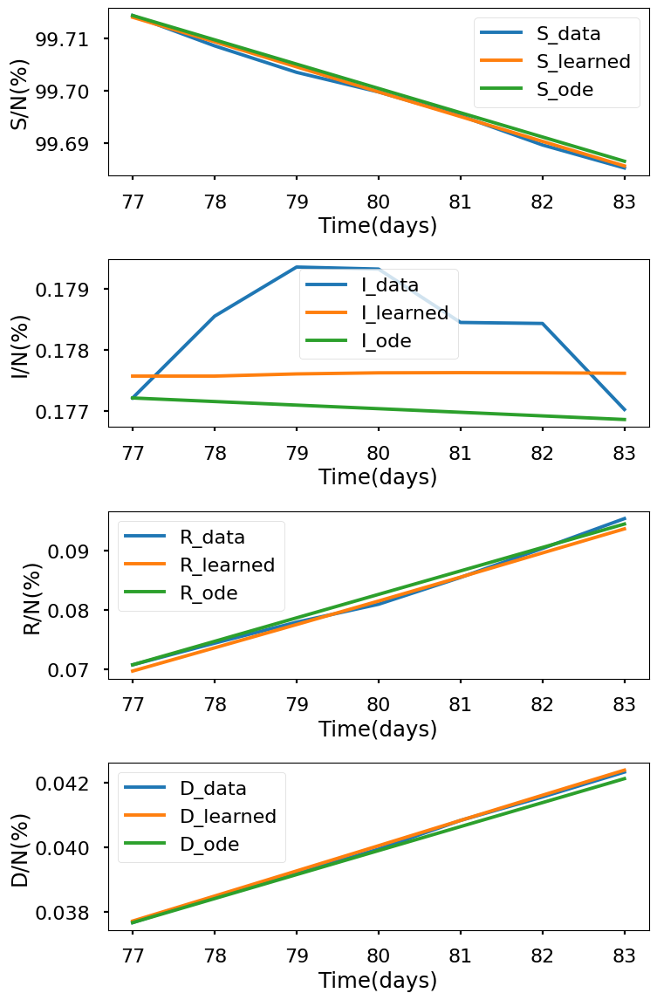

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.899e+00, GE_loss: 2.95852e+00,OB_loss: 1.94096e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.14, cumulative_time: 5.14
It: 10000, Loss: 1.991e-03, GE_loss: 2.34048e-04,OB_loss: 1.75707e-03, Beta: 1.32263e+00,gamma: 9.48468e-01,mu: 8.47914e-01, Time: 26.22, cumulative_time: 31.36
It: 20000, Loss: 4.227e-05, GE_loss: 1.86949e-05,OB_loss: 2.35762e-05, Beta: 1.99326e-02,gamma: 2.03743e-02,mu: 3.06052e-03, Time: 26.26, cumulative_time: 57.61
It: 30000, Loss: 5.048e-05, GE_loss: 2.53156e-05,OB_loss: 2.51642e-05, Beta: 1.95526e-02,gamma: 2.07638e-02,mu: 3.05108e-03, Time: 26.63, cumulative_time: 84.24
It: 40000, Loss: 4.251e-05, GE_loss: 2.02981e-05,OB_loss: 2.22154e-05, Beta: 1.92535e-02,gamma: 1.99833e-02,mu: 3.06913e-03, Time: 26.48, cumulative_time: 110.73
beta:  [0.01968665]
gamma:  [0.02076657]
mu:  [0.00324422]


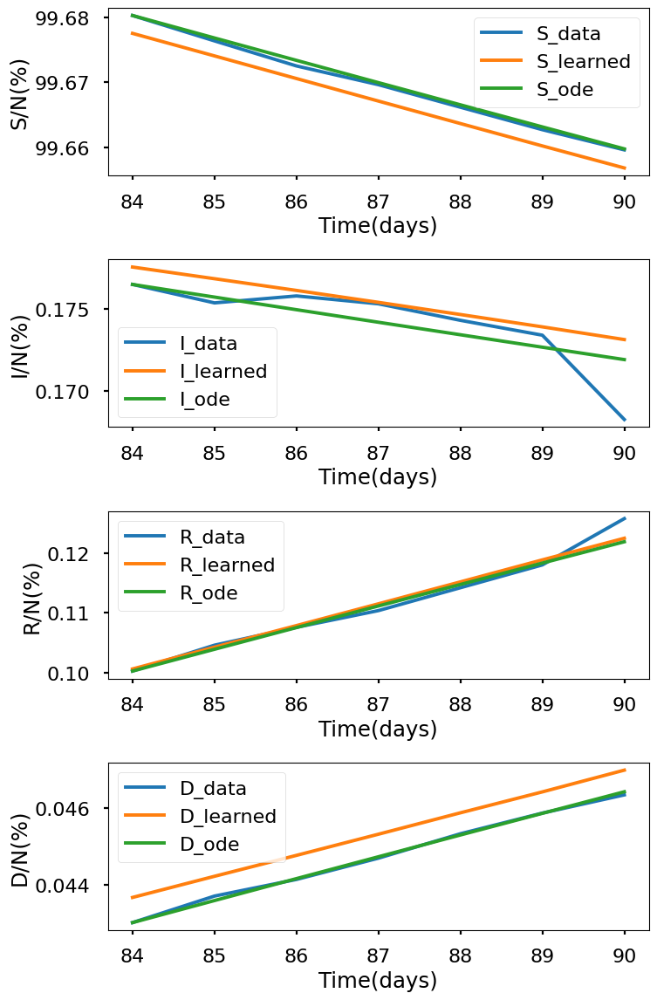

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.881e+00, GE_loss: 2.95870e+00,OB_loss: 1.92249e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.11, cumulative_time: 5.11
It: 10000, Loss: 8.112e-04, GE_loss: 1.35164e-04,OB_loss: 6.76048e-04, Beta: 1.84593e+00,gamma: 9.64181e-01,mu: 9.14793e-01, Time: 116.48, cumulative_time: 121.59
It: 20000, Loss: 1.317e-04, GE_loss: 6.87966e-05,OB_loss: 6.28878e-05, Beta: 1.12902e-02,gamma: 3.82228e-02,mu: 1.86814e-03, Time: 114.19, cumulative_time: 235.77
It: 30000, Loss: 6.112e-05, GE_loss: 2.91031e-05,OB_loss: 3.20192e-05, Beta: 1.08758e-02,gamma: 3.78249e-02,mu: 2.13956e-03, Time: 117.65, cumulative_time: 353.42
It: 40000, Loss: 8.526e-05, GE_loss: 3.39218e-05,OB_loss: 5.13360e-05, Beta: 1.03294e-02,gamma: 3.65699e-02,mu: 1.69401e-03, Time: 113.39, cumulative_time: 466.81
beta:  [0.01164582]
gamma:  [0.03723852]
mu:  [0.00170973]


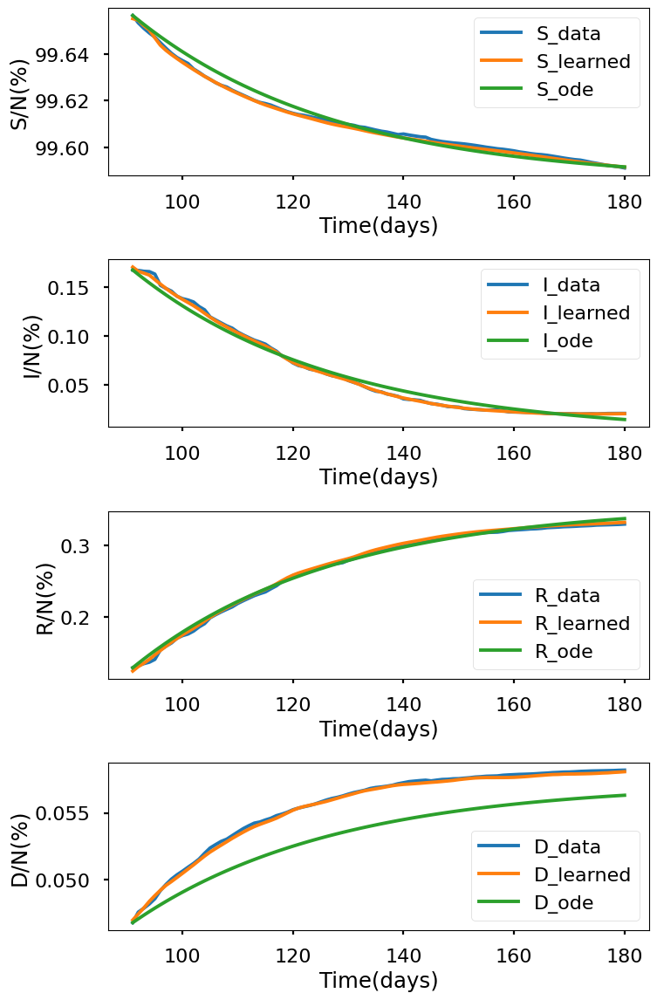

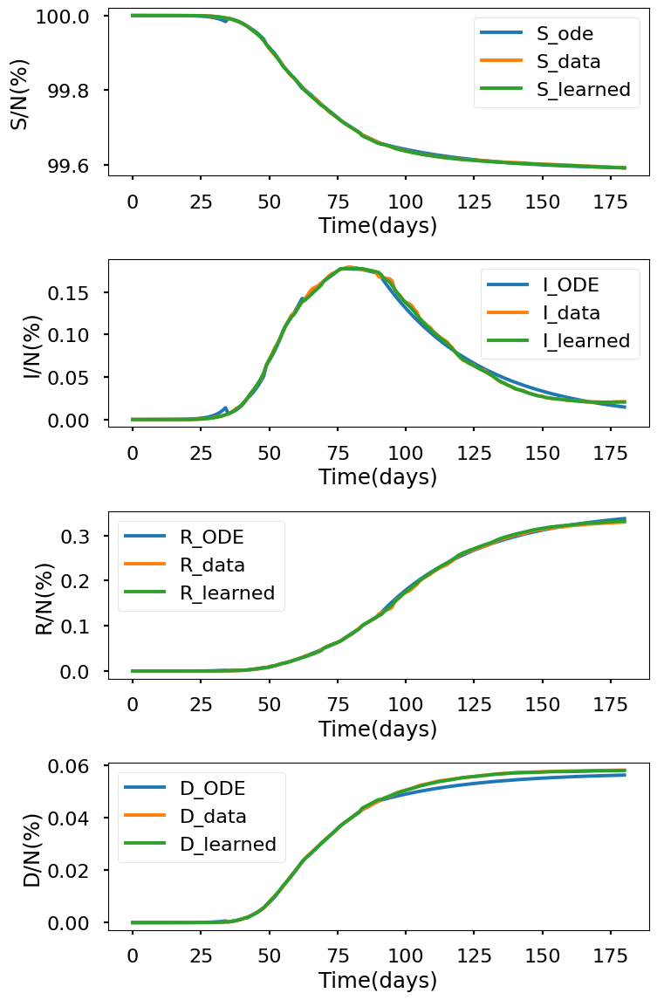

+---------------------+---------------------+-------------+-------------+-------------+-------------+--------------+--------------+-------------+--------------+--------------+
|      Paramaters     | Initial three weeks |   4th week  |   5th week  |   6th week  |   7th week  |   8th week   |   9th week   |  10th week  |  11th week   |  remainder   |
+---------------------+---------------------+-------------+-------------+-------------+-------------+--------------+--------------+-------------+--------------+--------------+
|         beta        |      0.2868424      |  0.22397873 |  0.15721622 |  0.11399077 |  0.06913718 |  0.04318117  | 0.034727063  | 0.026229788 | 0.019686647  | 0.011645819  |
|        gamma        |     0.032119866     | 0.014251226 |  0.02052471 | 0.019793553 | 0.015327793 | 0.015917812  | 0.015018033  | 0.022301741 | 0.020766573  | 0.037238523  |
|          mu         |     0.011421922     | 0.019583166 | 0.016019365 | 0.014661437 | 0.010796817 | 0.0065655923 | 0.0

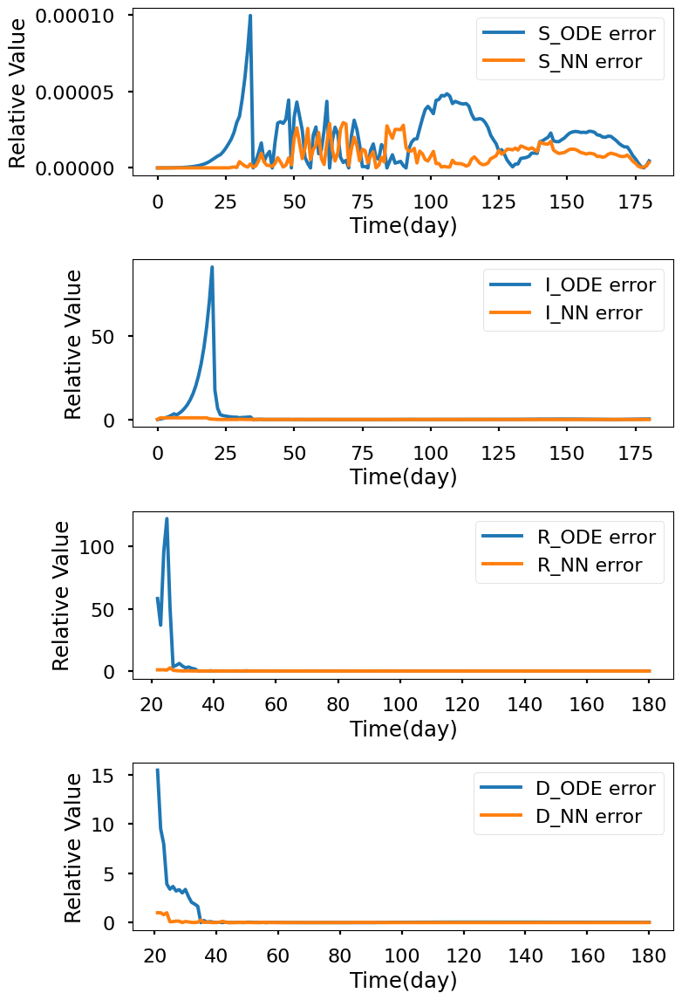

In [18]:
layers464 = [1,64,64,64,64,4]
S464_ode,I464_ode,R464_ode,D464_ode,S464_learned,I464_learned,R464_learned,D464_learned,beta464,gamma464,mu464,S_errnn464,I_errnn464,R_errnn464,D_errnn464,S_erode464,I_errode464,R_errode464,D_errode464,time464 = sum_all(
    layers464,length,SS,II,RC,DC,N0,0.1,50000)

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.923e+00, GE_loss: 2.96460e+00,OB_loss: 1.95843e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.36, cumulative_time: 5.36
It: 10000, Loss: 8.854e-06, GE_loss: 4.89248e-07,OB_loss: 8.36479e-06, Beta: 1.02637e+00,gamma: 9.65562e-01,mu: 9.65619e-01, Time: 54.97, cumulative_time: 60.33
It: 20000, Loss: 7.515e-06, GE_loss: 1.04680e-08,OB_loss: 7.50436e-06, Beta: 1.02637e+00,gamma: 9.64430e-01,mu: 9.64487e-01, Time: 55.74, cumulative_time: 116.08
It: 30000, Loss: 7.511e-06, GE_loss: 0.00000e+00,OB_loss: 7.51140e-06, Beta: 1.11718e+00,gamma: 9.51239e-01,mu: 9.53567e-01, Time: 55.66, cumulative_time: 171.73
It: 40000, Loss: 7.511e-06, GE_loss: 0.00000e+00,OB_loss: 7.51140e-06, Beta: 1.11718e+00,gamma: 9.51239e-01,mu: 9.53567e-01, Time: 57.23, cumulative_time: 228.97
beta:  [1.1171829]
gamma:  [0.9512385]
mu:  [0.953567]


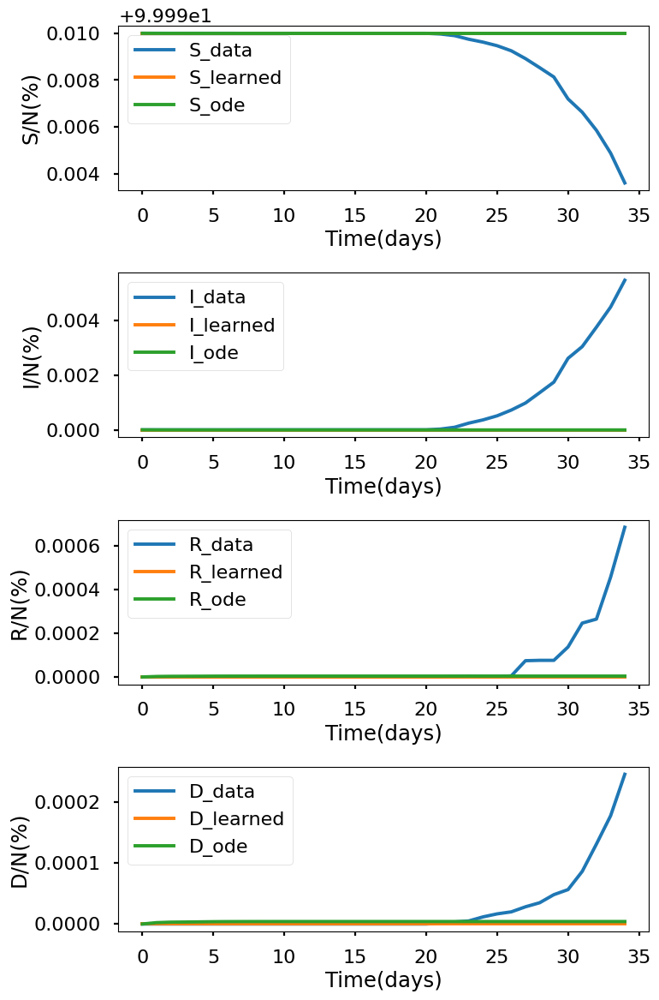

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.847e+00, GE_loss: 2.90702e+00,OB_loss: 1.93989e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.41, cumulative_time: 5.41
It: 10000, Loss: 1.589e-04, GE_loss: 1.43629e-05,OB_loss: 1.44518e-04, Beta: 1.03794e+00,gamma: 9.65060e-01,mu: 9.64906e-01, Time: 30.18, cumulative_time: 35.59
It: 20000, Loss: 1.032e-05, GE_loss: 2.63959e-06,OB_loss: 7.67834e-06, Beta: 2.25158e-01,gamma: 1.39270e-02,mu: 1.88902e-02, Time: 29.98, cumulative_time: 65.56
It: 30000, Loss: 5.864e-06, GE_loss: 1.50211e-06,OB_loss: 4.36178e-06, Beta: 2.23960e-01,gamma: 1.45816e-02,mu: 1.96423e-02, Time: 30.40, cumulative_time: 95.96
It: 40000, Loss: 7.778e-06, GE_loss: 2.07578e-06,OB_loss: 5.70264e-06, Beta: 2.25376e-01,gamma: 1.46196e-02,mu: 1.92799e-02, Time: 30.40, cumulative_time: 126.36
beta:  [0.22508082]
gamma:  [0.01463061]
mu:  [0.01969904]


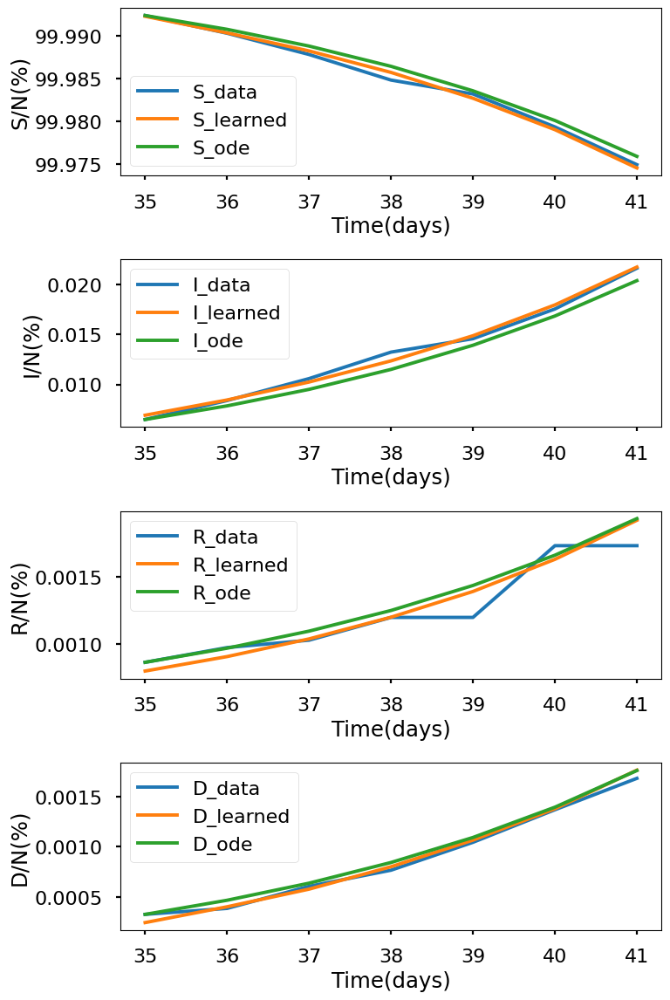

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.853e+00, GE_loss: 2.93116e+00,OB_loss: 1.92190e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.53, cumulative_time: 5.53
It: 10000, Loss: 4.531e-04, GE_loss: 5.94607e-05,OB_loss: 3.93635e-04, Beta: 1.11073e+00,gamma: 9.56680e-01,mu: 9.57531e-01, Time: 31.12, cumulative_time: 36.64
It: 20000, Loss: 2.102e-05, GE_loss: 1.02311e-05,OB_loss: 1.07901e-05, Beta: 1.77686e-01,gamma: 2.41523e-02,mu: 1.75555e-02, Time: 31.33, cumulative_time: 67.97
It: 30000, Loss: 1.699e-05, GE_loss: 5.02514e-06,OB_loss: 1.19638e-05, Beta: 1.79166e-01,gamma: 2.58905e-02,mu: 1.70061e-02, Time: 31.48, cumulative_time: 99.45
It: 40000, Loss: 1.171e-05, GE_loss: 3.00290e-06,OB_loss: 8.70631e-06, Beta: 1.80994e-01,gamma: 2.60770e-02,mu: 1.75219e-02, Time: 30.24, cumulative_time: 129.69
beta:  [0.18105458]
gamma:  [0.02618873]
mu:  [0.01758372]


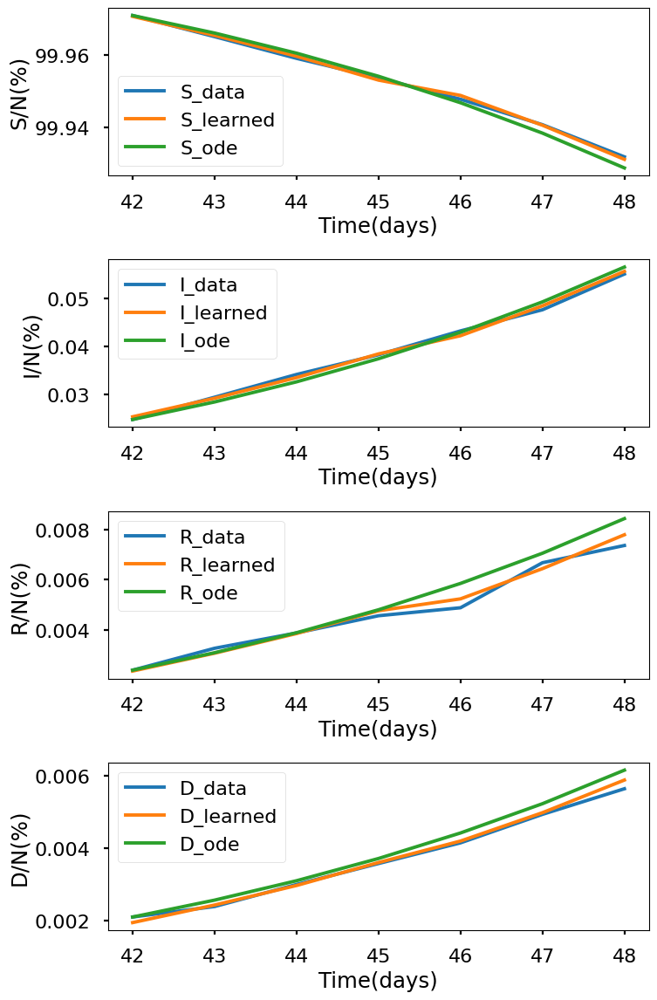

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.862e+00, GE_loss: 2.93546e+00,OB_loss: 1.92664e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.45, cumulative_time: 5.45
It: 10000, Loss: 9.579e-04, GE_loss: 1.29916e-04,OB_loss: 8.28034e-04, Beta: 1.51650e+00,gamma: 9.21337e-01,mu: 9.04834e-01, Time: 29.72, cumulative_time: 35.17
It: 20000, Loss: 2.602e-05, GE_loss: 8.95340e-06,OB_loss: 1.70629e-05, Beta: 1.12545e-01,gamma: 1.96994e-02,mu: 1.43982e-02, Time: 35.11, cumulative_time: 70.28
It: 30000, Loss: 2.120e-05, GE_loss: 7.59129e-06,OB_loss: 1.36106e-05, Beta: 1.09928e-01,gamma: 1.87496e-02,mu: 1.41638e-02, Time: 30.52, cumulative_time: 100.79
It: 40000, Loss: 3.651e-05, GE_loss: 2.07907e-05,OB_loss: 1.57230e-05, Beta: 1.11273e-01,gamma: 1.98536e-02,mu: 1.40841e-02, Time: 29.55, cumulative_time: 130.34
beta:  [0.10430646]
gamma:  [0.01763927]
mu:  [0.01348029]


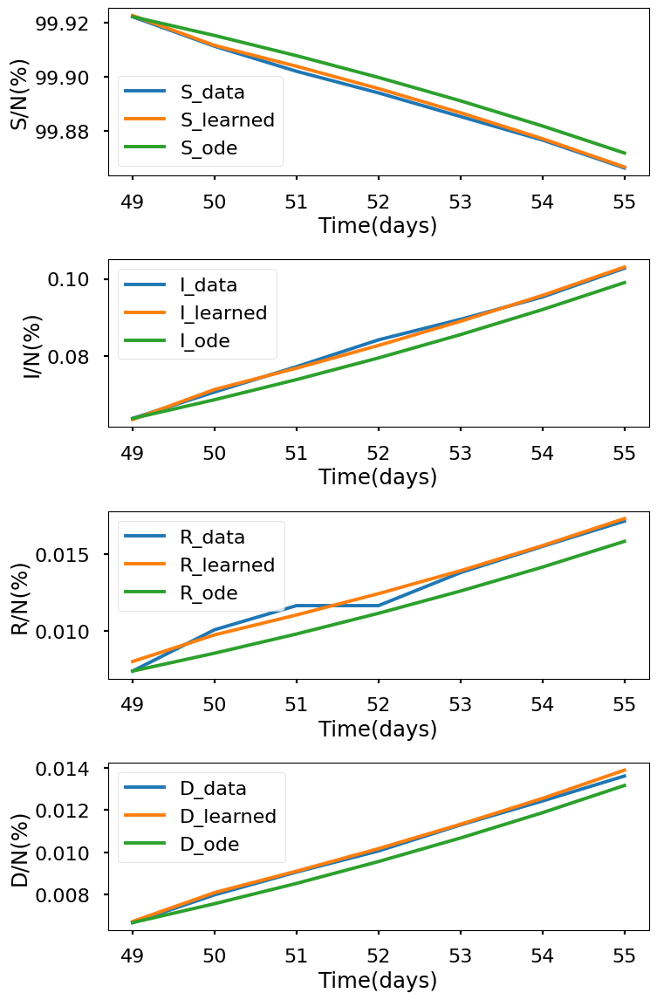

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.950e+00, GE_loss: 2.94540e+00,OB_loss: 2.00484e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.49, cumulative_time: 5.49
It: 10000, Loss: 1.313e-03, GE_loss: 6.51217e-05,OB_loss: 1.24804e-03, Beta: 1.53744e+00,gamma: 9.20476e-01,mu: 8.88095e-01, Time: 29.42, cumulative_time: 34.90
It: 20000, Loss: 5.697e-05, GE_loss: 1.96088e-05,OB_loss: 3.73654e-05, Beta: 6.38580e-02,gamma: 1.63398e-02,mu: 1.06883e-02, Time: 29.53, cumulative_time: 64.43
It: 30000, Loss: 3.871e-05, GE_loss: 1.87479e-05,OB_loss: 1.99620e-05, Beta: 6.53798e-02,gamma: 1.69212e-02,mu: 1.08701e-02, Time: 30.32, cumulative_time: 94.76
It: 40000, Loss: 3.882e-05, GE_loss: 6.84528e-06,OB_loss: 3.19753e-05, Beta: 6.50169e-02,gamma: 1.61815e-02,mu: 1.13111e-02, Time: 31.24, cumulative_time: 126.00
beta:  [0.06401753]
gamma:  [0.01596215]
mu:  [0.0107647]


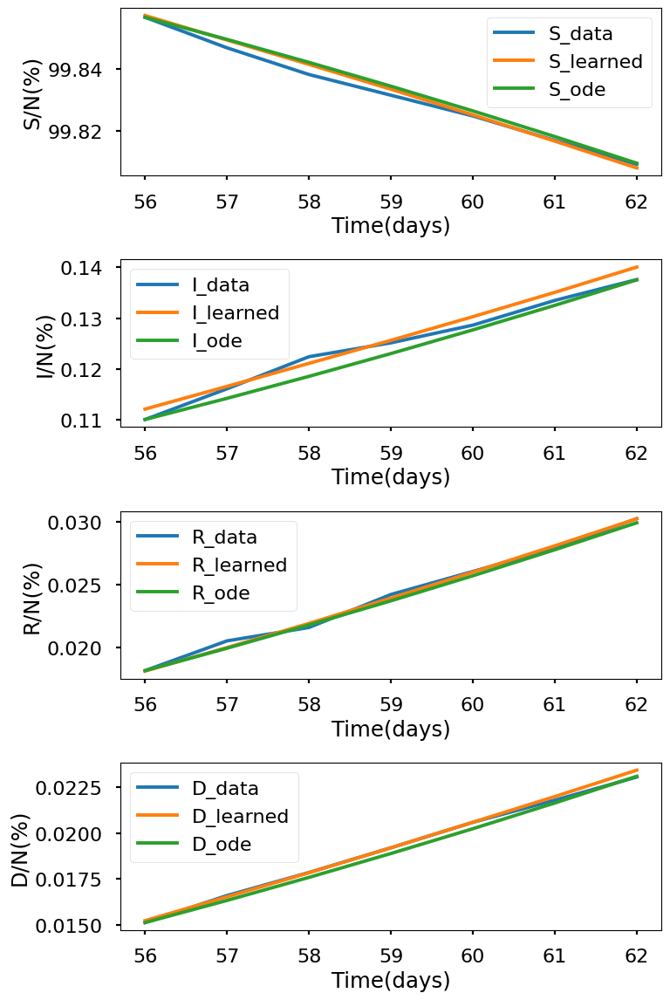

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.905e+00, GE_loss: 2.93324e+00,OB_loss: 1.97151e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.59, cumulative_time: 5.59
It: 10000, Loss: 1.595e-03, GE_loss: 7.25125e-05,OB_loss: 1.52268e-03, Beta: 1.46227e+00,gamma: 9.36611e-01,mu: 8.83337e-01, Time: 29.88, cumulative_time: 35.48
It: 20000, Loss: 4.153e-05, GE_loss: 7.53213e-06,OB_loss: 3.39942e-05, Beta: 4.37682e-02,gamma: 1.60820e-02,mu: 6.66578e-03, Time: 29.65, cumulative_time: 65.12
It: 30000, Loss: 2.690e-05, GE_loss: 6.43369e-06,OB_loss: 2.04620e-05, Beta: 4.34190e-02,gamma: 1.65292e-02,mu: 6.46302e-03, Time: 29.84, cumulative_time: 94.96
It: 40000, Loss: 3.155e-05, GE_loss: 1.05543e-05,OB_loss: 2.09996e-05, Beta: 4.36963e-02,gamma: 1.65253e-02,mu: 6.68161e-03, Time: 29.93, cumulative_time: 124.89
beta:  [0.04173369]
gamma:  [0.01557588]
mu:  [0.00655974]


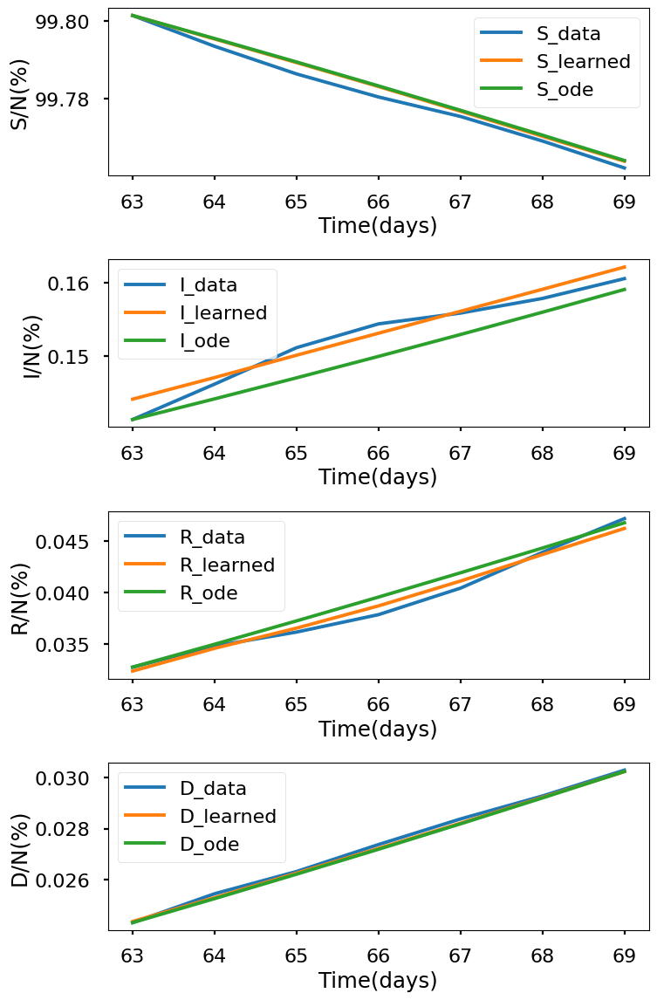

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.969e+00, GE_loss: 2.96934e+00,OB_loss: 1.99980e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.65, cumulative_time: 5.65
It: 10000, Loss: 2.191e-03, GE_loss: 4.48424e-04,OB_loss: 1.74305e-03, Beta: 1.61133e+00,gamma: 9.26144e-01,mu: 8.76023e-01, Time: 29.14, cumulative_time: 34.79
It: 20000, Loss: 1.020e-04, GE_loss: 4.72521e-05,OB_loss: 5.47605e-05, Beta: 3.74045e-02,gamma: 1.62073e-02,mu: 5.83213e-03, Time: 29.14, cumulative_time: 63.93
It: 30000, Loss: 7.782e-05, GE_loss: 3.33427e-05,OB_loss: 4.44785e-05, Beta: 3.44075e-02,gamma: 1.51633e-02,mu: 5.34036e-03, Time: 29.41, cumulative_time: 93.34
It: 40000, Loss: 7.910e-05, GE_loss: 4.69001e-05,OB_loss: 3.22025e-05, Beta: 3.37023e-02,gamma: 1.45657e-02,mu: 5.26663e-03, Time: 29.47, cumulative_time: 122.82
beta:  [0.03460759]
gamma:  [0.01496586]
mu:  [0.00573903]


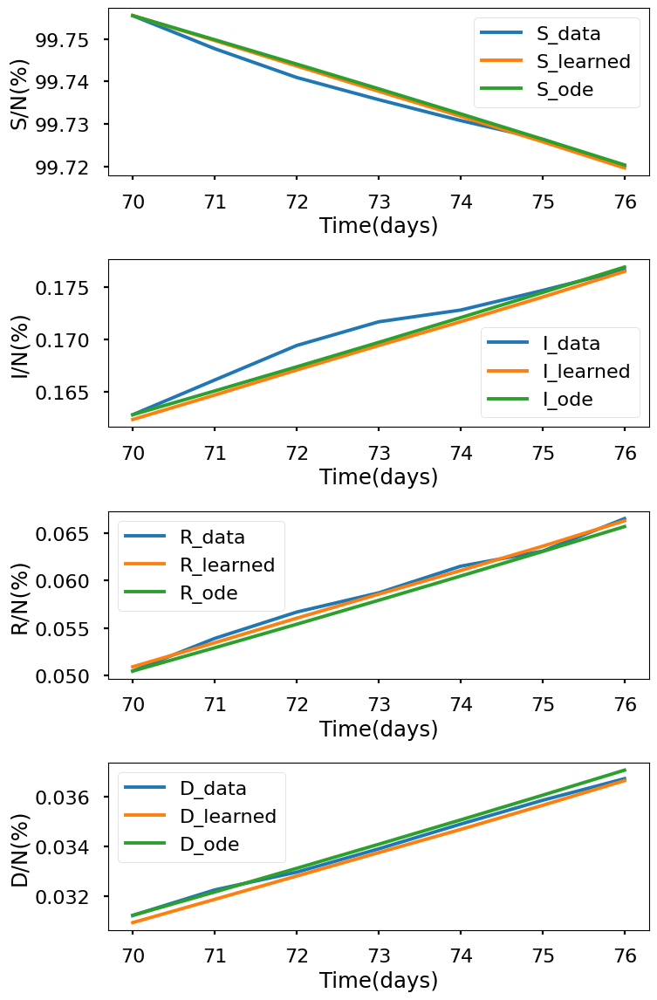

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.852e+00, GE_loss: 2.91797e+00,OB_loss: 1.93446e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.68, cumulative_time: 5.68
It: 10000, Loss: 2.084e-03, GE_loss: 3.16710e-04,OB_loss: 1.76684e-03, Beta: 1.33141e+00,gamma: 9.44582e-01,mu: 8.31269e-01, Time: 30.21, cumulative_time: 35.89
It: 20000, Loss: 4.000e-05, GE_loss: 1.59748e-05,OB_loss: 2.40223e-05, Beta: 2.74607e-02,gamma: 2.25245e-02,mu: 4.01470e-03, Time: 30.24, cumulative_time: 66.13
It: 30000, Loss: 4.574e-05, GE_loss: 2.35999e-05,OB_loss: 2.21381e-05, Beta: 2.76061e-02,gamma: 2.17037e-02,mu: 4.71107e-03, Time: 30.47, cumulative_time: 96.61
It: 40000, Loss: 4.868e-05, GE_loss: 2.79720e-05,OB_loss: 2.07061e-05, Beta: 2.63474e-02,gamma: 2.20965e-02,mu: 4.13829e-03, Time: 29.50, cumulative_time: 126.11
beta:  [0.02642935]
gamma:  [0.02216091]
mu:  [0.00434258]


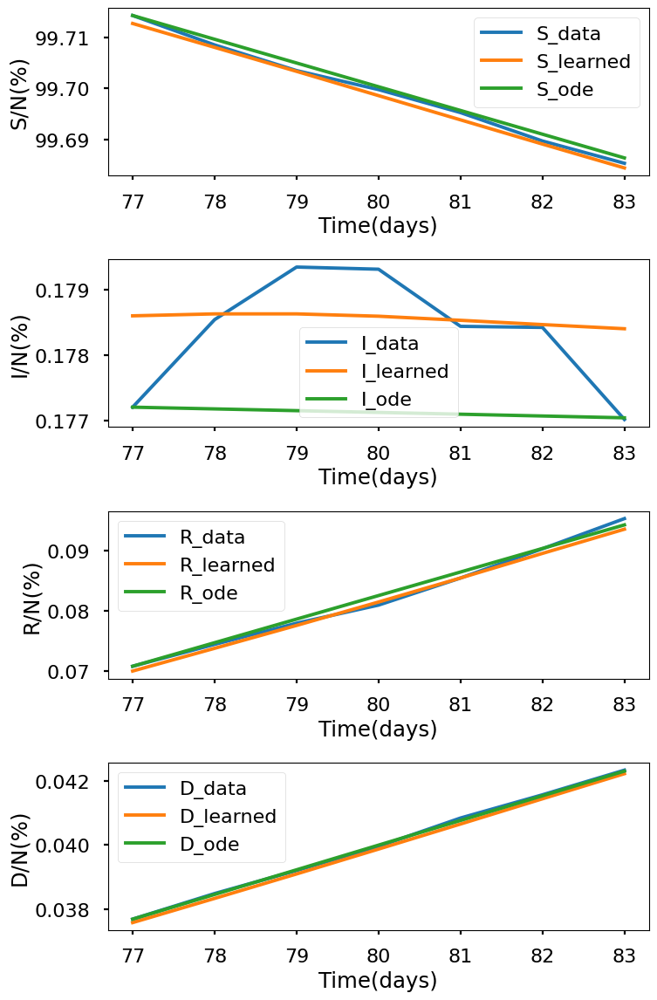

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.899e+00, GE_loss: 2.94799e+00,OB_loss: 1.95094e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.87, cumulative_time: 5.87
It: 10000, Loss: 1.832e-03, GE_loss: 9.87663e-05,OB_loss: 1.73321e-03, Beta: 1.47567e+00,gamma: 9.44115e-01,mu: 8.30995e-01, Time: 29.94, cumulative_time: 35.81
It: 20000, Loss: 3.217e-05, GE_loss: 5.61276e-06,OB_loss: 2.65527e-05, Beta: 1.92372e-02,gamma: 2.00345e-02,mu: 3.12973e-03, Time: 31.38, cumulative_time: 67.19
It: 30000, Loss: 4.799e-05, GE_loss: 2.31179e-05,OB_loss: 2.48697e-05, Beta: 1.97836e-02,gamma: 2.05127e-02,mu: 3.14698e-03, Time: 33.59, cumulative_time: 100.78
It: 40000, Loss: 2.799e-05, GE_loss: 8.41891e-06,OB_loss: 1.95760e-05, Beta: 1.97927e-02,gamma: 2.07551e-02,mu: 3.17118e-03, Time: 29.47, cumulative_time: 130.25
beta:  [0.01975073]
gamma:  [0.02108937]
mu:  [0.0030229]


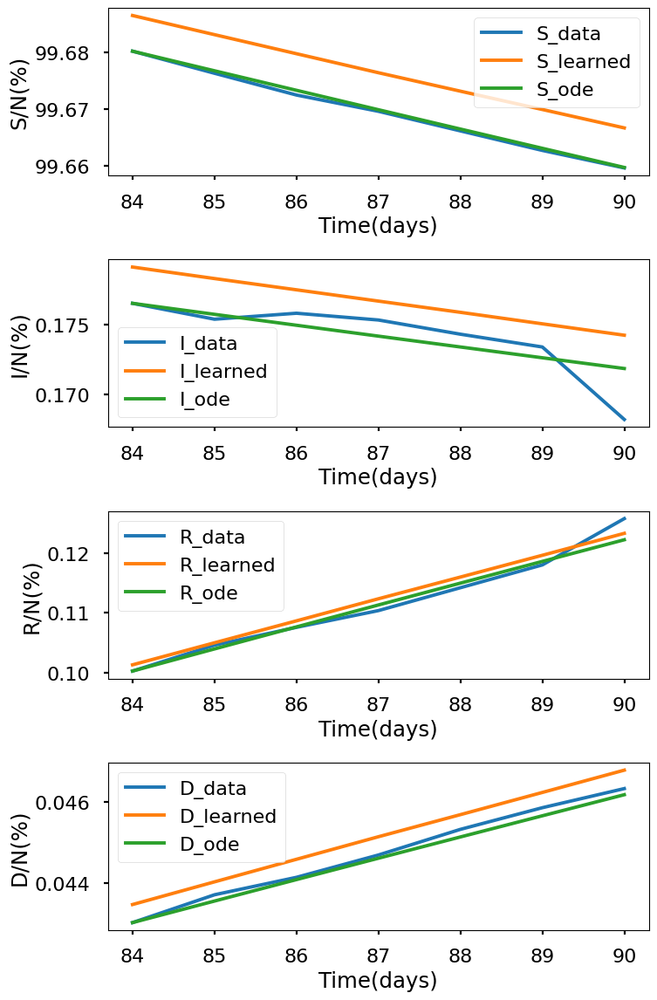

Device mapping:
/job:localhost/replica:0/task:0/device:XLA_CPU:0 -> device: XLA_CPU device

It: 0, Loss: 4.919e+00, GE_loss: 2.95128e+00,OB_loss: 1.96763e+00, Beta: 1.00000e+00,gamma: 9.99000e-01,mu: 9.99000e-01, Time: 5.90, cumulative_time: 5.90
It: 10000, Loss: 7.873e-04, GE_loss: 1.25628e-04,OB_loss: 6.61642e-04, Beta: 1.87646e+00,gamma: 9.69006e-01,mu: 9.24105e-01, Time: 142.50, cumulative_time: 148.40
It: 20000, Loss: 6.767e-05, GE_loss: 3.02673e-05,OB_loss: 3.74061e-05, Beta: 1.06734e-02,gamma: 3.74586e-02,mu: 1.56711e-03, Time: 144.23, cumulative_time: 292.63
It: 30000, Loss: 6.529e-05, GE_loss: 2.11992e-05,OB_loss: 4.40863e-05, Beta: 1.09084e-02,gamma: 3.72553e-02,mu: 3.15527e-03, Time: 140.59, cumulative_time: 433.22
It: 40000, Loss: 4.860e-05, GE_loss: 1.96892e-05,OB_loss: 2.89063e-05, Beta: 1.02491e-02,gamma: 3.71982e-02,mu: 1.84771e-03, Time: 145.67, cumulative_time: 578.89
beta:  [0.01102838]
gamma:  [0.03739612]
mu:  [0.00196083]


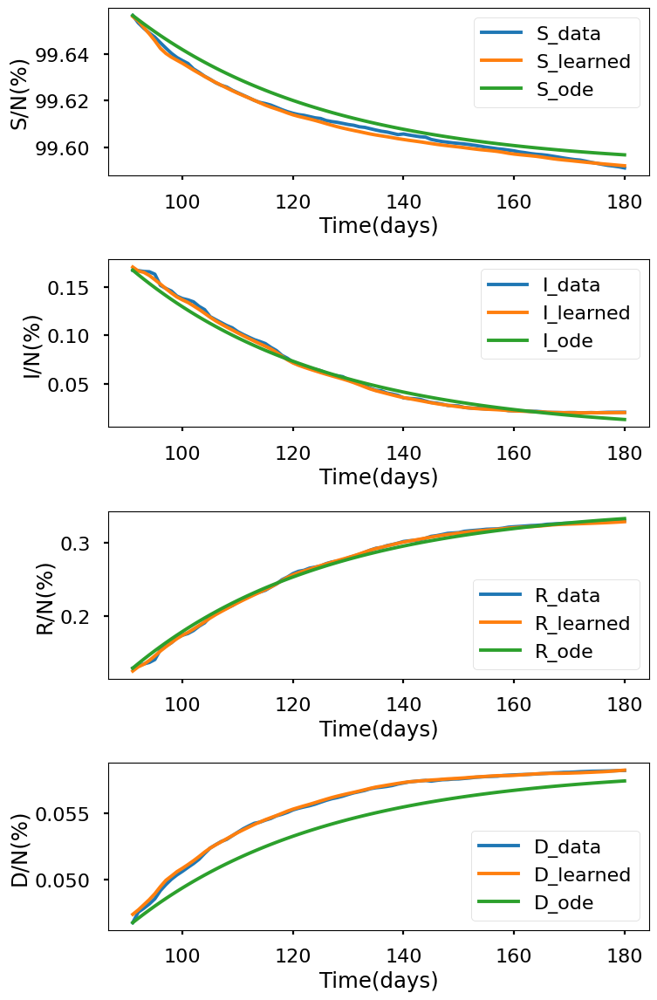

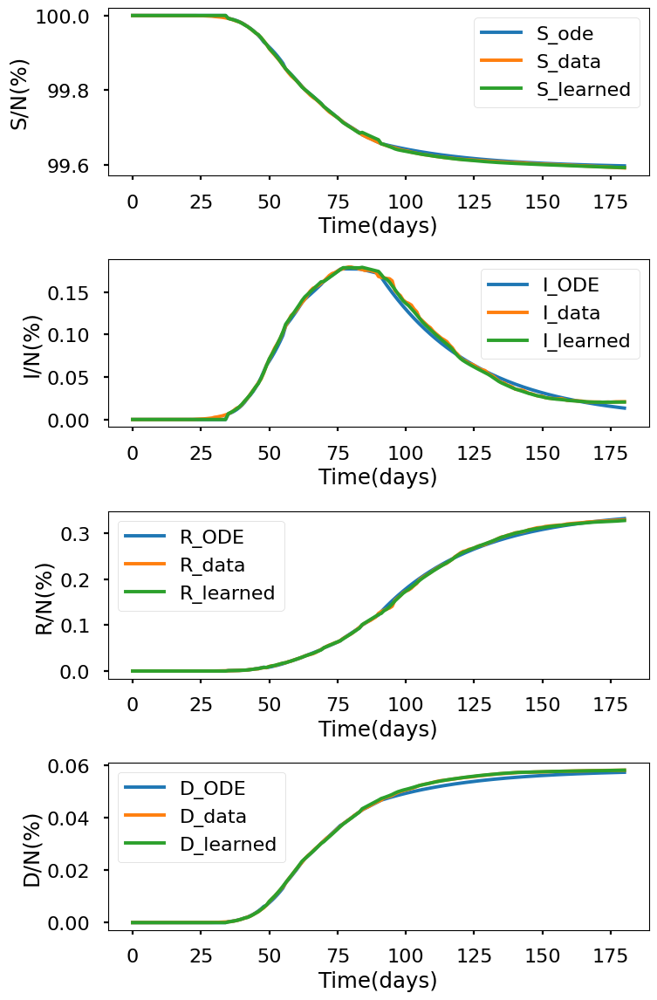

+---------------------+---------------------+-------------+-------------+--------------+-------------+--------------+--------------+-------------+--------------+--------------+
|      Paramaters     | Initial three weeks |   4th week  |   5th week  |   6th week   |   7th week  |   8th week   |   9th week   |  10th week  |  11th week   |  remainder   |
+---------------------+---------------------+-------------+-------------+--------------+-------------+--------------+--------------+-------------+--------------+--------------+
|         beta        |      1.1171829      |  0.22508082 |  0.18105458 |  0.10430646  |  0.06401753 | 0.041733686  | 0.034607593  | 0.026429348 | 0.019750735  |  0.01102838  |
|        gamma        |      0.9512385      | 0.014630612 | 0.026188726 | 0.017639274  | 0.015962154 | 0.015575885  | 0.014965865  | 0.022160906 | 0.021089368  |  0.03739612  |
|          mu         |       0.953567      | 0.019699043 |  0.01758372 | 0.0134802945 | 0.010764701 | 0.0065597426

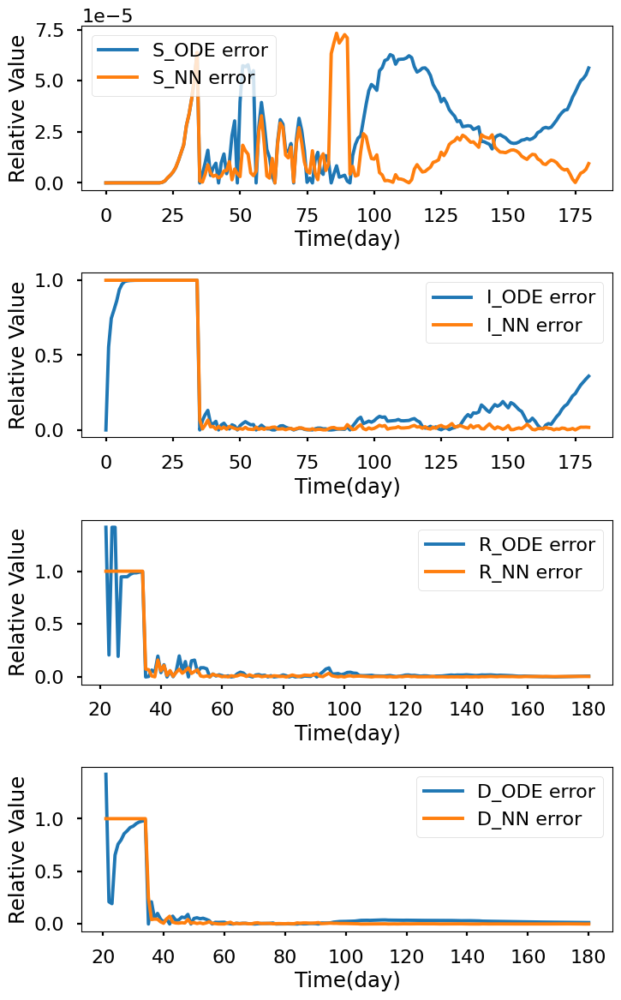

In [19]:
layers564 = [1,64,64,64,64,64,4]
S564_ode,I564_ode,R564_ode,D564_ode,S564_learned,I564_learned,R564_learned,D564_learned,beta564,gamma564,mu564,S_errnn564,I_errnn564,R_errnn564,D_errnn564,S_erode564,I_errode564,R_errode564,D_errode564,time564 = sum_all(
    layers564,length,SS,II,RC,DC,N0,0.1,50000)

In [20]:
#Compute the error for the differet layers and neurons for 
I_lnerr216 = np.linalg.norm(I216_learned.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_lnerr316 = np.linalg.norm(I316_learned.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_lnerr416 = np.linalg.norm(I416_learned.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_lnerr516 = np.linalg.norm(I516_learned.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_lnerr232 = np.linalg.norm(I232_learned.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_lnerr332 = np.linalg.norm(I332_learned.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_lnerr432 = np.linalg.norm(I432_learned.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_lnerr532 = np.linalg.norm(I532_learned.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_lnerr264 = np.linalg.norm(I264_learned.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_lnerr364 = np.linalg.norm(I364_learned.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_lnerr464 = np.linalg.norm(I464_learned.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_lnerr564 = np.linalg.norm(I564_learned.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
print("--------------------------------Learned Error---------------------------------")
x1 = PrettyTable()
x1.field_names = ["Neurons\Layers","2","3","4","5"]
x1.add_row(["16",I_lnerr216,I_lnerr316,I_lnerr416,I_lnerr516])
x1.add_row(["32",I_lnerr232,I_lnerr332,I_lnerr432,I_lnerr532])
x1.add_row(["64",I_lnerr264,I_lnerr364,I_lnerr464,I_lnerr564])
print(x1)

--------------------------------Learned Error---------------------------------
+----------------+----------------------+----------------------+----------------------+----------------------+
| Neurons\Layers |          2           |          3           |          4           |          5           |
+----------------+----------------------+----------------------+----------------------+----------------------+
|       16       | 0.012838598885024215 | 0.015103062097739362 | 0.011012866192937593 | 0.013045247298282502 |
|       32       | 0.012807512351402622 | 0.011683150830330601 | 0.011427502808159847 | 0.013116035472086241 |
|       64       | 0.012413124440631982 | 0.01217137208822218  | 0.010695135307273779 | 0.014699214735995548 |
+----------------+----------------------+----------------------+----------------------+----------------------+


In [21]:
print("----------------------------------ODE error-------------------------------------")
#Compute the error for the differet layers and neurons for 
I_oderr216 = np.linalg.norm(I216_ode.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_oderr316 = np.linalg.norm(I316_ode.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_oderr416 = np.linalg.norm(I416_ode.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_oderr516 = np.linalg.norm(I516_ode.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_oderr232 = np.linalg.norm(I232_ode.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_oderr332 = np.linalg.norm(I332_ode.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_oderr432 = np.linalg.norm(I432_ode.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_oderr532 = np.linalg.norm(I532_ode.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_oderr264 = np.linalg.norm(I264_ode.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_oderr364 = np.linalg.norm(I364_ode.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_oderr464 = np.linalg.norm(I464_ode.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
I_oderr564 = np.linalg.norm(I564_ode.reshape(length,1) - II/N0,1)/np.linalg.norm(II/N0,1)
x2 = PrettyTable()
x2.field_names = ["Neurons\Layers","2","3","4","5"]
x2.add_row(["16",I_oderr216,I_oderr316,I_oderr416,I_oderr516])
x2.add_row(["32",I_oderr232,I_oderr332,I_oderr432,I_oderr532])
x2.add_row(["64",I_oderr264,I_oderr364,I_oderr464,I_oderr564])
print(x2)

----------------------------------ODE error-------------------------------------
+----------------+---------------------+---------------------+----------------------+----------------------+
| Neurons\Layers |          2          |          3          |          4           |          5           |
+----------------+---------------------+---------------------+----------------------+----------------------+
|       16       | 0.04138809411036659 | 0.04078968297952634 | 0.04221110545398732  | 0.04161101184040968  |
|       32       | 0.04240985281140178 | 0.04333534306733287 | 0.04322541258502276  | 0.041384498780683864 |
|       64       | 0.04135025561943776 | 0.04367967781077492 | 0.044478275449835604 | 0.041003159327021144 |
+----------------+---------------------+---------------------+----------------------+----------------------+


In [22]:
x3 = PrettyTable()
print("---------------------CPU TIME--------------------------")
x3.field_names = ["Neurons\Layers","2","3","4","5"]
x3.add_row(["16",time216,time316,time416,time516])
x3.add_row(["32",time232,time332,time432,time532])
x3.add_row(["64",time264,time364,time464,time564])
print(x3)

---------------------CPU TIME--------------------------
+----------------+--------------------+--------------------+--------------------+--------------------+
| Neurons\Layers |         2          |         3          |         4          |         5          |
+----------------+--------------------+--------------------+--------------------+--------------------+
|       16       | 776.3434271812439  | 874.3816030025482  |  937.192125082016  | 1012.7053260803223 |
|       32       | 840.8885207176208  | 984.8802359104156  | 1117.5672867298126 | 1261.025738477707  |
|       64       | 1032.8252334594727 | 1310.3167073726654 | 1555.2306044101715 | 1824.305915594101  |
+----------------+--------------------+--------------------+--------------------+--------------------+
